#### **DQN Cartpole**

Instead of a table we use a neural network....
https://colab.research.google.com/github/ehennis/ReinforcementLearning/blob/master/05-DQN.ipynb#scrollTo=RWKCiyAx7AVJ

In [1]:
#Imports
import gymnasium as gym
import numpy as np
import matplotlib.pyplot as plt
from collections import deque
import tensorflow as tf
from tensorflow import keras
import random

2024-10-21 19:15:56.447731: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-10-21 19:15:56.456590: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-10-21 19:15:56.466977: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-10-21 19:15:56.469906: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-10-21 19:15:56.478068: I tensorflow/core/platform/cpu_feature_guar

In [2]:
envCartPole = gym.make('CartPole-v1', render_mode='human')
#envCartPole.seed(43) #Set the seed to keep the environment consistent across runs

**Experience Replay**  
Definition: A mechanism inspired by biology that randomizes over the data removing the correlation in the observation sequence and smoothing over changes in the data distribution.  

To perform an experience replay, the algorithm stores all of the agents experiences {$s_t,a_t,r_t,s_{t+1}$} at each time step in a data set. Normally in a q-learner, we would run the update rule on them. But, with experience replay we just store them.  

Later during the training process these replays will be drawn uniformly from the memory queue and be ran through the update rule. There are 2 ways to handle this and I have coded both in the past. The first is to run them on every loop and the other is to run them after X amount of runs. In this code below, I run them each time.

**Side Track: Vectorization**  
I am going to take some time to talk about vectorization. If you are experienced with python you can skip this part. But, I went from running 100 episodes in mutliple minutes to being able to run 500 in less than 1.  

The idea is that you execute the same task on ALL entries in an array at the same time.  

Old way:

In [3]:
tmp_array = []
for i in range(100):
    tmp_array.append(i)

#Add 10 to each element
for i in range(100):
    tmp_array[i] += 10
print(tmp_array)

[10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109]


Vectorized

In [4]:
tmp_array = []
for i in range(100):
    tmp_array.append(i)

#Add 10 to each element
tmp_array = np.array(tmp_array) + 10
print(tmp_array)

[ 10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27
  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45
  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63
  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81
  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99
 100 101 102 103 104 105 106 107 108 109]


Most of these vectorizations will be calling a method versus just adding 10 but this is a simple solution. You will see a TREMENDOUS speed up avoiding the loops in python

**CartPole Example**  
Again we will use the [CartPole](https://gym.openai.com/envs/CartPole-v1/) environment from OpenAI.  

The actions are 0 to push the cart to the left and 1 to push the cart to the right.  

The continuous state space is an X coordinate for location, the velocity of the cart, the angle of the pole, and the velocity at the tip of the pole. The X coordinate goes from -4.8 to +4.8, velocity is -Inf to +Inf, angle of the pole goes from -24 degrees to +24 degrees, tip velocity is -Inf to +Inf. With all of the possible combinations you can see why we can't create a Q table for each one.  

To "solve" this puzzle you have to have an average reward of > 195 over 100 consecutive episodes. One thing to note, I am hard capping the rewards at 210 so this number can't average above that and it also could potentially drive the average down.

In [5]:
#Global Variables
EPISODES = 500
TRAIN_END = 0

In [6]:
#Hyper Parameters
def discount_rate(): #Gamma
    return 0.95

def learning_rate(): #Alpha
    return 0.001

def batch_size(): #Size of the batch used in the experience replay
    return 24

**Deep Q-Network Class**  
The following class is the deep Q-network that is built using the neural network code from Keras.  
**init**:  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;This creates the class and sets the local parameters.  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;I use a *deque* for the local memory to hold the experiences and a keras model for the NN.  

**build_model(self)**:  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;This builds the NN. I am using sequential model. Each of the layers are *Dense* despite the fact the document talks about using *Convolution*. But, they are only using that because they need to convert pixels and I already have numbers.  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;I am using an input layer(4), 24 neuron layer, 24 neuron layer, and an output layer(2).  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;For calculating the loss I am using mean squared error.  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;For an optimizer I am using [Adam](https://arxiv.org/abs/1412.6980v8). It is a variant of gradient descent and you can read the technical document at the link. If you want a slightly lighter explaining you can check out [Machine Learning Mastery](https://machinelearningmastery.com/adam-optimization-algorithm-for-deep-learning/). You could also use SGD (Stochastic Gradient Descent) but Adam gives me better results and seems to be the standard in most examples.  

**action(self,state)**:  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;This generates the action.  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;Explore: I am using the epsilon like previous lessons.  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;Exploit: I use the NN to grab the 2 possible actions and then grab the argmax to find the better one  

**test_action(self,state)**:  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;This generates the action when I am testing. I want to 100% exploit  

**store(self, state, action, reward, nstate, done)**:  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;This places the observables in memory  

**experience_replay(self, batch_size)**:  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;This is where the training occurs. We grab the sample batches and then use the NN to predict the optimal action.  

In [9]:
#Training
rewards = [] #Store rewards for graphing
epsilons = [] # Store the Explore/Exploit
TEST_Episodes = 0
for e in range(EPISODES):
    state, _ = envCartPole.reset()
    state = np.reshape(state, [1, nS]) # Resize to store in memory to pass to .predict
    tot_rewards = 0
    for time in range(210): #200 is when you "solve" the game. This can continue forever as far as I know
        action = dqn.action(state)
        nstate, reward, done, _, _ = envCartPole.step(action)
        nstate = np.reshape(nstate, [1, nS])
        tot_rewards += reward
        
        dqn.store(state, action, reward, nstate, done) # Resize to store in memory to pass to .predict
        state = nstate
        #done: CartPole fell.
        #time == 209: CartPole stayed upright
        if done or time == 209:
            rewards.append(tot_rewards)
            epsilons.append(dqn.epsilon)
            print("episode: {}/{}, score: {}, e: {}"
                  .format(e, EPISODES, tot_rewards, dqn.epsilon))
            break
        #Experience Replay
        if len(dqn.memory) > batch_size:
            dqn.experience_replay(batch_size)
    #If our current NN passes we are done
    #I am going to use the last 5 runs
    if len(rewards) > 5 and np.average(rewards[-5:]) > 195:
        #Set the rest of the EPISODES for testing
        TEST_Episodes = EPISODES - e
        TRAIN_END = e
        break

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
episode: 0/500, score: 32.0, e: 0.9655206468094844
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
episode: 6/500, score: 15.0, e: 0.5997278763867329
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
episode: 14/500, score: 11.0, e: 0.3819719776053028
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/ste

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
episode: 35/500, score: 21.0, e: 0.11939502647758558
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/st

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
episode: 47/500, score: 26.0, e: 0.025754252208694463
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/s

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
episode: 49/500, score: 53.0, e: 0.018223908064988973
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/s

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
episode: 64/500, score: 62.0, e: 0.0009954703940636294
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
episode: 69/500, score: 182.0, e: 0.0009954703940636294
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
episode: 75/500, score: 210.0, e: 0.0009954703940636294


In [7]:
class DeepQNetwork():
    def __init__(self, states, actions, alpha, gamma, epsilon,epsilon_min, epsilon_decay):
        self.nS = states
        self.nA = actions
        self.memory = deque([], maxlen=2500)
        self.alpha = alpha
        self.gamma = gamma
        #Explore/Exploit
        self.epsilon = epsilon
        self.epsilon_min = epsilon_min
        self.epsilon_decay = epsilon_decay
        self.model = self.build_model()
        self.loss = []

    def build_model(self):
        model = keras.Sequential() #linear stack of layers https://keras.io/models/sequential/
        model.add(keras.layers.Dense(24, input_dim=self.nS, activation='relu')) #[Input] -> Layer 1
        #   Dense: Densely connected layer https://keras.io/layers/core/
        #   24: Number of neurons
        #   input_dim: Number of input variables
        #   activation: Rectified Linear Unit (relu) ranges >= 0
        model.add(keras.layers.Dense(24, activation='relu')) #Layer 2 -> 3
        model.add(keras.layers.Dense(self.nA, activation='linear')) #Layer 3 -> [output]
        #   Size has to match the output (different actions)
        #   Linear activation on the last layer
        model.compile(loss='mean_squared_error', #Loss function: Mean Squared Error
                      optimizer=keras.optimizers.Adam(learning_rate=self.alpha)) #Optimaizer: Adam (Feel free to check other options)
        return model

    def action(self, state):
        if np.random.rand() <= self.epsilon:
            return random.randrange(self.nA) #Explore
        action_vals = self.model.predict(state) #Exploit: Use the NN to predict the correct action from this state
        return np.argmax(action_vals[0])

    def test_action(self, state): #Exploit
        action_vals = self.model.predict(state)
        return np.argmax(action_vals[0])

    def store(self, state, action, reward, nstate, done):
        #Store the experience in memory
        self.memory.append( (state, action, reward, nstate, done) )

    def experience_replay(self, batch_size):
        #Execute the experience replay
        minibatch = random.sample(self.memory, batch_size ) #Randomly sample from memory

        #Convert to numpy for speed by vectorization
        x = []
        y = []
        np_array = np.array(minibatch, dtype=np.ndarray)
        st = np.zeros((0,self.nS)) #States
        nst = np.zeros( (0,self.nS) )#Next States
        
        for i in range(len(np_array)): #Creating the state and next state np arrays
            st = np.append( st, np_array[i,0], axis=0)
            nst = np.append( nst, np_array[i,3], axis=0)
        st_predict = self.model.predict(st) #Here is the speedup! I can predict on the ENTIRE batch
        nst_predict = self.model.predict(nst)
        index = 0
        for state, action, reward, nstate, done in minibatch:
            x.append(state)
            #Predict from state
            nst_action_predict_model = nst_predict[index]
            if done == True: #Terminal: Just assign reward much like {* (not done) - QB[state][action]}
                target = reward
            else:   #Non terminal
                target = reward + self.gamma * np.amax(nst_action_predict_model)
            target_f = st_predict[index]
            target_f[action] = target
            y.append(target_f)
            index += 1
        #Reshape for Keras Fit
        x_reshape = np.array(x).reshape(batch_size,self.nS)
        y_reshape = np.array(y)
        epoch_count = 1 #Epochs is the number or iterations
        hist = self.model.fit(x_reshape, y_reshape, epochs=epoch_count, verbose=0)
        #Graph Losses
        for i in range(epoch_count):
            self.loss.append( hist.history['loss'][i] )
        #Decay Epsilon
        if self.epsilon > self.epsilon_min:
            self.epsilon *= self.epsilon_decay

In [8]:
#Create the agent
nS = envCartPole.observation_space.shape[0] #This is only 4
nA = envCartPole.action_space.n #Actions
dqn = DeepQNetwork(nS, nA, learning_rate(), discount_rate(), 1, 0.001, 0.995 )

batch_size = batch_size()

/home/jau/DL-Keras/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
I0000 00:00:1729530957.488374  575275 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-10-21 19:15:57.506203: W tensorflow/core/common_runtime/gpu/gpu_device.cc:2343] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


In [13]:
#Test the agent that was trained
#   In this section we ALWAYS use exploit don't train any more
for e_test in range(TEST_Episodes):
    state, _ = envCartPole.reset()
    state = np.reshape(state, [1, nS])
    tot_rewards = 0
    for t_test in range(210):
        action = dqn.test_action(state)
        nstate, reward, done, _, _ = envCartPole.step(action)
        nstate = np.reshape( nstate, [1, nS])
        tot_rewards += reward
        #DON'T STORE ANYTHING DURING TESTING
        state = nstate
        #done: CartPole fell.
        #t_test == 209: CartPole stayed upright
        if done or t_test == 209:
            rewards.append(tot_rewards)
            epsilons.append(0) #We are doing full exploit
            print("episode: {}/{}, score: {}, e: {}"
                  .format(e_test, TEST_Episodes, tot_rewards, 0))
            break;

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.03081601 -0.2144896  -0.04660546  0.28586984]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.02652621 -0.01873503 -0.04088806 -0.02114021]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02615151 -0.21324748 -0.04131086  0.25836685]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.02188656 -0.01756085 -0.03614353 -0.04705459]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02153535 -0.21214639 -0.03708462  0.2340092 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.01729242 -0.01651474 -0.03240443 -0.07013689]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01696212 -0.21115749 -0.03380717  0.21214873]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.01273897 -0.0155689  -0.0295642  -0.09100393]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0124276  -0.2102549  -0.03138427  0.19220684]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0082225  -0.01469836 -0.02754014 -0.11020897]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00792853 -0.20941508 -0.02974432  0.17365956]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.52192944 -0.1969416  -0.00931187 -0.10159116]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5258683  -0.39192885 -0.0113437   0.18813941]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.53370684 -0.19664647 -0.00758091 -0.10810031]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5376398  -0.39165896 -0.00974292  0.18218127]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.545473   -0.19639897 -0.00609929 -0.11355919]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5494009  -0.391433   -0.00837047  0.17719322]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.55722964 -0.19619226 -0.00482661 -0.11811851]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5611535  -0.39124474 -0.00718898  0.17303777]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.56897837 -0.19602063 -0.00372822 -0.12190437]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.57289875 -0.39108896 -0.00616631  0.16960002]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.58072054 -0.19587931 -0.00277431 -0.1250218 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.96089655 -0.3704521  -0.0545118  -0.28603488]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.9683056  -0.564756   -0.0602325  -0.01103056]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.9796007  -0.36882424 -0.06045311 -0.32209283]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.98697716 -0.56303555 -0.06689497 -0.04907041]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.9982379  -0.36702135 -0.06787638 -0.3620866 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-1.0055783  -0.56111616 -0.07511811 -0.09155508]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-1.0168006  -0.3650024  -0.07694921 -0.40696013]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-1.0241007  -0.5589537  -0.08508842 -0.13949482]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-1.0352798  -0.36272267 -0.08787831 -0.45776233]
episode: 0/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0386041   0.15675679 -0.01505271 -0.2632747 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03546896 -0.03814711 -0.02031821  0.0246227

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.12944199 -0.22870535 -0.00181869  0.2166268 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1340161  -0.03355744  0.00251385 -0.07662927]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13468724  0.16152838  0.00098126 -0.36851802]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13145669 -0.0336075  -0.0063891  -0.07552584]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13212883 -0.22863728 -0.00789962  0.21513447]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13670158 -0.03340329 -0.00359693 -0.08002985]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13736965 -0.2284735  -0.00519752  0.21151608]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14193912 -0.03327762 -0.0009672  -0.08280185]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14260466 -0.22838569 -0.00262324  0.20957576]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14717238 -0.03322633  0.00156828 -0.0839335 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-1.47836909e-01 -2.28370726e-01 -1.10394445e-04  2.09243804e-01]
1/1 ━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2593499  -0.03216844  0.00414457 -0.10727184]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25999328  0.16289388  0.00199913 -0.3986443 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25673538 -0.03225638 -0.00597376 -0.10533176]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25738052 -0.22729221 -0.00808039  0.18546051]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.26192638 -0.03205559 -0.00437118 -0.10976049]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2625675  -0.22711463 -0.00656639  0.18154016]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.26710978 -0.03189934 -0.00293559 -0.11320698]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.26774776 -0.2269791  -0.00519973  0.17854835]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.27228734 -0.03178313 -0.00162876 -0.11577037]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.272923   -0.2268817  -0.00394417  0.17639825]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.27746063 -0.03170353 -0.0004162  -0.11752632]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.09857117  0.00896793 -0.00349759 -0.02862992]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.09875052 -0.18610369 -0.00407018  0.26294744]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.09502845  0.00907612  0.00118876 -0.03101649]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.09520997  0.20418102  0.00056843 -0.3233241 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0992936   0.00905097 -0.00589805 -0.03046198]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.09947462 -0.18598591 -0.00650729  0.26035422]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.09575489  0.00922833 -0.0013002  -0.03437406]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.09593946 -0.18587495 -0.00198768  0.25789836]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.09222196  0.00927532  0.00317028 -0.03541085]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.09240747  0.20435166  0.00246207 -0.32709184]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.0964945   0.00919475 -0.00407977 -0.0336335 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.06851077  0.205276    0.00379174 -0.3474863 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.07261629  0.01010031 -0.00315799 -0.05361011]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0728183  -0.18497622 -0.00423019  0.23807478]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06911878  0.01020591  0.00053131 -0.05593947]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06932289 -0.18492365 -0.00058748  0.23691104]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06562442  0.01020669  0.00415074 -0.05595714]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06582855  0.20526887  0.0030316  -0.3473276 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.06993393  0.01010394 -0.00391496 -0.05369024]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.07013601 -0.18496166 -0.00498876  0.23775493]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.06643678  0.01023121 -0.00023366 -0.05649742]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.0666414  -0.1848874  -0.00136361  0.23611178]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.02739422 -0.14934324 -0.00425347  0.19188036]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02440735  0.0458393  -0.00041586 -0.10214132]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02532414 -0.14927669 -0.00245869  0.19041038]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02233861  0.04588035  0.00134952 -0.10304715]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02325621 -0.14926091 -0.00071142  0.19006124]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02027099  0.04587121  0.0030898  -0.10284603]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.02118842 -0.14929488  0.00103288  0.19081013]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.01820252  0.04581227  0.00484909 -0.10154679]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.01911877 -0.14937884  0.00281815  0.19266205]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.01613119  0.04570269  0.00667139 -0.09913053]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01704524  0.2407284   0.00468878 -0.38970122]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04038061 -0.1486347  -0.00429933  0.17624891]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04335331  0.04654851 -0.00077436 -0.11778721]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04242234 -0.14856233 -0.0031301   0.17465131]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04539358  0.04660428  0.00036293 -0.11901741]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0444615  -0.14852287 -0.00201742  0.17378   ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04743196  0.04662789  0.00145818 -0.11953869]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0464994  -0.14851493 -0.0009326   0.17360392]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04946969  0.04662037  0.00253948 -0.11937306]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-4.8537288e-02 -1.4853787e-01  1.5202035e-04  1.7410997e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05150805  0.0465819   0.00363422 -0.118525  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05057641 -0.14859194  0.00126372  0.17530227]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01591668  0.02166321 -0.01135377 -0.16963641]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01548342 -0.17329441 -0.0147465   0.11944322]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01894931  0.02203568 -0.01235764 -0.17785537]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01850859 -0.17290726 -0.01591474  0.11090366]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02196674  0.02243908 -0.01369667 -0.18675749]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02151796 -0.17248425 -0.01743182  0.1015734 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02496764  0.02288312 -0.01540035 -0.19655785]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02450998 -0.17201519 -0.01933151  0.09122745]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02795029  0.02337843 -0.01750696 -0.20749134]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02748272 -0.17148887 -0.02165679  0.07961802]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03091249  0.02393674 -0.02006443 -0.21981823]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22643174 -0.16645025 -0.00906359 -0.03155282]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22976075 -0.36144105 -0.00969465  0.25825673]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.23698957 -0.16618206 -0.00452951 -0.0374682 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2403132  -0.36123875 -0.00527887  0.25378218]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-2.4753799e-01 -1.6604184e-01 -2.0323069e-04 -4.0561106e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2508588   0.02908303 -0.00101445 -0.33330816]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.25027716 -0.16602446 -0.00768062 -0.0409453 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25359765 -0.36103544 -0.00849952  0.24930446]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.26081836 -0.16579315 -0.00351343 -0.04604723]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.26413423 -0.36086455 -0.00443438  0.2455251 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.27135152 -0.16567953  0.00047612 -0.04855322]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05359079  0.04413268 -0.00444664 -0.12859474]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.05270813 -0.1509253  -0.00701854  0.16268201]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.05572664  0.04429643 -0.0037649  -0.1322068 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.05484071 -0.15077138 -0.00640904  0.15928598]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.05785614  0.04444173 -0.00322332 -0.13541192]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0569673  -0.1506339  -0.00593155  0.15625235]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.05997998  0.04457247 -0.00280651 -0.13829592]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.05908853 -0.15050918 -0.00557243  0.15350027]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.06209872  0.04469212 -0.00250242 -0.1409354 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.06120487 -0.1503939  -0.00532113  0.150957  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06421275  0.04480384 -0.00230199 -0.14339986]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.42006835 -0.33371246 -0.00561788  0.18325995]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4267426  -0.13851056 -0.00195268 -0.11118989]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.42951283 -0.33360448 -0.00417648  0.18087633]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.4361849  -0.13842301 -0.00055895 -0.1131212 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.43895337 -0.33353695 -0.00282138  0.17938533]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.4456241  -0.13837475  0.00076633 -0.1141863 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4483916  -0.33350766 -0.0015174   0.1787383 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.45506176 -0.13836403  0.00205737 -0.11442292]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-4.5782903e-01  5.6728382e-02 -2.3108856e-04 -4.0645605e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.45669445 -0.13839029 -0.00836021 -0.113846  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.45946226 -0.33339146 -0.01063713  0.17618766]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.03972215 -0.14329593 -0.00781777  0.20816147]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03685623  0.05193694 -0.00365454 -0.08697727]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03789497 -0.14313245 -0.00539409  0.20455042]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03503232  0.05206623 -0.00130308 -0.08982919]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03607364 -0.14303702 -0.00309966  0.20244233]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.0332129   0.05212913  0.00094918 -0.09121678]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.03425549  0.24723746 -0.00087515 -0.3836001 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03920024  0.05212794 -0.00854715 -0.09119322]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.04024279 -0.14287046 -0.01037102  0.19878086]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.03738539  0.05239828 -0.0063954  -0.09715551]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.03843335 -0.14263143 -0.00833851  0.19350283]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.01658766  0.05256628 -0.00436355 -0.10086115]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.01763899 -0.14249286 -0.00638078  0.19044189]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01478913  0.05271979 -0.00257194 -0.10424706]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.01584353 -0.1423652  -0.00465688  0.18762332]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.01299622  0.05282306 -0.00090441 -0.10652502]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01405268 -0.14228593 -0.00303492  0.18587244]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01120697  0.05287932  0.00068253 -0.10776635]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01226455 -0.1422524  -0.00147279  0.18513183]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0094195   0.05289059  0.00222984 -0.10801534]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 1.0477317e-02 -1.4226325e-01  6.9536487e-05  1.8537027e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00763205  0.05285771  0.00377694 -0.10729073]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01005148 -0.14198002 -0.00383156  0.17912465]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01289108  0.05319655 -0.00024907 -0.11476453]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01182715 -0.14192183 -0.00254436  0.1778398 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01466559  0.05323644  0.00101244 -0.11564469]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.01360086 -0.1419     -0.00130046  0.17735748]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01643886  0.05324053  0.00224669 -0.11573541]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-1.5374046e-02 -1.4191355e-01 -6.8017092e-05  1.7765547e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.01821232  0.05320938  0.00348509 -0.11504891]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.01714813 -0.14196233  0.00118411  0.1787315 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01998738  0.05314266  0.00475874 -0.11357764]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.01892452  0.2481961   0.00248719 -0.4047554 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0409385   0.0138717  -0.01121107 -0.03247902]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04066107  0.20915261 -0.01186065 -0.32867798]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03647801  0.0142015  -0.01843421 -0.03975882]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03619399 -0.18065132 -0.01922939  0.2470514 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03980701  0.01473991 -0.01428836 -0.05163435]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03951221 -0.18017428 -0.01532105  0.23650645]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0431157   0.01516318 -0.01059092 -0.06096955]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04281243 -0.17980534 -0.01181031  0.22835314]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04640854  0.01548338 -0.00724325 -0.06803166]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04609887 -0.17953397 -0.00860388  0.22235721]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04968955  0.01570989 -0.00415674 -0.07302725]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.20103246  0.01900054  0.00112387 -0.14561905]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.20065245 -0.17613749 -0.00178852  0.14741823]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.2041752   0.01901003  0.00115985 -0.14582841]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.203795   -0.1761285  -0.00175672  0.14722021]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.20731758  0.01901855  0.00118769 -0.14601642]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2069372  -0.17612039 -0.00173264  0.14704096]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2104596   0.01902633  0.00120818 -0.14618807]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.21007907 -0.1761129  -0.00171559  0.14687577]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.21360134  0.01903358  0.00122193 -0.1463479 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.21322067 -0.17610586 -0.00170503  0.14672028]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.21674278  0.01904047  0.00122938 -0.14650007]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3039392  -0.17457339 -0.0099462   0.11292065]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.30743065  0.02068965 -0.00768778 -0.18288358]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.30701685 -0.17432146 -0.01134545  0.10736426]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3105033   0.02096122 -0.00919817 -0.1888764 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.31008407 -0.17402793 -0.0129757   0.10089074]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.31356463  0.02127755 -0.01095788 -0.19585757]
episode: 7/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03468185 -0.17758785 -0.03159787  0.26454678]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03823361  0.01797052 -0.02630693 -0.03793257]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0378742  -0.1767645  -0.02706558  0.24633555]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04140949  0.01873334 -0.02213887 -0.05476012]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04103483 -0.1760643  -0.02323408  0.2308564

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12817958  0.02648782 -0.01890365 -0.22584255]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.12764983 -0.16835894 -0.0234205   0.06081802]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.131017    0.02709085 -0.02220414 -0.23916125]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1304752  -0.16770698 -0.02698736  0.04643598]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13382933  0.02779135 -0.02605865 -0.25463805]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1332735  -0.16694902 -0.03115141  0.02971296]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.13661247 -0.3616107  -0.03055715  0.3124068 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1438447  -0.16606706 -0.02430901  0.01024586]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.14716603 -0.36083212 -0.02410409  0.29516095]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.15438268 -0.16537496 -0.01820087 -0.00502551]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.15769018 -0.36023122 -0.01830138  0.2818597 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7127888  -0.34692535 -0.04211616 -0.01173949]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.71972734 -0.15122548 -0.04235095 -0.31740746]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.72275186 -0.34571943 -0.0486991  -0.03837558]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.72966623 -0.5401104  -0.04946661  0.23855336]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.74046844 -0.344318   -0.04469554 -0.06931332]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.7473548  -0.5387716  -0.04608181  0.20893969]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.75813025 -0.34302205 -0.04190302 -0.09791619]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.7649907  -0.53751916 -0.04386134  0.18125752]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.7757411  -0.34179795 -0.04023619 -0.12493309]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.78257704 -0.53632104 -0.04273485  0.15478916]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.79330343 -0.3406141  -0.03963907 -0.15106346]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.10579357 -0.19012626 -0.00141632  0.19007483]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1095961   0.00501593  0.00238518 -0.10305455]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10949578 -0.19014011  0.00032408  0.19037993]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.11329858  0.00497719  0.00413168 -0.10220073]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11319903  0.20003968  0.00208767 -0.39357728]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10919824  0.00488818 -0.00578388 -0.10023686]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10910048 -0.19015041 -0.00778861  0.19061567]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11290349  0.0050821  -0.0039763  -0.10451403]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11280184 -0.18998264 -0.00606658  0.18691173]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1166015   0.00522558 -0.00232835 -0.10767877]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.11649699 -0.18986294 -0.00448192  0.18426867]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.20753443  0.00578771  0.00661121 -0.12008305]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.20741868  0.20081432  0.00420955 -0.4106729 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2034024   0.00563294 -0.00400391 -0.11666582]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.20328973 -0.18943141 -0.00633722  0.17475122]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.20707837  0.00578066 -0.0028422  -0.11992414]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.20696275 -0.18930046 -0.00524068  0.17186075]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.21074876  0.00589611 -0.00180346 -0.12247083]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.21063083 -0.18919995 -0.00425288  0.16964258]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.21441483  0.00598261 -0.00086003 -0.12437896]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.2142952  -0.18912701 -0.00334761  0.16803251]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-2.1807773e-01  6.0426937e-03  1.3040857e-05 -1.2570462e-01]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.31179866 -0.18670201 -0.00992985  0.11454203]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.31553268  0.0085608  -0.007639   -0.18125708]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.31536147 -0.18645102 -0.01126415  0.10900626]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3190905   0.00883052 -0.00908402 -0.18720905]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.31891388 -0.1861603  -0.0128282   0.10259444]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.32263708  0.00914313 -0.01077631 -0.19410798]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.32245424 -0.18582302 -0.01465847  0.09515609]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.32617068  0.00950592 -0.01275535 -0.20211528]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.32598057 -0.1854313  -0.01679766  0.0865168 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.3296892   0.00992734 -0.01506732 -0.21141812]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.32949066 -0.18497597 -0.01929568  0.07647404]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08019109  0.04570309 -0.00587382 -0.2775185 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.07927703 -0.14933456 -0.01142419  0.01330604]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.08226372 -0.34429082 -0.01115807  0.3023627 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.08914954 -0.14901164 -0.00511082  0.00618176]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.09212977  0.04618322 -0.00498718 -0.2881093 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.09120611 -0.14886725 -0.01074937  0.00299655]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.09418345 -0.34383342 -0.01068944  0.29226863]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.10106012 -0.14856069 -0.00484407 -0.00376635]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10403133 -0.34361282 -0.00491939  0.2873843 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11090359 -0.14842108  0.00082829 -0.0068461 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11387201  0.04668899  0.00069137 -0.2992676 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.5912153  -0.33606306 -0.01305003  0.12084142]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.5979366  -0.1407566  -0.0106332  -0.17592993]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.6007517  -0.33572477 -0.0141518   0.11337969]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
[-0.60746616 -0.14040294 -0.01188421 -0.18373422]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.61027426 -0.33535284 -0.01555889  0.10517611]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.6169813  -0.14001141 -0.01345537 -0.19237469]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.61978155 -0.33493832 -0.01730286  0.09603345]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.6264803  -0.13957271 -0.01538219 -0.2020579 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.62927175 -0.33447134 -0.01942335  0.08573326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.6359612  -0.13907643 -0.01770869 -0.21301392]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.6387427  -0.33394077 -0.02196897  0.07403069]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.03182995 -0.2262141  -0.00163225  0.2398148 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.03635424 -0.03106886  0.00316405 -0.05338253]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03697561  0.16400757  0.0020964  -0.3450655 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03369546 -0.03114413 -0.00480491 -0.05172223]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03431834 -0.22619686 -0.00583936  0.23944084]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.03884228 -0.03099198 -0.00105054 -0.05507825]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03946212 -0.22609885 -0.00215211  0.23727304]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.0439841  -0.03094622  0.00259335 -0.05608795]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.04460302  0.16413845  0.00147159 -0.34795153]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.04132025 -0.0310044  -0.00548744 -0.05480492]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.04194034 -0.22604723 -0.00658353  0.23614164]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.24866126 -0.22345155 -0.00640847  0.17887725]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2531303  -0.02823849 -0.00283093 -0.11582042]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.25369507 -0.22331977 -0.00514733  0.17596804]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.25816146 -0.02812453 -0.00162797 -0.11833425]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.25872394 -0.22322312 -0.00399466  0.17383462]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.26318842 -0.02804422 -0.00051797 -0.12010581]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.2637493  -0.22315875 -0.00292008  0.17241365]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.26821247 -0.02799512  0.00052819 -0.12118904]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.26877236 -0.22312464 -0.00189559  0.17166048]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.27323487 -0.02797561  0.00153762 -0.12161984]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.27379438 -0.22311956 -0.00089478  0.1715478 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00997073  0.02049639 -0.00237892 -0.08896913]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0095608  -0.17459138 -0.0041583   0.2029623 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-1.3052627e-02  2.0589789e-02 -9.9056218e-05 -9.1029473e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01264083 -0.17453074 -0.00191965  0.2016222 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.01613145  0.02061861  0.0021128  -0.09166566]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01571907 -0.17453356  0.00027949  0.2016831 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01920975  0.02058439  0.00431315 -0.09091165]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.01879806  0.21564426  0.00249491 -0.38223067]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01448517  0.02048697 -0.0051497  -0.08876214]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01407543 -0.17456079 -0.00692494  0.20229162]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01756665  0.02065951 -0.00287911 -0.09256773]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.07181885  0.21618235  0.00326746 -0.39410397]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0674952   0.02101419 -0.00461462 -0.10039265]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.06707492 -0.17404133 -0.00662247  0.19083081]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.07055575  0.02117473 -0.00280586 -0.10393386]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.07013226 -0.17390689 -0.00488454  0.18786252]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0736104   0.0212846  -0.00112729 -0.10635728]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0731847  -0.17382118 -0.00325443  0.18596978]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.07666112  0.02134718  0.00046497 -0.10773801]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.07623418 -0.17378142 -0.0016898   0.18509157]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.07970981  0.02136466  0.00201204 -0.10812394]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-7.9282515e-02 -1.7378606e-01 -1.5044249e-04  1.8519309e-01]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00295215 -0.02085292  0.00245852 -0.04906198]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00336921  0.17423369  0.00147728 -0.34096822]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.00011547 -0.02090925 -0.00534209 -0.04781981]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00030272 -0.2159542  -0.00629848  0.24317287]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0046218  -0.02074285 -0.00143503 -0.05149009]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00503666 -0.21584418 -0.00246483  0.24073973]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00935354 -0.02068712  0.00234997 -0.05271965]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00976728  0.17440106  0.00129557 -0.34466022]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00627926 -0.0207393  -0.00559763 -0.05156903]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00669405 -0.21578054 -0.00662901  0.23934256]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01100966 -0.02056452 -0.00184216 -0.05542396]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08081538 -0.21471328 -0.00508557  0.21579438]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08510965 -0.01951898 -0.00076968 -0.0784884 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08550003 -0.21462989 -0.00233945  0.21395159]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08979262 -0.01947458  0.00193958 -0.07946838]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.09018212 -0.21462427  0.00035022  0.21382585]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.09447461 -0.01950733  0.00462673 -0.07874658]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.09486475  0.17554799  0.0030518  -0.36996618]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.09135379 -0.01961719 -0.00434752 -0.07632254]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.09174614 -0.21467654 -0.00587397  0.21498556]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.09603967 -0.01947112 -0.00157426 -0.07954448]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.09642909 -0.21457046 -0.00316515  0.21264134]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.19220407 -0.01838172  0.00483408 -0.10357827]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1925717  -0.21357262  0.00276251  0.19062586]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.19684316 -0.0184903   0.00657503 -0.10118432]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.19721296  0.17653681  0.00455134 -0.39178562]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.19368222 -0.01864943 -0.00328437 -0.09767119]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.19405521 -0.21372417 -0.00523779  0.19397372]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1983297  -0.01852768 -0.00135832 -0.1003569 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.19870025 -0.21363014 -0.00336546  0.19189717]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.20297286 -0.0184602   0.00047249 -0.10184551]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.20334207 -0.21358892 -0.00156442  0.19098645]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.20761384 -0.01844462  0.00225531 -0.10218958]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.19809118 -0.1369744  -0.00642042 -0.03759751]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.20083067 -0.33200368 -0.00717237  0.2530528 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.20747074 -0.13678007 -0.00211131 -0.04188375]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.21020634 -0.3318717  -0.00294899  0.2501323 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.21684378 -0.13670774  0.00205366 -0.04347935]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.21957794  0.05838471  0.00118407 -0.33551362]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.21841024 -0.13675408 -0.0055262  -0.04245754]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.22114532 -0.33179635 -0.00637535  0.24847671]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22778125 -0.13658394 -0.00140582 -0.04621031]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.23051293  0.05855815 -0.00233003 -0.33933645]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.22934176 -0.13653056 -0.00911675 -0.04738919]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.44563726 -0.32858273 -0.00892903  0.1775853 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.4522089  -0.13333414 -0.00537732 -0.117901  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.4548756  -0.32837865 -0.00773534  0.1730806 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.4614432  -0.13314684 -0.00427373 -0.12203252]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.4641061  -0.3282073  -0.00671438  0.16929904]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.47067025 -0.13298988 -0.0033284  -0.1254945 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.47333005 -0.328064   -0.00583829  0.1661365 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.47989133 -0.13285896 -0.00251556 -0.12838252]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.4825485  -0.3279448  -0.00508321  0.16350572]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.4891074  -0.13275044 -0.0018131  -0.13077648]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.49176243 -0.32784638 -0.00442863  0.16133389]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.79733866 -0.5060489  -0.04056121  0.08084553]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.8074596  -0.31036967 -0.0389443  -0.22435361]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.813667   -0.504914   -0.04343137  0.05579489]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.8237653  -0.3091971  -0.04231547 -0.25026843]
episode: 14/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02179326  0.19130145 -0.00510627 -0.28327867]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02561929 -0.00374729 -0.01077184  0.0077894 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02554434  0.19152747 -0.01061605 -0.28827262]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02937489 -0.00344149 -0.01638151  0.00104329]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.02930606  0.19191152 -0.01636064 -0.29676285]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03314429 -0.00297343 -0.0222959  -0.00928437]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.03308482 -0.19776864 -0.02248158  0.276281

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.1072512   0.00120362  0.00071294 -0.10142726]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.10722713 -0.19392854 -0.00131561  0.19148052]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1111057   0.00121221  0.002514   -0.10161714]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.11108146 -0.19394569  0.00048166  0.19185789]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11496037  0.00116937  0.00431882 -0.10067306]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11493699  0.19622916  0.00230536 -0.39199027]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1110124   0.00107457 -0.00553445 -0.0985814 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11099091 -0.19396763 -0.00750608  0.19235028]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.11487027  0.00126089 -0.00365907 -0.10269101]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.11484504 -0.19380842 -0.00571289  0.18883525]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.11872121  0.00139479 -0.00193619 -0.10564438]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20257795 -0.19290608 -0.0025663   0.16892536]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.20643607  0.00225251  0.0008122  -0.12456605]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.206391   -0.19288106 -0.00167912  0.168373  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.21024863  0.00226488  0.00168834 -0.12483916]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.21020333 -0.19288123 -0.00080844  0.16837594]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.21406096  0.00225229  0.00255908 -0.12456191]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-2.1401592e-01 -1.9290623e-01  6.7840301e-05  1.6892728e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.21787404  0.00221475  0.00344639 -0.12373425]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.21782975 -0.1929564   0.0009717   0.17003398]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22168887  0.00215163  0.00437238 -0.12234224]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22164585 -0.1930327   0.00192554  0.17171691]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01558794  0.04239483 -0.00956926 -0.2419021 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01474004 -0.15258913 -0.0144073   0.04774714]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01779182 -0.34750158 -0.01345236  0.33584985]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02474185 -0.15219077 -0.00673536  0.03895529]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02778567  0.04302711 -0.00595625 -0.25584507]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02692513 -0.1520093  -0.01107316  0.03495322]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.02996531 -0.3469707  -0.01037409  0.32412198]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.03690473 -0.1517026  -0.00389165  0.02818564]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03993878  0.04347494 -0.00332794 -0.2657226 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03906928 -0.15159935 -0.00864239  0.02590881]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04210127 -0.3465963  -0.00812421  0.3158525 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.22471224 -0.14833255 -0.00337009 -0.04615666]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2276789  -0.34340602 -0.00429323  0.24546106]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.23454702 -0.14822301  0.000616   -0.04857295]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.23751147  0.04689011 -0.00035546 -0.34106147]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.23657368 -0.14822678 -0.00717669 -0.04849065]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.23953821 -0.3432451  -0.00814651  0.24191935]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.24640311 -0.14800774 -0.00330812 -0.05332202]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.24936327 -0.3430821  -0.00437456  0.23831534]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2562249  -0.14789793  0.00039175 -0.05574423]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25918287 -0.34302548 -0.00072314  0.23706226]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.26604337 -0.14789322  0.00401811 -0.05584867]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4955131   0.05006127 -0.0005686  -0.41101822]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.49451187 -0.14505261 -0.00878896 -0.1185146 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.49741292 -0.34004754 -0.01115925  0.17138258]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.50421387 -0.14476767 -0.0077316  -0.12479975]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.5071092  -0.339778   -0.0102276   0.16543394]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.5139048  -0.14451115 -0.00691892 -0.13045788]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.51679504 -0.3395333  -0.00952807  0.16003421]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.5235857  -0.14427626 -0.00632739 -0.13563928]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.5264712  -0.339307   -0.00904018  0.15504074]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.53325737 -0.1440568  -0.00593936 -0.14048038]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5361385  -0.33909318 -0.00874897  0.15032287]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.04046708 -0.14620405 -0.00729782  0.1287088 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.04339116  0.04902167 -0.00472364 -0.16626754]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.04241073 -0.14603235 -0.00804899  0.12492148]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04533138  0.04920399 -0.00555056 -0.17028992]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0443473  -0.14583808 -0.00895636  0.12063682]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04726406  0.04941104 -0.00654362 -0.17485824]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04627584 -0.14561665 -0.01004079  0.11575322]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04918817  0.04964771 -0.00772572 -0.1800805 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04819522 -0.14536284 -0.01132733  0.11015525]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05110247  0.04991959 -0.00912423 -0.18607976]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05010408 -0.14507064 -0.01284583  0.10371091]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.47152293 -0.13475919 -0.00047615 -0.12376674]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.4742181  -0.3298743  -0.00295149  0.16876593]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-4.8081559e-01 -1.3471024e-01  4.2383122e-04 -1.2484664e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.48350978 -0.32983825 -0.0020731   0.16796997]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.49010655 -0.1346867   0.0012863  -0.12536623]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4928003  -0.32982704 -0.00122103  0.16772223]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.49939683 -0.13468763  0.00213342 -0.12534565]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-5.0209057e-01  6.0403686e-02 -3.7349493e-04 -4.1735473e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5008825  -0.13471296 -0.00872059 -0.12478958]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.50357676 -0.3297089  -0.01121638  0.16512938]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.51017094 -0.1344282  -0.00791379 -0.1310708 ]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.06490891  0.02303904 -0.02060445 -0.06274731]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.06536969 -0.17178153 -0.0218594   0.22336422]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.06193406  0.02364593 -0.01739211 -0.07613307]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.06240698 -0.17122243 -0.01891477  0.21101223]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.05898253  0.02416478 -0.01469453 -0.08757678]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.05946582 -0.1707435  -0.01644607  0.20043403]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.05605095  0.02460977 -0.01243738 -0.09739116]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.05654315 -0.17033173 -0.01438521  0.191342  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05313651  0.02499302 -0.01055837 -0.10584393]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05363637 -0.16997604 -0.01267525  0.18348926]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05023685  0.02532496 -0.00900546 -0.11316513]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-3.0015409e-01  3.6061991e-02 -2.6900094e-04 -3.5001987e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.29943287 -0.15905613 -0.0072694  -0.05742179]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.30261397 -0.3540731  -0.00841783  0.23295875]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.30969545 -0.1588319  -0.00375866 -0.06236751]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.31287208 -0.35389975 -0.00500601  0.22912717]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.31995007 -0.15870662 -0.00042347 -0.06513061]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.3231242   0.0364214  -0.00172608 -0.3579471 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.32239577 -0.15867597 -0.00888502 -0.06580897]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3255693 -0.3536694 -0.0102012  0.2240575]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.3326427  -0.15840316 -0.00572005 -0.07182574]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.33581075 -0.35344264 -0.00715656  0.21904701]
1/1 ━━━━━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.10667183 -0.22198017 -0.00462658  0.21590206]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.11111143 -0.02679239 -0.00030854 -0.0782367 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.11164728 -0.22190991 -0.00187327  0.21434887]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.11608548 -0.02676123  0.0024137  -0.07892439]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.1166207  -0.2219177   0.00083522  0.2145191 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.12105906 -0.0268077   0.0051256  -0.07790025]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.12159521  0.1682404   0.00356759 -0.36896163]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.1182304  -0.02693206 -0.00381164 -0.07515594]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.11876904 -0.22199917 -0.00531476  0.21632196]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.12320903 -0.02680164 -0.00098832 -0.07803272]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12374506 -0.2219094  -0.00254897  0.21433823]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.22770707 -0.02549966  0.00342885 -0.10675545]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.22821707 -0.22067058  0.00129374  0.1870073 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.23263048 -0.02556716  0.00503389 -0.10526723]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.23314182  0.16948229  0.00292854 -0.39635774]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.22975218 -0.02568109 -0.00499861 -0.10275294]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.2302658  -0.22073105 -0.00705367  0.18834876]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.23468041 -0.0255089  -0.0032867  -0.10655095]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.2351906  -0.22058359 -0.00541771  0.18509322]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.23960227 -0.02538455 -0.00171585 -0.10929384]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.24010997 -0.22048187 -0.00390173  0.18284725]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.24451959 -0.0253043  -0.00024478 -0.11106397]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-6.4748764e-02  1.6190417e-01 -7.6320372e-05 -3.5023612e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.06151069 -0.0332167  -0.00708104 -0.05757726]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.06217502 -0.2282364  -0.00823259  0.23286317]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.06673975 -0.0329978  -0.00357532 -0.06240518]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.0673997  -0.2280683  -0.00482343  0.22914757]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07196107 -0.03287776 -0.00024048 -0.06505293]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.07261863 -0.22799626 -0.00154154  0.22755413]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07717855 -0.03285231  0.00300955 -0.06561466]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0778356   0.16222636  0.00169725 -0.35734653]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.07459107 -0.03291968 -0.00544968 -0.06412891]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.07524946 -0.22796308 -0.00673225  0.22682963]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17063755 -0.03200417 -0.00696671 -0.0843259 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17127763 -0.22702557 -0.00865323  0.2061509 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.17581815 -0.03178095 -0.00453021 -0.08924908]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.17645377 -0.22683768 -0.00631519  0.20200112]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.18099052 -0.03162598 -0.00227517 -0.09266724]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.18162304 -0.22671525 -0.00412852  0.19929701]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-1.8615735e-01 -3.1534493e-02 -1.4257611e-04 -9.4685413e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18678804 -0.2266544  -0.00203628  0.19795252]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.19132112 -0.03150338  0.00192277 -0.09537206]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-1.9195119e-01 -2.2665285e-01  1.5325189e-05  1.9791688e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.19648424 -0.03153111  0.00397366 -0.09476121]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.30960956 -0.22465603 -0.00614786  0.1538713 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.31410268 -0.02944659 -0.00307044 -0.14074478]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3146916  -0.22452444 -0.00588533  0.1509679 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3191821  -0.0293187  -0.00286598 -0.14356591]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.31976846 -0.22439949 -0.00573729  0.14821148]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.32425645 -0.02919586 -0.00277306 -0.14627591]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.32484037 -0.22427799 -0.00569858  0.14553088]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.32932594 -0.02907489 -0.00278796 -0.14894438]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.32990745 -0.22415681 -0.00576685  0.1428577 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.33439058 -0.02895274 -0.0029097  -0.15163897]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.33496964 -0.22403291 -0.00594248  0.14012459]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03768209  0.02531036 -0.02833331 -0.09279704]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.0381883  -0.16939427 -0.03018925  0.19081381]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.03480041  0.02614627 -0.02637297 -0.11123764]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.03532334 -0.16858804 -0.02859773  0.1730095 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.03195158  0.02693129 -0.02513753 -0.12855616]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.0324902  -0.1678217  -0.02770866  0.15609138]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.02913377  0.02768578 -0.02458683 -0.14520259]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.02968748 -0.16707559 -0.02749088  0.13962337]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02634597  0.02842909 -0.02469842 -0.16160414]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02691455 -0.16633072 -0.0279305   0.1231859 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02358794  0.02918    -0.02546678 -0.17817633]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-1.5717718e-01 -1.5991700e-01 -1.2062266e-04 -1.8350726e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16037552  0.03520669 -0.00048764 -0.3110717 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15967138 -0.15990831 -0.00670907 -0.01854261]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16286954 -0.3549334  -0.00707992  0.272016  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16996822 -0.15971115 -0.0016396  -0.02289153]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.17316243 -0.35480955 -0.00209743  0.26927364]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.18025863 -0.15965773  0.00328804 -0.0240701 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.18345179  0.03541692  0.00280664 -0.3157138 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.18274345 -0.1597449  -0.00350764 -0.02214707]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.18593834 -0.35481638 -0.00395058  0.2694271 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.19303466 -0.15963827  0.00143796 -0.02449925]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.41235387 -0.35161263 -0.00529508  0.19875221]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.41938612 -0.15641533 -0.00132004 -0.09559637]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.4225144  -0.35151833 -0.00323196  0.1966698 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.42954478 -0.1563503   0.00070143 -0.09703092]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.4326718   0.03876159 -0.00123919 -0.38949245]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.43189657 -0.15634276 -0.00902903 -0.09720049]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.43502343 -0.35133415 -0.01097304  0.19262017]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4420501  -0.15605696 -0.00712064 -0.10350399]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.44517124 -0.35107613 -0.00919072  0.18692392]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.45219275 -0.1558239  -0.00545224 -0.10864409]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.45530924 -0.3508673  -0.00762512  0.18231371]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.0599632   0.00680076 -0.01237973 -0.1937166 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.05982719 -0.18814194 -0.01625407  0.09503548]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.06359003  0.00720916 -0.01435336 -0.20273094]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.06344584 -0.18770461 -0.01840798  0.08538985]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.06719994  0.00767631 -0.01670018 -0.21304351]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.06704641 -0.18720295 -0.02096105  0.07432499]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.07079047  0.00821313 -0.01947455 -0.22489683]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.07062621 -0.18662515 -0.02397249  0.06158001]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07435871 -0.38139534 -0.02274089  0.3466041 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08198662 -0.18595742 -0.0158088   0.04683778]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08570576  0.00938761 -0.01487205 -0.25079075]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.31406164 -0.18132041 -0.00164813 -0.05545883]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.31768805 -0.37641868 -0.00275731  0.23670365]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.32521644 -0.18125746  0.00197677 -0.05684774]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.3288416   0.0138361   0.00083981 -0.34890634]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.32856485 -0.18129778 -0.00613831 -0.0559587 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3321908  -0.37633118 -0.00725749  0.23478124]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.33971745 -0.1811063  -0.00256186 -0.06018206]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.34333956 -0.37619144 -0.00376551  0.23169148]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3508634  -0.18101588  0.00086832 -0.06217683]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.35448372  0.01409362 -0.00037521 -0.35458568]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.35420185 -0.181023   -0.00746693 -0.06202108]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.6363958  -0.37160516 -0.01008825  0.13052326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.6438279  -0.17634016 -0.00747778 -0.16532522]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.6473547  -0.37135428 -0.01078429  0.12498932]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.6547818  -0.1760795  -0.0082845  -0.17107633]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.65830344 -0.37108192 -0.01170603  0.11898162]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.66572505 -0.1757942  -0.00932639 -0.17737135]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.66924095 -0.37078145 -0.01287382  0.11235488]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.67665654 -0.17547743 -0.01062672 -0.18436168]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.6801661  -0.37044573 -0.01431396  0.10495006]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.68757504 -0.1751216  -0.01221496 -0.19221428]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.6910775  -0.3700667  -0.01605924  0.09659045]
episode: 22/425, score: 210.0, e

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0674682  -0.20849258 -0.00645986  0.21584772]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.07163806 -0.01327887 -0.0021429  -0.07886592]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.07190363 -0.20837004 -0.00372022  0.21314014]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.07607103 -0.0131951   0.00054258 -0.08071398]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07633493 -0.20832482 -0.0010717   0.21214008]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08050143 -0.01318757  0.00317111 -0.08088072]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.08076518 -0.20835483  0.00155349  0.21280101]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08493228 -0.01325513  0.00580951 -0.07939146]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08519738  0.18178307  0.00422168 -0.37023583]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08156172 -0.01339861 -0.00318303 -0.07622474]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08182969 -0.20847479 -0.00470753  0.21545222]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.28345346 -0.010309   -0.0018127  -0.14438163]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.28365964 -0.20540494 -0.00470033  0.14772888]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.28776774 -0.010216   -0.00174575 -0.1464332 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.28797206 -0.20531291 -0.00467442  0.14569846]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.29207832 -0.01012433 -0.00176045 -0.14845549]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2922808  -0.20522103 -0.00472956  0.14367154]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.29638523 -0.01003166 -0.00185613 -0.15049972]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.29658586 -0.20512699 -0.00486612  0.14159706]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3006884  -0.00993568 -0.00203418 -0.15261705]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3008871  -0.20502844 -0.00508652  0.13942343]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.30498767 -0.00983401 -0.00229805 -0.15485986]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05042932 -0.14664775 -0.01584712  0.09518811]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05336228  0.04869771 -0.01394336 -0.20245214]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05238833 -0.14622208 -0.0179924   0.08579992]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05531277  0.04915309 -0.0162764  -0.2125049 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0543297  -0.14573242 -0.0205265   0.07499959]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05724435  0.0496777  -0.01902651 -0.22408819]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0562508  -0.14516722 -0.02350827  0.06253283]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05915414  0.05028376 -0.02225761 -0.23747343]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05814847 -0.14451326 -0.02700708  0.04810653]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.06103873 -0.33923775 -0.02604495  0.33214763]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.06782348 -0.14375494 -0.019402    0.03136652]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.26008135  0.05525197  0.00048401 -0.34702498]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.2589763  -0.13987686 -0.00645649 -0.05418947]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.26177385 -0.33490565 -0.00754027  0.2364494 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.26847196 -0.13967678 -0.00281129 -0.05860238]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2712655  -0.3347583  -0.00398333  0.23319225]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.27796066 -0.13957967  0.00068051 -0.06074449]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.28075224  0.05553252 -0.00053438 -0.35321262]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2796416  -0.13958183 -0.00759863 -0.06069826]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.28243324 -0.334594   -0.0088126   0.2295776 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2891251  -0.13934724 -0.00422104 -0.06587205]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.29191208 -0.33440843 -0.00553849  0.22547613]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.52322716 -0.13583907 -0.00662825 -0.14326331]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.52594393 -0.33086547 -0.00949352  0.14732116]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.53256124 -0.13560888 -0.0065471  -0.1483416 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.53527343 -0.33063647 -0.00951393  0.14226869]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.54188615 -0.13537955 -0.00666855 -0.15340047]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.54459375 -0.33040538 -0.00973656  0.13717124]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.5512018  -0.13514535 -0.00699314 -0.15856744]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.5539048  -0.3301665  -0.01016449  0.13190113]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.5605081  -0.13490042 -0.00752647 -0.16397114]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.5632061  -0.32991382 -0.01080589  0.12632792]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5698044  -0.13463874 -0.00827933 -0.16974446]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.07009581  0.01412108 -0.00202075 -0.09556258]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.06981339 -0.18097185 -0.00393201  0.19648212]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-7.34328255e-02  1.42061245e-02 -2.36287701e-06 -9.74385887e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.0731487  -0.18091579 -0.00195113  0.1952436 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07676702  0.01423401  0.00195374 -0.09805419]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-7.6482333e-02 -1.8091588e-01 -7.3465771e-06  1.9524449e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08010066  0.01420617  0.00389754 -0.09744075]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07981653  0.20927204  0.00194873 -0.38889146]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07563109  0.01412249 -0.0058291  -0.09559476]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07534864 -0.18091543 -0.007741    0.1952434 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.07896695  0.01431639 -0.00383613 -0.09987137]
1/1 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14788824 -0.179659   -0.00240243  0.16751835]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15148142  0.01549726  0.00094794 -0.12592152]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.15117148 -0.17963825 -0.00157049  0.16706033]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15476425  0.01550614  0.00177072 -0.12611763]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.15445413 -0.17964113 -0.00075164  0.1671234 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15804695  0.01549157  0.00259083 -0.12579654]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-1.5773711e-01 -1.7966740e-01  7.4901698e-05  1.6770265e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16133046  0.01545348  0.00342895 -0.12495665]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1610214  -0.17971744  0.00092982  0.16880609]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16461574  0.0153912   0.00430594 -0.12358335]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16430792 -0.17979218  0.00183428  0.17045493]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.2513454   0.01635548  0.0017397  -0.14485423]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2510183  -0.17879134 -0.00115738  0.14837703]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.25459412  0.01634716  0.00181016 -0.1446708 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25426716 -0.17880067 -0.00108326  0.14858264]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25784317  0.01633678  0.00188839 -0.14444183]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.25751644 -0.17881216 -0.00100044  0.14883626]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2610927   0.0163241   0.00197628 -0.14416213]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.2607662  -0.1788261  -0.00090696  0.14914362]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.26434273  0.01630883  0.00207591 -0.1438253 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.26401654 -0.17884278 -0.00080059  0.14951183]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.2675934   0.01629062  0.00218964 -0.14342357]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06829251  0.15563715  0.00238447 -0.3481996 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06517977 -0.03951865 -0.00457953 -0.05476572]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06597014 -0.23457463 -0.00567484  0.23646882]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07066163 -0.03937207 -0.00094546 -0.05799871]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07144908 -0.23448046 -0.00210544  0.23438577]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07613868 -0.03932848  0.00258228 -0.05896053]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07692526  0.15575635  0.00140307 -0.3508276 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.07381013 -0.03938553 -0.00561349 -0.05770259]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.07459784 -0.23442654 -0.00676754  0.23320398]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07928637 -0.03920855 -0.00210346 -0.06160595]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08007054 -0.23430029 -0.00333558  0.23041257]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.18274994 -0.03822077  0.00199693 -0.08339677]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-1.8351436e-01  1.5687250e-01  3.2899561e-04 -3.7544900e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18037692 -0.03825412 -0.00717998 -0.08266235]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.18114199 -0.23327242 -0.00883323  0.20774665]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18580744 -0.03802528 -0.0046783  -0.08770956]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.18656795 -0.23307987 -0.00643249  0.20349368]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.19122955 -0.03786651 -0.00236262 -0.09121142]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.19198687 -0.23295452 -0.00418684  0.20072517]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-1.9664596e-01 -3.7772935e-02 -1.7234041e-04 -9.3275562e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.19740142 -0.23289242 -0.00203785  0.199353  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.20205927 -0.03774138  0.00194921 -0.09397209]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03320393  0.16379572  0.00343609 -0.32586902]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03647985 -0.03137498 -0.00308129 -0.03210449]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03585235 -0.22645262 -0.00372338  0.25960466]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0313233  -0.0312777   0.00146872 -0.03425033]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03069774  0.16382316  0.00078371 -0.3264695 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0339742  -0.03130995 -0.00574568 -0.03353953]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03334801 -0.22634904 -0.00641647  0.25732505]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02882103 -0.03113607 -0.00126997 -0.03737481]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0281983  -0.22623979 -0.00201747  0.25490716]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02367351 -0.03108908  0.00308068 -0.03841142]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02305173  0.16398856  0.00231245 -0.33012077]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.02468983  0.2337015   0.00517848 -0.2801859 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.02936386  0.03850606 -0.00042524  0.01412579]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 3.0133979e-02  2.3363411e-01 -1.4272246e-04 -2.7869126e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.03480666  0.03851419 -0.00571655  0.01394663]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03557695  0.23371767 -0.00543762 -0.28053445]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.0402513   0.0386737  -0.0110483   0.01042853]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.04102477  0.23395233 -0.01083973 -0.2857197 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.04570382  0.03898664 -0.01655413  0.00352485]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04648355  0.23434204 -0.01648363 -0.2943348 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.05117039  0.03945893 -0.02237033 -0.0068958 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.05195957  0.23489444 -0.02250824 -0.30655205]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0117506  -0.1510394  -0.0057046   0.18379627]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.01477138  0.04416371 -0.00202868 -0.11068078]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01388811 -0.15092911 -0.00424229  0.18136142]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.01690669  0.04425328 -0.00061506 -0.11265677]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01602163 -0.15085985 -0.0028682   0.17983204]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01903882  0.04430303  0.00072844 -0.11375432]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01815276 -0.15082936 -0.00154664  0.17915834]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02116935  0.0443147   0.00203652 -0.1140121 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02028305 -0.15083638 -0.00024372  0.17931265]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02329978  0.04428906  0.00334253 -0.11344716]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.022414   -0.15088062  0.00107359  0.18028843]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.05847481 -0.02856308 -0.00221303 -0.0622538 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.05904607 -0.22365323 -0.0034581   0.22973008]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.06351914 -0.02848203  0.0011365  -0.06404164]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-6.4088769e-02 -2.2362027e-01 -1.4433377e-04  2.2899964e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06856117 -0.02849625  0.00443566 -0.06372881]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0691311   0.16656183  0.00316108 -0.35500896]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06579986 -0.02860493 -0.0039391  -0.06133094]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.06637196 -0.22367018 -0.00516571  0.23010658]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07084537 -0.02847479 -0.00056358 -0.0642013 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.07141487 -0.22358866 -0.00184761  0.22830376]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.07588664 -0.02844035  0.00271847 -0.0649614 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16237722 -0.22247145 -0.00186206  0.20365736]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16682665 -0.02732291  0.00221109 -0.08961237]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16737312 -0.22247648  0.00041884  0.20376733]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17182264 -0.02736052  0.00449419 -0.08878344]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17236985  0.16769673  0.00271852 -0.38004506]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.16901591 -0.02746373 -0.00488238 -0.08650623]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1695652  -0.22251536 -0.00661251  0.20463231]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1740155  -0.02729947 -0.00251986 -0.09012918]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17456149 -0.22238521 -0.00432244  0.20175767]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1790092  -0.02720171 -0.00028729 -0.09228565]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17955323 -0.22231954 -0.002133    0.20030662]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.29178986 -0.02552335 -0.00039469 -0.1293104 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.29230034 -0.22063965 -0.0029809   0.16324797]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-2.9671311e-01 -2.5475143e-02  2.8405694e-04 -1.3037385e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2972226  -0.22060116 -0.00232342  0.16239868]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.30163464 -0.02544603  0.00092455 -0.13101633]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.30214357 -0.2205812  -0.00169577  0.16195814]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.30655518 -0.02543502  0.00154339 -0.13125928]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.3070639  -0.22057904 -0.0010818   0.16191018]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3114755  -0.02544163  0.00215641 -0.13111383]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.3119843  -0.2205944  -0.00046587  0.16224863]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3163962  -0.02546578  0.0027791  -0.13058123]
episode: 29/425, sco

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00291516 -0.24060468 -0.00990325  0.25611898]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00772725 -0.04534275 -0.00478087 -0.03967105]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0086341  -0.24039581 -0.00557429  0.25149962]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01344202 -0.04519471 -0.0005443  -0.04293631]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01434592 -0.24030885 -0.00140303  0.24957484]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01915209 -0.04516689  0.00358847 -0.0435503 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02005543  0.14990342  0.00271746 -0.33509886]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01705736 -0.0452571  -0.00398451 -0.04156024]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0179625  -0.2403217  -0.00481572  0.24986288]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02276894 -0.0451313   0.00018154 -0.04433513]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02367156 -0.24025586 -0.00070516  0.24840507]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10992222 -0.04453414 -0.00564534 -0.0575094 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11081289 -0.23957469 -0.00679553  0.23338705]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.11560439 -0.04435631 -0.00212779 -0.06143164]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11649151 -0.23944768 -0.00335642  0.2305792 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12128047 -0.04427793  0.00125516 -0.06316057]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-1.2216603e-01  1.5082601e-01 -8.0490099e-06 -3.5544723e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.11914951 -0.04429584 -0.00711699 -0.06276683]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12003542 -0.23931503 -0.00837233  0.22766218]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12482172 -0.04407443 -0.00381909 -0.06764989]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12570322 -0.23914142 -0.00517208  0.22382565]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13048604 -0.04394593 -0.00069557 -0.07048426]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.1202785  -0.03630334 -0.00973926  0.11753453]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.11955243  0.1589568  -0.00738857 -0.17820507]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.12273157 -0.03605865 -0.01095267  0.11213789]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.12201039  0.15921852 -0.00870991 -0.18398032]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.12519476 -0.03577773 -0.01238952  0.10594229]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.12447921  0.15951955 -0.01027067 -0.19062358]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.1276696  -0.03545396 -0.01408315  0.09880175]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.12696052  0.15986696 -0.01210711 -0.1982909 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.13015786 -0.03507974 -0.01607293  0.09054833]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.12945627  0.16026886 -0.01426196 -0.20716196]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.13266164 -0.03464628 -0.0184052   0.08098814]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.03336414 -0.02925716 -0.00393877 -0.0379089 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03277899 -0.22432241 -0.00469695  0.2535287 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.02829254 -0.02913371  0.00037363 -0.04063201]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.02770987 -0.22426102 -0.00043902  0.25216877]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.02322465 -0.0291328   0.00460436 -0.0406526 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02264199  0.16592282  0.00379131 -0.33187926]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.02596045 -0.02925288 -0.00284628 -0.03800315]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.02537539 -0.2243339  -0.00360634  0.2537804 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02088871 -0.02916064  0.00146927 -0.04003786]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.0203055   0.16594021  0.00066851 -0.33225685]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0236243  -0.02919125 -0.00597663 -0.03936318]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.05460547 -0.1573912  -0.0083049   0.197875  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.05145764  0.03784854 -0.0043474  -0.09741614]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.05221462 -0.15721084 -0.00629573  0.19389202]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0490704   0.03800061 -0.00241788 -0.10077026]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04983041 -0.15708661 -0.00443329  0.19114885]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04668868  0.03809848 -0.00061031 -0.1029293 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04745065 -0.15701471 -0.0026689   0.18956101]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.04431035  0.03814531  0.00112232 -0.10396264]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.04507326 -0.1569927  -0.00095693  0.18907416]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.04193341  0.03814292  0.00282455 -0.10391049]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.04269626 -0.15701939  0.00074634  0.18966223]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01981455 -0.15681942 -0.00057708  0.18525036]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02295093  0.03831079  0.00312792 -0.10761457]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02218472 -0.15685585  0.00097563  0.18605356]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02532183  0.03825213  0.0046967  -0.10632143]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02455679 -0.15693681  0.00257027  0.18783957]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.02769553  0.03814828  0.00632706 -0.10403143]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.02693256  0.23317899  0.00424644 -0.3947115 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.02226898  0.03799704 -0.00364779 -0.10069276]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.02150904 -0.15707244 -0.00566165  0.19083707]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02465049  0.03813004 -0.00184491 -0.10362648]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02388789 -0.15696542 -0.00391744  0.1884738 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.01470888  0.01127581 -0.00447595 -0.07166778]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01493439 -0.18378168 -0.00590931  0.2195996 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01125876  0.01142424 -0.00151731 -0.07494149]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01148724 -0.18367593 -0.00301614  0.21726233]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00781373  0.01148901  0.0013291  -0.07637049]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 8.0435062e-03 -1.8365197e-01 -1.9830742e-04  2.1673147e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.00437047  0.01147281  0.00413632 -0.076014  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00459992  0.20653522  0.00261604 -0.36738902]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00873063  0.0113762  -0.00473174 -0.07388238]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00895815 -0.1836776  -0.00620939  0.21730392]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.0052846   0.01153256 -0.00186331 -0.07733123]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.11285453  0.0128053  -0.00546205 -0.10540939]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.11259843 -0.18223795 -0.00757024  0.18554528]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.11624318  0.01299149 -0.00385933 -0.10951611]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.11598336 -0.18207495 -0.00604966  0.18194672]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.11962485  0.01313305 -0.00241072 -0.1126385 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.1193622  -0.18195428 -0.00466349  0.17928289]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.12300128  0.0132341  -0.00107783 -0.11486755]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1227366  -0.1818724  -0.00337519  0.17747512]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.12637405  0.0132977   0.00017432 -0.11627064]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1261081  -0.18182676 -0.0021511   0.17646728]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.12974463  0.01332592  0.00137825 -0.11689347]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03736612 -0.2184535  -0.01749518  0.1311881 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04173519 -0.02308536 -0.01487142 -0.1669626 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04219689 -0.2179913  -0.01821067  0.12099198]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.04655672 -0.02261325 -0.01579084 -0.17738016]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04700898 -0.21750571 -0.01933844  0.11027976]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0513591  -0.02211206 -0.01713284 -0.18844105]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.05180134 -0.21698475 -0.02090166  0.09878828]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.05614103 -0.02156958 -0.0189259  -0.2004151 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.05657243 -0.21641581 -0.0229342   0.08623801]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.06090074 -0.02097274 -0.02120944 -0.21359155]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0613202  -0.21578515 -0.02548127  0.07232623]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.3116204  -0.40582314 -0.00854333  0.2528488 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.31973687 -0.21058023 -0.00348635 -0.04251656]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.32394847 -0.40565202 -0.00433668  0.24906436]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.33206153 -0.21046841  0.00064461 -0.04498329]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-3.36270899e-01 -1.53557025e-02 -2.55060440e-04 -3.37462783e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.336578   -0.21047403 -0.00700432 -0.04486028]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.34078747 -0.40549484 -0.00790152  0.24560452]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.34889737 -0.21026093 -0.00298943 -0.04956023]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3531026  -0.4053399  -0.00398064  0.24217801]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.3612094  -0.2101613   0.00086292 -0.05175786]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-3.65412623e-01 -1.50517365e-02 -1.72232976e-04 -3.44168395e-01]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.6691039  -0.20563957 -0.0089439  -0.15151088]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.6732167  -0.40063232 -0.01197411  0.13833708]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.68122935 -0.20534092 -0.00920737 -0.15809931]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.6853362  -0.40032986 -0.01236936  0.13166475]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.69334275 -0.20503291 -0.00973606 -0.16489473]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.6974434  -0.40001416 -0.01303396  0.1247009 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7054437  -0.20470792 -0.01053994 -0.17206544]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.70953786 -0.39967746 -0.01398125  0.11727392]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.7175314  -0.204358   -0.01163577 -0.17978698]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.7216186  -0.3993115  -0.01523151  0.10920268]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.7296048  -0.20397465 -0.01304746 -0.18824653]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.01225085 -0.02991926  0.00156677  0.09987304]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01284923  0.1651802   0.00356423 -0.19231516]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.00954563 -0.02999255 -0.00028208  0.10148999]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01014548  0.16513345  0.00174772 -0.19128191]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00684281 -0.03001347 -0.00207791  0.10195183]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-7.4430807e-03  1.6513820e-01 -3.8877133e-05 -1.9138594e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00414032 -0.0299832  -0.0038666   0.10128472]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.00473998  0.16519396 -0.0018409  -0.1926156 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.0014361  -0.02990161 -0.00569321  0.09948603]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.00203413  0.16530147 -0.00370349 -0.19498764]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.0012719  -0.02976731 -0.00760325  0.0965247 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.14228837 -0.02147104  0.00503494 -0.08649383]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1427178   0.17357838  0.00330507 -0.37758398]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13924623 -0.02159036 -0.00424661 -0.0838608 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.13967803 -0.21665119 -0.00592383  0.2074793 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14401105 -0.02144502 -0.00177424 -0.0870664 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.14443995 -0.2165415  -0.00351557  0.20505624]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.14877078 -0.02136945  0.00058555 -0.08873361]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.14919817 -0.21649979 -0.00118912  0.204134  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.15352817 -0.02136085  0.00289356 -0.0889238 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15395539  0.17371951  0.00111509 -0.3806924 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.150481   -0.02141826 -0.00649876 -0.08765809]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.12988071  0.18413648  0.00244778 -0.28882286]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.13356344 -0.01102029 -0.00332868  0.00463105]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.13334303 -0.20609434 -0.00323606  0.29626188]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.12922114 -0.01092641  0.00268918  0.00256012]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.12900262  0.18415686  0.00274038 -0.28927314]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.13268575 -0.01100405 -0.00304508  0.00427283]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.13246568 -0.2060822  -0.00295962  0.29599345]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.12834403 -0.01091818  0.00296024  0.00237856]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.12812567  0.18416119  0.00300782 -0.2893689 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.13180889 -0.01100352 -0.00277956  0.00426114]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.13158882 -0.2060855  -0.00269434  0.29606578]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.08290905 -0.00936071  0.00312667 -0.03197874]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.08272183  0.18571626  0.0024871  -0.32367355]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.08643615 -0.00944102 -0.00398637 -0.03020732]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[ 0.08624733 -0.20450558 -0.00459052  0.2612152 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[ 0.08215722 -0.0093184   0.00063378 -0.03291209]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[ 8.1970856e-02  1.8579446e-01 -2.4458626e-05 -3.2539499e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.08568674 -0.00932714 -0.00653236 -0.03271976]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[ 0.0855002  -0.20435481 -0.00718675  0.257895  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 985ms/step
[ 0.08141311 -0.009131   -0.00202885 -0.03704605]
episode: 36/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 0.04934616  0.24166426 -0.00540914 -0.24995188]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 0.05417944  0.04661996 -0.01040

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.04574522 -0.14208657 -0.00167861  0.1921776 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.04290349  0.05305936  0.00216494 -0.1010344 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 4.3964677e-02 -1.4209355e-01  1.4425167e-04  1.9233078e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.04112281  0.05302634  0.00399087 -0.10030664]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.04218333 -0.14215258  0.00198473  0.19363272]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.03934028  0.05294092  0.00585739 -0.09842345]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.0403991   0.24797843  0.00388892 -0.38925263]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.04535867  0.0528015  -0.00389613 -0.09534612]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.0464147  -0.14226438 -0.00580306  0.19610505]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.04356941  0.05294009 -0.00188095 -0.09840283]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.04462821 -0.14215486 -0.00384901  0.19368607]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.02318985  0.05318744  0.00334243 -0.10386077]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.0242536  -0.14198224  0.00126521  0.1898748 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.02141395  0.05312158  0.00506271 -0.10240873]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.02247638  0.24817061  0.00301454 -0.3934901 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.0274398   0.05300601 -0.00485527 -0.09985826]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
[ 0.02849992 -0.14204602 -0.00685243  0.1912889 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.025659    0.05317329 -0.00302665 -0.10354779]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 0.02672246 -0.14190516 -0.00509761  0.1881787 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.02388436  0.05328935 -0.00133403 -0.10610794]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 0.02495015 -0.14181346 -0.00345619  0.1861538 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.02211388  0.05335777  0.00026688 -0.10761742]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.13376887 -0.2078395   0.00031977  0.1977996 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.13792567 -0.01272213  0.00427576 -0.09478244]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.1381801   0.18233828  0.00238011 -0.38611332]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.13453335 -0.01281738 -0.00534215 -0.0926809 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.13478969 -0.20786236 -0.00719577  0.1983118 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.13894694 -0.01263823 -0.00322953 -0.09663235]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.1391997  -0.20771374 -0.00516218  0.19502991]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.14335398 -0.01251833 -0.00126158 -0.09927697]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.14360434 -0.20762219 -0.00324712  0.19300766]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.14775679 -0.01245393  0.00061303 -0.10069782]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.14800587 -0.20758466 -0.00140093  0.19217846]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.02101082 -0.22022736 -0.00295153  0.23894644]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.02541537 -0.02506337  0.0018274  -0.05466603]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.02591663  0.17003234  0.00073407 -0.34677184]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.02251599 -0.02510005 -0.00620136 -0.05385752]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.02301799 -0.22013254 -0.00727851  0.23686239]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.02742064 -0.02490736 -0.00254126 -0.05810748]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.02791879 -0.21999279 -0.00370341  0.23377258]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.03231864 -0.02481811  0.00097204 -0.06007622]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-3.2815002e-02 -2.1995398e-01 -2.2948718e-04  2.3291323e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.03721408 -0.02482876  0.00442878 -0.05984207]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.03771066  0.17022942  0.00323194 -0.3511244 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.11639129 -0.02396823  0.00325998 -0.07882521]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.11687066  0.17110683  0.00168347 -0.37047783]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.11344852 -0.024039   -0.00572608 -0.07726455]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.11392929 -0.21907839 -0.00727137  0.21360628]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.11831086 -0.02385324 -0.00299925 -0.08136147]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.11878793 -0.21893208 -0.00462648  0.21037368]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.12316657 -0.02374428 -0.000419   -0.08376505]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.12364145 -0.21886022 -0.0020943   0.20878565]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.12801866 -0.02370838  0.00208141 -0.08455719]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.12849283 -0.2188601   0.00039026  0.2087817 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.13287003 -0.02374374  0.0045659  -0.08377809]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.10137466  0.05156039 -0.02158076 -0.05641329]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.10240586 -0.1432456  -0.02270903  0.22938338]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.09954095  0.05219339 -0.01812136 -0.07037538]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.10058482 -0.14266413 -0.01952887  0.21653554]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.09773154  0.05273147 -0.01519815 -0.08224311]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.09878617 -0.14216936 -0.01684302  0.20560628]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.09594278  0.05318936 -0.01273089 -0.09234183]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.09700657 -0.14174783 -0.01457773  0.19629747]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.09417161  0.05357957 -0.01065178 -0.1009482 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.0952432  -0.14138812 -0.01267074  0.18835518]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.09241544  0.0539128  -0.00890364 -0.10829778]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.13544574 -0.32670975 -0.00382054  0.2648297 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.14197995 -0.13153347  0.00147605 -0.02905581]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.14461061  0.06356728  0.00089494 -0.32127264]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.14333926 -0.1315674  -0.00553051 -0.02830764]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14597061 -0.3266096  -0.00609667  0.26262525]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1525028  -0.13140117 -0.00084416 -0.0319744 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15513083 -0.326511   -0.00148365  0.26044208]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.16166104 -0.1313679   0.00372519 -0.03270845]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1642884   0.06370043  0.00307102 -0.3242137 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1630144  -0.1314651  -0.00341325 -0.0305639 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1656437  -0.32653794 -0.00402453  0.26104015]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.04616471  0.1930776  -0.01104942 -0.24172379]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.05002626 -0.00188479 -0.0158839   0.04745348]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.04998856  0.19346128 -0.01493483 -0.25019833]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.05385779 -0.00144425 -0.01993879  0.03773668]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.0538289   0.19395787 -0.01918406 -0.26116985]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.05770806 -0.00088505 -0.02440746  0.02540098]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.05769036  0.19457826 -0.02389944 -0.27488175]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06158192 -0.00019469 -0.02939707  0.01016848]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.06157803 -0.19488297 -0.0291937   0.29343325]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.05768037  0.00064277 -0.02332504 -0.00831214]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.05769322 -0.19413704 -0.02349128  0.27692115]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.066402   -0.1908889   0.00065064  0.20517072]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.07021977  0.00422374  0.00475406 -0.08730689]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0701353   0.19927722  0.00300792 -0.37848613]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.06614975  0.00411269 -0.0045618  -0.08485631]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06606749 -0.19094358 -0.00625893  0.20638387]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06988637  0.00426731 -0.00213125 -0.08826684]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06980103 -0.19082402 -0.00389659  0.20374292]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0736175   0.00435343  0.00017827 -0.09016664]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07353044 -0.19077107 -0.00162506  0.20257252]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07734586  0.00437408  0.00242639 -0.09062259]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07725838 -0.19078256  0.00061394  0.20282488]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.02387633 -0.02077466 -0.01324787 -0.04619613]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02429183 -0.21570417 -0.01417179  0.24227771]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02860591 -0.02038268 -0.00932623 -0.05484147]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02901356 -0.21536967 -0.01042306  0.23488443]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.03332096 -0.02010036 -0.00572537 -0.06106795]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.03372296 -0.21513976 -0.00694673  0.2298031 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03802576 -0.01991923 -0.00235067 -0.06506295]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03842415 -0.21500741 -0.00365193  0.2268774 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04272429 -0.01983345  0.00088562 -0.06695524]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.04312096 -0.21496809 -0.00045349  0.22600697]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04742032 -0.01983966  0.00406665 -0.06681896]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.23468569 -0.01793466 -0.00440257 -0.10884337]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.23504438 -0.21299325 -0.00657944  0.18244733]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.23930424 -0.01777777 -0.00293049 -0.11230389]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2396598  -0.21285762 -0.00517657  0.17945305]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.24391696 -0.01766197 -0.00158751 -0.1148584 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.24427019 -0.21276113 -0.00388468  0.17732325]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.24852541 -0.01758381 -0.00033821 -0.11658262]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2488771  -0.21270092 -0.00266986  0.17599358]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.25313112 -0.01754085  0.00085001 -0.1175304 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25348192 -0.21267498 -0.0015006   0.17542058]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25773543 -0.01753158  0.00200781 -0.11773536]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00813574 -0.20182864 -0.03002886  0.2644733 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00409917 -0.00629124 -0.02473939 -0.03752774]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00397334 -0.20104985 -0.02548995  0.24724814]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-4.7655787e-05 -5.5733100e-03 -2.0544985e-02 -5.3364661e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.5912199e-04 -2.0039473e-01 -2.1612277e-02  2.3276600e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00416702 -0.00497075 -0.01695696 -0.06665502]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00426643 -0.19984554 -0.01829006  0.22063002]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00826334 -0.00446699 -0.01387746 -0.07776576]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00835268 -0.19938728 -0.01543277  0.21050668]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01234043 -0.0040481  -0.01122264 -0.08700425]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01242139 -0.1990074  -0.01296273  0.2021169 ]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.09842131 -0.00376038 -0.00170507 -0.09334722]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.09849652 -0.19885784 -0.00357201  0.19879727]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.10247368 -0.00368499  0.00040393 -0.09501032]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.10254738 -0.19881272 -0.00149627  0.19780003]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.10652363 -0.0036694   0.00245973 -0.09535453]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10659702 -0.19882652  0.00055264  0.19810341]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11057355 -0.00371248  0.00451471 -0.09440513]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1106478   0.19134447  0.0026266  -0.38566026]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10682091 -0.00381467 -0.0050866  -0.09215033]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10689721 -0.19886334 -0.00692961  0.19892344]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11087447 -0.00364297 -0.00295114 -0.09593738]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2002529  -0.19792622  0.0026025   0.17824244]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.20421144 -0.00284161  0.00616735 -0.11361834]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20426826  0.19219144  0.00389498 -0.40434915]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.20042443 -0.00298554 -0.004192   -0.11044079]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.20048416 -0.19804718 -0.00640082  0.18091664]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2044451  -0.00283422 -0.00278249 -0.11377863]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20450178 -0.1979162  -0.00505806  0.17802514]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.2084601  -0.00272222 -0.00149756 -0.11624912]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20851454 -0.19782268 -0.00382254  0.17596096]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.212471   -0.00264623 -0.00030332 -0.1179254 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.21252392 -0.19776385 -0.00266183  0.17466182]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.31223848  0.00037182 -0.00979489 -0.18450963]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.31223106 -0.19460863 -0.01348509  0.10506735]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.31612322  0.00070395 -0.01138374 -0.19183938]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.31610915 -0.19425331 -0.01522053  0.09723083]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.3199942   0.00108344 -0.01327591 -0.20021503]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.31997254 -0.19384615 -0.01728021  0.08825058]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.32384947  0.00151918 -0.0155152  -0.20983379]
episode: 43/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01937883  0.20798476 -0.01456578 -0.25790855]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.02353852  0.01307375 -0.01972395  0.03014476]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.0238      0.20847292 -0.01912105 -0.26869544]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02796946  0.01362899 -0.02449496  0.017895

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.02223049 -0.17657849  0.00185191  0.20216036]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02576206  0.01851692  0.00589512 -0.08993781]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.02539172  0.21355388  0.00409636 -0.380755  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02112065  0.018374   -0.00351874 -0.08678332]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02075317 -0.17669734 -0.00525441  0.20478737]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02428711  0.01849936 -0.00115866 -0.08954842]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02391713 -0.17660597 -0.00294963  0.20276873]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02744925  0.01855805  0.00110575 -0.09084321]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02707808 -0.17657974 -0.00071112  0.20218837]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.03060968  0.01855238  0.00333265 -0.09071879]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03023863 -0.17661719  0.00151827  0.20301372]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.15408792 -0.17474024 -0.00667284  0.16161354]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.15758272  0.0204766  -0.00344057 -0.133167  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15717319 -0.1745959  -0.00610391  0.15842849]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16066511  0.0206129  -0.00293534 -0.1361738 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16025285 -0.17446688 -0.00565881  0.15558162]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16374218  0.02073563 -0.00254718 -0.13888113]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16332747 -0.17434974 -0.0053248   0.1529971 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16681446  0.02084805 -0.00226486 -0.14136091]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16639751 -0.1742414  -0.00509208  0.15060663]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16988234  0.0209531  -0.00207995 -0.14367838]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16946328 -0.17413901 -0.00495351  0.14834765]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05883968 -0.00132576  0.004363   -0.07853507]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05886619  0.19373338  0.0027923  -0.36983827]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05499152 -0.00142813 -0.00460447 -0.07627621]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05502009 -0.19648378 -0.00612999  0.21495044]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05894976 -0.00127473 -0.00183098 -0.07965984]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05897526 -0.19637038 -0.00342418  0.21244484]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06290267 -0.00119964  0.00082472 -0.08131626]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.06292666 -0.19633341 -0.00080161  0.21162675]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06685333 -0.0012      0.00343093 -0.08130892]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.06687733  0.1938726   0.00180475 -0.37290743]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.06299987 -0.00127494 -0.0056534  -0.07965598]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13400532 -0.19520374 -0.00635742  0.18671161]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-1.3790940e-01  8.5926849e-06 -2.6231844e-03 -1.0797003e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.13790922 -0.19507568 -0.00478258  0.18388414]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-1.4181075e-01  1.1438498e-04 -1.1049021e-03 -1.1030366e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.14180845 -0.19499172 -0.00331098  0.18203047]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14570828  0.00017746  0.00032963 -0.11169511]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.14570473 -0.19494922 -0.00190427  0.1810918 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.14960372  0.00019993  0.00171757 -0.11219125]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14959972 -0.19494659 -0.00052626  0.18103306]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.15349865  0.00018289  0.0030944  -0.11181583]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.153495   -0.19498327  0.00085809  0.18184175]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-2.4268486e-01  1.0067692e-03  1.3096750e-04 -1.2998998e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.24266472 -0.19411705 -0.00246883  0.16273426]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.24654707  0.00104015  0.00078585 -0.1307265 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.24652626 -0.19409305 -0.00182868  0.16220425]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2504081   0.00105503  0.00141541 -0.13105501]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.250387   -0.19408716 -0.00120569  0.16207412]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.25426877  0.00105203  0.00203579 -0.13098893]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.25424773 -0.19409902 -0.00058399  0.16233557]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.25812972  0.00103128  0.00266272 -0.13053153]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-2.5810909e-01 -1.9412872e-01  5.2092437e-05  1.6299026e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.26199165  0.00099249  0.0033119  -0.12967624]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03410069 -0.14085975 -0.0202448   0.12844783]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03128349  0.05454628 -0.01767584 -0.17055272]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03237442 -0.14031827 -0.0210869   0.11650203]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02956805  0.05509936 -0.01875686 -0.18275835]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03067004 -0.13974924 -0.02241202  0.10394896]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02787506  0.0556866  -0.02033304 -0.19571978]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02898879 -0.13913868 -0.02424744  0.09048025]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02620601 -0.33390486 -0.02243783  0.37541556]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01952792 -0.1384715  -0.01492952  0.07574316]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01675849  0.05686126 -0.01341466 -0.22161244]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01789571 -0.1380664  -0.01784691  0.06680895]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.36120424 -0.13075681 -0.00548729 -0.09445022]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3638194  -0.32579967 -0.00737629  0.19649643]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.37033537 -0.130573   -0.00344636 -0.09850423]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.37294683 -0.3256454  -0.00541645  0.19308938]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.37945974 -0.13044637 -0.00155466 -0.10129727]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.38206866 -0.32554603 -0.0035806   0.19089477]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-3.8857961e-01 -1.3037302e-01  2.3729206e-04 -1.0291554e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.39118704 -0.32549837 -0.00182102  0.18984224]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.39769703 -0.13035043  0.00197583 -0.10341459]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-4.0030402e-01  6.4743161e-02 -9.2465620e-05 -3.9547348e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.39900917 -0.13037747 -0.00800194 -0.10281972]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04609097 -0.04787238  0.00459164 -0.04341824]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04704842  0.14718343  0.00372328 -0.33464894]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04410475 -0.04799132 -0.0029697  -0.0407942 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04506458 -0.24307056 -0.00378559  0.25095028]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04992599 -0.04789475  0.00123342 -0.04292429]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05088388  0.1472095   0.00037493 -0.3352178 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04793969 -0.04791779 -0.00632942 -0.04241667]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04889805 -0.24294841 -0.00717775  0.24826257]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05375702 -0.04772469 -0.0022125  -0.04667571]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05471151 -0.24281485 -0.00314602  0.24530832]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05956781 -0.04764811  0.00176015 -0.04836526]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16013408  0.14851771  0.00403272 -0.36408576]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15716372 -0.04666132 -0.00324899 -0.07013397]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.15809694 -0.24173653 -0.00465167  0.22152212]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16293168 -0.04654841 -0.00022123 -0.0726245 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16386265 -0.24166718 -0.00167372  0.21998861]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16869599 -0.04652135  0.00272605 -0.0732218 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16962641  0.14856142  0.00126162 -0.3650434 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16665518 -0.04657844 -0.00603925 -0.07196293]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16758676 -0.2416133  -0.00747851  0.21880849]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17241903 -0.04638524 -0.00310234 -0.07622407]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17334673 -0.24146259 -0.00462682  0.21547845]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04915519  0.01292547 -0.00283433 -0.06768183]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.0494137  -0.18215573 -0.00418796  0.22410549]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04577059  0.01302583  0.00029415 -0.06989553]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04603111 -0.18210034 -0.00110377  0.22288018]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.0423891   0.01303737  0.00335384 -0.0701507 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04264985 -0.1821325   0.00195082  0.22358848]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0390072   0.01296151  0.00642259 -0.06847844]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03926643  0.2079908   0.00505303 -0.3591281 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04342624  0.01279738 -0.00212954 -0.06485613]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04368219 -0.18229398 -0.00342666  0.22715415]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04003631  0.01287678  0.00111642 -0.06660769]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 3.99970799e-04 -1.81634635e-01  1.13331706e-04  2.12605491e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00323272  0.0134857   0.00436544 -0.08004168]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00296301  0.2085448   0.00276461 -0.37134412]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00120789  0.01338368 -0.00466227 -0.07779076]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00147556 -0.18167113 -0.00621809  0.21341756]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00215786  0.01353917 -0.00194974 -0.08122032]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00188708 -0.18155478 -0.00357414  0.21084681]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00551817  0.0136181   0.00064279 -0.08296142]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00524581 -0.18151306 -0.00101644  0.20992425]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00887607  0.01362341  0.00318205 -0.08307914]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0086036  -0.181544    0.00152047  0.21060602]
1/1 ━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03385813  0.23642935 -0.01188265 -0.26843947]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03858671  0.04147897 -0.01725144  0.02047203]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03941629  0.23684402 -0.016842   -0.27760363]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04415317  0.04196634 -0.02239407  0.00972013]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0449925   0.23740217 -0.02219967 -0.28994343]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04974055  0.0426037  -0.02799853 -0.00434387]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.05059262  0.23811577 -0.02808541 -0.3057275 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.05535493  0.04340506 -0.03419996 -0.02203268]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05622303 -0.15121016 -0.03464061  0.25966662]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05319883  0.04438874 -0.02944728 -0.04373802]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05408661 -0.15029883 -0.03032204  0.23951049]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2638126  -0.13660662 -0.00457375 -0.06266636]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.26654473 -0.33166268 -0.00582707  0.22857001]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.27317798 -0.13645796 -0.00125567 -0.06594527]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.27590713 -0.3315619  -0.00257458  0.22634122]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.28253838 -0.13640323  0.00195224 -0.06715272]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.28526646  0.05869067  0.00060919 -0.35921904]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.28409263 -0.13643993 -0.00657519 -0.0663441 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.28682142 -0.331467   -0.00790207  0.22425708]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.29345077 -0.136233   -0.00341693 -0.07090795]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.29617542 -0.3313058  -0.00483509  0.22069496]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.30280155 -0.13611507 -0.00042119 -0.07350922]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04643093 -0.02580865 -0.01850176 -0.02444956]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0469471  -0.22066046 -0.01899075  0.2623389 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05136031 -0.02527265 -0.01374397 -0.0362729 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05186576 -0.22019483 -0.01446943  0.25204217]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05626966 -0.02486929 -0.00942859 -0.04516934]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05676704 -0.21985479 -0.01033197  0.24452393]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06116414 -0.02458679 -0.00544149 -0.05139996]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06165588 -0.2196303  -0.00646949  0.23956117]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.06604848 -0.02441653 -0.00167827 -0.05515537]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06653681  0.17072944 -0.00278138 -0.34836733]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06312222 -0.02435283 -0.00974872 -0.05656277]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.27551955 -0.02154321 -0.00621259 -0.11854211]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.27595043 -0.21657561 -0.00858343  0.17217433]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.28028193 -0.02133186 -0.00513994 -0.12320399]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.28070858 -0.21637979 -0.00760402  0.16785292]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.28503618 -0.02114983 -0.00424697 -0.12721913]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.28545916 -0.2162107  -0.00679135  0.16412091]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2897834  -0.02099218 -0.00350893 -0.13069674]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2902032  -0.2160637  -0.00612286  0.16087711]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2945245  -0.02085462 -0.00290532 -0.13373113]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2949416  -0.21593483 -0.00557995  0.1580338 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.2992603  -0.02073344 -0.00241927 -0.13640423]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04899279  0.01862978  0.00332397 -0.09993356]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0486202  -0.17653964  0.0013253   0.19379622]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05215099  0.01856332  0.00520122 -0.09846834]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05177972  0.21361034  0.00323185 -0.38950577]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04750752  0.01844267 -0.00455826 -0.09580562]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04713866 -0.17661366 -0.00647437  0.1954357 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05067094  0.01860031 -0.00256566 -0.09928256]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05029893 -0.17648478 -0.00455131  0.1925898 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05382863  0.01870198 -0.00069951 -0.10152538]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05345459 -0.17640994 -0.00273002  0.19093676]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05698279  0.01875096  0.00108871 -0.10260612]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11348515 -0.1756067  -0.00256676  0.17321652]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11699728  0.0195519   0.00089758 -0.12027503]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.11660624 -0.1755829  -0.00150793  0.17269094]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1201179   0.0195606   0.00194589 -0.12046731]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.11972669 -0.17558917 -0.00046345  0.1728289 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12323847  0.0195394   0.00299313 -0.1200002 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12284768 -0.17562531  0.00059312  0.17362553]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1263602   0.01948816  0.00406563 -0.11887023]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12597042 -0.17569181  0.00168823  0.1750926 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12948427  0.01940594  0.00519008 -0.11705728]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12909615  0.21445315  0.00284893 -0.40809828]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.24209107 -0.38492638 -0.00560931  0.2666442 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.24978961 -0.18972482 -0.00027642 -0.02780264]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.25358412  0.0054011  -0.00083248 -0.32057276]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.25347608 -0.189709   -0.00724393 -0.02815249]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.25727028 -0.38472632 -0.00780698  0.26223612]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2649648  -0.18949379 -0.00256226 -0.03289896]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.26875466  0.00566481 -0.00322024 -0.3263892 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.26864138 -0.18941115 -0.00974802 -0.03472354]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2724296  -0.38439196 -0.01044249  0.2548679 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.28011742 -0.18912248 -0.00534514 -0.04109037]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.28389987 -0.38416737 -0.00616694  0.24990132]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-1.0156748  -0.35199502 -0.08871876 -0.46146983]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-1.0227146  -0.5457584  -0.09794816 -0.19801699]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-1.0336299  -0.34938186 -0.1019085  -0.51992065]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-1.0406175  -0.5429326  -0.11230692 -0.26101002]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.0514761  -0.3464016  -0.11752712 -0.58689827]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-1.0584042  -0.5396985  -0.12926508 -0.3334266 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.0691981  -0.7327664  -0.13593362 -0.08413909]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-1.0838535  -0.5359842  -0.1376164  -0.41643095]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-1.0945731  -0.7289149  -0.14594501 -0.17010254]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.1091515  -0.5320383  -0.14934707 -0.5050337 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.1197922  -0.7247749  -0.15944774 -0.26289195]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06860824 -0.3430993  -0.01348924  0.30448008]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07547022 -0.14778773 -0.00739964  0.00757367]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07842598 -0.3428028  -0.00724817  0.29791278]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08528204 -0.14757827 -0.00128991  0.00295274]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.08823361  0.04756215 -0.00123085 -0.29013687]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08728236 -0.14754222 -0.00703359  0.00215759]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09023321 -0.34256262 -0.00699044  0.29261306]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09708446 -0.14734168 -0.00113818 -0.00226634]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10003129  0.04779657 -0.00118351 -0.29530817]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09907535 -0.14730848 -0.00708967 -0.00299873]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.10202153 -0.34232804 -0.00714964  0.28743893]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.29566306 -0.14436743 -0.00504418 -0.06787793]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2985504  -0.3394167  -0.00640174  0.22320928]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.30533874 -0.14420384 -0.00193756 -0.07148612]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3082228  -0.33929795 -0.00336728  0.22058487]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.31500876 -0.14412804  0.00104442 -0.07315833]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.31789133  0.05097893 -0.00041875 -0.36551157]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.31687176 -0.14413707 -0.00772898 -0.0729607 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3197545  -0.33914736 -0.00918819  0.21727371]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.32653743 -0.14389528 -0.00484272 -0.07829335]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.32941535 -0.33894747 -0.00640859  0.21285777]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3361943  -0.14373448 -0.00215143 -0.08183981]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15562291 -0.15591201 -0.00498911 -0.01836615]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15874116 -0.35096207 -0.00535643  0.2727385 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-1.6576040e-01 -1.5576410e-01  9.8337288e-05 -2.1629047e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16887568  0.03935644 -0.00033424 -0.31428096]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16808856 -0.15576075 -0.00661986 -0.02170345]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17120376 -0.35078713 -0.00705393  0.2688835 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17821951 -0.15556523 -0.00167626 -0.0260159 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.18133081 -0.3506631  -0.00219658  0.2661377 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.18834408 -0.15550987  0.00312617 -0.02723726]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.19145428  0.03956711  0.00258143 -0.3189322 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.19066294 -0.15559152 -0.00379722 -0.02543631]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-4.1318220e-01  4.2611312e-02  2.9660587e-04 -3.8608488e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.41232997 -0.15251485 -0.00742509 -0.09330846]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.41538027 -0.3475296  -0.00929126  0.19702263]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4223309  -0.15227598 -0.00535081 -0.09857673]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4253764  -0.34732085 -0.00732234  0.19241324]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4323228  -0.15209492 -0.00347408 -0.10257056]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4353647  -0.3471669  -0.00552549  0.18901429]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.44230804 -0.15196633 -0.0017452  -0.10540657]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.44534737 -0.34706324 -0.00385334  0.18672523]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-4.52288628e-01 -1.51886374e-01 -1.18831122e-04 -1.07170776e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.45532638 -0.34700662 -0.00226225  0.18547466]
1/1 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.73184204 -0.14798619 -0.01052013 -0.19321579]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.73480177 -0.3429561  -0.01438444  0.09613001]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.7416609  -0.14763096 -0.01246184 -0.20105624]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.7446135  -0.34257248 -0.01648297  0.08766965]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.75146496 -0.1472182  -0.01472957 -0.21016775]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.7544094  -0.34212646 -0.01893293  0.07783261]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.76125187 -0.14673829 -0.01737628 -0.22076307]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7641866  -0.34160763 -0.02179154  0.06638841]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7710188  -0.14618012 -0.02046377 -0.23308943]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7739424  -0.3410038  -0.02512556  0.05306895]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7807625  -0.14553075 -0.02406418 -0.2474342 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02946299  0.02875079 -0.00344797 -0.11192165]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02888798 -0.16632159 -0.0056864   0.17967148]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03221441  0.02888128 -0.00209297 -0.11479987]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03163678 -0.16621062 -0.00438897  0.177222  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03496099  0.02897386 -0.00084453 -0.11684225]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03438152 -0.16613598 -0.00318137  0.17557411]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03770424  0.02903136  0.00033011 -0.11811074]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03712361 -0.16609532 -0.00203211  0.17467631]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04044552  0.02905565  0.00146142 -0.11864698]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.0398644  -0.16608721 -0.00091152  0.17449665]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04318615  0.02904778  0.00257841 -0.11847369]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08853026 -0.16621043 -0.00636873  0.17721988]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09185448  0.02900208 -0.00282433 -0.11746534]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09127443 -0.16607928 -0.00517364  0.1743252 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.09459601  0.02911633 -0.00168714 -0.11998534]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.09401369 -0.16598141 -0.00408684  0.17216483]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09733332  0.02919879 -0.00064355 -0.12180457]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09674934 -0.16591394 -0.00307964  0.17067526]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10006762  0.02925196  0.00033387 -0.12297761]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09948258 -0.16587478 -0.00212569  0.16981064]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10280008  0.02927754  0.00127053 -0.12354212]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10221453 -0.16586259 -0.00120032  0.16954137]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16597624  0.03015802 -0.00502521 -0.14296624]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16537309 -0.1648916  -0.00788453  0.1481271 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16867092  0.03034236 -0.00492199 -0.14703278]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.16806407 -0.16470876 -0.00786265  0.1440933 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17135824  0.03052491 -0.00498078 -0.15105975]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.17074774 -0.16452537 -0.00800197  0.1400477 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.17403826  0.03071027 -0.00520102 -0.15514894]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.17342405 -0.16433683 -0.008304    0.13588867]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17671078  0.03090307 -0.00558623 -0.15940244]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.17609273 -0.16413845 -0.00877427  0.13151295]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1793755   0.03110808 -0.00614402 -0.16392519]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.0076972  -0.23263335 -0.01027685  0.2626882 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00304454 -0.03736623 -0.00502309 -0.03321837]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00229721 -0.23241578 -0.00568746  0.2578755 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0023511  -0.0372131  -0.00052995 -0.03659589]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00309537  0.15791644 -0.00126186 -0.329446  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 6.296373e-05 -3.718752e-02 -7.850784e-03 -3.716125e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00068079 -0.23219602 -0.00859401  0.25303438]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00532471 -0.03695241 -0.00353332 -0.04234683]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00606376 -0.23202352 -0.00438026  0.24921921]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01070423 -0.03683929  0.00060413 -0.04484212]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01144101 -0.2319699  -0.00029272  0.24803136]
1/1 ━━━━━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.09598157 -0.03599194  0.00452748 -0.06353527]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.09670141  0.1590648   0.00325677 -0.3547863 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.09352011 -0.0361033  -0.00383895 -0.06107822]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.09424218 -0.23117    -0.00506052  0.23039103]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.09886558 -0.03597611 -0.0004527  -0.06388386]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0995851  -0.23109156 -0.00173037  0.2286562 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10420693 -0.03594493  0.00284275 -0.06457204]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10492583  0.15913615  0.00155131 -0.3563567 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.10174311 -0.03600782 -0.00557582 -0.06318501]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.10246327 -0.23104939 -0.00683952  0.2277335 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.10708425 -0.03583037 -0.00228485 -0.06709899]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.20967509 -0.2297543  -0.00044628  0.19915491]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.21427017 -0.03462597  0.00353681 -0.09366876]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.21496269  0.16044511  0.00166344 -0.38523373]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.21175379 -0.03470042 -0.00604124 -0.09202679]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.21244779 -0.22973526 -0.00788177  0.19874401]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2170425  -0.03450147 -0.00390689 -0.09641479]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.21773253 -0.22956721 -0.00583519  0.19503295]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22232388 -0.03436228 -0.00193453 -0.09948499]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22301112 -0.22945645 -0.00392423  0.19258697]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-2.2760025e-01 -3.4278583e-02 -7.2488343e-05 -1.0133129e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22828582 -0.22939949 -0.00209911  0.19132876]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.01158589  0.04332998  0.003321   -0.1015015 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.0124525  -0.1518394   0.00129097  0.19222733]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.00941571  0.04326406  0.00513552 -0.10004806]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.01028099  0.23831204  0.00313456 -0.39110634]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.01504723  0.04314573 -0.00468757 -0.09743676]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.01591014 -0.15190873 -0.0066363   0.19376357]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.01287197  0.04330753 -0.00276103 -0.10100542]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.01373812 -0.15177475 -0.00478114  0.19080514]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.01070262  0.04341528 -0.00096504 -0.10338221]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.01157093 -0.15169282 -0.00303268  0.18899609]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.00853707  0.04347238  0.00074724 -0.10464197]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-2.0014880e-02 -1.5149984e-01 -1.1161712e-04  1.8473656e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.02304488  0.0436237   0.00358311 -0.10798157]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.0221724  -0.15154941  0.00142348  0.18582965]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.02520339  0.04355215  0.00514008 -0.10640388]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.02433235  0.23860006  0.003012   -0.3974607 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.01956035  0.04343551 -0.00493722 -0.10382968]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.01869164 -0.15161534 -0.00701381  0.18729149]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.02172394  0.04360626 -0.00326798 -0.10759574]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.02085182 -0.15146871 -0.00541989  0.18405436]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.02388119  0.04373037 -0.00173881 -0.1103334 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.02300658 -0.15136662 -0.00394547  0.18180044]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.17081949  0.0612313   0.00085624 -0.32473364]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.16959487 -0.13390283 -0.00563843 -0.03178082]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.17227292 -0.3289435  -0.00627405  0.2591178 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.17885178 -0.13373253 -0.00109169 -0.03553742]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.18152644  0.06140507 -0.00180244 -0.32856458]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.18029834 -0.13369118 -0.00837373 -0.03645061]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.18297216 -0.32869205 -0.00910275  0.2535786 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.189546   -0.13344131 -0.00403117 -0.04196154]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.19221483 -0.32850522 -0.0048704   0.2494468 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-1.98784932e-01 -1.33314073e-01  1.18531316e-04 -4.47683781e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.20145121 -0.32843772 -0.00077684  0.24795194]
1/1 ━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
[-0.40283322 -0.13047193 -0.00500259 -0.10746617]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.40544266 -0.32552183 -0.00715192  0.18363427]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.4119531  -0.13029829 -0.00347923 -0.11129621]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[-0.41455907 -0.32537022 -0.00570515  0.18028702]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.42106646 -0.13016708 -0.00209941 -0.11419021]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.42366982 -0.32525888 -0.00438322  0.17782962]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.430175   -0.13007449 -0.00082663 -0.11623283]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.43277648 -0.32518458 -0.00315128  0.17618918]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-4.3928018e-01 -1.3001768e-01  3.7250030e-04 -1.1748620e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.44188052 -0.32514498 -0.00197722  0.17531423]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.44838342 -0.12999478  0.00152906 -0.11799179]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[-0.7025049  -0.31433848 -0.04278354 -0.06313183]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.7087916  -0.5088217  -0.04404617  0.21575157]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.71896803 -0.31309867 -0.03973114 -0.09049366]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.72523004 -0.5076293  -0.04154102  0.1893941 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[-0.7353826  -0.3119384  -0.03775313 -0.11609853]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.7416214  -0.50649965 -0.0400751   0.16443859]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.75175136 -0.3108276  -0.03678633 -0.14061272]
episode: 58/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[ 0.01611228  0.2184268   0.01806752 -0.26852578]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[0.02048082 0.02305173 0.01269701 0.02980056]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[ 0.02094185  0.21798931  0.01329302 -0.25884944]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
[0.02530164 0.02268014 0.00811603 0.03799648]
1/1 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.01697441 -0.16541831  0.00316485  0.1757406 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.01366605  0.02965821  0.00667966 -0.11594224]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.01425921 -0.16555882  0.00436081  0.17884056]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.01094803  0.02950047  0.00793762 -0.1124635 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.01153804 -0.16573432  0.00568835  0.18271309]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.00822336  0.02930578  0.00934262 -0.10816995]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.00880947 -0.1659488   0.00717922  0.18744582]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.0054905   0.02906971  0.01092813 -0.10296373]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.00607189  0.22403336  0.00886886 -0.39217892]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.01055256  0.02878667  0.00102528 -0.09671301]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.01112829 -0.16634996 -0.00090898  0.1962932 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.0302846   0.02911267  0.00189566 -0.10390519]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-2.9702345e-02 -1.6603640e-01 -1.8244769e-04  1.8937521e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.03302307  0.02908817  0.00360506 -0.10336526]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.03244131 -0.16608526  0.00153775  0.19045286]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.03576301  0.02901466  0.00534681 -0.10174457]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.03518272  0.22405958  0.00331192 -0.3927358 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.03070153  0.02889078 -0.0045428  -0.09901053]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.03012371 -0.16616577 -0.00652301  0.19223571]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.03344703  0.02904889 -0.0026783  -0.1024978 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.03286605 -0.16603458 -0.00472825  0.18933892]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.03618674  0.0291547  -0.00094147 -0.10483181]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.08086575 -0.1655837  -0.00632086  0.17939389]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.08417742  0.02962814 -0.00273298 -0.11527632]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.08358486 -0.16545455 -0.00503851  0.17654312]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.08689395  0.02973915 -0.00150764 -0.11772502]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.08629917 -0.16536117 -0.00386214  0.17448187]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.08960639  0.02981584 -0.00037251 -0.11941693]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.08901007 -0.16530077 -0.00276085  0.17314845]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.09231609  0.02986058  0.00070212 -0.12040415]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.09171887 -0.16527142 -0.00170596  0.17250021]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.0950243   0.02987491  0.00174404 -0.12072042]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.0944268  -0.16527198 -0.00067036  0.17251223]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.06290589 -0.02951552 -0.01157694 -0.01801612]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.06231558 -0.22446954 -0.01193726  0.27099177]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.05782619 -0.0291793  -0.00651742 -0.02543218]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.0572426  -0.22420718 -0.00702607  0.26518732]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.05275846 -0.02898566 -0.00172232 -0.02970339]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.05217875 -0.22408287 -0.00231639  0.26243564]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.04769709 -0.02892793  0.00293232 -0.03097701]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.04711853  0.16615185  0.00231278 -0.3227333 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.05044157 -0.02900296 -0.00414188 -0.02932193]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.04986151 -0.22406527 -0.00472832  0.2620513 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.0453802  -0.02887614  0.0005127  -0.03211922]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.01823382 -0.22323732 -0.00083944  0.24378106]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.02269857 -0.02810339  0.00403618 -0.04916653]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.02326064  0.16696045  0.00305285 -0.34057328]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.01992143 -0.02820481 -0.00375862 -0.04692923]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.02048553 -0.22327267 -0.0046972   0.24456546]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.02495098 -0.02808393  0.00019411 -0.04959538]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.02551266  0.16703524 -0.0007978  -0.34221706]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.02217195 -0.02807536 -0.00764214 -0.04978582]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.02273346 -0.2230869  -0.00863786  0.24047619]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.0271952  -0.02784263 -0.00382833 -0.05491879]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.02775205 -0.22290948 -0.00492671  0.23655382]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.10979021 -0.02676288 -0.0010134  -0.0787378 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.11032546 -0.22187029 -0.00258816  0.21362522]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.11476287 -0.02671143  0.00168435 -0.079873  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-1.15297094e-01 -2.21857488e-01  8.68860734e-05  2.13340864e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.11973424 -0.02673678  0.0043537  -0.07931465]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.12026898  0.16832249  0.00276741 -0.3706208 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.11690253 -0.02683866 -0.00464501 -0.07706656]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.1174393  -0.22189371 -0.00618634  0.21414724]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.12187718 -0.02668387 -0.00190339 -0.0804807 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.12241086 -0.22177848 -0.00351301  0.2116011 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.12684642 -0.02660648  0.00071902 -0.08218793]
1/1 ━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 0.0442632   0.2110426   0.00477823 -0.36487034]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.04848405  0.01585307 -0.00251918 -0.0706846 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.04880111 -0.17923267 -0.00393287  0.22120245]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.04521646  0.01594527  0.00049118 -0.07271846]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[ 0.04553536 -0.17918372 -0.00096319  0.22011939]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[ 0.04195169  0.01595199  0.0034392  -0.07286721]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.04227073 -0.1792191   0.00198185  0.2208988 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 0.03868635  0.01587447  0.00639983 -0.0711583 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.03900383  0.21090409  0.00497666 -0.36181518]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 0.04322192  0.01571175 -0.00225964 -0.06756719]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.04353615 -0.17937773 -0.00361099  0.22440195]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.04869529 -0.17807142 -0.00494322  0.19558506]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.05225672  0.01712089 -0.00103152 -0.09865313]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.0519143  -0.17798626 -0.00300458  0.19370417]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.05547403  0.01717854  0.0008695  -0.09992505]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.05513046 -0.17795587 -0.001129    0.19303209]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.05868958  0.01718222  0.00273164 -0.10000678]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.05834593 -0.17797877  0.00073151  0.19353671]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.0619055   0.01713271  0.00460224 -0.09891536]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.06156285  0.2121884   0.00262394 -0.39014274]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.05731908  0.0170293  -0.00517892 -0.09663367]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.0569785  -0.17801805 -0.00711159  0.19441082]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.13512596 -0.03209184  0.0016838  -0.08035904]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-1.3576780e-01 -2.2723790e-01  7.6618919e-05  2.1285465e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.14031257 -0.03211703  0.00433371 -0.07980411]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.1409549   0.16294253  0.00273763 -0.37111658]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.13769606 -0.03221821 -0.0046847  -0.07757172]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.13834041 -0.22727269 -0.00623614  0.2136295 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.14288586 -0.03206214 -0.00196355 -0.08101405]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.14352712 -0.2271559  -0.00358383  0.21104872]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.14807023 -0.03198288  0.00063715 -0.08276255]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.1487099  -0.22711396 -0.0010181   0.21012133]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.15325217 -0.03197747  0.00318432 -0.08288258]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.2593493   0.16426541  0.00080433 -0.4002967 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.25606397 -0.03086794 -0.0072016  -0.10736029]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.25668132 -0.22588596 -0.00934881  0.1830419 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.26119906 -0.03063149 -0.00568797 -0.11257551]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.26181167 -0.22567147 -0.00793948  0.17830749]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.26632512 -0.03043681 -0.00437333 -0.11686946]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.26693383 -0.22549583 -0.00671072  0.1744305 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.27144375 -0.03027848 -0.00322211 -0.12036186]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.27204934 -0.22535412 -0.00562935  0.17130278]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.2765564  -0.03015205 -0.00220329 -0.12315069]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.27715945 -0.22524236 -0.0046663   0.1688363 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.09075786  0.04491529 -0.01774728  0.04218983]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.09165616  0.24028717 -0.01690348 -0.25603926]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.09646191  0.04541059 -0.02202427  0.03126445]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.09737012  0.24084134 -0.02139898 -0.26828519]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.10218695  0.04603121 -0.02676468  0.01757228]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.10310757  0.24152657 -0.02641324 -0.28343362]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.1079381   0.04679112 -0.03208191  0.00080309]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.10887393 -0.14785638 -0.03206585  0.28319365]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.1059168   0.0477079  -0.02640197 -0.01942772]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.10687096 -0.14702566 -0.02679053  0.26480955]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.10393044  0.04846822 -0.02149434 -0.03620153]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.09074663  0.24485068  0.00276576 -0.35668948]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.09564365  0.04968952 -0.00436803 -0.06313571]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.09663744 -0.14536953 -0.00563075  0.22816588]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.09373005  0.04983243 -0.00106743 -0.06628786]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.0947267  -0.14527419 -0.00239319  0.2260581 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.09182121  0.04988187  0.00212797 -0.06737877]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.09281885 -0.14527053  0.0007804   0.22597478]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.08991344  0.04984027  0.00529989 -0.06646188]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.09091024  0.24488583  0.00397066 -0.35746795]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.09580796  0.04970766 -0.0031787  -0.06353563]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.09680212 -0.14536858 -0.00444942  0.22814271]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04086108 -0.2023957  -0.02521401  0.15752545]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04490899 -0.00692201 -0.0220635  -0.14300404]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04504743 -0.20172115 -0.02492358  0.1426374 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04908185 -0.00625127 -0.02207083 -0.15780312]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04920688 -0.2010504  -0.02522689  0.12783611]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.05322789 -0.00557631 -0.02267017 -0.17269765]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.05333941 -0.20036659 -0.02612412  0.11274823]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.05734675 -0.00488023 -0.02386916 -0.18806086]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05744435 -0.1996527  -0.02763038  0.09699774]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.06143741 -0.00414586 -0.02569042 -0.20427288]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06152032 -0.19889118 -0.02977588  0.08019655]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.29963446 -0.3883617  -0.00831422  0.24818715]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.30740172 -0.19312198 -0.00335048 -0.04710662]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.31126416 -0.38819572 -0.00429261  0.24451733]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.31902805 -0.19301274  0.00059773 -0.0495165 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.3228883   0.00210064 -0.0003926  -0.34201077]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3228463  -0.19301572 -0.00723281 -0.04945168]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.32670662 -0.3880332  -0.00822185  0.24094048]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3344673  -0.1927948  -0.00340303 -0.05432445]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.33832318 -0.38786778 -0.00448952  0.23728284]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-3.4608054e-01 -1.9268198e-01  2.5613286e-04 -5.6812819e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.34993416  0.00243629 -0.00088012 -0.3494149 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.641532   -0.18848427 -0.00308811 -0.14941408]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.6453017  -0.38356185 -0.00607639  0.14229302]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.65297294 -0.18835342 -0.00323053 -0.15230069]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.65673995 -0.38342896 -0.00627654  0.13936132]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.66440856 -0.18821767 -0.00348932 -0.15529512]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.6681729  -0.3832895  -0.00659522  0.13628498]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6758387  -0.18807371 -0.00386952 -0.15847133]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6796002  -0.38314003 -0.00703895  0.13298835]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.68726295 -0.18791798 -0.00437918 -0.16190693]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.6910213  -0.38297695 -0.00761732  0.12939127]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6986809  -0.18774672 -0.00502949 -0.16568506]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01314518  0.00208704 -0.01487563 -0.03722908]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01310344 -0.19281846 -0.01562021  0.25072357]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01695981  0.00252302 -0.01060574 -0.04684508]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01690935 -0.19244526 -0.01154264  0.24247286]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02075825  0.00283965 -0.00669318 -0.05382845]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02070146 -0.1921857  -0.00776975  0.23673524]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02454517  0.0030464  -0.00303505 -0.05838834]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02448425  0.19821173 -0.00420282 -0.3520273 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02052001  0.0031498  -0.01124336 -0.06067261]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02045701 -0.19180916 -0.01245681  0.22844186]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0242932   0.00348857 -0.00788798 -0.06814422]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17625622  0.00566135 -0.0035556  -0.11607458]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.176143   -0.18940946 -0.00587709  0.17548446]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1799312   0.00579609 -0.0023674  -0.11904668]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17981526 -0.18929185 -0.00474834  0.17288841]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.18360111  0.00589773 -0.00129057 -0.12128867]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.18348315 -0.1892057  -0.00371634  0.17098682]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.18726726  0.00596924 -0.00029661 -0.12286618]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.18714789 -0.18914846 -0.00275393  0.16972315]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.19093084  0.0060128   0.00064053 -0.12382729]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.19081059 -0.18911833 -0.00183601  0.16905765]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.19459297  0.00602986  0.00154514 -0.12420392]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.28102463 -0.18794173 -0.00734249  0.14310633]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.28478348  0.00728461 -0.00448036 -0.15188394]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.28463778 -0.1877729  -0.00751804  0.13938215]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.28839323  0.00745591 -0.0047304  -0.15566307]
episode: 65/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.00404014  0.19695465 -0.03014913 -0.25559998]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.00797924  0.00227584 -0.03526113  0.02742302]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.00802475  0.19788526 -0.03471267 -0.27617332]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.01198246  0.0032753  -0.04023614  0.00536226]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.01204796 -0.1912472  -0.04012889  0.28508362]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.00822302  0.00442342 -0.03442722 -0.01998075]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.00831149 -0.19018833 -0.03482683  0.261644

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14526066 -0.37319267 -0.00859683  0.28684732]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1527245  -0.17794918 -0.00285989 -0.00853453]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1562835  -0.37302998 -0.00303058  0.2832447 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.16374409 -0.17786494  0.00263432 -0.01039252]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16730139  0.01721913  0.00242647 -0.3022431 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.166957   -0.17793733 -0.0036184  -0.00879593]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17051576  0.01723634 -0.00379432 -0.3026183 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17017102 -0.17783134 -0.00984668 -0.01113444]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17372766 -0.3728107  -0.01006937  0.27842554]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18118387 -0.17754656 -0.00450086 -0.01741616]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1847348  -0.37260368 -0.00484918  0.27384332]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.42051357 -0.17450543 -0.01053941 -0.08450646]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4240037  -0.3694747  -0.01222954  0.20483272]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.43139318 -0.17418003 -0.00813288 -0.0916828 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.43487677 -0.36918446 -0.00996654  0.19842315]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.44226047 -0.1739214  -0.00599808 -0.09738703]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4457389  -0.36895686 -0.00794582  0.19339749]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.45311803 -0.17372216 -0.00407787 -0.10178137]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.45659247 -0.36878544 -0.00611349  0.18961222]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4639682  -0.17357656 -0.00232125 -0.10499298]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4674397  -0.36866516 -0.00442111  0.1869567 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.474813   -0.17348024 -0.00068197 -0.10711763]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.7783457  -0.35688642 -0.03617077 -0.07292913]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.7854834  -0.55147165 -0.03762935  0.20812592]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.79651284 -0.3558324  -0.03346683 -0.09618565]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.8036295  -0.5504591  -0.03539055  0.18575352]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.8146387  -0.35484913 -0.03167548 -0.11788035]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.8217357  -0.54950327 -0.03403309  0.16464335]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.8327257  -0.35391107 -0.03074022 -0.13857885]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.83980393 -0.5485796  -0.0335118   0.14424974]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.85077554 -0.3529941  -0.0306268  -0.15881436]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.8578354  -0.5476645  -0.03380309  0.12405142]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.8687887  -0.35207498 -0.03132206 -0.17910147]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-1.12372041e-01 -2.33230352e-01  1.01375466e-04  2.23742485e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.11703665 -0.03810984  0.00457623 -0.06890846]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11779885  0.1569462   0.00319806 -0.36014405]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11465992 -0.03822106 -0.00400483 -0.06645443]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11542434 -0.23328537 -0.00533391  0.22496226]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12009005 -0.0380876  -0.00083467 -0.0693984 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12085181 -0.23319757 -0.00222264  0.22302108]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12551576 -0.03804392  0.00223778 -0.07036214]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12627663  0.15704587  0.00083054 -0.3623382 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12313572 -0.03808787 -0.00641622 -0.06939349]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12389747 -0.23311725 -0.00780409  0.2212582 ]
1/1 ━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.23279177 -0.03670078 -0.00653244 -0.09999305]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.23352578 -0.23172851 -0.0085323   0.19062176]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.23816034 -0.03648553 -0.00471987 -0.10474049]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.23889005 -0.23153953 -0.00681468  0.1864496 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.24352086 -0.03632074 -0.00308569 -0.10837527]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.24424726 -0.23139834 -0.00525319  0.18333255]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.24887523 -0.03620162 -0.00158654 -0.11100293]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.24959926 -0.2313008  -0.0038066   0.18117903]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-2.5422528e-01 -3.6124587e-02 -1.8301839e-04 -1.1270231e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.25494778 -0.23124391 -0.00243706  0.17992288]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.25957265 -0.03608717  0.00116139 -0.11352786]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.39325786 -0.22813833 -0.01231796  0.11142201]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.39782062 -0.03284205 -0.01008952 -0.18512157]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.39847746 -0.22781819 -0.01379195  0.1043615 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.40303382 -0.03250134 -0.01170472 -0.19264063]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.40368384 -0.2274539  -0.01555754  0.09632709]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.40823293 -0.03211248 -0.01363099 -0.20122333]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.40887517 -0.22703685 -0.01765546  0.08712868]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4134159  -0.03166633 -0.01591289 -0.21107186]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.41404924 -0.2265572  -0.02013432  0.07654922]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.41858038 -0.03115247 -0.01860334 -0.22241753]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.41920343 -0.22600365 -0.02305169  0.06433959]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05702468  0.02995894  0.00021051 -0.10711855]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05642551 -0.16516604 -0.00193187  0.18563078]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05972883  0.02998351  0.00178075 -0.10766095]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05912916 -0.16516392 -0.00037247  0.18558326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06243243  0.02996336  0.0033392  -0.10721714]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06183317 -0.16520628  0.00119485  0.18651742]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0651373   0.02989856  0.0049252  -0.10578834]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06453932  0.22494958  0.00280943 -0.39691332]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06004033  0.02978788 -0.00512883 -0.10334597]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05944457 -0.1652602  -0.00719575  0.18771443]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06274977  0.02996397 -0.00344146 -0.10722976]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12166525 -0.1644027   0.00191813  0.16879027]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1249533   0.03069174  0.00529393 -0.12328693]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12433947  0.22573745  0.00282819 -0.414295  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11982471  0.03057553 -0.00545771 -0.12072178]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11921321 -0.16446781 -0.00787214  0.17023431]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.12250257  0.03076593 -0.00446746 -0.12492161]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12188724 -0.16429174 -0.00696589  0.16634853]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12517308  0.03092923 -0.00363892 -0.12852377]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.12455449 -0.1641404  -0.00620939  0.16300891]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1278373   0.03106989 -0.00294922 -0.13162643]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1272159  -0.16400969 -0.00558174  0.1601246 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02883395  0.14965709  0.00127108 -0.32959253]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02584081 -0.04548293 -0.00532077 -0.03650903]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02675047 -0.24052818 -0.00605095  0.2544904 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.03156104 -0.04532036 -0.00096114 -0.04009494]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03246744 -0.2404285  -0.00176304  0.2522846 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03727601 -0.04528143  0.00328265 -0.04095392]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03818164  0.1497933   0.00246357 -0.33259934]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03518578 -0.04536364 -0.00418842 -0.03914054]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03609305 -0.24042527 -0.00497123  0.25221795]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-4.0901553e-02 -4.5232695e-02  7.3131923e-05 -4.2028829e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04180621  0.1498882  -0.00076744 -0.3346887 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.13552217 -0.04388108 -0.00141067 -0.07184515]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1363998  -0.23898278 -0.00284757  0.22039238]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.14117946 -0.04382024  0.00156028 -0.07318743]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-1.4205585e-01 -2.3896453e-01  9.6527758e-05  2.1998736e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14683515 -0.04384396  0.00449627 -0.07266512]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14771204  0.15121324  0.00304297 -0.36392605]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14468777 -0.04395182 -0.00423555 -0.07028519]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1455668  -0.2390128  -0.00564125  0.2210584 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.15034705 -0.04381067 -0.00122008 -0.07339866]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.15122327 -0.2389151  -0.00268806  0.21889907]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.15600157 -0.04375483  0.00168992 -0.07463056]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2675388  -0.23735884 -0.00698751  0.18457249]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.27228597 -0.04213761 -0.00329606 -0.11030652]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.27312872 -0.23721217 -0.00550219  0.1813347 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.27787298 -0.04201192 -0.00187549 -0.11307888]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2787132  -0.23710695 -0.00413707  0.17901176]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.28345534 -0.04192604 -0.00055684 -0.1149734 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.28429386 -0.23704001 -0.0028563   0.1775338 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.28903466 -0.0418773   0.00069437 -0.11604882]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2898722  -0.2370092  -0.00162661  0.17685309]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2946124  -0.041864    0.00191046 -0.11634253]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.29544967 -0.23701327 -0.00041639  0.17694251]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.03116405 -0.04525675 -0.00081315 -0.02755936]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03025892 -0.24036704 -0.00136434  0.2648669 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02545158 -0.04522564  0.003933   -0.02824604]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02454706  0.1498397   0.00336808 -0.31968546]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02754386 -0.04533006 -0.00302563 -0.02594228]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02663726 -0.2404085  -0.00354447  0.2657845 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02182909 -0.04523613  0.00177122 -0.02801428]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02092437  0.14986037  0.00121093 -0.32013786]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02392157 -0.0452788  -0.00519183 -0.02707328]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.023016   -0.24032591 -0.00573329  0.26396704]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01820948 -0.0451226  -0.00045395 -0.03051869]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17690435 -0.04284452 -0.00568266 -0.08077407]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17776124 -0.23788455 -0.00729814  0.21011056]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18251893 -0.04265901 -0.00309593 -0.08486558]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18337211 -0.23773645 -0.00479324  0.20683898]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.18812685 -0.04254628 -0.00065646 -0.08735212]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.18897776 -0.23765881 -0.0024035   0.20512362]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.19373095 -0.04250257  0.00169897 -0.08831652]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-1.9458100e-01 -2.3764884e-01 -6.7358225e-05  2.0490195e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.19933398 -0.04252592  0.00403068 -0.08780222]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.2001845   0.15253802  0.00227464 -0.37921074]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.19713373 -0.04261616 -0.00530958 -0.08581149]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0703202   0.20121583 -0.00410062 -0.20647964]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.07434452  0.00615276 -0.00823021  0.08490693]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.07446757  0.20139171 -0.00653207 -0.21036124]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.07849541  0.00636376 -0.01073929  0.08025403]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.07862268  0.201638   -0.00913421 -0.21579774]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.08265544  0.00664782 -0.01345017  0.07398992]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.08278839  0.20195998 -0.01197037 -0.22290605]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0868276   0.00701115 -0.01642849  0.06597703]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.08696782  0.20236474 -0.01510895 -0.23184358]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.09101512  0.00746191 -0.01974582  0.05603546]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.09116435  0.20286134 -0.01862511 -0.24281144]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02085323 -0.18180579 -0.00646867  0.21957052]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01721712  0.01340802 -0.00207725 -0.07514586]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01748528 -0.18168409 -0.00358017  0.21688096]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.0138516   0.01348886  0.00075745 -0.07692914]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01412137 -0.18164395 -0.00078114  0.21599266]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01048849  0.01348917  0.00353872 -0.07693657]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01075828  0.20856021  0.00199999 -0.36850092]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01492948  0.0134099  -0.00537003 -0.07518804]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.01519768 -0.18163466 -0.00687379  0.21579579]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.01156499  0.01358488 -0.00255788 -0.07904748]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01183668 -0.1815003  -0.00413883  0.21282732]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01564989  0.3597384   0.01776277 -0.50359553]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02284466  0.16437066  0.00769086 -0.20536815]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.02613208 -0.03086042  0.0035835   0.0897309 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02551487  0.16420998  0.00537812 -0.20181927]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02879907 -0.03098847  0.00134173  0.09255533]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0281793   0.16411422  0.00319284 -0.19970398]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03146158 -0.03105325 -0.00080124  0.09398443]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03084052  0.16408017  0.00107845 -0.19895118]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03412212 -0.03105718 -0.00290058  0.09407175]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03350098  0.16410622 -0.00101914 -0.1995249 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0367831  -0.03100114 -0.00500964  0.09283637]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.08070172 -0.02350948 -0.00236647 -0.07242911]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08117191 -0.21859743 -0.00381505  0.21950623]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08554386 -0.02342115  0.00057507 -0.07437766]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.08601227 -0.21855134 -0.00091248  0.21848664]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.09038331 -0.02341636  0.00345725 -0.07448398]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.09085163  0.17165586  0.00196757 -0.36607412]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.08741851 -0.02349399 -0.00535391 -0.07277144]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.08788839 -0.21853878 -0.00680934  0.2182175 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.09225917 -0.02332016 -0.00244499 -0.07660557]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.09272557 -0.21840698 -0.0039771   0.21530496]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.09709371 -0.02322839  0.000329   -0.07862987]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02555007 -0.23479398 -0.01886632  0.2416965 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.0208542  -0.03940769 -0.01403239 -0.05687715]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.02006604 -0.23432565 -0.01516993  0.23134562]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.01537953 -0.03899026 -0.01054302 -0.06608354]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.01459972 -0.23395948 -0.01186469  0.22325444]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.00992053 -0.03866997 -0.0073996  -0.07314733]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.00914713 -0.23368506 -0.00886255  0.21719183]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.00447343 -0.03843755 -0.00451871 -0.0782735 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.00370468 -0.23349443 -0.00608418  0.21298034]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00096521 -0.03828602 -0.00182458 -0.08161558]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00173093 -0.23338178 -0.00345689  0.21049112]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.08949629 -0.03938589 -0.00580489 -0.05735404]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.09028401 -0.23442413 -0.00695197  0.23349176]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.0949725  -0.03920354 -0.00228213 -0.0613759 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.09575657 -0.2342927  -0.00350965  0.23058613]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.10044242 -0.03912077  0.00110207 -0.0632018 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-1.0122483e-01 -2.3425850e-01 -1.6196212e-04  2.2982864e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.10591    -0.03913424  0.00443461 -0.06290537]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.10669269  0.15592386  0.0031765  -0.35418585]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.10357422 -0.03924312 -0.00390721 -0.06050298]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.10435908 -0.23430884 -0.00511727  0.23094463]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.10904525 -0.03911414 -0.00049838 -0.06334805]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.20751245 -0.23295194 -0.00746447  0.2010144 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.2121715  -0.03772404 -0.00344418 -0.09401385]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.21292597 -0.23279646 -0.00532446  0.19758046]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.2175819  -0.03759875 -0.00137285 -0.09677733]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.21833387 -0.232701   -0.0033084   0.19547215]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.22298789 -0.03753188  0.00060104 -0.09825259]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.22373854 -0.23266244 -0.00136401  0.1946199 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.22839178 -0.037521    0.00252839 -0.098493  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.2291422  -0.2326791   0.00055853  0.19498655]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.23379578 -0.03756515  0.00445826 -0.09752013]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.23454708  0.15749262  0.00250786 -0.38879317]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.36572233 -0.03459678 -0.00502533 -0.16300178]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.36641425 -0.22964643 -0.00828536  0.12809157]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.37100717 -0.03440677 -0.00572353 -0.16719373]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.3716953  -0.22944634 -0.0090674   0.12367811]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.37628424 -0.03419566 -0.00659384 -0.17185163]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.37696815 -0.22922261 -0.01003087  0.11874386]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.3815526  -0.03395839 -0.007656   -0.17708677]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.38223177 -0.22896995 -0.01119773  0.11317115]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.38681117 -0.03368935 -0.00893431 -0.18302345]
episode: 73/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.04464091  0.20166035  0.02877573 -0.25499848]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[0.04867412 0.00613961 0.02367576 0.0466201 ]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[0.24446857 0.00539928 0.00716496 0.06294075]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.24457656  0.20041777  0.00842377 -0.22747299]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[0.24858491 0.00517646 0.00387431 0.06785515]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.24868844  0.20024265  0.00523142 -0.22360289]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[0.2526933  0.00504632 0.00075936 0.07072562]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.2527942   0.20015737  0.00217387 -0.22171763]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.25679737  0.00500442 -0.00226048  0.07165023]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.25689745 -0.19008505 -0.00082748  0.36361912]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[0.25309575 0.00504865 0.00644491 0.07067538]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.25319672  0.20007761  0.00785841 -0.2199672 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[0.25719827 0.00484422 0.00345907 0.0751842 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.25729516  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[3.3603159e-01 3.0416520e-03 1.9533027e-05 1.1494857e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.3360924   0.19816333  0.0023185  -0.17772819]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.34005567  0.00300827 -0.00123606  0.11568524]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.34011585  0.19814791  0.00107765 -0.1773874 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.3440788   0.00301055 -0.0024701   0.1156353 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 3.4413901e-01  1.9816782e-01 -1.5739650e-04 -1.7782590e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.34810236  0.00304811 -0.00371391  0.11480737]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.34816334 -0.19202043 -0.00141777  0.40631628]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[0.34432292 0.0031216  0.00670856 0.11318669]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.34438536  0.19814679  0.00897229 -0.1773722 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[0.3483483  0.00289759 0.00542485 0.11812763]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.1466551  -0.19379106 -0.0267648   0.05162465]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.15053092  0.00170424 -0.02573231 -0.24938118]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.15049684 -0.19304097 -0.03071994  0.03507544]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.15435766 -0.38770923 -0.03001843  0.3179098 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.16211183 -0.19217287 -0.02366023  0.01591334]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.1659553  -0.38694766 -0.02334196  0.3010383 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.17369425 -0.19150092 -0.0173212   0.00108613]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.17752427 -0.38637024 -0.01729948  0.28825408]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.18525167 -0.19100592 -0.01153439 -0.00983435]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.18907179 -0.38596055 -0.01173108  0.27918714]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.19679101 -0.19067325 -0.00614734 -0.01717255]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.4515512  -0.38266924 -0.00317898  0.20655438]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.45920458 -0.18750197  0.0009521  -0.08712966]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.4629546   0.00760632 -0.00079049 -0.37951204]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.4628025  -0.1875044  -0.00838073 -0.08707847]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.4665526  -0.38250524 -0.0101223   0.2029486 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.4742027  -0.18723999 -0.00606333 -0.09291016]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.47794747 -0.3822745  -0.00792153  0.19785364]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.485593   -0.18704015 -0.00396446 -0.09731761]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.48933378 -0.38210505 -0.00591081  0.1941119 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.49697587 -0.18689907 -0.00202857 -0.10042976]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.5007139  -0.3819919  -0.00403717  0.19161247]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00993129  0.04923595 -0.02293254 -0.20527144]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00894657 -0.14555068 -0.02703797  0.08009011]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.01185758 -0.3402748  -0.02543617  0.36412135]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01866308 -0.14480077 -0.01815374  0.0635277 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.02155909  0.0505767  -0.01688319 -0.2348271 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.02054756 -0.14430001 -0.02157973  0.05248288]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02343356 -0.339106   -0.02053007  0.33827987]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03021568 -0.143698   -0.01376447  0.03919425]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03308964 -0.33861992 -0.01298059  0.32750276]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03986204 -0.14331558 -0.00643053  0.03075477]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.04272835  0.051898   -0.00581544 -0.2639501 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.21556184 -0.13978794 -0.00290404 -0.0470642 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.2183576  -0.33486813 -0.00384532  0.24470106]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.22505496 -0.13969147  0.0010487  -0.04919229]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-2.2784878e-01  5.5415429e-02  6.4851563e-05 -3.4154415e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.22674048 -0.13970745 -0.00676603 -0.04884078]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.22953463 -0.33473173 -0.00774285  0.24169974]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.23622926 -0.13950004 -0.00290885 -0.05341539]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.23901926 -0.33458015 -0.00397716  0.23834835]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.24571086 -0.13940161  0.00078981 -0.05558642]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-2.4849890e-01  5.5709004e-02 -3.2192146e-04 -3.4802005e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.24738471 -0.13940836 -0.00728232 -0.05543866]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.4749344  -0.33157885 -0.00084464  0.17213531]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.48156598 -0.1364448   0.00259807 -0.12081395]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-4.8429489e-01  5.8639824e-02  1.8179078e-04 -4.1267607e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.48312208 -0.1364847  -0.00807173 -0.11993584]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.48585176 -0.33149007 -0.01047045  0.17018963]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.4924816  -0.13621984 -0.00706665 -0.12577793]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.49520597 -0.33123985 -0.00958221  0.1646672 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.50183076 -0.13598205 -0.00628887 -0.13102318]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.5045504  -0.33101335 -0.00890933  0.15966907]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.5111707  -0.13576499 -0.00571595 -0.13581116]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.513886   -0.33080462 -0.00843218  0.155063  ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.07583207 -0.22598554 -0.00723204  0.04195398]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.08035178 -0.42100304 -0.00639296  0.33234638]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.08877184 -0.22579068  0.00025397  0.03765431]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.09328765 -0.03067238  0.00100705 -0.25494847]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.09390111 -0.2258087  -0.00409192  0.03805192]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.09841728 -0.0306283  -0.00333088 -0.25591925]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.09902985 -0.22570254 -0.00844926  0.03571122]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.10354389 -0.4207023  -0.00773504  0.32571638]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.11195794 -0.2254711  -0.00122071  0.03060423]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.11646736 -0.03033165 -0.00060863 -0.2624636 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.117074   -0.22544491 -0.0058579   0.03002731]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.37970617 -0.4169426  -0.00800351  0.24277179]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.38804504 -0.22170724 -0.00314807 -0.05242487]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.39247918 -0.4167839  -0.00419657  0.23926315]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.40081486 -0.22160226  0.00058869 -0.05474053]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.4052469  -0.02648875 -0.00050612 -0.34723765]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.40577668 -0.2216035  -0.00745087 -0.05471437]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.41020873 -0.41661784 -0.00854516  0.23560846]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.4185411  -0.22137484 -0.00383299 -0.05975757]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.4229686  -0.41644162 -0.00502814  0.23171356]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-4.3129742e-01 -2.2124819e-01 -3.9386738e-04 -6.2551163e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.4357224  -0.02612059 -0.00164489 -0.35535833]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.7668968  -0.21478464 -0.01619779 -0.20515738]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.77119243 -0.40967125 -0.02030094  0.08237226]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.77938586 -0.21426426 -0.01865349 -0.2166459 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.78367114 -0.40911466 -0.02298641  0.07009503]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.7918535  -0.21367082 -0.02158451 -0.22975068]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.7961269  -0.40847778 -0.02617952  0.05604635]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.80429643 -0.21299043 -0.0250586  -0.2447801 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.80855626 -0.4077457  -0.0299542   0.03989459]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.8167111  -0.21220729 -0.02915631 -0.26208666]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.8209553  -0.40690118 -0.03439804  0.02125932]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.82909334 -0.21130323 -0.03397286 -0.28207505]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.01944843  0.03108978 -0.02173429 -0.0390657 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.02007023 -0.16371387 -0.02251561  0.24668138]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.01679595  0.03172229 -0.01758198 -0.05301759]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.0174304  -0.1631432  -0.01864233  0.23406664]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.01416753  0.03224009 -0.013961   -0.06443789]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[ 0.01481234 -0.16267894 -0.01524976  0.22380777]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[ 0.01155876  0.0326576  -0.0107736  -0.07364625]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.01221191 -0.16230825 -0.01224653  0.21561818]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 0.00896574  0.03298662 -0.00793416 -0.08090254]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 0.00962548 -0.1620207  -0.00955221  0.20926662]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[ 0.00638506  0.03323652 -0.00536688 -0.08641417]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.08851707  0.03489596  0.00142712 -0.12302143]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
[-0.08781914 -0.1602464  -0.00103331  0.17011139]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
[-0.09102408  0.03489032  0.00236892 -0.12289733]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-9.0326272e-02 -1.6026549e-01 -8.9024936e-05  1.7053203e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.09353158  0.03485774  0.00332162 -0.12217899]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.09283442 -0.16031164  0.00087804  0.17155002]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.09604066  0.03479773  0.00430904 -0.12085578]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.0953447  -0.1603857   0.00189192  0.17318349]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.09855241  0.03470913  0.00535559 -0.118902  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.09785824  0.22975394  0.00297755 -0.40989047]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.09326316  0.0345899  -0.00522026 -0.11627032]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.01171685 -0.24372801 -0.00139694  0.26601177]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.00684229 -0.04858615  0.00392329 -0.02711144]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.00587057  0.14647932  0.00338106 -0.31855395]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.00880016 -0.04869062 -0.00299001 -0.02480668]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.00782634 -0.24376957 -0.00348615  0.26693135]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.00295095 -0.04859804  0.00185248 -0.02684908]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.00197899  0.1464973   0.0013155  -0.31894696]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.00490894 -0.04864336 -0.00506344 -0.02584945]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 0.00393607 -0.24369234 -0.00558043  0.2652316 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.00093778 -0.04849118 -0.0002758  -0.0292062 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.0019076   0.14663473 -0.00085992 -0.32197613]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.08385371 -0.04745756 -0.00753761 -0.05200897]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.08480287 -0.24247062 -0.00857779  0.23828629]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.08965228 -0.04722719 -0.00381206 -0.05708994]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.09059682 -0.24229427 -0.00495386  0.23438783]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.0954427  -0.04710189 -0.0002661  -0.05985358]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.09638475 -0.24222003 -0.00146317  0.23274538]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.10122915 -0.0470772   0.00319173 -0.06039873]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.10217069  0.14799884  0.00198376 -0.35207292]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.09921072 -0.04715126 -0.0050577  -0.05876512]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.10015374 -0.24220033 -0.006233    0.23231778]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.10499775 -0.04698988 -0.00158665 -0.06232471]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.02147401 -0.20545933 -0.03379993  0.25974473]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0255832  -0.00987157 -0.02860504 -0.04340463]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.02578063 -0.2045719  -0.02947313  0.24011767]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.02987207 -0.00904159 -0.02467078 -0.06171427]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0300529  -0.20380129 -0.02590506  0.22308391]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.03412892 -0.00831885 -0.02144338 -0.07765662]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0342953  -0.20312694 -0.02299652  0.20818447]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.03835784 -0.00768383 -0.01883283 -0.09166306]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03851151 -0.20253085 -0.02066609  0.19501913]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04256213 -0.00711948 -0.01676571 -0.10411075]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04270452 -0.20199719 -0.01884792  0.18323587]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.23510437 -0.3876391  -0.00368522  0.26675624]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.24285716 -0.19246475  0.00164991 -0.02708677]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.24670646  0.00263349  0.00110817 -0.31924868]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.24665378 -0.19250423 -0.0052768  -0.02621648]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.25050387 -0.38755012 -0.00580113  0.2647969 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.25825486 -0.19234584 -0.0005052  -0.0297101 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.2621018   0.00278336 -0.0010994  -0.32255238]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.26204613 -0.19232292 -0.00755044 -0.03021636]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.26589257 -0.38733578 -0.00815477  0.2600748 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2736393  -0.19209838 -0.00295328 -0.03516906]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.27748126 -0.38717785 -0.00365666  0.25658062]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.55294204 -0.18821144 -0.0015596  -0.12091392]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5567063  -0.383311   -0.00397788  0.17127657]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-5.6437248e-01 -1.8813235e-01 -5.5234629e-04 -1.2265860e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.56813514 -0.3832464  -0.00300552  0.16985   ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-5.7580006e-01 -1.8808155e-01  3.9148191e-04 -1.2377955e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5795617   0.0070348  -0.00208411 -0.41633895]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.579421   -0.18805756 -0.01041089 -0.12431377]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.58318216 -0.38302884 -0.01289716  0.16506653]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5908427  -0.18772465 -0.00959583 -0.13165703]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5945972  -0.38270783 -0.01222897  0.15798315]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6022514  -0.18741296 -0.00906931 -0.13853249]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.0164409  -0.3567079  -0.07579966 -0.41666502]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.023575   -0.5506784  -0.08413296 -0.14880852]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-1.0345886  -0.35445872 -0.08710913 -0.46680287]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-1.0416777  -0.5482489  -0.09644519 -0.20279749]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-1.0526427  -0.3518894  -0.10050113 -0.5242788 ]
episode: 80/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00907981  0.16025355  0.00305316 -0.2479351 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00587474 -0.03491186 -0.00190554  0.04570929]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00657298  0.16023736 -0.00099136 -0.24757424]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00336823 -0.03487042 -0.00594284  0.04479583]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00406564  0.16033624 -0.00504692 -0.24975619]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00085892 -0.03471327 -0.01004205  0.041330

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.18035641 -0.2237809   0.00122157  0.20045306]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.18483204 -0.02867644  0.00523063 -0.09184427]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.18540557  0.16637015  0.00339375 -0.38287234]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18207817 -0.02879982 -0.0042637  -0.08912131]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18265416 -0.2238604  -0.00604612  0.20221336]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18713138 -0.0286525  -0.00200186 -0.09237067]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18770441 -0.2237457  -0.00384927  0.19968   ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-1.9217934e-01 -2.8568909e-02  1.4433035e-04 -9.4214708e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1927507  -0.22369292 -0.00173996  0.19851375]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.19722457 -0.02854613  0.00223031 -0.09471755]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1977955  -0.22369999  0.00033596  0.19866821]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3113639  -0.0266348  -0.00512847 -0.13688219]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3118966  -0.22168292 -0.00786612  0.15417838]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.31633025 -0.02644923 -0.00478255 -0.1409757 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.31685925 -0.22150235 -0.00760206  0.15019459]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3212893  -0.02627238 -0.00459817 -0.14487691]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.32181475 -0.22132817 -0.00749571  0.14635184]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3262413  -0.02609969 -0.00456867 -0.14868638]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3267633  -0.22115593 -0.0075424   0.14255172]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3311864  -0.02592677 -0.00469136 -0.15250112]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.33170494 -0.22098123 -0.00774139  0.1386981 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.33612457 -0.02574926 -0.00496742 -0.15641703]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03697087  0.23161186  0.00378735 -0.39562634]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03233863  0.03643639 -0.00412518 -0.10175174]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0316099  -0.1586262  -0.00616021  0.18962686]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03478242  0.03658333 -0.00236768 -0.10499299]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03405076 -0.1585046  -0.00446753  0.18694201]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03722085  0.03668098 -0.00072869 -0.1071469 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03648723 -0.15843052 -0.00287163  0.18530604]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03965584  0.0367324   0.00083449 -0.10828139]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0389212  -0.1584015  -0.00133114  0.1846647 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04208922  0.03673947  0.00236215 -0.10843786]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04135444 -0.15841626  0.0001934   0.18498938]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08886704  0.03745271  0.00325591 -0.12417266]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08811799 -0.15771574  0.00077246  0.1695357 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0912723   0.03739515  0.00416317 -0.12290344]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0905244 -0.1577862  0.0017051  0.17109  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.09368012  0.0373113   0.0051269  -0.12105452]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09293389  0.23235942  0.00270581 -0.41211557]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08828671  0.03719923 -0.0055365  -0.11858082]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08754272 -0.15784296 -0.00790812  0.17235026]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09069958  0.03739127 -0.00446111 -0.12281691]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08995175 -0.15766649 -0.00691745  0.16845526]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09310509  0.0375538  -0.00354834 -0.12640187]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/ste

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.15887654 -0.15715863  0.00113325  0.15724558]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1620197   0.03794708  0.00427816 -0.13507962]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16126077  0.23300749  0.00157657 -0.42640978]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15660061  0.03786325 -0.00695163 -0.13323027]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15584335 -0.15715843 -0.00961623  0.15725143]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15898651  0.03809986 -0.00647121 -0.1384496 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15822452 -0.15692881 -0.0092402   0.15218475]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1613631   0.03832423 -0.0061965  -0.14339887]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16059661 -0.15670843 -0.00906448  0.14732274]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.16373079  0.03854214 -0.00611802 -0.148206  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.16295993 -0.15649167 -0.00908214  0.14254054]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05904804  0.05224914 -0.00458815 -0.1204842 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06009303 -0.14280677 -0.00699784  0.17074768]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05723689  0.05241463 -0.00358288 -0.12413461]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.05828518 -0.1426558  -0.00606558  0.16741581]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.05543207  0.05255244 -0.00271726 -0.12717445]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.05648312 -0.14253047 -0.00526075  0.16464998]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05363251  0.05266638 -0.00196775 -0.12968792]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05468583 -0.14242733 -0.00456151  0.16237356]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05183729  0.05275963 -0.00131404 -0.1317449 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05289248 -0.14234348 -0.00394893  0.16052318]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05004561  0.05283479 -0.00073847 -0.13340291]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0160045  -0.14364135  0.00121786  0.18915147]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01313167  0.05146316  0.00500089 -0.10314703]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01416094  0.24651308  0.00293795 -0.394248  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0190912   0.05134957 -0.00494701 -0.10064024]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02011819 -0.14370114 -0.00695981  0.19047782]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01724417  0.05151969 -0.00315026 -0.10439249]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01827456 -0.14355697 -0.00523811  0.18729489]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01540342  0.05163953 -0.00149221 -0.10703585]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01643621 -0.143461   -0.00363293  0.18517593]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 1.3566991e-02  5.1712733e-02  7.0592403e-05 -1.0865084e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01460125 -0.14341024 -0.00210242  0.18405436]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.09681045  0.15682673  0.0071749  -0.13248007]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.09994698 -0.03839726  0.00452529  0.16245778]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.09917904  0.15665962  0.00777445 -0.12879412]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.10231223  0.35166934  0.00519857 -0.4190142 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.10934561  0.15647411 -0.00318172 -0.12469693]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.1124751  -0.03860211 -0.00567566  0.1669805 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.11170305  0.15660062 -0.00233605 -0.12748751]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.11483507 -0.03848779 -0.0048858   0.1644575 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.11406531  0.15670376 -0.00159665 -0.12976275]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.11719938 -0.03839528 -0.0041919   0.16241603]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.11643148  0.15678643 -0.00094358 -0.13158637]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[0.38806942 0.14927462 0.011419   0.03412318]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.3910549   0.34423098  0.01210146 -0.25493518]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[0.39793953 0.14893834 0.00700276 0.04154006]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.40091828  0.34395918  0.00783356 -0.24892522]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[0.40779746 0.14872624 0.00285506 0.04621825]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.410772   -0.04643653  0.00377942  0.3398006 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[0.40984327 0.14863144 0.01057543 0.04831188]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.4128159   0.34360015  0.01154167 -0.24101573]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[0.4196879  0.14831527 0.00672136 0.05528529]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.4226542  -0.04690242  0.00782706  0.35008126]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[0.42171615 0.14810735 0.01482869 0.0598767 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.4246783   0.34

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.08939273 -0.23951165 -0.00599849  0.28605965]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.08460249 -0.04430468 -0.00027729 -0.0085091 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0837164   0.15082125 -0.00044748 -0.30127952]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.08673283 -0.04429432 -0.00647307 -0.00873774]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.08584694 -0.23932284 -0.00664782  0.28189585]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.08106048 -0.0441067  -0.0010099  -0.01287634]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.08017835 -0.23921415 -0.00126743  0.2794878 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.07539406 -0.04407415  0.00432233 -0.01359462]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.07451258  0.15098555  0.00405043 -0.30491066]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.07753229 -0.04419389 -0.00204778 -0.01095309]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.07664841 -0.23928641 -0.00226684  0.28108305]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00727736 -0.04315728  0.00299687 -0.03382052]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.00641422  0.15192157  0.00232046 -0.3255564 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00945265 -0.04323334 -0.00419067 -0.03214261]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00858798 -0.23829494 -0.00483352  0.25921518]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00382208 -0.04310433  0.00035078 -0.03498838]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00295999 -0.23823132 -0.00034899  0.2578052 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00180463 -0.04310438  0.00480712 -0.03498778]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00266672  0.1519483   0.00410736 -0.32615015]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00037225 -0.04323188 -0.00241564 -0.03217477]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00049239 -0.2383191  -0.00305914  0.25974503]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00525877 -0.04315362  0.00213576 -0.03390123]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01845326 -0.17562337 -0.02769616  0.11479515]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01494079  0.01988425 -0.02540025 -0.18649545]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01533848 -0.17486525 -0.02913016  0.0980677 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01184117 -0.36955786 -0.02716881  0.38141966]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00445001 -0.17406087 -0.01954041  0.08029575]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0009688  -0.36889735 -0.0179345   0.36675015]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00640915 -0.17352518 -0.0105995   0.06846658]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00987965  0.02174712 -0.00923016 -0.22754161]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00944471 -0.17324172 -0.013781    0.06221556]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01290955 -0.3681634  -0.01253668  0.35051882]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02027281 -0.17286542 -0.00552631  0.05390919]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4937965  -0.16515744 -0.00642748 -0.11612882]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.49709964 -0.3601867  -0.00875006  0.17451936]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5043034  -0.16494063 -0.00525967 -0.12091102]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5076022  -0.35998684 -0.00767789  0.1701079 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5148019  -0.16475584 -0.00427573 -0.12498725]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.51809704 -0.35981625 -0.00677548  0.16634366]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.52529335 -0.16459799 -0.0034486  -0.128469  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5285853  -0.35967037 -0.00601798  0.16312394]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.53577876 -0.16446277 -0.00275551 -0.13145141]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.539068   -0.35954514 -0.00538453  0.16036092]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5462589  -0.16434653 -0.00217732 -0.13401583]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05079217  0.0160271   0.00059415 -0.0709556 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05111271 -0.17910336 -0.00082497  0.22191471]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04753064  0.01603037  0.00361333 -0.07102832]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04785125 -0.17914319  0.00219276  0.22279243]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04426839  0.01594734  0.00664861 -0.069198  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04458733  0.21097335  0.00526465 -0.35977587]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0488068   0.01577695 -0.00193087 -0.06543754]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04912234 -0.17931727 -0.00323962  0.22663556]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04553599  0.01585084  0.00129309 -0.0670675 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 4.5853011e-02 -1.7928962e-01 -4.8256476e-05  2.2602312e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04226722  0.01583301  0.00447221 -0.06667502]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0137999  -0.17882971 -0.00818274  0.21588819]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0102233   0.01640826 -0.00386498 -0.07936466]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01055147 -0.17865807 -0.00545227  0.21209635]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00697831  0.01654141 -0.00121035 -0.08230148]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00730914 -0.17856318 -0.00285638  0.20999934]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00373787  0.0165995   0.00134361 -0.08358325]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00406986 -0.17854169 -0.00032805  0.20952329]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00049903  0.01658496  0.00386241 -0.08326311]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.00083073 -0.17859215  0.00219715  0.21063592]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00274111  0.01649832  0.00640987 -0.08135312]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00241115  0.21152781  0.00478281 -0.37200683]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04965819  0.01704119  0.00523762 -0.09332868]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04931737  0.21208768  0.00337105 -0.38435456]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04507561  0.01691803 -0.00431604 -0.09061066]
episode: 87/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02570475 -0.15599734 -0.0476432   0.24328074]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0288247   0.03977162 -0.04277759 -0.06404128]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02802926 -0.15471174 -0.04405842  0.2148441 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0311235   0.04101149 -0.03976153 -0.09140483]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03030327 -0.15351865 -0.04158963  0.18847294]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03337364  0.04217288 -0.03782017 -0.11703435]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03253018 -0.15238735 -0.04016086  0.16348082]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03557793  0.04328582 -0.03689124 -0.141596

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22054677 -0.143089   -0.00372123 -0.04178085]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22340854 -0.3381574  -0.00455685  0.24972567]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2301717  -0.14297067  0.00043767 -0.04439109]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.23303111  0.05214501 -0.00045015 -0.3369359 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2319882  -0.14297053 -0.00718887 -0.04439496]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2348476  -0.33798867 -0.00807677  0.24601117]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.24160738 -0.14275229 -0.00315655 -0.04920838]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.24446243 -0.33782884 -0.00414072  0.24247697]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.251219   -0.142648    0.00070882 -0.05150917]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-2.5407198e-01  5.2463792e-02 -3.2136010e-04 -3.4396836e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.2530227  -0.14265358 -0.00720073 -0.0513868 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.48398772 -0.33440632 -0.0024134   0.16697237]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.49067584 -0.13924989  0.00092605 -0.12647094]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.49346083 -0.3343851  -0.00160337  0.16650401]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.50014853 -0.13924024  0.00172671 -0.12668431]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5029333   0.05585694 -0.00080697 -0.41882196]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5018162  -0.13925356 -0.00918341 -0.12639356]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5046013  -0.33424276 -0.01171128  0.16337802]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.51128614 -0.13895513 -0.00844372 -0.13297638]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.51406527 -0.3339551  -0.01110325  0.15703076]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5207443  -0.13867597 -0.00796264 -0.1391342 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.52351785 -0.33368298 -0.01074532  0.15102604]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.05528004  0.01267404  0.00330378 -0.09035676]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.05502656  0.20774849  0.00149665 -0.38199553]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.05087159  0.01260532 -0.00614326 -0.08884107]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.05061949 -0.18242805 -0.00792009  0.20189734]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.05426805  0.01280628 -0.00388214 -0.09327345]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05401192 -0.18225981 -0.00574761  0.19818215]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05765712  0.01294387 -0.00178397 -0.09630834]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05739824 -0.18215246 -0.00371013  0.19581123]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.06104129  0.01302236  0.00020609 -0.09803978]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.06078084 -0.18210255 -0.0017547   0.19470817]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.06442289  0.01304446  0.00213946 -0.09852778]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12734456 -0.18143693  0.00123423  0.1800231 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.13097331  0.01366734  0.0048347  -0.11227021]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.13069996  0.20871969  0.00258929 -0.4034239 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.12652557  0.0135611  -0.00547919 -0.10992576]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.12625435 -0.18148191 -0.0076777   0.18102348]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.12988399  0.01374906 -0.00405723 -0.11407156]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.129609   -0.18131453 -0.00633866  0.17732859]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.13323529  0.01389757 -0.00279209 -0.11734722]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.13295734 -0.18118428 -0.00513904  0.17445353]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.13658103  0.01401085 -0.00164996 -0.11984617]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.13630082 -0.18108742 -0.00404689  0.17231576]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.21746084  0.01457384 -0.00378513 -0.13226616]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.21716936 -0.1804937  -0.00643046  0.1592202 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.22077924  0.01471973 -0.00324605 -0.13548443]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.22048484 -0.18035558 -0.00595574  0.15617266]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.22409195  0.01485114 -0.00283229 -0.1383832 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.22379494 -0.18023013 -0.00559995  0.15340485]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.22739953  0.01497155 -0.00253185 -0.14103946]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2271001  -0.18011405 -0.00535264  0.15084364]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.23070239  0.01508414 -0.00233577 -0.14352313]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.2304007  -0.18000428 -0.00520623  0.14842199]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.23400079  0.01519184 -0.00223779 -0.14589883]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.01386096  0.15147467  0.00444662 -0.32909164]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.01083147 -0.0437103  -0.00213521 -0.03500976]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.01170568 -0.23880157 -0.00283541  0.25699872]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.01648171 -0.04363925  0.00230457 -0.03657719]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.01735449  0.15144958  0.00157303 -0.3285321 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.0143255  -0.04369473 -0.00499762 -0.03535354]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.0151994  -0.23874466 -0.00570469  0.25574842]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.01997429 -0.04354173 -0.00058972 -0.0387284 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.02084512 -0.23865521 -0.00136429  0.2537684 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.02561823 -0.04351381  0.00371108 -0.03934453]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.02648851  0.15155473  0.00292419 -0.33085427]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.11051862 -0.0425433  -0.00463339 -0.06075403]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.11136949 -0.23759851 -0.00584847  0.23046343]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.11612146 -0.04239348 -0.0012392  -0.06405855]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.11696932 -0.23749764 -0.00252037  0.22823314]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.12171928 -0.04233976  0.00204429 -0.06524374]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.12256607  0.15275282  0.00073941 -0.35728097]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.11951102 -0.04237964 -0.00640621 -0.06436498]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.12035862 -0.23740916 -0.00769351  0.22628988]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.1251068  -0.04217811 -0.00316771 -0.0688099 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.12595035 -0.2372545  -0.00454391  0.22287191]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-1.3069545e-01 -4.2067897e-02 -8.6468208e-05 -7.1240872e-02]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.24039455 -0.2357055  -0.00302515  0.18869801]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.24510866 -0.0405404   0.00074881 -0.10493769]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.24591947 -0.23567307 -0.00134994  0.18798138]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.25063294 -0.04053183  0.00240968 -0.10512709]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.25144356 -0.23568822  0.00030714  0.18831511]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.25615734 -0.04057068  0.00407344 -0.10427091]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.25696874  0.15449266  0.00198803 -0.3956659 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.2538789  -0.04065744 -0.00592529 -0.10235685]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.25469205 -0.23569398 -0.00797243  0.1884508 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.2594059  -0.04045888 -0.00420341 -0.10673642]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.2602151  -0.23552033 -0.00633814  0.18461739]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[-0.06141406  0.03309609 -0.02007646 -0.20681044]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.06075213 -0.1617331  -0.02421268  0.07947236]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.06398679  0.03372742 -0.02262323 -0.22075032]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
[-0.06331225 -0.16106397 -0.02703823  0.06471134]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
[-0.06653353  0.03443499 -0.02574401 -0.2363782 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
[-0.06584483 -0.16030988 -0.03047157  0.04807441]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
[-0.06905102 -0.35498193 -0.02951008  0.3309897 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
[-0.07615066 -0.15945262 -0.02289029  0.02914871]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.07933971 -0.35423896 -0.02230731  0.3145225 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
[-0.08642449 -0.15880646 -0.01601686  0.0148889 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
[-0.08960062 -0.3536951  -0.01571909  0.3024756 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
[-0.29574972 -0.15544993 -0.00646105 -0.05915799]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.29885873 -0.35047865 -0.00764421  0.23147945]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.3058683  -0.1552483  -0.00301462 -0.06360488]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.30897325 -0.3503269  -0.00428672  0.2281254 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-3.1597981e-01 -1.5514395e-01  2.7579209e-04 -6.5906629e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.31908268  0.03997405 -0.00104234 -0.35850254]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.3182832  -0.15513307 -0.00821239 -0.06614846]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.32138586 -0.35013634 -0.00953536  0.22393213]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.3283886  -0.15487939 -0.00505672 -0.07174329]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.33148617 -0.3499285  -0.00649158  0.21933994]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.33848473 -0.15471435 -0.00210478 -0.07538362]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
[-0.5911763  -0.3460147  -0.00916663  0.1330013 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[-0.59809655 -0.15076266 -0.00650661 -0.16255942]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.60111177 -0.34579086 -0.0097578   0.12806375]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
[-0.60802764 -0.1505305  -0.00719652 -0.16768159]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.6110382  -0.3455487  -0.01055015  0.12272238]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
[-0.6179492  -0.1502772  -0.00809571 -0.17327026]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
[-0.62095475 -0.34528235 -0.01156111  0.11684778]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.62786037 -0.14999668 -0.00922416 -0.17946005]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.6308603  -0.34498543 -0.01281336  0.11029876]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.63776004 -0.14968224 -0.01060738 -0.18639901]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.6407537  -0.34465083 -0.01433536  0.10291892]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.00390831 -0.20094828  0.00317138  0.22114399]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.00792727 -0.0058718   0.00759426 -0.07053687]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.00804471  0.18914045  0.00618352 -0.36081412]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.0042619  -0.00606884 -0.00103276 -0.06618783]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.00438328 -0.20117597 -0.00235652  0.22616908]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.0084068  -0.00602042  0.00216687 -0.06725625]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.0085272  -0.20117337  0.00082174  0.22610955]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.01255067 -0.00606317  0.00534393 -0.06631406]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.01267193  0.18898176  0.00401765 -0.35730618]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.0088923  -0.00619709 -0.00312847 -0.06335909]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.00901624 -0.20127404 -0.00439565  0.22833514]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.16228186 -0.19930741 -0.00795137  0.18495473]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.16626799 -0.0040726  -0.00425227 -0.11022591]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.16634946 -0.19913335 -0.00645679  0.18111242]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.17033212 -0.00391961 -0.00283454 -0.11360037]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.17041051 -0.19900084 -0.00510655  0.17818692]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.17439052 -0.00380618 -0.00154281 -0.11610255]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.17446665 -0.19890599 -0.00386486  0.17609322]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.17844477 -0.00372894 -0.000343   -0.11780643]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.17851935 -0.19884597 -0.00269913  0.17476827]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.18249626 -0.0036855   0.00079624 -0.11876492]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.18256998 -0.19881885 -0.00157906  0.17416911]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.01564172 -0.01913196 -0.01034268 -0.04470955]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.01525908 -0.21410409 -0.01123687  0.24469231]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 0.010977   -0.01882346 -0.00634302 -0.05151372]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 0.01060053 -0.2138539  -0.00737329  0.23916121]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 0.00632345 -0.01862739 -0.00259007 -0.05583832]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.0059509  -0.21371211 -0.00370684  0.2360263 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.00167666 -0.01853739  0.00101369 -0.05782357]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 1.3059108e-03 -2.1367386e-01 -1.4278233e-04  2.3517901e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.00296757 -0.01854987  0.0045608  -0.05754895]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.00333856  0.17650639  0.00340982 -0.34878942]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.00019156 -0.01866389 -0.00356597 -0.05503323]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.07523124  0.17723064  0.00487847 -0.36477163]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.07168663 -0.0179603  -0.00241696 -0.07055444]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.07204583 -0.21304752 -0.00382805  0.22136495]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.07630678 -0.01787106  0.00059925 -0.07252304]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.0766642  -0.2130016  -0.00085121  0.2203489 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.08092424 -0.01786749  0.00355577 -0.07260241]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.08128158  0.17720331  0.00210372 -0.36416137]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.07773752 -0.01794848 -0.00517951 -0.07081584]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.07809649 -0.2129958  -0.00659582  0.22022845]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.0823564  -0.01778018 -0.00219125 -0.07452776]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.082712   -0.21287066 -0.00368181  0.21746302]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.16866326 -0.01670924 -0.00368244 -0.09815314]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.16899744 -0.21177822 -0.0056455   0.19336571]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.173233   -0.01657597 -0.00177819 -0.10109277]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.17356452 -0.2116724  -0.00380004  0.19102861]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-1.7779797e-01 -1.6496282e-02  2.0531304e-05 -1.0285064e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.1781279  -0.21161853 -0.00203648  0.18983877]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.18236026 -0.0164675   0.00176029 -0.1034859 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.18268962 -0.21161464 -0.00030942  0.18975188]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.18692191 -0.01648826  0.00348561 -0.10302864]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.18725167 -0.21165998  0.00142504  0.19075194]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.19148488 -0.01655845  0.00524008 -0.1014811 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.22893596 -0.2044326  -0.00400823 -0.0147062 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.23302461 -0.39949685 -0.00430235  0.27670938]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.24101454 -0.20431378  0.00123184 -0.01732739]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.24510083 -0.00920952  0.00088529 -0.3096214 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.245285   -0.20434406 -0.00530714 -0.01665941]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.24937189 -0.3993895  -0.00564033  0.27434435]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-2.5735968e-01 -2.0418754e-01 -1.5343844e-04 -2.0112205e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.26144344 -0.00906339 -0.00055568 -0.31284353]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.2616247  -0.20417742 -0.00681255 -0.02033591]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.26570824 -0.399201   -0.00721927  0.27018982]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.27369228 -0.20397678 -0.00181548 -0.02476134]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.55086863 -0.39488286 -0.00802867  0.17492726]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.55876625 -0.19964692 -0.00453012 -0.12027758]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.5627592  -0.3947037  -0.00693567  0.17097269]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.57065326 -0.19948316 -0.00351622 -0.12389013]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.57464296 -0.39455456 -0.00599402  0.1676814 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.582534   -0.19934732 -0.0026404  -0.12688643]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.58652097 -0.39443135 -0.00517812  0.1649623 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.5944096  -0.19923565 -0.00187888 -0.12934966]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.59839433 -0.39433062 -0.00446587  0.1627399 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.6062809  -0.19914503 -0.00121107 -0.13134854]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.6102638  -0.39424962 -0.00383804  0.16095208]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.04535353  0.18663366 -0.00917668 -0.2751866 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.04162085 -0.00835616 -0.01468041  0.01458792]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.04178798  0.18697321 -0.01438865 -0.28269047]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.03804851 -0.00794058 -0.02004246  0.00541986]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.03820733  0.18746299 -0.01993406 -0.29351872]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.03445807 -0.00736916 -0.02580443 -0.00718877]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.03460545 -0.20211172 -0.02594821  0.27724215]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.03864769 -0.00662938 -0.02040337 -0.02351057]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.03878027 -0.20145287 -0.02087358  0.26266566]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.04280933 -0.00603928 -0.01562027 -0.03652724]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.04293012 -0.2009338  -0.01635081  0.2511867 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.22287966  0.19250642  0.00205789 -0.4047406 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.21902953 -0.00264465 -0.00603692 -0.11140959]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.21908243 -0.19767958 -0.00826511  0.17936262]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.22303602 -0.00244034 -0.00467786 -0.11591616]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.22308482 -0.19749495 -0.00699618  0.17528728]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.22703473 -0.00227358 -0.00349044 -0.11959448]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.2270802  -0.19734535 -0.00588233  0.17198521]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.23102711 -0.0021397  -0.00244262 -0.12254759]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.2310699  -0.19722657 -0.00489358  0.1693637 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.23501442 -0.00203492 -0.0015063  -0.12485897]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.23505513 -0.19713525 -0.00400348  0.16734836]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.34138772  0.00238436 -0.01814196 -0.2223771 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.34134004 -0.19247365 -0.02258951  0.06452837]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.3451895   0.00296477 -0.02129894 -0.23519522]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.3451302  -0.19184649 -0.02600284  0.05069399]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.34896713  0.00363847 -0.02498896 -0.25007832]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.34889436 -0.19111788 -0.02999053  0.03461902]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.3527167   0.00442102 -0.02929815 -0.26737332]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.3526283  -0.19027081 -0.03464562  0.01592666]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.35643372  0.00533043 -0.03432708 -0.28748292]
episode: 95/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.01012342  0.15749435  0.04167015 -0.29892883]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.00697353 -0.03819604  0.03569158  0.006599

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.09500685  0.1601452   0.00134822 -0.35710928]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.09180394 -0.03499589 -0.00579396 -0.06400152]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.09250386 -0.23003429 -0.00707399  0.22684775]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.09710454 -0.03481197 -0.00253704 -0.06805815]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.09780078 -0.22989745 -0.0038982   0.22382325]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.10239873 -0.03472     0.00057826 -0.07008677]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10309313 -0.22985025 -0.00082347  0.22277854]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10769014 -0.03471653  0.0036321  -0.07016402]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.10838447  0.16035315  0.00222882 -0.3616988 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1051774  -0.0348004  -0.00500516 -0.06831391]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.10587341 -0.22985023 -0.00637144  0.22278567]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.03719778 -0.00378845 -0.00047051 -0.07466044]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.03727354 -0.19890365 -0.00196372  0.217874  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.04125162 -0.00375369  0.00239376 -0.07542772]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04132669  0.19133386  0.00088521 -0.36735445]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03750002 -0.00380065 -0.00646188 -0.07439253]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.03757603 -0.19882937 -0.00794973  0.21624467]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04155261 -0.00359468 -0.00362484 -0.07893532]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04162451 -0.19866449 -0.00520355  0.21260177]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0455978  -0.00346852 -0.00095151 -0.08171805]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04566717 -0.19857682 -0.00258587  0.21066453]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.04963871 -0.00341799  0.00162742 -0.08283299]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11567518 -0.19778027 -0.00574121  0.19309579]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.11963078 -0.00257666 -0.0018793  -0.10139271]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11968232 -0.19767164 -0.00390715  0.19069672]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-1.2363575e-01 -2.4940013e-03 -9.3216986e-05 -1.0321619e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.12368563 -0.19761461 -0.00215754  0.18943733]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12763792 -0.00246187  0.00163121 -0.10392544]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12768716 -0.19760716 -0.0004473   0.18927169]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1316393  -0.00247881  0.00333813 -0.10355232]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13168888 -0.19764844  0.00126708  0.19018191]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13564184 -0.00254464  0.00507072 -0.10210104]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13569275  0.19250427  0.0030287  -0.39317986]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-2.2011998e-01 -1.9239319e-03  1.8918213e-04 -1.1579225e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22015846 -0.19704859 -0.00212666  0.17695035]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22409943 -0.00189627  0.00141234 -0.1164027 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22413735 -0.19703843 -0.00091571  0.17672548]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22807813 -0.00190339  0.0026188  -0.11624619]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22811618 -0.19706276  0.00029388  0.1772618 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.23205745 -0.00194502  0.00383911 -0.11532841]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.23209634  0.19312172  0.00153254 -0.40679765]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22823392 -0.00202194 -0.00660341 -0.11363196]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22827435 -0.19704865 -0.00887605  0.17696035]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.23221533 -0.0018008  -0.00533684 -0.1185094 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09736845 -0.20454049 -0.01878458  0.08610198]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10145926 -0.00915439 -0.01706254 -0.2124478 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.10164235 -0.20402828 -0.0213115   0.07480434]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10572292 -0.0086074  -0.01981541 -0.22452553]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.10589506 -0.20344062 -0.02430592  0.06184158]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.10996388 -0.00797876 -0.02306909 -0.23840985]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.11012345 -0.20276368 -0.02783729  0.04690808]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11417872 -0.39747563 -0.02689912  0.33067974]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12212824 -0.2019813  -0.02028553  0.02963696]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12616786 -0.39680657 -0.01969279  0.31585118]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.134104   -0.20140973 -0.01337577  0.01702345]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.38499516 -0.39270228 -0.00584337  0.22523585]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3928492  -0.19749731 -0.00133866 -0.06928456]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.39679918 -0.39260003 -0.00272435  0.22297572]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.40465117 -0.19743925  0.00173517 -0.07056534]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-4.0859994e-01 -2.3422248e-03  3.2386120e-04 -3.6270031e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4086468  -0.19746877 -0.00693014 -0.06991527]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.41259617 -0.39249068 -0.00832845  0.22057313]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.42044598 -0.1972507  -0.00391699 -0.07472526]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.424391   -0.39231628 -0.00541149  0.21671928]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.43223733 -0.19711737 -0.00107711 -0.07766575]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.43617967 -0.00198    -0.00263042 -0.37068832]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.74787885 -0.19087005 -0.01765407 -0.2155077 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7516963  -0.3857352  -0.02196422  0.07155449]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.759411   -0.19030538 -0.02053313 -0.22797653]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7632171  -0.38512796 -0.02509267  0.05815944]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7709196  -0.1896554  -0.02392947 -0.24233359]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.77471274 -0.38442752 -0.02877615  0.04270633]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7824013  -0.18890499 -0.02792202 -0.25891504]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7861794  -0.38361743 -0.03310032  0.02483175]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.79385173 -0.1880368  -0.03260369 -0.27810818]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7976125  -0.38267884 -0.03816585  0.00411589]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.8052661  -0.1870309  -0.03808353 -0.30036032]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00490182 -0.01609415  0.00073454 -0.05492474]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00457994 -0.21122663 -0.00036396  0.23798986]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00035541 -0.01609948  0.00439584 -0.05480786]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 3.3418728e-05  1.7895916e-01  3.2996810e-03 -3.4610063e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0036126  -0.01620957 -0.00362233 -0.05237902]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00328841 -0.21127939 -0.00466991  0.23915884]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00093718 -0.01609104  0.00011326 -0.05499345]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.001259   -0.21121462 -0.0009866   0.23772521]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00548329 -0.01607858  0.0037679  -0.05526876]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00580486  0.17898914  0.00266253 -0.3467605 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00222508 -0.01617058 -0.00427268 -0.05323918]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07465     0.17981572  0.00278682 -0.36499602]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07105369 -0.01534573 -0.0045131  -0.07143566]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0713606  -0.21040268 -0.00594181  0.21981995]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07556866 -0.01519631 -0.00154541 -0.07473133]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07587259 -0.21029606 -0.00304004  0.21746361]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0800785  -0.01513079  0.00130923 -0.07617673]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-8.0381125e-02 -2.1027149e-01 -2.1430363e-04  2.1691899e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08458655 -0.01514647  0.00412408 -0.07583153]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08488948  0.17991611  0.00260745 -0.36721045]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08129116 -0.01524279 -0.00473676 -0.0737065 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08159602 -0.21029651 -0.00621089  0.2174782 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17225333 -0.01372324  0.00188455 -0.10722763]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17252779 -0.20887215 -0.00026     0.18604927]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17670524 -0.01374648  0.00346098 -0.10671567]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17698017 -0.20891786  0.00132667  0.18705717]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18115853 -0.01381491  0.00506781 -0.10520695]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18143483 -0.20900911  0.00296367  0.18907054]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.185615   -0.01392969  0.00674508 -0.102676  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1858936   0.18109494  0.00469156 -0.39322326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1822717  -0.01409326 -0.0031729  -0.09906486]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18255356 -0.2091696  -0.0051542   0.19261535]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.18673696 -0.01397429 -0.00130189 -0.10168906]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.06931254 -0.14238217 -0.01672099  0.23163064]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.06646489  0.05297466 -0.01208838 -0.06627939]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06752439 -0.14197192 -0.01341396  0.2225652 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06468495  0.05333918 -0.00896266 -0.07431865]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06575173 -0.14165315 -0.01044903  0.2155231 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.06291867  0.05361661 -0.00613857 -0.08043752]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.063991   -0.1414168  -0.00774732  0.21030237]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.06116267  0.05381506 -0.00354127 -0.08481432]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.06223897 -0.14125594 -0.00523756  0.20674923]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.05941385  0.0539405  -0.00110258 -0.08758128]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.06049266 -0.14116563 -0.0028542   0.20475358]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03159206 -0.14025883 -0.00132482  0.18474756]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02878688  0.05488205  0.00237013 -0.108353  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02988452 -0.1402738   0.00020307  0.18507674]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02707905  0.05484526  0.00390461 -0.10754211]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02817595 -0.14033243  0.00175377  0.18637013]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.0253693   0.05476439  0.00548117 -0.10575903]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02646459  0.24980736  0.00336599 -0.39670765]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.03146074  0.05463782 -0.00456817 -0.10296538]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.03255349 -0.14041837 -0.00662747  0.1882728 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02974513  0.05479777 -0.00286202 -0.10649344]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03084108 -0.14028305 -0.00499189  0.18528517]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04446633  0.02396228 -0.02611404 -0.07282879]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04398708 -0.17077576 -0.02757061  0.211502  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0474026   0.02472933 -0.02334057 -0.0897489 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04690801 -0.17005043 -0.02513555  0.19547965]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05030902  0.02542188 -0.02122596 -0.10502527]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04980059 -0.16938956 -0.02332646  0.1808861 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.05318838  0.02605828 -0.01970874 -0.11906326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05266721 -0.16877583 -0.02209001  0.16733715]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05604273  0.02665525 -0.01874326 -0.13223188]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05550962 -0.16819327 -0.0213879   0.15447937]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05887349  0.02722828 -0.01829831 -0.14487348]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

[-0.52146816 -0.15514316 -0.00518241 -0.1334443 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.524571   -0.3501905  -0.00785129  0.15759917]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.53157485 -0.15495703 -0.00469931 -0.13755028]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.534674   -0.35001135 -0.00745031  0.1536464 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.5416742  -0.15478352 -0.00437738 -0.1413776 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5447699  -0.34984252 -0.00720494  0.14992113]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.5517667  -0.15461813 -0.00420651 -0.14502606]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.5548591  -0.3496796  -0.00710704  0.14632683]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.5618527  -0.15445659 -0.0041805  -0.14858973]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.5649418  -0.34951842 -0.00715229  0.1427714 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.57193214 -0.15429477 -0.00429687 -0.15215933]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.57501805 -0.34935492 -0.0073

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00644441  0.15946971  0.00088544 -0.32963735]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0096338  -0.03566484 -0.0057073  -0.03667532]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00892051 -0.23070449 -0.00644081  0.25420144]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00430642 -0.03549116 -0.00135678 -0.04050605]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00359659 -0.23059364 -0.0021669   0.2517485 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00101528 -0.03544081  0.00286807 -0.04161713]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00172409  0.1596399   0.00203572 -0.33339378]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0014687  -0.03551097 -0.00463215 -0.04006958]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00075848 -0.23056619 -0.00543354  0.25114825]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00385284 -0.03536707 -0.00041058 -0.04324354]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00456018 -0.23048313 -0.00127545  0.24930982]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08737112 -0.03442656  0.00423572 -0.06399186]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08805965  0.1606344   0.00295588 -0.35533538]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08484697 -0.03452945 -0.00415083 -0.06172185]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08553755 -0.22959164 -0.00538526  0.22964858]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.09012938 -0.03439315 -0.00079229 -0.06472818]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09081725 -0.22950374 -0.00208686  0.22770467]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09540732 -0.03435202  0.00246724 -0.06563579]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09609436  0.16073447  0.00115452 -0.35753927]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.09287968 -0.03440388 -0.00599626 -0.06449252]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.09356775 -0.22943935 -0.00728611  0.22629254]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09815654 -0.03421403 -0.00276026 -0.06867977]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02935145  0.18323418  0.00393082 -0.35790947]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02568677 -0.01194343 -0.00322736 -0.06398967]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02592564 -0.20701896 -0.00450716  0.22767326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-3.0066019e-02 -1.1832888e-02  4.6307137e-05 -6.6427976e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03030268 -0.2069555  -0.00128225  0.22626956]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03444179 -0.01181525  0.00324314 -0.06681756]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03467809  0.18326005  0.00190679 -0.3584755 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03101289 -0.01188895 -0.00526272 -0.06519192]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03125067 -0.20693506 -0.00656656  0.22582595]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03538937 -0.01171988 -0.00205004 -0.06892106]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03562377 -0.20681238 -0.00342846  0.22311436]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.10710525 -0.0107329  -0.00336533 -0.09069405]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.10731991 -0.20580645 -0.00517921  0.20092522]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.11143604 -0.01061081 -0.00116071 -0.09338701]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.11164825 -0.2057161  -0.00302845  0.19892949]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11576258 -0.01055097  0.00095014 -0.09470724]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1159736  -0.20568652 -0.00094401  0.19827531]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12008733 -0.01055109  0.0030215  -0.09470526]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12029835 -0.20571622  0.0011274   0.19892941]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.12441267 -0.01061041  0.00510598 -0.09339765]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.12462488  0.18443799  0.00323803 -0.38446528]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.12093612 -0.01072978 -0.00445128 -0.09076318]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.21057366 -0.20507298 -0.00503685  0.18474369]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.21467511 -0.00987932 -0.00134197 -0.10952391]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2148727  -0.20498203 -0.00353245  0.18273532]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-2.1897234e-01 -9.8097017e-03  1.2225579e-04 -1.1105986e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.21916854 -0.2049334  -0.00209894  0.18166164]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22326721 -0.00978148  0.00153429 -0.11168269]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.22346283 -0.20492539 -0.00069936  0.1814839 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22756134 -0.00979343  0.00293032 -0.11141957]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22775722 -0.20495725  0.00070192  0.18218641]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.23185636 -0.00984535  0.00434565 -0.110275  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.23205326  0.18521406  0.00214015 -0.40158373]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00954326 -0.01992342  0.00222934 -0.04473877]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.0091448   0.17516649  0.00133457 -0.3367175 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01264813 -0.01997443 -0.00539978 -0.043614  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01224864 -0.21501853 -0.00627206  0.24736036]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.00794827 -0.01980757 -0.00132485 -0.0472943 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00755212 -0.21491049 -0.00227074  0.24497034]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00325391 -0.01975619  0.00262867 -0.04842798]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00285878  0.17532797  0.00166011 -0.34028038]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.00636534 -0.01981756 -0.0051455  -0.04707441]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.00596899 -0.21486536 -0.00608699  0.24398063]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00167168 -0.01965699 -0.00120738 -0.05061605]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.06694872 -0.21378988 -0.00229481  0.22024894]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.07122452 -0.0186352   0.00211017 -0.07315698]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.07159723 -0.21378733  0.00064703  0.22019097]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.07587297 -0.01867464  0.00505085 -0.07228779]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07624646  0.17637454  0.0036051  -0.3633729 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.07271897 -0.01879847 -0.00366236 -0.06955538]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07309494 -0.21386772 -0.00505347  0.2219698 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0773723  -0.0186739  -0.00061407 -0.07230289]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07774577 -0.21378705 -0.00206013  0.22018623]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08202152 -0.01863571  0.00234359 -0.07314584]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08239423  0.17645256  0.00088068 -0.36508843]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16929366 -0.01752792  0.00185758 -0.09758379]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-1.6964422e-01 -2.1267645e-01 -9.4099327e-05  1.9568463e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.17389776 -0.01755315  0.00381959 -0.09702799]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.17424881  0.17751385  0.00187903 -0.3885034 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.17069854 -0.01763472 -0.00589103 -0.09522862]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.17105123 -0.21267174 -0.00779561  0.19558989]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.17530467 -0.01743915 -0.00388381 -0.09954198]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.17565344 -0.21250524 -0.00587465  0.19191308]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.17990355 -0.01729973 -0.00203639 -0.10261724]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.18024954 -0.21239245 -0.00408873  0.18942252]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.1844974  -0.01721223 -0.00030028 -0.10454743]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0201086  -0.17969333 -0.00797029  0.21105658]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.02370247  0.01554168 -0.00374916 -0.08412986]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02339163 -0.17952633 -0.00543175  0.20736785]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02698216  0.01567287 -0.0012844  -0.08702356]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0266687  -0.17943065 -0.00302487  0.20525387]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03025732  0.01573443  0.00108021 -0.08838172]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02994263 -0.17940299 -0.00068742  0.20464182]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03353069  0.01572878  0.00340541 -0.08825788]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03321611  0.21080177  0.00164026 -0.37986445]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02900008  0.01565655 -0.00595703 -0.0866648 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02868694 -0.17937951 -0.00769033  0.20413274]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.16689679 -0.17758316 -0.00792771  0.16450278]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.17044845  0.01765138 -0.00463765 -0.13067055]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.17009543 -0.17740384 -0.00725106  0.16054566]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.1736435   0.01782117 -0.00404015 -0.13441594]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.17328708 -0.17724268 -0.00672847  0.15698965]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.17683193  0.01797496 -0.00358868 -0.13780834]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.17647244 -0.17709541 -0.00634484  0.15374026]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18001434  0.01811681 -0.00327004 -0.14093755]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.179652   -0.17695816 -0.00608879  0.15071194]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.18319117  0.01825045 -0.00307455 -0.14388563]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.18282616 -0.17682733 -0.00595226  0.14782575]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.02239843  0.02470136 -0.01488641 -0.09241337]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.02289246 -0.17020409 -0.01673468  0.19553597]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.01948837  0.02515319 -0.01282396 -0.10237868]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.01999144 -0.16978265 -0.01487153  0.1862309 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.01659578  0.02554888 -0.01114691 -0.11110608]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.01710676 -0.16941158 -0.01336903  0.17803933]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.01371853  0.02589911 -0.00980825 -0.11883091]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.01423651 -0.16908094 -0.01218487  0.17074153]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.01085489  0.02621327 -0.00877004 -0.1257603 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.01137916 -0.16878195 -0.01128524  0.16414292]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.00800352  0.02649971 -0.00800238 -0.13207872]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.3850279  -0.3525792  -0.00406329  0.2069953 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-3.9207947e-01 -1.5739940e-01  7.6619304e-05 -8.6966626e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.39522746 -0.35252246 -0.00166271  0.20574048]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.40227792 -0.15737677  0.0024521  -0.08746649]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.40542546  0.03770996  0.00070277 -0.37937477]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.40467125 -0.15742198 -0.00688473 -0.08647034]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.4078197  -0.35244456 -0.00861414  0.20403251]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.4148686  -0.15720049 -0.00453349 -0.09135526]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.4180126  -0.35225716 -0.00636059  0.19989392]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.42505774 -0.15704483 -0.00236271 -0.09478868]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.42819864 -0.35213283 -0.00425849  0.19714788]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.09557243 -0.24042651 -0.00149348  0.23820874]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.10038096 -0.04528326  0.00327069 -0.0549449 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.10128663  0.14979164  0.0021718  -0.3465941 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.0982908  -0.04536114 -0.00476009 -0.05322712]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.09919802 -0.24041452 -0.00582463  0.23795016]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.10400631 -0.04520983 -0.00106563 -0.05656431]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.10491051 -0.2403165  -0.00219691  0.2357822 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.10971684 -0.04516322  0.00251873 -0.05759288]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.1106201   0.14992253  0.00136688 -0.34948006]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.10762165 -0.04521884 -0.00562273 -0.05636643]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.10852603 -0.24025972 -0.00675005  0.2345372 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.22527629 -0.04334467  0.00334319 -0.09771053]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.2261432  -0.23851438  0.00138898  0.19602528]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.23091348 -0.04341232  0.00530948 -0.09621916]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.23178172  0.15163313  0.0033851  -0.38722223]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.22874907 -0.0435367  -0.00435934 -0.09347393]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.2296198  -0.2385959  -0.00622882  0.19783044]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.23439172 -0.04338542 -0.00227221 -0.09681087]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.23525943 -0.23847473 -0.00420843  0.19515431]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.24002892 -0.04329283 -0.00030534 -0.09885322]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.24089478 -0.23841041 -0.00228241  0.19373336]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.24566299 -0.04325588  0.00159226 -0.0996687 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.0161544  -0.17633732 -0.00761841  0.20560202]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.01968114  0.01889275 -0.00350637 -0.08947437]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.01930329 -0.17617877 -0.00529586  0.20210023]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.02282686  0.01901852 -0.00125385 -0.09224857]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.02244649 -0.17608544 -0.00309883  0.20003851]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.0259682   0.0190807   0.00090194 -0.09362034]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.02558659 -0.17605416 -0.00097046  0.199347  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.02910767  0.01908165  0.00301648 -0.0936419 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
[-0.02872604 -0.1760834   0.00114364  0.1999912 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
[-0.0322477   0.01902217  0.00514346 -0.09233075]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.03186726  0.21407002  0.00329685 -0.3833865 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[-0.08399133  0.01959423  0.00182607 -0.10494936]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.08359944 -0.17555384 -0.00027292  0.18830913]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.08711052  0.01957201  0.00349326 -0.10445988]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.08671907  0.21464373  0.00140406 -0.39603865]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.08242621  0.01950188 -0.00651671 -0.10291338]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.08203617 -0.17552608 -0.00857498  0.18770644]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.08554669  0.0197175  -0.00482085 -0.10766917]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.08515234 -0.17533503 -0.00697423  0.18348892]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.08865903  0.01988601 -0.00330445 -0.11138594]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.08826131 -0.17518844 -0.00553217  0.18025263]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.09176508  0.02001224 -0.00192712 -0.11417036]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.0396538  -0.24246384 -0.04094927  0.29307538]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.04450308 -0.0467827  -0.03508777 -0.012236  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.04543874 -0.24138433 -0.03533249  0.26917312]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.05026642 -0.04577644 -0.02994903 -0.0344412 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.05118195 -0.2404564  -0.03063785  0.24864408]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.05599108 -0.04491061 -0.02566497 -0.05354307]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.05688929 -0.23965533 -0.02673583  0.23093314]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.0616824  -0.04416175 -0.02211717 -0.07006183]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.06256563 -0.23895974 -0.0235184   0.21556179]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.06734483 -0.0435096  -0.01920717 -0.08444612]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.06821502 -0.23835103 -0.02089609  0.20211557]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
[-0.65932    -0.22336309 -0.0012909  -0.12856871]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[-0.66378725 -0.4184665  -0.00386227  0.16370668]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-6.7215657e-01 -2.2328949e-01 -5.8813673e-04 -1.3019219e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.6766224  -0.02815912 -0.00319198 -0.4230606 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
[-0.67718554 -0.22323571 -0.01165319 -0.13138565]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[-0.6816503  -0.4181888  -0.01428091  0.15759818]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[-0.69001406 -0.22286534 -0.01112894 -0.1395556 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.69447136 -0.41782615 -0.01392005  0.14959566]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.7028279  -0.22250766 -0.01092814 -0.14744605]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.707278   -0.4174714  -0.01387706  0.14176932]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.71562743 -0.2221535  -0.01104168 -0.15525907]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 0.02141646 -0.21557544 -0.00573302  0.24571808]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.01710495 -0.02037208 -0.00081865 -0.04876766]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.01669751 -0.21548228 -0.00179401  0.24365687]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.01238787 -0.02033475  0.00307913 -0.0495914 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.01198117  0.1747429   0.0020873  -0.34130123]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.01547603 -0.02040868 -0.00473872 -0.04796083]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.01506786 -0.21546236 -0.00569794  0.24322322]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.01075861 -0.02025948 -0.00083348 -0.05125152]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.01035342 -0.21536948 -0.00185851  0.24116832]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.00604603 -0.02022102  0.00296486 -0.05210024]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 0.00564161  0.17485829  0.00192286 -0.34384626]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.15936154 -0.2133541  -0.00060811  0.19670735]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.16362862 -0.01822346  0.00332604 -0.09616735]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.16399309  0.17685066  0.00140269 -0.38779905]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.16045608 -0.01829117 -0.00635329 -0.09467421]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.1608219  -0.21332148 -0.00824677  0.1959975 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.16508833 -0.01808255 -0.00432682 -0.09927546]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.16544998 -0.21314222 -0.00631233  0.19203924]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.16971283 -0.01793054 -0.00247155 -0.10262827]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.17007144 -0.21301699 -0.00452411  0.18927386]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.17433177 -0.0178306  -0.00073864 -0.1048328 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.17468838 -0.21294196 -0.00283529  0.187617  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.08720134  0.05261391  0.01141908 -0.0833372 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.08825362  0.24757032  0.00975234 -0.3723956 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.09320503  0.0523112   0.00230443 -0.07665371]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.09425125 -0.14284371  0.00077135  0.21675538]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.09139438  0.0522672   0.00510646 -0.07568413]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.09243972 -0.14292757  0.00359278  0.21860552]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.08958117  0.05214283  0.00796489 -0.07294193]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.09062403  0.24714969  0.00650605 -0.3631013 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.09556702  0.05193588 -0.00075598 -0.06837401]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.09660574 -0.14317523 -0.00212346  0.22407031]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.09374224  0.05197701  0.00235795 -0.06928168]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.10586432 -0.14352734  0.00029132  0.23183598]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.10299377  0.05159044  0.00492804 -0.06075505]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.10402558  0.24664138  0.00371294 -0.3518791 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.10895841  0.05146683 -0.00332464 -0.05802766]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.10998775 -0.14360729 -0.00448519  0.23360446]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.1071156   0.05157846  0.0001869  -0.06048986]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.10814717 -0.14354616 -0.0010229   0.23225203]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.10527625  0.05159038  0.00362214 -0.06075338]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.10630806 -0.14358331  0.00240707  0.23307016]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.10343639  0.05150416  0.00706848 -0.05885253]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.10446647  0.24652405  0.00589143 -0.34929696]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.0058147  -0.03672362  0.00457313 -0.04179289]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00654917  0.15833245  0.00373727 -0.33302945]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00338252 -0.03684249 -0.00292332 -0.03917032]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00411937 -0.2319224  -0.00370672  0.25258884]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00875782 -0.03674771  0.00134506 -0.04126095]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00949278  0.15835492  0.00051984 -0.3335192 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00632568 -0.03677442 -0.00615055 -0.04067238]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00706117 -0.23180763 -0.006964    0.25006366]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.01169732 -0.03658693 -0.00196272 -0.04480769]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.01242906 -0.23168069 -0.00285888  0.24725533]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.01706267 -0.03651802  0.00208623 -0.04632798]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

[-0.21755032  0.16081305  0.00234214 -0.3877506 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.21433406 -0.03434208 -0.00541287 -0.09433012]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.2150209  -0.22938603 -0.00729947  0.19664013]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.21960862 -0.03416044 -0.00336667 -0.09833647]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.22029182 -0.22923398 -0.0053334   0.19328238]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.22487651 -0.03403613 -0.00146775 -0.10107823]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.22555722 -0.22913702 -0.00348931  0.19114126]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.23013997 -0.03396533  0.00033351 -0.10264035]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.23081927 -0.22909206 -0.0017193   0.19014779]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.23540112 -0.03394555  0.00208366 -0.10307702]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-2.3608004e-01 -2.2909731e-01  2.2120093e-05  1.9026257e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.24066198 -0.0339

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.0587083  -0.1605817  -0.00148338  0.21450128]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.05549666  0.03456144  0.00280664 -0.07864921]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.05618789  0.22964305  0.00123366 -0.3704453 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.06078075  0.03450359 -0.00617525 -0.07737365]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.06147082 -0.1605293  -0.00772272  0.21335459]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.05826024  0.03470221 -0.00345563 -0.0817544 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.05895428 -0.16037004 -0.00509072  0.20983626]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.05574688  0.03482433 -0.00089399 -0.08444816]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.05644337 -0.16028479 -0.00258296  0.20795257]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.05323767  0.034874    0.00157609 -0.08554402]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 5.3935152e-02 -1.6027051e-01 -1.3478579e-04  2.0763575e-01]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.02732118  0.0351531   0.0024934  -0.09170161]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.02802424 -0.1600045   0.00065937  0.20176694]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02482415  0.03510801  0.00469471 -0.09070791]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02552631  0.23016237  0.00288055 -0.38190597]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03012956  0.03499963 -0.00475757 -0.0883162 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03082955 -0.1600538  -0.00652389  0.20286192]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02762847  0.03516084 -0.00246665 -0.09187182]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02833169 -0.15992567 -0.00430409  0.20003186]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02513318  0.03525757 -0.00030345 -0.0940057 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02583833 -0.15986003 -0.00218357  0.19858147]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02264113  0.03529308  0.00178806 -0.09478947]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.31358635 -0.21030423 -0.00663088 -0.0345947 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.31779245 -0.40533048 -0.00732277  0.25598875]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.32589903 -0.21010473 -0.002203   -0.03899486]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.33010113 -0.01495126 -0.00298289 -0.33237204]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.33040017 -0.21003063 -0.00963033 -0.04063126]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.33460078 -0.40501317 -0.01044296  0.2489977 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.34270105 -0.20974365 -0.00546301 -0.04696077]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.3468959  -0.40478685 -0.00640222  0.24399354]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.35499164 -0.20957403 -0.00152235 -0.05070192]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.35918313 -0.01443029 -0.00253639 -0.34386477]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.35947174 -0.20951606 -0.00941368 -0.05198274]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.666322   -0.4001127  -0.01275946  0.14088745]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.6743243  -0.20481035 -0.00994171 -0.1557934 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.6784205  -0.39978856 -0.01305758  0.13373664]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.68641627 -0.20448203 -0.01038285 -0.16303699]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.69050586 -0.39945382 -0.01364359  0.12635241]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.698495   -0.2041391  -0.01111654 -0.17060348]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.70257777 -0.39910018 -0.01452861  0.11855188]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7105597  -0.20377311 -0.01215757 -0.17867906]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7146352  -0.398719   -0.01573115  0.11014391]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7226096  -0.2033752  -0.01352828 -0.1874603 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.7266771  -0.398301   -0.01727748  0.10092448]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.08434536 -0.20532002 -0.03435033  0.05870291]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.08845175 -0.39993304 -0.03317627  0.34035322]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.09645041 -0.20435514 -0.02636921  0.03739576]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.10053752 -0.39908922 -0.02562129  0.32164368]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1085193  -0.20361196 -0.01918842  0.0209922 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.11259154 -0.39845353 -0.01876858  0.30755973]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12056061 -0.20306925 -0.01261738  0.00901727]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12462199 -0.398008   -0.01243704  0.29769272]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.13258216 -0.20271099 -0.00648318  0.00111345]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.13663638 -0.39773935 -0.00646091  0.29174381]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.14459117 -0.20252588 -0.00062604 -0.00296977]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.38986248 -0.39468613 -0.00746141  0.22438797]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.39775622 -0.19945833 -0.00297365 -0.07063919]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.40174538 -0.3945375  -0.00438644  0.22110406]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-4.0963614e-01 -1.9935314e-01  3.5643934e-05 -7.2959304e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.41362318 -0.00423171 -0.00142354 -0.36563098]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.41370782 -0.1993334  -0.00873616 -0.07339726]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.41769448 -0.394329   -0.01020411  0.21651661]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.42558107 -0.19906269 -0.00587377 -0.07936759]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.42956233 -0.39409995 -0.00746113  0.21145637]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.43744433 -0.19887212 -0.003232   -0.08357077]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.44142178 -0.3939476  -0.00490341  0.20809071]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7552982  -0.19207662 -0.0227585  -0.23352861]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7591397  -0.38686612 -0.02742907  0.05188956]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.76687706 -0.19136183 -0.02639128 -0.24931972]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.77070427 -0.38609713 -0.03137768  0.0349234 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.77842623 -0.1905396  -0.03067921 -0.26749203]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.78223705 -0.38521057 -0.03602905  0.01535876]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.78994125 -0.18959095 -0.03572188 -0.2884705 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.79373306 -0.38418576 -0.04149128 -0.00726449]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.80141675 -0.1884941  -0.04163658 -0.31274432]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.8051867  -0.3829989  -0.04789146 -0.03347755]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.81284666 -0.57740253 -0.04856101  0.24371882]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.04384994  0.02743808 -0.00187697 -0.07918561]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.0443987  -0.16765691 -0.00346068  0.21290454]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.04104557  0.02751435  0.00079741 -0.08086804]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04159585 -0.16761902 -0.00081995  0.21206637]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03824347  0.02751464  0.00342138 -0.08087509]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03879377 -0.16765618  0.00180387  0.21288532]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03544064  0.02743993  0.00606158 -0.07922804]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03598944  0.22247446  0.00447702 -0.36999238]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04043893  0.02728919 -0.00292283 -0.07590116]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04098471 -0.16779074 -0.00444085  0.21585818]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.0376289   0.02739441 -0.00012369 -0.07822227]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.04153753  0.02842857  0.00211237 -0.10103679]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-4.0968958e-02 -1.6672359e-01  9.1633949e-05  1.9231182e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.04430343  0.02839705  0.00393787 -0.10034219]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04373549  0.22346234  0.00193103 -0.39178014]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03926624  0.02831304 -0.00590458 -0.098489  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03869998 -0.16672379 -0.00787436  0.1923252 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04203446  0.02850991 -0.00402785 -0.10283131]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04146426 -0.16655408 -0.00608448  0.18857813]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04479534  0.02865439 -0.00231292 -0.10601798]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.04422225 -0.16643435 -0.00443328  0.18593433]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.04755094  0.02875076 -0.00071459 -0.10814381]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.01652663 -0.17464323 -0.00442245  0.20081891]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.02001949  0.02054168 -0.00040607 -0.0932558 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01960866 -0.17457445 -0.00227119  0.19929898]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.02310015  0.02057992  0.00171479 -0.09409954]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-2.2688547e-02 -1.7456657e-01 -1.6719704e-04  1.9912392e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02617988  0.02055777  0.00381528 -0.09361175]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.02576872 -0.17461866  0.00194305  0.20027246]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0292611   0.02047545  0.0059485  -0.0917969 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02885159  0.21551163  0.00411256 -0.38259715]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.02454135  0.02033154 -0.00353939 -0.08862039]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.02413472 -0.17473951 -0.00531179  0.20294376]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.15101336 -0.17279787 -0.00460488  0.1601085 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.15446931  0.0223897  -0.00140271 -0.13402358]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.15402152 -0.17271213 -0.00408318  0.15821648]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.15747577  0.02246804 -0.00091885 -0.13575178]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1570264  -0.17264074 -0.00363389  0.15664111]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.16047922  0.02253306 -0.00050107 -0.137186  ]
episode: 117/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.02169932  0.23162791  0.003721   -0.29564905]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.02633188  0.03645311 -0.00219198 -0.00179492]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.02706094  0.23160642 -0.00222788 -0.29516864]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.03169307  0.03651631 -0.00813125 -0.00318918]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.0324234   0.23175393 -0.00819503 -0.29842

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.00312125  0.04102596  0.00569928 -0.10267294]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.00230073  0.23606578  0.00364582 -0.39355233]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.00242058  0.04089228 -0.00422523 -0.09972216]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.00323843 -0.15416886 -0.00621967  0.19162473]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.00015505  0.04104151 -0.00238718 -0.10301374]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.00097588 -0.15404615 -0.00444745  0.18891509]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.00210504  0.04113914 -0.00066915 -0.10516751]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.00128226 -0.1539732  -0.0027725   0.18730423]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.00436172  0.0411883   0.00097358 -0.10625203]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.00353796 -0.15394759 -0.00115146  0.18673791]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.00661691  0.04119081  0.0025833  -0.10630804]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.0908697   0.04227294 -0.00018355 -0.13017955]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.09002425 -0.15284638 -0.00278714  0.16244546]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.09308117  0.04231536  0.00046177 -0.13111544]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.09223486 -0.15281321 -0.00216054  0.16171314]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.09529113  0.04233961  0.00107372 -0.1316506 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.09444433 -0.15279771 -0.00155929  0.16137087]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.09750029  0.04234653  0.00166813 -0.13180356]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.09665336 -0.15279928 -0.00096794  0.16140518]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.09970935  0.04233652  0.00226016 -0.13158296]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.09886262 -0.15281774 -0.0003715   0.16181217]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.10191897  0.04230953  0.00286474 -0.13098794]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.0145768  -0.17608182 -0.00407557  0.20628656]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-1.8098442e-02  1.9098166e-02  5.0159721e-05 -8.7679207e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.01771648 -0.1760245  -0.00170342  0.20501955]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.02123697  0.01912177  0.00239697 -0.08820024]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.02085453 -0.17603447  0.00063296  0.20523797]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.02437522  0.01907843  0.00473772 -0.08724523]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.02399365  0.21413216  0.00299282 -0.37842965]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.01971101  0.01896783 -0.00457578 -0.08480457]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.01933165 -0.17608823 -0.00627187  0.20643118]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.02285342  0.01912284 -0.00214324 -0.08822358]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.02247096 -0.17596832 -0.00390772  0.20378238]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.07445892  0.01978455 -0.0011687  -0.10282105]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.07406323 -0.17532064 -0.00322512  0.18949293]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.07756964  0.01984731  0.00056474 -0.10420565]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.0771727  -0.17528273 -0.00151937  0.1886554 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.08067835  0.01986092  0.00225373 -0.10450644]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-8.0281131e-02 -1.7529325e-01  1.6360468e-04  1.8888667e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.083787    0.01982636  0.00394134 -0.10374463]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.08339047  0.2148916   0.00186645 -0.39518148]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.07909264  0.01974322 -0.00603718 -0.10191068]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.07869778 -0.17529169 -0.0080754   0.18886143]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.08220361  0.01994485 -0.00429817 -0.10635798]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.14480914 -0.17430314 -0.00803799  0.16705228]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.14829521  0.02093294 -0.00469695 -0.12815553]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.14787655 -0.17412141 -0.00726006  0.16304187]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.15135898  0.02110372 -0.00399922 -0.13192254]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[-0.1509369  -0.17396072 -0.00663767  0.15949601]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.15441611  0.02125563 -0.00344775 -0.13527352]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[-0.15399101 -0.17381677 -0.00615322  0.1563197 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.15746734  0.02139274 -0.00302683 -0.13829805]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.1570395  -0.17368573 -0.00579279  0.15342842]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.1605132   0.02151868 -0.00272422 -0.14107636]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.16008283 -0.17356415 -0.00554575  0.15074588]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[ 0.0567956  -0.1574151  -0.00389815  0.20792268]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[ 0.0536473   0.03776236  0.00026031 -0.08598736]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
[ 0.05440255 -0.15736333 -0.00145944  0.20677768]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
[ 0.05125528  0.03777947  0.00267611 -0.08636527]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
[ 0.05201087 -0.15738074  0.00094881  0.20716077]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
[ 0.04886326  0.03772763  0.00509202 -0.0852227 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[ 0.04961781  0.23277622  0.00338757 -0.37629473]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[ 0.05427333  0.03760632 -0.00413832 -0.08254563]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[ 0.05502546 -0.15745607 -0.00578924  0.20882878]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[ 0.05187634  0.03774819 -0.00161266 -0.08567472]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
[ 0.0526313  -0.15735061 -0.00332616  0.20649898]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[ 0.02942541  0.03793051 -0.00374839 -0.0896975 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[ 0.03018402 -0.15713751 -0.00554234  0.20180045]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[ 0.02704127  0.03806326 -0.00150633 -0.09262566]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[ 0.02780253 -0.15703706 -0.00335885  0.19958164]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[ 0.02466179  0.03813276  0.00063279 -0.09415895]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[ 0.02542445 -0.15699825 -0.00125039  0.19872355]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[ 0.02228448  0.03814156  0.00272408 -0.09435355]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[ 0.02304731 -0.15701933  0.00083701  0.19918758]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[ 0.01990693  0.03809064  0.00482076 -0.09323119]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[ 0.02066874  0.23314317  0.00295614 -0.38438928]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
[ 0.0253316   0.03797937 -0.00473165 -0.09077577]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[-0.1029551  -0.20845695 -0.00508664  0.02515703]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
[-0.10712424 -0.01326242 -0.0045835  -0.26912645]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
[-0.10738949 -0.20831867 -0.00996603  0.0221073 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
[-0.11155587 -0.4032963  -0.00952388  0.31162924]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.11962179 -0.20803995 -0.0032913   0.01595805]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
[-0.12378259 -0.40311456 -0.00297214  0.3076007 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[-0.13184488 -0.20795037  0.00317988  0.01398194]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
[-0.13600388 -0.01287417  0.00345952 -0.277696  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.13626137 -0.2080453  -0.0020944   0.01607605]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.14042227 -0.01289338 -0.00177288 -0.27726695]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[-0.14068015 -0.20798999 -0.00731822  0.01485628]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.7554122  -0.39231682 -0.02368088  0.06942029]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.7632586  -0.19686352 -0.02229247 -0.230639  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.7671959  -0.39165995 -0.02690525  0.0549296 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.77502906 -0.19616275 -0.02580666 -0.24611926]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.7789523  -0.39090678 -0.03072905  0.03831324]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.78677046 -0.19535796 -0.02996278 -0.26390445]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.7906776  -0.3900397  -0.03524087  0.01917937]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.7984784  -0.19443056 -0.03485728 -0.28441086]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.80236703 -0.38903847 -0.0405455  -0.00292229]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.81014776 -0.1933592  -0.04060394 -0.30811706]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.814015   -0.3878798  -0.04676628 -0.02851098]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.10232073 -0.23001993  0.00313431  0.19995332]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.10692113 -0.03494294  0.00713337 -0.09173923]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.10761999 -0.2301664   0.00529859  0.2031857 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.11222331 -0.03512063  0.0093623  -0.08782107]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.11292572  0.15986587  0.00760588 -0.37753552]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-1.0972841e-01 -3.5363264e-02  5.5171284e-05 -8.2464188e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.11043567 -0.230486   -0.00159411  0.21023615]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.11504539 -0.0353413   0.00261061 -0.08294921]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.11575222 -0.23050058  0.00095163  0.21055622]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.12036223 -0.03539224  0.00516275 -0.08182637]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.12107008 -0.23058783  0.00352622  0.21248095]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.21981592 -0.03471414 -0.00499203 -0.09678484]
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
[-0.2205102  -0.2297642  -0.00692773  0.19431894]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.22510548 -0.03454383 -0.00304135 -0.10054132]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.22579636 -0.22962207 -0.00505218  0.19118051]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.2303888  -0.0344282  -0.00122857 -0.10309187]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.23107737 -0.22953252 -0.00329041  0.18920319]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.23566802 -0.03436365  0.00049366 -0.1045159 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.23635529 -0.22949268 -0.00159666  0.18832272]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.24094515 -0.03434792  0.00216979 -0.10486345]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-2.4163210e-01 -2.2950090e-01  7.2525065e-05  1.8850325e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.24622212 -0.03437999  0.00384259 -0.1041568 ]
1/1 ━━━━━━━━━━━━━━━━━━

[ 0.00173718  0.00548319 -0.02279375 -0.19926941]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[ 0.00184684 -0.18930545 -0.02677914  0.08613687]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
[-0.00193927 -0.38403353 -0.0250564   0.3702521 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.00961994 -0.1885647  -0.01765136  0.0697751 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
[-0.01339123 -0.3834292  -0.01625586  0.3568371 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.02105982 -0.18807995 -0.00911912  0.05907292]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
[-0.02482142  0.00717155 -0.00793766 -0.23647314]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.02467798 -0.1878361  -0.01266712  0.05369547]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.02843471 -0.38277414 -0.01159321  0.34235507]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.03609019 -0.1874892  -0.00474611  0.04603899]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.03983998  0.00770048 -0.00382533 -0.2481376 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.03968596 -0.18736663 -0.0087

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.2512137  -0.37899172 -0.00505055  0.25888443]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-2.5879353e-01 -1.8379803e-01  1.2713562e-04 -3.5387222e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.2624695   0.0113221  -0.00058061 -0.32803002]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.26224306 -0.18379158 -0.00714121 -0.03553026]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.26591888 -0.3788104  -0.00785181  0.254891  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.2734951  -0.18357722 -0.00275399 -0.04025813]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.27716663 -0.37865958 -0.00355916  0.2515546 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.28473982 -0.18348698  0.00147194 -0.04224882]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.28840956  0.01161383  0.00062696 -0.33446696]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.28817728 -0.18351704 -0.00606238 -0.0415864 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.29184765 -0.37855154 -0.00689411  0.24917765]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.5652095  -0.1795513  -0.00307582 -0.12906916]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.5688005  -0.37462905 -0.0056572   0.1626418 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.5762931  -0.17942658 -0.00240436 -0.13182046]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.57988167 -0.374514   -0.00504077  0.16010296]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.58737195 -0.17932026 -0.00183871 -0.13416593]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.59095836 -0.3744158  -0.00452203  0.15793635]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.59844667 -0.17922942 -0.00136331 -0.13616973]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.60203123 -0.37433183 -0.0040867   0.15608278]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.6095179  -0.1791516  -0.00096504 -0.1378866 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.6131009  -0.3742597  -0.00372278  0.15449171]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.6205861  -0.17908466 -0.00063294 -0.13936333]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.01130379 -0.00946117 -0.00749835 -0.03082666]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.01111457  0.1857675  -0.00811489 -0.32586592]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.01482992 -0.00923798 -0.0146322  -0.0357531 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.01464516 -0.20414707 -0.01534727  0.25227755]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 0.01056222 -0.00880938 -0.01030172 -0.04520642]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.01038603 -0.2037821  -0.01120584  0.2442085 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[ 0.00631039 -0.0085019  -0.00632167 -0.05198786]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.00614035 -0.20353264 -0.00736143  0.23869383]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.00206969 -0.0083063  -0.00258755 -0.05630197]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.00190357 -0.20339106 -0.00371359  0.23556344]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.00216425 -0.00821625  0.00099767 -0.05828856]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.06549459 -0.20231749  0.00171282  0.21187615]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.06954094 -0.00722007  0.00595034 -0.08026598]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.06968534  0.18781608  0.00434502 -0.37106565]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.06592903 -0.00736733 -0.00307629 -0.07701585]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.06607637 -0.20244505 -0.00461661  0.21469492]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.07012527 -0.0072574  -0.00032271 -0.07944071]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.07027042 -0.20237473 -0.00191152  0.21314038]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.07431791 -0.0072255   0.00235129 -0.08014491]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.07446242  0.18786266  0.00074839 -0.37208506]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.07070517 -0.00726991 -0.00669331 -0.07916627]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.07085057 -0.20229527 -0.00827664  0.21139741]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.26528937 -0.1996588  -0.0037846   0.15322722]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.26928252 -0.00448286 -0.00072005 -0.14064725]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.2693722  -0.1995945  -0.003533    0.15180843]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.27336407 -0.00442213 -0.00049683 -0.141987  ]
episode: 124/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03059727  0.22807272  0.02390515 -0.2524069 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[0.03515872 0.03261771 0.01885701 0.04771928]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.03581107  0.22746427  0.0198114  -0.23895495]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[0.04036036 0.03206498 0.0150323  0.05991063]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.04100166  0.22696821  0.01623051 -0.22799185]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[0.04554103 0.03161812 0.01167068 0.06976625]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.04617339  0.22657081  0.013066   -0.21921179]
1/1 ━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.11202861  0.03681259 -0.00338164 -0.04482639]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.11276487 -0.1582607  -0.00427817  0.24678768]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.10959965  0.03692209  0.00065759 -0.0472416 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.11033809 -0.1582093  -0.00028724  0.24564873]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.1071739   0.03691676  0.00462573 -0.04712479]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.10791224  0.23197208  0.00368323 -0.33834466]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.11255168  0.03679791 -0.00308366 -0.04450254]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.11328764 -0.15827969 -0.00397371  0.24720587]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.11012205  0.03689879  0.00097041 -0.0467278 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 1.1086003e-01 -1.5823705e-01  3.5850979e-05  2.4626113e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.10769528  0.03688438  0.00496107 -0.04641048]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 1.1846904e-01 -1.5822993e-01  9.3946917e-05  2.4610366e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.11530444  0.03689067  0.00501602 -0.04654963]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.11604226  0.23194034  0.00408503 -0.33764574]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.12068106  0.03676049 -0.00266789 -0.04367743]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.12141627 -0.1583231  -0.00354144  0.24816257]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.11824981  0.03684925  0.00142182 -0.04563531]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.11898679 -0.15829305  0.00050911  0.24749587]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.11582093  0.03682161  0.00545903 -0.04502642]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.11655737  0.23186487  0.0045585  -0.335982  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.12119466  0.03667834 -0.00216114 -0.04186504]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.12192823 -0.15841256 -0.00299844  0.25013524]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.12847072  0.03637395  0.00524116 -0.03515116]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.1291982   0.23142035  0.00453813 -0.32617584]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.1338266   0.03623408 -0.00198538 -0.03206525]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.13455129 -0.15885934 -0.00262669  0.2599906 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.1313741   0.03630001  0.00257312 -0.03351966]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.1321001   0.23138496  0.00190273 -0.32538962]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.1367278   0.03623598 -0.00460506 -0.03210727]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.13745251 -0.15881963 -0.00524721  0.25911915]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 1.3427612e-01  3.6376830e-02 -6.4825639e-05 -3.5214182e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.13500366 -0.15874419 -0.00076911  0.2574483 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.13182878  0.03638873  0.00437986 -0.03547712]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.17582516 -0.20825095 -0.00211547  0.1825375 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.17999019 -0.01309879  0.00153528 -0.11081203]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18025216 -0.20824271 -0.00068096  0.18235487]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18441701 -0.01311102  0.00296613 -0.1105428 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18467924 -0.20827535  0.00075528  0.18307444]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18884474 -0.01316421  0.00441677 -0.10937012]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18910803 -0.20834918  0.00222936  0.18470299]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.193275   -0.01325919  0.00592342 -0.10727582]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1935402  -0.20846553  0.00377791  0.18727002]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.1977095  -0.01339783  0.00752331 -0.10421874]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.19797747  0.1816155   0.00543893 -0.3945186 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.30215934 -0.01195088  0.00256665 -0.13613568]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-3.0239835e-01 -2.0710951e-01 -1.5606651e-04  1.5735589e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.30654055 -0.01198532  0.00299105 -0.13537627]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-3.0678025e-01 -2.0714998e-01  2.8352567e-04  1.5824878e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.31092325 -0.01203209  0.0034485  -0.13434468]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.3111639  -0.20720327  0.00076161  0.1594242 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.31530797 -0.01209223  0.00395009 -0.13301836]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3155498   0.18297292  0.00128972 -0.42445248]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.31189033 -0.01216728 -0.00719933 -0.13136324]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.3121337  -0.20718537 -0.00982659  0.15903972]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.3162774  -0.01192412 -0.0066458  -0.13672698]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00656235 -0.2197874   0.00421079  0.23260012]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0109581  -0.02472587  0.00886279 -0.05875161]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01145262  0.1702679   0.00768776 -0.34862512]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00804726 -0.02496255  0.00071526 -0.05352794]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00854651 -0.22009476 -0.0003553   0.23938057]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01294841 -0.02496773  0.00443231 -0.05341441]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01344776  0.17009039  0.00336402 -0.34469563]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01004595 -0.02507926 -0.00352989 -0.05095379]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01054754 -0.22015041 -0.00454897  0.24061334]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01495055 -0.02496378  0.0002633  -0.05350097]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01544982 -0.22008951 -0.00080672  0.23926501]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-1.9980270e-01 -2.1794613e-01  1.0426737e-04  1.9198103e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.20416161 -0.02282567  0.00394389 -0.100669  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.20461813  0.17223954  0.00193051 -0.39210504]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.20117334 -0.02290976 -0.00591159 -0.09881406]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.20163153 -0.21794648 -0.00788787  0.19199792]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.20599046 -0.02271259 -0.00404792 -0.10316283]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.20644471 -0.2177763  -0.00611117  0.18824024]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.21080025 -0.02256745 -0.00234637 -0.10636423]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.21125159 -0.21765569 -0.00447365  0.18557751]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.21560471 -0.02247002 -0.0007621  -0.10851332]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.21605411 -0.21758105 -0.00293237  0.18392907]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12710308 -0.00937072  0.00468026 -0.09494393]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12729049  0.18568383  0.00278138 -0.38614658]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1235768  -0.00947749 -0.00494155 -0.09258799]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.12376636 -0.20452826 -0.00679331  0.19853179]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.12785693 -0.00930981 -0.00282268 -0.09628635]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.12804312 -0.2043912  -0.0047484   0.1955047 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.13213094 -0.00920164 -0.00083831 -0.09867236]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.13231498 -0.20431156 -0.00281176  0.19374597]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1364012  -0.00914951  0.00106316 -0.09982263]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13658419 -0.20428668 -0.00093329  0.19319554]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14066993 -0.00915139  0.00293062 -0.09978165]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.22869088 -0.20334339 -0.00390381  0.17238842]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.23275775 -0.00816579 -0.00045604 -0.12152347]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.23292105 -0.20328121 -0.00288651  0.17101555]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.23698668 -0.00811806  0.0005338  -0.12257659]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.23714904 -0.20324765 -0.00191773  0.1702747 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.24121399 -0.0080983   0.00148776 -0.12301259]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.24137595 -0.20324154 -0.00097249  0.17013934]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2454408  -0.00810568  0.0024303  -0.12285022]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-2.4560291e-01 -2.0326237e-01 -2.6704971e-05  1.7059845e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.24966815 -0.00814003  0.00338526 -0.1220929 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.24983095 -0.20331033  0.00094341  0.17165612]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06600424  0.02381225 -0.02126015  0.03018616]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.06648048  0.21923253 -0.02065643 -0.26912802]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.07086513  0.02441137 -0.02603899  0.01696882]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.07135336  0.21989688 -0.02569962 -0.28381464]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.0757513   0.02515073 -0.03137591  0.00065326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.07625431 -0.16950752 -0.03136284  0.28327394]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.07286416  0.0260474  -0.02569736 -0.01913336]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.07338511 -0.16869678 -0.02608003  0.26533225]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.07001118  0.02678751 -0.02077339 -0.03546112]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.07054693 -0.16803049 -0.02148261  0.2505959 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06718631  0.02739155 -0.01647069 -0.04878493]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.00936991  0.02953316  0.00105037 -0.09602296]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00877925 -0.16560383 -0.00087009  0.19699118]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01209132  0.02953056  0.00306973 -0.0959661 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.01150071 -0.16563526  0.00115041  0.19768374]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01481342  0.02947022  0.00510408 -0.09463606]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01422401  0.22451864  0.00321136 -0.38570428]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00973364  0.02935125 -0.00450272 -0.09201057]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00914661 -0.16570587 -0.00634293  0.19924834]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01246073  0.02950622 -0.00235797 -0.09542871]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01187061 -0.16558185 -0.00426654  0.19650935]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01518224  0.02960087 -0.00033636 -0.09751642]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.04092869  0.14894922  0.00133335 -0.31040543]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.04390767 -0.0461917  -0.00487476 -0.01730231]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.04298384 -0.2412434  -0.00522081  0.27383858]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.03815897 -0.04604736  0.00025596 -0.02048641]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 3.7238020e-02  1.4907092e-01 -1.5376482e-04 -3.1308857e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.04021944 -0.04604883 -0.00641554 -0.02045413]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03929846 -0.2410782  -0.00682462  0.27019772]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.0344769  -0.04585953 -0.00142066 -0.02462988]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03355971 -0.24096107 -0.00191326  0.26760447]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02874049 -0.04581187  0.00343883 -0.02568129]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.02782425  0.1492606   0.0029252  -0.31727725]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.05125251 -0.04489226  0.00434832 -0.04596819]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05215035  0.15016708  0.00342896 -0.337276  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04914701 -0.0450035  -0.00331656 -0.04351376]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.05004708 -0.24007773 -0.00418684  0.24812092]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05484863 -0.04489625  0.00077558 -0.04587968]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-5.5746559e-02  1.5021458e-01 -1.4201154e-04 -3.3831781e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.05274227 -0.04490535 -0.00690837 -0.04567967]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.05364037 -0.23992756 -0.00782196  0.24481563]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.05843893 -0.04469477 -0.00292565 -0.05032424]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.05933282 -0.23977464 -0.00393213  0.24143419]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.06412832 -0.04459675  0.00089655 -0.05248644]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-1.1067144e-01 -1.9553970e-01 -4.0525527e-05  1.9572081e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.11458223 -0.00041716  0.00387389 -0.0969749 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.11459058  0.19464906  0.00193439 -0.3884331 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1106976  -0.0005003  -0.00583427 -0.09514091]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1107076  -0.19553815 -0.00773709  0.19569561]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.11461837 -0.00030638 -0.00382318 -0.09941795]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.11462449 -0.19537333 -0.00581153  0.19205633]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.11853196 -0.00016873 -0.00197041 -0.10245422]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.11853533 -0.19526239 -0.00401949  0.1896064 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-1.22440584e-01 -8.31626312e-05 -2.27364653e-04 -1.04341798e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12244225 -0.19520186 -0.0023142   0.18826939]
1/1 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-2.0794755e-01 -1.9418257e-01 -1.3621258e-04  1.6578254e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.2118312   0.00094133  0.00317944 -0.12694335]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.21181238 -0.19422603  0.00064057  0.16674095]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.2156969   0.00088675  0.00397539 -0.12573983]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.21567915 -0.19429193  0.00146059  0.16819464]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.219565    0.00080909  0.00482449 -0.12402716]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.21954882 -0.19438165  0.00234394  0.17017393]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.22343644  0.00070667  0.00574742 -0.12176863]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.22342232 -0.19449715  0.00331205  0.172722  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.22731227  0.00057724  0.00676649 -0.11891425]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.22730072  0.1956016   0.0043882  -0.40945473]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.32296246  0.00417587 -0.01220761 -0.19830696]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.32287896 -0.19076936 -0.01617375  0.09050015]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.32669434  0.00458063 -0.01436375 -0.2072414 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.32660273 -0.19033301 -0.01850857  0.08087611]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.33040938  0.00504931 -0.01689105 -0.21758838]
episode: 131/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.02393821 -0.2363533  -0.03719651  0.3035799 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.01921114 -0.04072151 -0.03112491 -0.00059804]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.01839671 -0.23538359 -0.03113687  0.2821044 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.01368904 -0.03983166 -0.02549478 -0.02023408]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.01289241 -0.23457888 -0.02589946  0.2642972 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.00820083 -0.03909702 -0.02061352 -0.03644

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.09736498 -0.23288317 -0.00033768  0.22678123]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.10202265 -0.0377564   0.00419794 -0.06600819]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.10277777  0.15730512  0.00287778 -0.3573637 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.09963167 -0.03785763 -0.0042695  -0.06377472]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.10038882 -0.23291811 -0.00554499  0.2275581 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.10504718 -0.03771735 -0.00099383 -0.06686874]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.10580153 -0.23282504 -0.0023312   0.22550046]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.11045803 -0.03766985  0.00217881 -0.06791691]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.11121143  0.1574208   0.00082047 -0.35991162]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.10806301 -0.03771281 -0.00637776 -0.06697009]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.10881727 -0.23274274 -0.00771717  0.22369382]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.36979604 -0.2282059  -0.01013242  0.12360802]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.37436014 -0.03294027 -0.00766026 -0.17225428]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.37501895 -0.22795175 -0.01110535  0.11800227]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.379578   -0.03267246 -0.0087453  -0.17816351]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.38023144 -0.22766818 -0.01230857  0.11174779]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.38478482 -0.03237204 -0.01007362 -0.18479286]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.38543224 -0.22734842 -0.01376948  0.10469528]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.3899792  -0.03203187 -0.01167557 -0.19229987]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.39061984 -0.22698487 -0.01552157  0.09667715]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.39515954 -0.03164393 -0.01358802 -0.20086211]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.39579242 -0.22656894 -0.01760527  0.08750366]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.02130141  0.00107377  0.00173918 -0.11623618]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.02127993 -0.19407305 -0.00058554  0.17699493]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.0251614   0.00105727  0.00295435 -0.11587265]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.02514025 -0.19410689  0.0006369   0.17774089]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.02902239  0.00100594  0.00419172 -0.11474105]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.02900227 -0.19417581  0.0018969   0.17926139]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.03288579  0.00091894  0.00548213 -0.11282254]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.03286741 -0.19428113  0.00322567  0.18158491]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.03675303  0.00079451  0.00685737 -0.11007869]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.03673714 -0.19442503  0.0046558   0.18475978]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.04062564  0.00063     0.00835099 -0.10645078]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.19978653  0.00114533  0.00401902 -0.11781655]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.19976363 -0.19403398  0.00166269  0.17613164]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.2036443   0.00106414  0.00518532 -0.1160263 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.20362303  0.19611141  0.0028648  -0.4070688 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.1997008   0.00094895 -0.00527658 -0.11348406]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.19968182 -0.194097   -0.00754626  0.17752948]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.20356376  0.00113213 -0.00399567 -0.11752445]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.20354111 -0.19393234 -0.00634616  0.1738952 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[-0.20741977  0.00127986 -0.00286826 -0.12078296]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.20739417 -0.19380088 -0.00528391  0.17099367]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.21127018  0.0013963  -0.00186404 -0.12335147]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[ 0.00060924 -0.17981713 -0.00045135  0.21302901]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.0029871   0.01531128  0.00380923 -0.07979626]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.00268087  0.21037841  0.00221331 -0.37127492]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[ 0.0015267   0.01522509 -0.00521219 -0.07789495]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[ 0.0018312  -0.17982176 -0.00677009  0.21313897]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.00176524  0.01539633 -0.00250731 -0.08167184]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.00145731 -0.17968959 -0.00414075  0.21021897]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
[-5.0511025e-03  1.5491322e-02  6.3631749e-05 -8.3767265e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.00474128 -0.17963155 -0.00161171  0.20893574]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.00833391  0.01551342  0.002567   -0.08425517]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.00802364 -0.17964524  0.0008819   0.20923655]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
[-0.05641363  0.01602206 -0.00152884 -0.09547555]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
[-0.05609319 -0.17907795 -0.00343835  0.19672464]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.05967475  0.01609302  0.00049614 -0.09704095]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[-0.05935289 -0.17903605 -0.00144468  0.19579847]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
[-0.06293361  0.01610654  0.00247129 -0.09733984]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
[-0.06261148 -0.17905074  0.0005245   0.19612175]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.06619249  0.01606371  0.00444693 -0.09639568]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.06587122  0.21112163  0.00251902 -0.3876723 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.06164879  0.01596402 -0.00523443 -0.0941962 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.06132951 -0.17908251 -0.00711835  0.19683068]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.06491116  0.01614053 -0.00318174 -0.09808924]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.1318573   0.2119987   0.00258573 -0.40702164]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.12761733  0.01684018 -0.00555471 -0.11352462]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.12728053 -0.17820174 -0.0078252   0.17740066]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.13084456  0.01703131 -0.00427719 -0.11774053]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.13050394 -0.17802909 -0.006632    0.17358992]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.13406453  0.01718714 -0.0031602  -0.1211778 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.13372079 -0.17788939 -0.00558375  0.17050645]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.13727857  0.01731204 -0.00217362 -0.12393275]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.13693233 -0.1777787  -0.00465228  0.16806363]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.1404879   0.01740953 -0.00129101 -0.12608331]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.14013971 -0.1776939  -0.00381267  0.16619204]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.01113374  0.01635294 -0.00572877 -0.080942  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.01080669 -0.17868643 -0.00734761  0.20992799]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[-0.01438041  0.01653981 -0.00314905 -0.08506364]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.01404962 -0.17853686 -0.00485033  0.2066241 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.01762035  0.01665411 -0.00071784 -0.08758491]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.01728727 -0.17845754 -0.00246954  0.20487146]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.02085642  0.01669964  0.00162789 -0.08858947]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-2.0522431e-02 -1.7844561e-01 -1.4390307e-04  2.0460661e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.02409134  0.0166784   0.00394823 -0.0881217 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.02375777  0.21174353  0.0021858  -0.37955636]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.0195229   0.01659061 -0.00540533 -0.08618505]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.07818681  0.21238604  0.00301451 -0.3937331 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.07393909  0.01722145 -0.00486015 -0.10010129]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.07359466 -0.17783052 -0.00686218  0.19104432]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.07715127  0.01738893 -0.00304129 -0.10379542]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.07680349 -0.1776893  -0.0051172   0.18792644]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.08035728  0.01750548 -0.00135867 -0.10636636]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.08000717 -0.17759697 -0.003486    0.1858876 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.0835591   0.01757468  0.00023175 -0.10789298]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.08320761 -0.17755058 -0.00192611  0.18486306]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.08675863  0.01759887  0.00177116 -0.10842686]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.08640665 -0.17754842 -0.00039738  0.18481433]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
[-0.15577658  0.01831865  0.0034945  -0.12430641]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.1554102  -0.1768532   0.00100837  0.16947694]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.15894727  0.01825431  0.00439791 -0.1228877 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.15858218  0.21331298  0.00194016 -0.4141799 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.15431592  0.01816359 -0.00634344 -0.12088594]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.15395264 -0.1768669  -0.00876116  0.16978896]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.15748999  0.01837934 -0.00536538 -0.12564492]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.1571224  -0.17666534 -0.00787828  0.16534047]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.1606557   0.0185685  -0.00457147 -0.12981738]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.16028434 -0.17648767 -0.00716781  0.16141981]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.1638141   0.01873616 -0.00393942 -0.13351573]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.00589696 -0.18395503 -0.0022952   0.20976543]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.00957606  0.01119967  0.00190011 -0.08364062]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.00935206 -0.18394947  0.00022729  0.20964119]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.01303105  0.01116923  0.00442012 -0.08297003]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.01280767  0.20622754  0.00276072 -0.37425512]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
[-0.00868312  0.01106649 -0.00472439 -0.08070301]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.00846179 -0.18398742 -0.00633845  0.21048562]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.01214154  0.01122458 -0.00212873 -0.08418999]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[-0.01191705 -0.18386678 -0.00381253  0.20782055]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.01559438  0.01130947  0.00034388 -0.08606259]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.01536819 -0.1838174  -0.00137737  0.20672882]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[-0.14977944 -0.18224266 -0.00080865  0.17198884]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.1534243   0.01289085  0.00263113 -0.12094907]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.15316647 -0.1822687   0.00021215  0.1725628 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.15681185  0.01285021  0.0036634  -0.1200532 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.15655485 -0.18232404  0.00126234  0.17378324]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
[-0.16020133  0.01277983  0.004738   -0.11850119]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[-0.15994573  0.20783357  0.00236798 -0.40968555]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.15578905  0.01267813 -0.00582573 -0.11625703]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
[-0.15553549 -0.18235986 -0.00815087  0.17458224]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
[-0.15918268  0.01287779 -0.00465923 -0.12066083]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.15892513 -0.1821771  -0.00707244  0.17054851]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.09162473  0.00640065 -0.00200321 -0.10220588]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.09149672 -0.18869254 -0.00404732  0.18984437]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.09527057  0.00648708 -0.00025044 -0.10411257]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.09514083 -0.18863128 -0.00233269  0.18849133]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.09891345  0.00652397  0.00143714 -0.10492655]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.09878297 -0.18861856 -0.00066139  0.18820944]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.10255534  0.00651286  0.0031028  -0.10468206]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.10242509 -0.18865342  0.00100916  0.18897818]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.10619815  0.00645408  0.00478872 -0.10338624]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.10606907  0.20150708  0.00272099 -0.3945545 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.10203893  0.00634662 -0.0051701  -0.10101493]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.00830375  0.051422   -0.02640664 -0.08359215]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.00933219 -0.14331166 -0.02807849  0.20064385]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.00646596  0.05220038 -0.02406561 -0.10076261]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.00750997 -0.14256856 -0.02608086  0.1842316 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.0046586   0.05291667 -0.02239623 -0.11656343]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.00571693 -0.14187734 -0.0247275   0.16897036]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.00287938  0.05358966 -0.02134809 -0.13140965]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.00395118 -0.14122008 -0.02397629  0.15446252]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.00112677  0.05423681 -0.02088703 -0.14568691]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.00221151 -0.1405799  -0.02380077  0.14033405]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.00060009  0.05487471 -0.02099409 -0.15976158]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.1507046  -0.13297465 -0.00487153 -0.02747957]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.1533641  -0.3280264  -0.00542113  0.26366237]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-1.5992464e-01 -1.3282749e-01 -1.4787799e-04 -3.0725500e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.16258119  0.06229657 -0.00076239 -0.32345507]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.16133526 -0.13281451 -0.00723149 -0.03101268]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.16399154 -0.327832   -0.00785174  0.2593799 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.17054819 -0.13259886 -0.00266415 -0.0357692 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.17320016 -0.3276825  -0.00337953  0.25607198]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.17975381 -0.13251247  0.00174191 -0.037675  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.18240406  0.06258446  0.00098841 -0.32980782]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.18115237 -0.13255155 -0.00560775 -0.03681336]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.3776303  -0.32505453 -0.0095381   0.1981078 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.3841314  -0.12979744 -0.00557595 -0.09756865]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.38672733 -0.32483906 -0.00752732  0.19334988]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.39322412 -0.12961023 -0.00366032 -0.10169806]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.39581633 -0.32467952 -0.00569428  0.1898278 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.40230992 -0.12947658 -0.00189773 -0.10464599]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.40489945 -0.32457128 -0.00399065  0.18743761]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-4.11390871e-01 -1.29392460e-01 -2.41896356e-04 -1.06501535e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.41397873 -0.32451096 -0.00237193  0.18610506]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.42046896 -0.12935515  0.00135017 -0.10732517]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.42305604  0.06574743 -0.00079633 -0.39958182]
1/1 ━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.0655635   0.01250978 -0.0036431  -0.09428814]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0653133  -0.18255977 -0.00552886  0.19724317]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0689645   0.01264083 -0.001584   -0.09717872]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06871168 -0.18245839 -0.00352757  0.19500403]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07236085  0.01271385  0.00037251 -0.0987896 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07210657 -0.18241344 -0.00160328  0.19401084]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07575484  0.01273141  0.00227693 -0.09917743]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.07550021 -0.1824231   0.00029339  0.19422299]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.07914868  0.01269465  0.00417785 -0.09836737]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.07889479  0.20775647  0.0022105  -0.38972926]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07473966  0.01260322 -0.00558409 -0.09635022]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.14550069 -0.18121867 -0.00263397  0.16765448]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.14912507  0.01394088  0.00071912 -0.12585822]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.14884625 -0.18119137 -0.00179804  0.1670515 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.15247008  0.01395628  0.00154299 -0.12619813]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.15219095 -0.18118775 -0.00098097  0.1669712 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1558147   0.01394823  0.00235845 -0.12602103]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-1.5553574e-01 -1.8120742e-01 -1.6197163e-04  1.6740502e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1591599   0.01391684  0.00318613 -0.125329  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15888156 -0.1812506   0.00067955  0.16835742]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16250657  0.01386161  0.0040467  -0.12411106]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16222933 -0.18131807  0.00156448  0.1698458 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.0203855  -0.14305674 -0.02226772  0.08461767]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.01752436 -0.33785254 -0.02057537  0.37019277]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01076731 -0.14244439 -0.01317151  0.07109384]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00791843  0.0528639  -0.01174963 -0.22571549]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.0089757  -0.14208817 -0.01626394  0.06323813]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00613394 -0.33697322 -0.01499918  0.35074565]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00060552 -0.1416412  -0.00798427  0.05337098]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00343835  0.05359432 -0.00691685 -0.24182032]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00236646 -0.14142814 -0.01175325  0.04867285]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00519502 -0.33637962 -0.0107798   0.33762446]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01192262 -0.14110593 -0.00402731  0.04156177]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17069098 -0.332794   -0.00280055  0.25849733]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17734687 -0.1376322   0.00236939 -0.03506761]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.1800995   0.05745569  0.00166804 -0.32700202]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1789504  -0.13768996 -0.004872   -0.03379355]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1817042  -0.3327417  -0.00554787  0.25734824]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18835902 -0.137541   -0.00040091 -0.03707939]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.19110985  0.0575867  -0.00114249 -0.3298888 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.18995811 -0.13751897 -0.00774027 -0.03756636]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.19270849 -0.33252907 -0.0084916   0.25266442]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.19935907 -0.1372869  -0.00343831 -0.04268478]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2021048  -0.33235937 -0.00429201  0.24891135]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.41563252 -0.13459736  0.00141275 -0.1020158 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.41832447  0.06050432 -0.00062757 -0.3942527 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.41711438 -0.13460872 -0.00851262 -0.10176768]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.41980654 -0.32960764 -0.01054797  0.18821743]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.4263987  -0.13433638 -0.00678362 -0.10777421]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.42908543 -0.32936049 -0.00893911  0.18276082]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.43567264 -0.13411176 -0.00528389 -0.11272861]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.43835488 -0.3291576  -0.00753846  0.17828262]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.44493803 -0.1339286  -0.00397281 -0.11676887]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.4476166  -0.32899338 -0.00630819  0.17465802]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.45419648 -0.13378173 -0.00281503 -0.12000825]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.16032276 -0.18658449 -0.00436513  0.2927964 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.15659107  0.00859943  0.0014908  -0.00126001]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.15676306 -0.18654387  0.0014656   0.29189292]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.15303218  0.00855716  0.00730346 -0.00032743]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.15320332  0.20357361  0.00729691 -0.2906971 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[0.1572748  0.00834838 0.00148297 0.00427822]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.15744177  0.20344903  0.00156853 -0.28793645]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.16151075  0.00830474 -0.0041902   0.00524077]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.16167684 -0.18675686 -0.00408538  0.2965987 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[0.1579417  0.00842309 0.00184659 0.00263012]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.15811017  0.20351851  0.0018992  -0.2894696 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[ 0.17153607  0.2031348   0.00455187 -0.28100967]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.17559877  0.00794823 -0.00106832  0.01310542]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.17575774 -0.18715839 -0.00080621  0.3054511 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[0.17201456 0.00797504 0.00530281 0.01251401]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.17217407  0.20302054  0.00555309 -0.2784911 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 1.7623448e-01  7.8198165e-03 -1.6730839e-05  1.5938066e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.17639087  0.20294201  0.00030203 -0.27675015]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.18044971  0.00781575 -0.00523297  0.01602803]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.18060602 -0.18723077 -0.00491241  0.30705532]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[0.17686142 0.00796084 0.00122869 0.01282719]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 0.17702062 -0.18717872  0.00148524  0.30589753]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.10464341  0.05762068 -0.00263051 -0.30247656]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.103491   -0.13746369 -0.00868004 -0.0106244 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.10624027 -0.33246008 -0.00889253  0.27930728]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.11288948 -0.13721241 -0.00330638 -0.01616702]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.11563373 -0.3322868  -0.00362972  0.27547088]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.12227946 -0.13711324  0.00187969 -0.01835466]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.12502173  0.0579817   0.0015126  -0.31044394]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12386209 -0.13716176 -0.00469628 -0.01728435]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.12660533 -0.33221605 -0.00504196  0.27391315]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.13324964 -0.13702253  0.0004363  -0.02035575]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-1.3599010e-01  5.8093164e-02  2.9183582e-05 -3.1290099e-01]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.3258901  -0.13424361 -0.00198448 -0.08165804]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.32857496 -0.32933706 -0.00361765  0.21039811]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3351617  -0.13416356  0.00059032 -0.08342379]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.33784497 -0.32929397 -0.00107816  0.20944533]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.34443083 -0.13415661  0.00311075 -0.08357751]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.34711397  0.0609206   0.0014392  -0.37527737]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.34589556 -0.13422176 -0.00606635 -0.082141  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.34858    -0.32925624 -0.00770917  0.20862181]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.35516512 -0.1340249  -0.00353673 -0.08648295]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.35784563 -0.32909596 -0.00526639  0.20508204]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.36442754 -0.13389911 -0.00116475 -0.08925751]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.1483063  -0.0181991  -0.00112806 -0.27768278]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.14867027 -0.21330494 -0.00668171  0.01464415]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.15293637 -0.40833044 -0.00638883  0.30521145]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.16110298 -0.21311803 -0.0002846   0.01052051]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-1.6536534e-01 -1.7991994e-02 -7.4189360e-05 -2.8225219e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.16572519 -0.21311289 -0.00571923  0.01040733]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.16998744 -0.40815234 -0.00551109  0.3012803 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.17815049 -0.21295229  0.00051452  0.00686439]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.18240954 -0.01783772  0.00065181 -0.28565615]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.18276629 -0.21296896 -0.00506132  0.00723228]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.18702567 -0.01777479 -0.00491667 -0.28704324]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.45483896 -0.20890243 -0.00617306 -0.08247499]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.459017   -0.40393534 -0.00782256  0.20825395]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.46709573 -0.20870243 -0.00365748 -0.08688629]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.4712698  -0.40377176 -0.0053952   0.20464046]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.4793452  -0.20857307 -0.00130239 -0.08973949]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.48351666 -0.40367633 -0.00309718  0.20253225]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.4915902  -0.20851022  0.00095346 -0.09112608]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.4957604  -0.01340195 -0.00086906 -0.38350806]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.49602845 -0.20851156 -0.00853922 -0.09109925]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.50019866 -0.40351006 -0.01036121  0.19887736]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5082689  -0.20824148 -0.00638366 -0.09705596]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.07970171  0.00029294 -0.01383948 -0.00691331]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.07970756  0.19561061 -0.01397775 -0.30393043]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.08361977  0.00069062 -0.02005636 -0.01568833]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.08363359 -0.19413804 -0.02037012  0.27059972]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.07975083  0.00126858 -0.01495813 -0.02843781]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.0797762  -0.1936357  -0.01552688  0.25948837]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.07590348  0.00170443 -0.01033712 -0.03805121]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.07593758 -0.19326778 -0.01109814  0.2513524 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.07207222  0.00201088 -0.00607109 -0.04481033]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.07211243 -0.19302349 -0.0069673   0.24595095]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.06825197  0.00219728 -0.00204828 -0.04892146]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.03380607  0.00351737  0.00168023 -0.0780433 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-3.3735719e-02 -1.9162862e-01  1.1936271e-04  2.1516928e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.03756829  0.00349162  0.00442275 -0.07747599]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.03749846  0.19854988  0.00287323 -0.36876026]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03352746  0.00338723 -0.00450198 -0.07517275]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.03345972 -0.1916699  -0.00600543  0.21608639]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.03729311  0.0035374  -0.0016837  -0.07848485]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.03722237 -0.19156037 -0.0032534   0.2136664 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04105357  0.00360793  0.00101993 -0.08004103]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.04098142 -0.19152862 -0.00058089  0.21296352]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.04481199  0.00360163  0.00367838 -0.0799026 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.03893081 -0.16724357 -0.00230399  0.21309474]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.03558594  0.02791125  0.00195791 -0.08031407]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.03614416 -0.16723871  0.00035163  0.21298593]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.03279939  0.0278782   0.00461134 -0.07958605]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.03335695  0.22293375  0.00301962 -0.37081054]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03781563  0.02776903 -0.00439659 -0.07717701]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.03837101 -0.16728961 -0.00594013  0.21411555]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.03502522  0.02791675 -0.00165782 -0.08043523]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.03558355 -0.1671814  -0.00326652  0.21172419]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.03223993  0.0279871   0.00096796 -0.08198736]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.03279966 -0.16714871 -0.00067178  0.2110008 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.00142509  0.02849037  0.00071054 -0.09308962]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00085528 -0.16664176 -0.00115126  0.19981739]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.00418812  0.02849664  0.00284509 -0.09322847]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.00361819 -0.16666597  0.00098052  0.20035072]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.00695151  0.02844194  0.00498754 -0.09202274]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.00638267  0.22349204  0.00314708 -0.38312793]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.00191283  0.02832555 -0.00451548 -0.08945441]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.00134631 -0.16673139 -0.00630456  0.20180047]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.00468094  0.02848016 -0.00226856 -0.09286456]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.00411134 -0.1666092  -0.00412585  0.19910178]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.00744352  0.02857152 -0.00014381 -0.09487981]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.14128035 -0.2243821  -0.00333804  0.20739132]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.145768   -0.02921258  0.00080979 -0.08634272]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.14635226 -0.22434613 -0.00091707  0.20659558]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.15083918 -0.02921108  0.00321485 -0.08637649]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.1514234   0.16586465  0.00148732 -0.37804338]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.1481061  -0.0292784  -0.00607355 -0.08489189]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.14869167 -0.22431277 -0.00777139  0.20586866]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.15317793 -0.02908055 -0.00365402 -0.08925559]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.15375954 -0.22414993 -0.00543913  0.20227225]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.15824254 -0.02895062 -0.00139368 -0.09212148]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.15882155 -0.22405256 -0.00323611  0.20012142]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.26557615 -0.0279355  -0.00575891 -0.11451641]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.26613486 -0.22297446 -0.00804924  0.17634407]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.27059436 -0.02773825 -0.00452236 -0.11886722]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.27114913 -0.22279511 -0.0068997   0.17238551]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.27560502 -0.02757509 -0.00345199 -0.12246604]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.2761565  -0.22264741 -0.00590132  0.16912583]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.28060946 -0.0274415  -0.0025188  -0.12541294]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.2811583  -0.22252727 -0.00502706  0.16647427]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.28560886 -0.02733372 -0.00169757 -0.1277903 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.28615552 -0.22243132 -0.00425338  0.16435657]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.29060414 -0.02724873 -0.00096625 -0.12966514]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.2175205  -0.20664506 -0.00059684 -0.00884602]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.22165342 -0.01151455 -0.00077376 -0.3017172 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.2218837  -0.20662548 -0.0068081  -0.00927839]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.22601621 -0.40164912 -0.00699367  0.28124875]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.23404919 -0.20642811 -0.00136869 -0.01363173]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.23817776 -0.01128656 -0.00164133 -0.30674618]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.23840348 -0.20638509 -0.00777625 -0.01458134]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.24253118 -0.40139467 -0.00806788  0.27563798]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.2505591  -0.20615853 -0.00255512 -0.01957861]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.25468224 -0.01100003 -0.00294669 -0.3130666 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.25490224 -0.20607989 -0.00920802 -0.02131443]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.53449184 -0.39737254 -0.01114382  0.18691117]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.54243934 -0.20209296 -0.0074056  -0.10926627]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.5464812  -0.39710802 -0.00959092  0.18107106]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.55442333 -0.20185013 -0.0059695  -0.11462197]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.55846035 -0.39688605 -0.00826194  0.17617166]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.5663981  -0.20164683 -0.00473851 -0.11910614]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.570431   -0.3967006  -0.00712063  0.17207807]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.578365   -0.20147744 -0.00367907 -0.12284265]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.58239454 -0.39654648 -0.00613592  0.1686773 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.5903255  -0.20133725 -0.00276238 -0.125935  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.59435225 -0.39641953 -0.00528108  0.16587515]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.9838746  -0.56860787 -0.06939456 -0.04746383]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.9952468  -0.37256303 -0.07034384 -0.36120898]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-1.0026981  -0.56661826 -0.07756802 -0.09151003]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-1.0140305  -0.37047517 -0.07939821 -0.40762216]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-1.0214399  -0.5643868  -0.08755066 -0.1409896 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-1.0327277  -0.36812714 -0.09037045 -0.45995858]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-1.0400902  -0.56186324 -0.09956962 -0.197073  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-1.0513275  -0.36546853 -0.10351108 -0.5194311 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-1.0586369  -0.55899256 -0.1138997  -0.26107675]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-1.0698167  -0.36244455 -0.11912124 -0.58740264]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-1.0770656  -0.55571455 -0.13086928 -0.33449095]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.02534658 -0.00401337 -0.00068745 -0.05963235]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[ 0.02526631 -0.19912545 -0.0018801   0.23283361]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.0212838  -0.00397669  0.00277657 -0.06044178]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.02120427  0.19110534  0.00156773 -0.3522474 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.02502637 -0.00403887 -0.00547721 -0.05907052]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.0249456  -0.19908187 -0.00665862  0.2318793 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.02096396 -0.0038654  -0.00202104 -0.06289653]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 0.02088665 -0.19895832 -0.00327897  0.22914806]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 0.01690748 -0.00378966  0.00130399 -0.06456736]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 1.6831690e-02 -1.9893029e-01  1.2646404e-05  2.2852670e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.01285309 -0.00380852  0.00458318 -0.06415223]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.03816368 -0.19841205 -0.00170806  0.21709526]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.04213192 -0.00326573  0.00263385 -0.07612598]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.04219723  0.19181837  0.00111133 -0.36797675]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.03836086 -0.00331936 -0.00624821 -0.07494362]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.03842725 -0.19835117 -0.00774708  0.21576144]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.04239427 -0.00311934 -0.00343185 -0.07935515]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.04245666 -0.19819193 -0.00501896  0.21224305]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.0464205  -0.00299857 -0.00077409 -0.08201886]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.04648047 -0.19810942 -0.00241447  0.21041974]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.05044266 -0.00295303  0.00179392 -0.08302385]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-5.0501719e-02 -1.9810066e-01  1.3344629e-04  2.1022452e-01]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.11982276 -0.00211897 -0.00353634 -0.10142338]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.11986513 -0.19719006 -0.00556481  0.19014174]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.12380894 -0.00198895 -0.00176197 -0.10429145]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.12384871 -0.1970856  -0.0038478   0.18783507]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-1.2779042e-01 -1.9088127e-03 -9.1100992e-05 -1.0605921e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.1278286  -0.19702946 -0.00221229  0.18659498]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.1317692  -0.00187592  0.00151961 -0.10678502]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.1318067  -0.19701962 -0.00061609  0.18637696]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.1357471  -0.00188886  0.00311145 -0.10650026]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.13578488 -0.19705527  0.00098145  0.18716268]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.13972598 -0.00194736  0.0047247  -0.10521047]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.02489462 -0.17204359 -0.0023788   0.20042223]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.02833549  0.0231123   0.00162964 -0.09301015]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.02787325 -0.17203298 -0.00023056  0.20018649]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.03131391  0.02309227  0.00377317 -0.09256916]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.03085206  0.21815994  0.00192179 -0.38405928]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.02648886  0.02301076 -0.0057594  -0.09077103]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.02602865 -0.17202817 -0.00757482  0.20008926]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.02946921  0.02320129 -0.00357303 -0.09497352]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.02900519 -0.17186926 -0.0054725   0.19657998]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.03244257  0.02333054 -0.0015409  -0.09782424]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.03197596 -0.17176929 -0.00349739  0.19437213]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.15975596 -0.17008941 -0.00212963  0.15731156]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.16315775  0.02506297  0.00101661 -0.13604245]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.1626565  -0.17007352 -0.00170424  0.15696102]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.16605796  0.02507278  0.00143498 -0.13625906]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.1655565  -0.1700697  -0.0012902   0.15687624]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.1689579   0.0250707   0.00184732 -0.13621344]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.1684565  -0.17007767 -0.00087695  0.15705171]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.17185804  0.02505684  0.00226409 -0.13590774]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.1713569  -0.17009747 -0.00045407  0.15748861]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.17475885  0.02503098  0.0026957  -0.13533753]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-1.7425823e-01 -1.7012948e-01 -1.1046805e-05  1.5819463e-01]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.00982862 -0.03878822 -0.00285084 -0.03659324]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.01060438 -0.23386917 -0.00358271  0.25518885]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.01528176 -0.03869625  0.00152107 -0.03862197]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.01605569  0.15640385  0.00074863 -0.33082458]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.01292761 -0.03872874 -0.00586786 -0.03790567]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.01370219 -0.23376606 -0.00662597  0.25292012]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.01837751 -0.03855013 -0.00156757 -0.04184537]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.01914851 -0.23364957 -0.00240448  0.25034255]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.0238215  -0.03849336  0.00260237 -0.04309782]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.02459137  0.15659118  0.00174042 -0.33495852]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.02145955 -0.0385555  -0.00495875 -0.04172728]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.11151793 -0.23234053  0.00174255  0.22146222]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.11616474 -0.03724352  0.0061718  -0.07067052]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.11690961  0.15778941  0.00475839 -0.36139983]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.11375383 -0.03739986 -0.00246961 -0.06722031]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.11450182 -0.23248631 -0.00381402  0.22468242]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.11915155 -0.03731006  0.00067963 -0.06920115]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.11989775 -0.23244175 -0.00070439  0.22369613]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.12454658 -0.03730974  0.00376953 -0.06920891]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.12529278  0.15775797  0.00238535 -0.36070016]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.12213762 -0.03739781 -0.00482865 -0.06726602]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.12288557 -0.2324502  -0.00617397  0.22388953]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.23091021 -0.03592851 -0.00430799 -0.09967856]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.23162879 -0.23098846 -0.00630156  0.19164209]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.23624855 -0.03577693 -0.00246872 -0.10302203]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.23696409 -0.23086342 -0.00452916  0.188881  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.24158137 -0.03567696 -0.00075154 -0.10522725]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.24229491 -0.23078814 -0.00285609  0.18721847]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.24691066 -0.03562544  0.00088828 -0.10636406]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.24762318 -0.23076011 -0.001239    0.18659897]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.25223836 -0.03562045  0.00249298 -0.10647455]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.2529508  -0.23077804  0.00036349  0.18699387]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.25756633 -0.03566129  0.00410337 -0.10557438]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.01341315 -0.16606371 -0.00683829  0.15658052]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.01673442  0.02915547 -0.00370668 -0.13825184]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.01615131 -0.1659132  -0.00647172  0.15325938]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.01946957  0.02930082 -0.00340653 -0.14145818]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.01888356 -0.16577217 -0.0062357   0.1501481 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.022199    0.02943851 -0.00323273 -0.14449552]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.02161023 -0.165637   -0.00612264  0.14716579]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.02492297  0.0295721  -0.00317933 -0.14744242]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.02433153 -0.16550419 -0.00612818  0.1442358 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.02764161  0.02970499 -0.00324346 -0.15037413]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.02704751 -0.16537036 -0.00625094  0.1412838 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.4360539  -0.15439981 -0.00133259 -0.10072765]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.4391419  -0.34950262 -0.00334715  0.19153455]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.44613194 -0.15433297  0.00048354 -0.10220239]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.4492186   0.04078206 -0.0015605  -0.3947327 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.44840297 -0.15431772 -0.00945516 -0.1025422 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.4514893  -0.3493029  -0.011506    0.18714273]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.45847538 -0.15401824 -0.00776315 -0.10914757]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.46155572 -0.34902808 -0.0099461   0.18107605]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.4685363  -0.15376523 -0.00632458 -0.11472785]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.4716116  -0.34879598 -0.00861914  0.17595303]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.4785875  -0.15355176 -0.00510007 -0.11943644]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.21620385 -0.34151354 -0.00532385  0.2510348 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.22303411 -0.14631598 -0.00030315 -0.04332261]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.22596043  0.04881031 -0.0011696  -0.33610117]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22498423 -0.14629497 -0.00789163 -0.0437873 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22791013 -0.34130287 -0.00876737  0.24639533]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.23473619 -0.14605682 -0.00383947 -0.04904008]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.23765732 -0.3411235  -0.00482027  0.24242899]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-2.4447979e-01 -1.4593303e-01  2.8313132e-05 -5.1770464e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.24739845 -0.3410554  -0.0010071   0.2409214 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.25421956 -0.14591907  0.00381133 -0.05207903]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.25713795  0.04914803  0.00276975 -0.343557  ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.48038346 -0.14264342 -0.00494416 -0.12433953]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.48323634 -0.3376942  -0.00743095  0.16677947]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.48999023 -0.14246666 -0.00409536 -0.12823841]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.49283955 -0.33752972 -0.00666013  0.16314967]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.49959016 -0.14231305 -0.00339713 -0.13162687]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5024364  -0.33738616 -0.00602967  0.15998237]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.5091841  -0.14217842 -0.00283002 -0.13459666]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5120277  -0.3372597  -0.00552196  0.1571921 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5187729  -0.14205915 -0.00237812 -0.13722774]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5216141  -0.33714697 -0.00512267  0.15470397]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.528357   -0.14195204 -0.00202859 -0.13959062]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.009479    0.0194216  -0.02256056 -0.0825858 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00909057 -0.1753698  -0.02421227  0.20289472]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01259797  0.0200899  -0.02015438 -0.09732661]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01219617 -0.17473748 -0.02210091  0.18893012]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01569092  0.02069357 -0.01832231 -0.11064201]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01527705 -0.1741611  -0.02053515  0.17620449]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01876027  0.02124862 -0.01701106 -0.1228852 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0183353  -0.17362554 -0.01946876  0.16438273]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.02180781  0.02176961 -0.01618111 -0.13437791]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.02137242 -0.17311686 -0.01886867  0.1531565 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.02483475  0.0222701  -0.01580554 -0.14541885]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.48118642 -0.3562162  -0.00274701  0.18059213]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.48831075 -0.16105504  0.00086484 -0.11295611]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.49153185 -0.35618937 -0.00139429  0.17999955]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.49865562 -0.16104749  0.00220571 -0.1131229 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-5.0187659e-01  3.4042783e-02 -5.6752458e-05 -4.0510914e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.5011957  -0.16107836 -0.00815894 -0.1124441 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.5044173  -0.35608247 -0.01040782  0.17765361]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5115389  -0.16081312 -0.00685474 -0.11829437]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5147552  -0.35583618 -0.00922063  0.17221808]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.5218719  -0.1605835  -0.00577627 -0.12335934]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5250836  -0.35562223 -0.00824346  0.16749565]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18477406 -0.36681816 -0.00784308  0.27276856]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.19211042 -0.17158517 -0.00238771 -0.02237774]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.19554213 -0.3666728  -0.00283526  0.2695509 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.20287558 -0.1715105   0.00255576 -0.02402496]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.20630579  0.0235747   0.00207526 -0.31590042]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.2058343  -0.17157675 -0.00424275 -0.02256375]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.20926583 -0.3666376  -0.00469403  0.26877752]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.21659859 -0.17144898  0.00068152 -0.02538222]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-2.2002757e-01  2.3663195e-02  1.7387945e-04 -3.1785005e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.21955429 -0.17146124 -0.00618312 -0.02511229]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.22298352 -0.36649397 -0.00668537  0.2656134 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.46717876 -0.16772069 -0.00338185 -0.10762765]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.47053316 -0.362794   -0.0055344   0.18398641]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.47778904 -0.16759332 -0.00185467 -0.11043726]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4811409  -0.36268863 -0.00406342  0.18165995]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-4.88394678e-01 -1.67508781e-01 -4.30218031e-04 -1.12302065e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.49174488 -0.36262456 -0.00267626  0.1802451 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.49899736 -0.16746442  0.00092864 -0.11328088]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.50234663 -0.36259967 -0.00133698  0.17969488]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.5095986  -0.1674586   0.00225692 -0.11340952]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-5.1294780e-01  2.7630938e-02 -1.1267941e-05 -4.0537956e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.5123952  -0.16749085 -0.00811886 -0.11270017]
1/1 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.80944264 -0.35375574 -0.04241721 -0.01541508]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.8165177  -0.15805194 -0.04272551 -0.32117364]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.8196788  -0.35254022 -0.04914898 -0.04226492]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.8267296  -0.1567492  -0.04999428 -0.3500408 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.82986456 -0.3511258  -0.05699509 -0.07353237]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.83688706 -0.5453863  -0.05846574  0.20063776]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.8477948  -0.34947902 -0.05445299 -0.10990021]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.85478437 -0.54378015 -0.05665099  0.16511816]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.86565995 -0.3478949  -0.05334863 -0.14488478]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.8726179  -0.54221386 -0.05624632  0.13050193]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.88346213 -0.3463332  -0.05363629 -0.17938213]
episode: 154/425, score: 210.0, 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.07100353 -0.19587761 -0.00270456  0.20384872]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07492109 -0.00071709  0.00137241 -0.08968614]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07493543 -0.19585869 -0.00042131  0.20342948]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0788526  -0.00073071  0.00364728 -0.08938633]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07886722  0.19433877  0.00185955 -0.38091633]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07498045 -0.00080953 -0.00575878 -0.08764765]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07499664 -0.19584846 -0.00751173  0.20321283]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.07891361 -0.0006199  -0.00344747 -0.09183019]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.078926   -0.19569227 -0.00528408  0.19976307]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08283985 -0.00049514 -0.00128881 -0.09458204]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.08284975 -0.1955986  -0.00318046  0.19769399]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.26926017  0.00182164 -0.00174828 -0.1456905 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.26922375 -0.19327523 -0.00466209  0.14644036]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.27308926  0.00191317 -0.00173328 -0.14770971]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.273051   -0.19318391 -0.00468747  0.1444259 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.27691466  0.00200485 -0.00179895 -0.14973214]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.27687457 -0.19309129 -0.0047936   0.1423827 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2807364   0.00209898 -0.00194594 -0.15180866]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.28069443 -0.19299506 -0.00498212  0.14025973]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2845543   0.0021979  -0.00217692 -0.15399079]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.28451037 -0.19289282 -0.00525674  0.13800457]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.28836823  0.00230403 -0.00249665 -0.15633214]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.03184822 -0.2363148  -0.00348761  0.24609597]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.03657452 -0.04114322  0.0014343  -0.04768499]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.03739738 -0.23628572  0.0004806   0.24545012]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04212309 -0.04117063  0.00538961 -0.04708117]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.04294651  0.15387362  0.00444798 -0.33805877]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.03986903 -0.04131133 -0.00231319 -0.04397652]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04069526 -0.23640004 -0.00319272  0.24797568]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04542326 -0.04123263  0.00176679 -0.04571259]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04624791  0.15386394  0.00085254 -0.33783755]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04317063 -0.04127014 -0.00590421 -0.0448859 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04399604 -0.23630694 -0.00680193  0.24592836]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.27538428 -0.23335883  0.00050803  0.18088283]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.28005147 -0.03824415  0.00412569 -0.11163978]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.28081635  0.15681843  0.00189289 -0.40301824]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.27767998 -0.03833031 -0.00616747 -0.10973912]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.27844658 -0.23336335 -0.00836226  0.18099163]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.28311384 -0.03812274 -0.00474242 -0.11431751]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2838763  -0.23317641 -0.00702877  0.17686544]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.28853983 -0.03795458 -0.00349146 -0.1180265 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.28929892 -0.23302634 -0.00585199  0.17355286]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.29395944 -0.03782112 -0.00238094 -0.12097044]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.29471588 -0.23290887 -0.00480035  0.17096038]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-7.1342222e-02  3.7106514e-02  3.8754235e-05 -2.7669194e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07060009 -0.15801598 -0.00549508  0.01600321]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07376041  0.03718434 -0.00517502 -0.2784084 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07301673 -0.15786341 -0.01074319  0.01263784]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07617399 -0.35282966 -0.01049043  0.3019119 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08323058 -0.15755977 -0.00445219  0.00593906]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08638179 -0.3526176  -0.00433341  0.29721394]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.09343413 -0.15743414  0.00161087  0.00316749]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.09658282  0.03766468  0.00167422 -0.28900674]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09582952 -0.1574811  -0.00410592  0.00420374]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09897915  0.03769949 -0.00402184 -0.28977183]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.29630703 -0.15458001 -0.00774137 -0.05979476]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.29939863 -0.34959012 -0.00893727  0.2304357 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.30639043 -0.15434161 -0.00432856 -0.0650529 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.30947727 -0.34940124 -0.00562961  0.2262612 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3164653  -0.15419927 -0.00110439 -0.06819218]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.31954926 -0.3493054  -0.00246823  0.2241421 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.32653537 -0.15414824  0.00201461 -0.06931838]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.32961833  0.04094477  0.00062824 -0.36136502]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.32879946 -0.1541861  -0.00659906 -0.06848405]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.33188316 -0.34921283 -0.00796874  0.22210956]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.33886743 -0.15397789 -0.00352655 -0.07307634]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12701373 -0.21531142  0.00239269  0.01968578]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13131995 -0.02022386  0.0027864  -0.27224126]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13172443 -0.21538547 -0.00265842  0.02131919]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13603213 -0.02022549 -0.00223204 -0.2722013 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13643664 -0.21531552 -0.00767606  0.01977679]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14074296 -0.41032654 -0.00728053  0.310028  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.14894949 -0.21510163 -0.00107997  0.0150579 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.15325153 -0.0199642  -0.00077881 -0.27796558]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1536508  -0.21507503 -0.00633812  0.01447162]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15795231 -0.41010553 -0.00604869  0.30514807]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-1.6615441e-01 -2.1489790e-01  5.4271903e-05  1.0563688e-02]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.42480445 -0.40638182 -0.00735366  0.22300208]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.43293208 -0.21115553 -0.00289362 -0.07199139]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.4371552  -0.40623587 -0.00433345  0.21977718]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-4.4527993e-01 -2.1105227e-01  6.2093197e-05 -7.4269533e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.44950095 -0.0159312  -0.0014233  -0.36693287]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.4498196  -0.2110329  -0.00876195 -0.07469907]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.45404023 -0.40602815 -0.01025594  0.2152066 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4621608  -0.21076109 -0.0059518  -0.08069378]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.46637604 -0.4057972  -0.00756568  0.2101054 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.47449198 -0.2105679  -0.00336357 -0.08495446]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.47870332 -0.4056415  -0.00506266  0.20666535]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.80601156 -0.20440447 -0.02231969 -0.22096443]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.81009966 -0.3992004  -0.02673898  0.06459523]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.8180837  -0.20370549 -0.02544707 -0.23640263]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.8221578  -0.39845482 -0.03017512  0.04814614]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.8301269  -0.20291346 -0.0292122  -0.2539025 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.8341851  -0.3976064  -0.03429025  0.02942513]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.8421373  -0.2020099  -0.03370175 -0.2738765 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.84617746 -0.39663517 -0.03917928  0.00798922]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.8541102  -0.20097388 -0.03901949 -0.29679325]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.8581297  -0.3955185  -0.04495536 -0.01666728]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.86604005 -0.19978163 -0.0452887  -0.32318836]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 7.7130228e-02 -5.6400090e-02 -2.1686948e-05  1.4903958e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.07600223  0.13872217  0.0029591  -0.14365019]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 7.8776672e-02 -5.6442033e-02  8.6100838e-05  1.4996481e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.07764783  0.13867868  0.0030854  -0.14269096]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.0804214  -0.05648732  0.00023158  0.15096377]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.07929166  0.13863131  0.00325085 -0.1416461 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.08206429 -0.05653704  0.00041793  0.15206064]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.08093354  0.13857892  0.00345914 -0.1404904 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.08370512 -0.0565924   0.00064934  0.15328181]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.08257327  0.13852024  0.00371497 -0.13919619]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.08534368 -0.05665471  0.00093105  0.15465643]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.15211     0.1361917   0.00755864 -0.0878303 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.15483382 -0.05903778  0.00580204  0.20722777]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.15365307  0.13600072  0.00994659 -0.08361927]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.15637308  0.3309787   0.00827421 -0.37314752]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.16299266  0.13574019  0.00081126 -0.07786719]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.16570747 -0.05939339 -0.00074609  0.21507159]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.1645196   0.13573922  0.00355534 -0.07784659]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.16723438 -0.05943352  0.00199841  0.21595593]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.16604571  0.13565981  0.00631753 -0.07609594]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.1687589  -0.05955214  0.00479561  0.21857348]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.16756786  0.13550094  0.00916708 -0.07259286]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01772515 -0.21471855 -0.03185453  0.17102717]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02201952 -0.01915549 -0.02843398 -0.13153224]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02240263 -0.21385884 -0.03106463  0.15204626]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.0266798  -0.01830617 -0.0280237  -0.15027276]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02704593 -0.21301585 -0.03102916  0.13343921]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.03130624 -0.0174635  -0.02836037 -0.16886923]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03165551 -0.21216828 -0.03173776  0.11473366]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03589888 -0.01660628 -0.02944308 -0.18779095]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.036231   -0.21129489 -0.0331989   0.09546038]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0404569  -0.40592566 -0.0312897   0.377487  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04857542 -0.21037363 -0.02373996  0.07510484]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.2926687  -0.40056017 -0.004466    0.25889748]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.30067992 -0.20537473  0.00071195 -0.03519074]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-3.0478740e-01 -1.0263000e-02  8.1331027e-06 -3.2764897e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.30499268 -0.20538507 -0.00654485 -0.03496346]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.30910036 -0.40041256 -0.00724412  0.25564733]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.31710863 -0.20518793 -0.00213117 -0.03931168]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.32121238 -0.01003548 -0.0029174  -0.33266625]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.3214131  -0.20511578 -0.00957073 -0.04090475]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.3255154  -0.4000992  -0.01038882  0.24874322]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.33351737 -0.20483044 -0.00541396 -0.04719837]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.337614   -0.39987433 -0.00635793  0.2437715 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.6352683  -0.20069286 -0.00904497 -0.13847595]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.6392821  -0.3956841  -0.01181449  0.15133975]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.6471958  -0.20039499 -0.0087877  -0.14504686]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.6512037  -0.39539    -0.01168863  0.14485082]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.6591115  -0.20010261 -0.00879162 -0.15149662]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.66311353 -0.39509758 -0.01182155  0.13839982]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.6710155  -0.19980833 -0.00905355 -0.15798904]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.6750117  -0.3947995  -0.01221334  0.13182402]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.68290764 -0.19950475 -0.00957685 -0.1646869 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.68689775 -0.3944883  -0.01287059  0.12495948]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.6947875  -0.19918436 -0.0103714  -0.17175604]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.00412786 -0.03258226  0.00507466  0.04156481]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00347622  0.16246656  0.00590596 -0.2495127 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00672555 -0.03273924  0.0009157   0.04502722]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00607076  0.16236956  0.00181625 -0.24736665]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00931815 -0.03277828 -0.00313109  0.04588861]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00866259  0.16238843 -0.00221332 -0.24778056]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.01191036 -0.03270184 -0.00716893  0.04420342]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.01125632  0.16252217 -0.00628486 -0.25073272]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.01450676 -0.03250947 -0.01129951  0.03996122]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.01385657  0.16277269 -0.01050029 -0.25626528]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.01711203 -0.03219779 -0.01562559  0.03308728]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16165219 -0.02653897  0.00190886 -0.09174945]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-1.6218297e-01 -2.2168823e-01  7.3868738e-05  2.0153511e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16661674 -0.02656733  0.00410457 -0.09112451]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16714808  0.16849555  0.00228208 -0.38250962]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.16377817 -0.02665873 -0.00536811 -0.08910804]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.16431135 -0.22170334 -0.00715027  0.20187642]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.16874541 -0.02647985 -0.00311274 -0.09305348]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.169275   -0.22155705 -0.00497381  0.19864576]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.17370614 -0.02636431 -0.0010009  -0.09560202]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.17423344 -0.2214719  -0.00291294  0.19676496]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.17866287 -0.02630841  0.00102236 -0.09683544]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1322421  -0.13229899  0.00188442 -0.02452896]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.13488808  0.06279588  0.00139384 -0.31661674]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13363215 -0.1323459  -0.00493849 -0.02349456]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.13627908 -0.3273967  -0.00540838  0.26762614]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-1.4282700e-01 -1.3219796e-01 -5.5860644e-05 -2.6757717e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.14547096  0.06292479 -0.00059101 -0.31945828]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.14421247 -0.13218874 -0.00698018 -0.02696178]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.14685625 -0.3272099  -0.00751942  0.26351067]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.15340045 -0.13198143 -0.0022492  -0.03153444]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15604007 -0.32707104 -0.00287989  0.260438  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16258149 -0.1319081   0.00232887 -0.0331519 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.3506158  -0.32443005 -0.00704466  0.2021822 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.3571044  -0.12920804 -0.00300102 -0.09271462]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.35968855 -0.32428685 -0.00485531  0.19901998]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.36617428 -0.12909581 -0.00087491 -0.09519061]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3687562  -0.3242052  -0.00277872  0.19721615]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3752403  -0.12904361  0.0011656  -0.09634204]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.37782118 -0.32418224 -0.00076124  0.19670841]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.38430482 -0.12904942  0.00317293 -0.09621456]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.38688582  0.06602691  0.00124864 -0.38789475]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.38556528 -0.12911274 -0.00650926 -0.0948184 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.38814753 -0.3241408  -0.00840563  0.19580378]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.158662   -0.3418654  -0.01015977  0.26826486]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16549931 -0.14659993 -0.00479447 -0.02760512]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16843131 -0.3416528  -0.00534657  0.26356125]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-1.7526436e-01 -1.4645495e-01 -7.5346987e-05 -3.0803233e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17819346  0.04866809 -0.00069141 -0.32350993]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1772201  -0.14644401 -0.00716161 -0.03104513]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.18014897 -0.34146252 -0.00778251  0.25936967]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.18697824 -0.14623034 -0.00259512 -0.03575778]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.18990284 -0.341315   -0.00331028  0.2561052 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.19672914 -0.14614592  0.00181183 -0.03761997]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.19965206  0.04894999  0.00105943 -0.3297307 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.72138065 -0.5214448  -0.04344537  0.2182907 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.73180956 -0.32572958 -0.03907955 -0.08777401]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.7383241  -0.5202702  -0.04083503  0.19232768]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.7487295  -0.3245886  -0.03698848 -0.1129522 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.7552213  -0.5191616  -0.03924752  0.16783547]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.76560456 -0.32350045 -0.03589081 -0.136966  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.7720745  -0.5180904  -0.03863013  0.14418137]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.7824364  -0.32243717 -0.03574651 -0.16043402]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.7888851  -0.5170296  -0.03895519  0.12076093]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.7992257  -0.3213718  -0.03653997 -0.18395303]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.8056531  -0.5159524  -0.04021903  0.09698267]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.00818913 -0.01987849 -0.00384455 -0.05572112]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.0085867  -0.21494511 -0.00495897  0.23574635]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.0128856  -0.01975266 -0.00024404 -0.05849665]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.01328065 -0.21487111 -0.00141397  0.23410927]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.01757807 -0.01972898  0.00326821 -0.05901933]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.01797266  0.17534596  0.00208783 -0.35066932]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.01446574 -0.01980563 -0.00492556 -0.05732878]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.01486185 -0.21485661 -0.00607214  0.23379605]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.01915898 -0.01964843 -0.00139622 -0.06079603]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.01955195 -0.21475033 -0.00261214  0.23144606]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.02384696 -0.01959115  0.00201678 -0.06205969]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.0927334  -0.21388528 -0.00459207  0.21236484]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.0970111  -0.01869797 -0.00034478 -0.0817631 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.09738506 -0.21381497 -0.00198004  0.21081103]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.10166136 -0.01866477  0.00223618 -0.08249584]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.10203466 -0.21381871  0.00058626  0.21089177]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.10631103 -0.01870514  0.0048041  -0.08160616]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.10668514  0.17634761  0.00317198 -0.37276953]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[-0.10315818 -0.01881926 -0.00428341 -0.07908813]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.10353457 -0.21387954 -0.00586518  0.2122403 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.10781216 -0.01867423 -0.00162037 -0.082287  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
[-0.10818564 -0.21377291 -0.00326611  0.20988426]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[ 0.05771435  0.05078697 -0.01344858 -0.07037692]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[ 0.05873009 -0.14413962 -0.01485611  0.21803276]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.05584729  0.05119152 -0.01049546 -0.07929914]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 0.05687113 -0.14377841 -0.01208144  0.21005404]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.05399556  0.05151417 -0.00788036 -0.08641533]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[ 0.05502584 -0.14349394 -0.00960867  0.20377095]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.05215596  0.0517641  -0.00553325 -0.09192748]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[ 0.05319124 -0.1432781  -0.0073718   0.19900458]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[ 0.05032568  0.0519485  -0.00339171 -0.09599467]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[ 0.05136465 -0.14312467 -0.0053116   0.19561626]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[ 0.04850216  0.05207285 -0.00139927 -0.09873751]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.0063598   0.05257767  0.00193011 -0.10987506]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.00741135 -0.14257188 -0.00026739  0.18341617]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[ 0.00455991  0.05255389  0.00340093 -0.10935109]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[ 0.00561099 -0.14261663  0.00121391  0.18440287]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[ 0.00275866  0.05248794  0.00490197 -0.10789686]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[ 0.00380842  0.2475393   0.00274403 -0.39902923]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[ 0.0087592   0.05237853 -0.00523655 -0.10548243]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[ 0.00980677 -0.142668   -0.0073462   0.1855438 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[ 0.00695341  0.0525583  -0.00363533 -0.10944749]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.00800458 -0.14251138 -0.00582428  0.1820863 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.00515435  0.05269343 -0.00218255 -0.11242827]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.05477618 -0.15954101 -0.01326524  0.15438904]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.05796701  0.03576833 -0.01017746 -0.14244907]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
[-0.05725164 -0.15920639 -0.01302644  0.14700575]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.06043577  0.03609965 -0.01008632 -0.14975813]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.05971377 -0.15887642 -0.01308149  0.13972577]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.0628913   0.03643042 -0.01028697 -0.15705527]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.06216269 -0.15854275 -0.01342808  0.13236469]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.06533355  0.03676895 -0.01078078 -0.16452418]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.06459817 -0.15819703 -0.01407127  0.12473831]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
[-0.06776211  0.03712366 -0.0115765  -0.17235053]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[-0.06701963 -0.15783072 -0.01502351  0.11665801]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.24893667  0.04460771  0.00139077 -0.3374417 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.24804452 -0.150534   -0.00535806 -0.04432053]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.2510552  -0.34557873 -0.00624448  0.24666707]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.2579668  -0.15036814 -0.00131113 -0.04797895]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.26097414  0.04477258 -0.00227071 -0.34107527]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.2600787  -0.15031698 -0.00909222 -0.04910925]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.26308504 -0.34530738 -0.0100744   0.2406912 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.26999116 -0.15004298 -0.00526058 -0.05515237]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.27299204 -0.3450891  -0.00636363  0.23586617]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.27989382 -0.14987682 -0.0016463  -0.05881722]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.28289136 -0.34497514 -0.00282265  0.23334582]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-5.2603525e-01 -1.4651382e-01  2.7107340e-04 -1.3300467e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.52896553 -0.34163967 -0.00238902  0.15976377]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.5357983  -0.14648359  0.00080626 -0.13367188]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.538728   -0.34161708 -0.00186718  0.1592653 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.5455603  -0.14646845  0.00131812 -0.1340061 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.5484897   0.0486346  -0.001362   -0.42627287]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.547517   -0.14646803 -0.00988746 -0.13401963]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.55044633 -0.34144697 -0.01256785  0.15552762]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.5572753  -0.14614734 -0.0094573  -0.14109352]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.56019825 -0.34113258 -0.01227917  0.14859085]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.5670209  -0.14583696 -0.00930735 -0.14794047]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.02516953  0.00818713 -0.01911984 -0.14052992]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.02500579 -0.18665583 -0.02193044  0.14606023]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.02873891  0.0087732  -0.01900924 -0.15345986]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[-0.02856344 -0.18607149 -0.02207843  0.13316599]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.03228487  0.00935965 -0.01941511 -0.1663998 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.03209768 -0.18547907 -0.02274311  0.12009552]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.03580726  0.00996121 -0.0203412  -0.179675  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.03560804 -0.18486384 -0.0239347   0.10652222]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.03930531  0.01059278 -0.02180425 -0.19361487]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.03909346 -0.18421058 -0.02567655  0.09211078]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.04277767  0.0112698  -0.02383434 -0.20856123]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
[-0.5626205  -0.3692232  -0.01035193  0.16176304]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.570005   -0.1739546  -0.00711667 -0.13416758]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.57348406 -0.36897388 -0.00980002  0.15626167]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.58086354 -0.17371301 -0.00667479 -0.13949676]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.58433783 -0.36873874 -0.00946472  0.15107293]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.5917126  -0.17348254 -0.00644326 -0.14458081]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.59518224 -0.36851162 -0.00933488  0.14606243]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.6025525  -0.17325725 -0.00641363 -0.14955078]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.6060176  -0.36828676 -0.00940465  0.1411019 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.61338335 -0.1730314  -0.00658261 -0.15453315]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[-0.61684394 -0.36805847 -0.00967327  0.13606587]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.00404935  0.20484217 -0.01796069 -0.2669751 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 4.7489237e-05  9.9810911e-03 -2.3300195e-02  1.9989191e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 2.4711105e-04  2.0542932e-01 -2.2900412e-02 -2.7995318e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.0043557   0.01064139 -0.02849947  0.00541994]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.00456853  0.20616023 -0.02839108 -0.29611692]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.00869173  0.01145428 -0.03431341 -0.01252157]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 0.00892081 -0.1831592  -0.03456385  0.26914066]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.00525763  0.01243852 -0.02918103 -0.03424044]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.0055064  -0.18225308 -0.02986584  0.24909462]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.00186134  0.01328237 -0.02488395 -0.05285701]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.00212699 -0.1814741  -0.02594109  0.23187213]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.13547862 -0.36606824 -0.00615767  0.29223102]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.14279997 -0.17085904 -0.00031305 -0.00238757]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.14621717  0.0242674  -0.0003608  -0.29516926]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.1457318  -0.17084941 -0.00626419 -0.00260014]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.1491488  -0.36588097 -0.00631619  0.2880998 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.15646642 -0.17066951 -0.0005542  -0.00656849]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.1598798   0.02446038 -0.00068557 -0.29942623]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.1593906  -0.1706518  -0.00667409 -0.00695959]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.16280364 -0.3656774  -0.00681328  0.28361014]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.17011718 -0.17045893 -0.00114108 -0.01121385]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.17352636  0.02467937 -0.00136536 -0.3042566 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.7267951  -0.35315457 -0.03809814  0.00735127]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.73385817 -0.15750754 -0.03795111 -0.29710448]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.73700833 -0.3520685  -0.0438932  -0.0166281 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.74404967 -0.15634546 -0.04422576 -0.32283038]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.7471766  -0.35081065 -0.05068237 -0.04441593]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.7541928  -0.5451706  -0.05157069  0.23185538]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.76509625 -0.3493511  -0.04693358 -0.07663839]
episode: 168/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.04466204  0.22102055 -0.04108854 -0.26029643]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.04024163  0.0265085  -0.04629447  0.01914875]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.03971145 -0.16792002 -0.04591149  0.29687336]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.04306985  0.02782533 -0.03997402 -0.00992

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.18790911 -0.15316139 -0.00758023 -0.02905801]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.19097234 -0.34817383 -0.00816139  0.26122367]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.19793582 -0.15293632 -0.00293692 -0.03402225]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.20099455 -0.34801605 -0.00361736  0.2577326 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.20795487 -0.15284263  0.00153729 -0.03608909]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.21101172  0.04225724  0.00081551 -0.3282866 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.21016657 -0.15287632 -0.00575022 -0.0353466 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2132241  -0.34791532 -0.00645715  0.25551653]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2201824  -0.15270178 -0.00134682 -0.03919607]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.22323644 -0.3478044  -0.00213074  0.25306162]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.23019253 -0.15265208  0.00293049 -0.04029262]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.44939074 -0.3448287  -0.00925309  0.18742721]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.45628732 -0.14957559 -0.00550455 -0.10816029]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.45927885 -0.34461823 -0.00766775  0.1827809 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.4661712  -0.1493874  -0.00401214 -0.11231101]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.46915895 -0.34445164 -0.00625836  0.17910342]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.476048   -0.14924069 -0.00267629 -0.11554722]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.47903278 -0.3443242  -0.00498723  0.17629015]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.4859193  -0.14913122 -0.00146143 -0.11796189]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.4889019  -0.3442322  -0.00382067  0.1742596 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-4.95786548e-01 -1.49055779e-01 -3.35475488e-04 -1.19626164e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.49876767 -0.34417292 -0.002728    0.17295091]
1/1 ━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.00961376  0.00038623  0.00562717 -0.08324341]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.00960603 -0.19481593  0.0039623   0.21120957]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.01350235  0.00024914  0.00818649 -0.08022083]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.01349737  0.19525279  0.00658208 -0.37030968]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-9.5923133e-03  3.7940579e-05 -8.2411506e-04 -7.5558648e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.00959155 -0.19507219 -0.00233529  0.21686415]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-1.3492999e-02  8.3070998e-05  2.0019950e-03 -7.6554514e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.01349134 -0.19506752  0.0004709   0.21675938]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-1.7392687e-02  4.7693175e-05  4.8060925e-03 -7.5774968e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.01739173  0.19510041  0.00329059 -0.3669377 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-1.3489725e-02 -6.8139605e-05 -4.0481607e-03 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16364542 -0.19320655 -0.00456172  0.17570907]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16750954  0.00198039 -0.00104754 -0.11840943]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16746993 -0.19312654 -0.00341573  0.17394282]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-1.7133246e-01  2.0441310e-03  6.3129373e-05 -1.1981569e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.17129159 -0.19307873 -0.00233318  0.17288715]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17515317  0.00207654  0.00112456 -0.12053091]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.17511164 -0.1930615  -0.00128606  0.17250659]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.17897286  0.00207883  0.00216407 -0.12058177]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.17893128 -0.19307406 -0.00024756  0.17278312]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18279277  0.00205144  0.0032081  -0.1199779 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18275174 -0.19311634  0.00080854  0.17371543]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.00587115  0.04739104  0.00198418 -0.10721134]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 6.8189688e-03 -1.4775929e-01 -1.6005129e-04  1.8609692e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00386378  0.04736495  0.00356189 -0.10663649]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.00481108 -0.14780787  0.00142916  0.18716806]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00185492  0.04729361  0.00517252 -0.10506368]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.0028008   0.24234106  0.00307125 -0.3961102 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00764762  0.04717567 -0.00485096 -0.10246056]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00859113 -0.14787643 -0.00690017  0.18868797]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0056336   0.04734356 -0.00312641 -0.10616368]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00658047 -0.14773345 -0.00524968  0.18553124]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00362581  0.04746322 -0.00153906 -0.10880313]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.02794984 -0.14724414 -0.00054407  0.17473266]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03089472  0.04788559  0.00295058 -0.11812185]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.02993701 -0.14727852  0.00058814  0.1754905 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03288258  0.04783501  0.00409795 -0.11700684]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03192588 -0.14734541  0.00175782  0.17696615]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.03487279  0.04775134  0.00529714 -0.11516173]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.03391776 -0.14744611  0.00299391  0.17918769]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03686668  0.04763287  0.00657766 -0.11254927]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.03591402  0.24265996  0.00432667 -0.40314975]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03106082  0.04747691 -0.00373632 -0.10910588]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03011129 -0.14759131 -0.00591844  0.18239592]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01060643  0.03492549 -0.00199377 -0.13063368]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01130494 -0.16016784 -0.00460645  0.16141957]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00810158  0.03501975 -0.00137805 -0.132713  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.00880198 -0.16008243 -0.00403231  0.15953484]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00560033  0.03509701 -0.00084162 -0.13441744]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00630227 -0.16001287 -0.00352997  0.15799984]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00310201  0.03515944 -0.00036997 -0.13579461]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0038052  -0.15995722 -0.00308586  0.15677157]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 6.0605723e-04  3.5208788e-02  4.9569764e-05 -1.3688327e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00131023 -0.15991387 -0.0026881   0.1558153 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.00188804  0.03524646  0.00042821 -0.13771445]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05611331 -0.1612101   0.00041397  0.18440877]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05933752  0.03390592  0.00410214 -0.10814354]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0586594   0.22896884  0.00193927 -0.39952946]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05408002  0.03381943 -0.00605132 -0.10623574]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05340363 -0.16121528 -0.00817603  0.1845319 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05662794  0.0340227  -0.00448539 -0.110719  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05594749 -0.16103469 -0.00669977  0.18054543]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05916818  0.03418249 -0.00308886 -0.11424348]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05848453 -0.16089506 -0.00537373  0.17746334]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06170243  0.03430337 -0.00182447 -0.11690997]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06101636 -0.1607924  -0.00416267  0.1751968 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.11924973  0.0347062   0.00400854 -0.1257983 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.11855561 -0.16047294  0.00149257  0.16814658]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12176507  0.03462761  0.00485551 -0.12406511]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12107252  0.22967966  0.0023742  -0.41521224]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11647893  0.03452414 -0.00593004 -0.12178176]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.11578844 -0.16051236 -0.00836568  0.16902441]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.11899869  0.03472834 -0.00498519 -0.12628585]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11830412 -0.16032185 -0.00751091  0.16482015]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.12151056  0.03490682 -0.0042145  -0.13022277]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.12081242 -0.1601545  -0.00681896  0.16112755]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.12401551  0.0350644  -0.00359641 -0.13369875]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.05688879 -0.20847318 -0.01422269  0.04916642]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06105826 -0.40338832 -0.01323936  0.33732826]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06912602 -0.2080805  -0.0064928   0.04049993]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.07328764 -0.01286604 -0.0056828  -0.25422445]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07354496 -0.2079064  -0.01076729  0.03666062]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07770308 -0.4028723  -0.01003407  0.325927  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08576053 -0.20760894 -0.00351553  0.03009673]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08991271 -0.01243674 -0.0029136  -0.2636933 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09016144 -0.20751698 -0.00818747  0.02806921]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.09431178 -0.40252057 -0.00762608  0.3181577 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10236219 -0.20729084 -0.00126293  0.02307957]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.70066094 -0.19794224 -0.01179757 -0.18315773]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.70461977 -0.3928934  -0.01546072  0.10578027]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.7124776  -0.19755335 -0.01334512 -0.19174007]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7164287  -0.39248186 -0.01717992  0.09670334]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.72427833 -0.19711795 -0.01524585 -0.20134993]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7282207  -0.3920186  -0.01927285  0.08648492]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.7360611  -0.19662575 -0.01754315 -0.21221577]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7399936  -0.39149255 -0.02178747  0.07488202]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7478234  -0.19606513 -0.02028983 -0.22459453]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.75174475 -0.3908913  -0.02478172  0.06161978]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.75956255 -0.19542298 -0.02354932 -0.23877779]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02572817 -0.04638985 -0.00870556 -0.01961358]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02665597 -0.24138588 -0.00909783  0.27030998]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03148368 -0.04613529 -0.00369163 -0.02522851]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.03240639  0.14903942 -0.0041962  -0.3190739 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0294256  -0.04602253 -0.01057768 -0.02771725]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03034605 -0.2409912  -0.01113203  0.2616096 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03516588 -0.04571213 -0.00589983 -0.03456359]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03608012 -0.24074899 -0.00659111  0.25625205]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0408951  -0.04553355 -0.00146607 -0.0385025 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04180577 -0.24063444 -0.00223612  0.2537175 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04661846 -0.04548064  0.00283824 -0.03966989]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.27270418 -0.04215746 -0.00330535 -0.11297889]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.27354732 -0.2372319  -0.00556493  0.17865938]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.27829197 -0.04203075 -0.00199174 -0.11577388]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.27913257 -0.23712412 -0.00430722  0.17628   ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.28387505 -0.04194078 -0.00078162 -0.11775859]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.28471386 -0.23705153 -0.00313679  0.17467764]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.2894549  -0.04188482  0.00035676 -0.11899319]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2902926  -0.23701188 -0.0020231   0.17380227]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.29503283 -0.04186103  0.00145294 -0.1195182 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.29587007 -0.23700377 -0.00093742  0.17362277]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.30061013 -0.04186842  0.00253503 -0.11935574]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05653024  0.22891106 -0.00725645 -0.2905413 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06110846  0.03389332 -0.01306728 -0.00015578]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06178633  0.22920021 -0.01307039 -0.2969328 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06637033  0.034267   -0.01900905 -0.00840052]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.06705567  0.22965634 -0.01917706 -0.3070199 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.0716488   0.03481283 -0.02531746 -0.02044608]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.07234506 -0.15993707 -0.02572638  0.2641426 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.06914631  0.03554246 -0.02044353 -0.03654237]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.06985716 -0.15928045 -0.02117437  0.24962094]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.06667155  0.03613738 -0.01618196 -0.04966489]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.0673943  -0.15874884 -0.01717525  0.23786888]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00457766  0.03828777 -0.00187677 -0.09709669]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00534341 -0.15680723 -0.0038187   0.19499353]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 2.2072662e-03  3.8369138e-02  8.1167876e-05 -9.8891579e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00297465 -0.15675397 -0.00189666  0.19381696]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00016043  0.03839505  0.00197968 -0.09946369]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 6.0747052e-04 -1.5675521e-01 -9.5982250e-06  1.9384317e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.00252763  0.03836688  0.00386727 -0.09884278]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.0017603  -0.15681028  0.00189041  0.19505773]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0048965   0.03828457  0.00579156 -0.09702824]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.00413081  0.23332304  0.003851   -0.38787833]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.00053565  0.03814664 -0.00390657 -0.0939837 ]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03351934 -0.15634453 -0.00515101  0.18478751]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03664623  0.03885074 -0.00145526 -0.1095159 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03586922 -0.15625033 -0.00364558  0.18270755]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-3.8994227e-02  3.8923595e-02  8.5703605e-06 -1.1112320e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03821575 -0.15619849 -0.00221389  0.18156244]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04133972  0.03895508  0.00141736 -0.11181807]
episode: 175/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04853828  0.14729202  0.00903743 -0.2935719 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04559244 -0.0479576   0.00316599  0.00194756]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04655159  0.1471188   0.00320494 -0.28973478]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04360922 -0.0480487  -0.00258976  0.00395723]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04457019  0.1471103  -0.00251

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.13175951 -0.04469453 -0.00505445 -0.07003549]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.1326534  -0.23974365 -0.00645516  0.22104844]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.13744827 -0.04453003 -0.0020342  -0.07366369]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.13833886 -0.23962276 -0.00350747  0.21837676]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.14313132 -0.04445084  0.00086007 -0.07541052]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.14402033 -0.23958512 -0.00064814  0.21754365]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.14881204 -0.0444539   0.00370273 -0.07534367]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.14970112  0.15061477  0.00219586 -0.36685607]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.14668882 -0.04453832 -0.00514127 -0.07348157]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1475796  -0.23958619 -0.0066109   0.21757483]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.15237132 -0.04437036 -0.0022594  -0.07718609]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2725338  -0.2381001   0.00047551  0.18478347]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.27729583 -0.04298496  0.00417118 -0.10774941]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.2781555   0.15207697  0.00201619 -0.39911345]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.27511397 -0.04307352 -0.00596608 -0.10579553]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.27597544 -0.23810947 -0.00808199  0.18499917]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.28073764 -0.04287282 -0.00438201 -0.11022232]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.28159508 -0.2379317  -0.00658645  0.18107489]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.28635374 -0.04271612 -0.00296496 -0.11367853]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.28720805 -0.23779547 -0.00523853  0.1780675 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.29196396 -0.04259894 -0.00167718 -0.11626339]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.29281592 -0.23769683 -0.00400245  0.17588992]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.17312267 -0.17791705 -0.0041279  -0.00852994]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.17668101  0.01726386 -0.0042985  -0.3025124 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.17633574 -0.17779657 -0.01034875 -0.01118823]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.17989166 -0.37276858 -0.01057251  0.27821165]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.18734704 -0.17749742 -0.00500828 -0.01778699]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.19089699 -0.37254718 -0.00536402  0.27331156]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.9834793e-01 -1.7734911e-01  1.0221064e-04 -2.1058345e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20189491  0.01777138 -0.00031896 -0.31370902]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.20153949 -0.17734604 -0.00659314 -0.0211267 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.20508641 -0.3723728  -0.00701567  0.26946875]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.21253386 -0.17715144 -0.0016263  -0.02541868]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4517683  -0.36921242 -0.01050554  0.19975442]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.45915255 -0.1739418  -0.00651045 -0.09622392]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.4626314  -0.36896986 -0.00843493  0.19439788]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.4700108  -0.17372826 -0.00454697 -0.10093392]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.47348535 -0.36878476 -0.00656565  0.19031098]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.48086107 -0.17356949 -0.00275943 -0.10443588]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.48433244 -0.36865178 -0.00484815  0.18737517]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.49170548 -0.17346081 -0.00110064 -0.1068332 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.4951747  -0.36856696 -0.00323731  0.18550228]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-5.0254601e-01 -1.7339885e-01  4.7273876e-04 -1.0820013e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.506014    0.02171632 -0.00169126 -0.4007339 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.04439348 -0.00299217  0.00436775 -0.07618634]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04445333  0.1920669   0.00284402 -0.36748803]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.04061199 -0.00309536 -0.00450574 -0.07390971]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.04067389 -0.19815242 -0.00598394  0.21734825]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04463694 -0.00294544 -0.00163697 -0.07721625]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04469585 -0.19804388 -0.0031813   0.21494976]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04865673 -0.0028766   0.0011177  -0.07873499]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04871426 -0.19801456 -0.000457    0.21430036]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05267455 -0.00288608  0.00382901 -0.07852669]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05273227  0.19218078  0.00225847 -0.3699991 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04888866 -0.00297319 -0.00514151 -0.0766049 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12190268 -0.19691533 -0.00076652  0.19005115]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12584099 -0.00178242  0.00303451 -0.10287348]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12587664 -0.19694772  0.00097704  0.19076528]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1298156  -0.00183977  0.00479234 -0.10160927]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.12985238  0.19321318  0.00276016 -0.39277637]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.12598813 -0.00194783 -0.00509537 -0.0992245 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.12602708 -0.19699639 -0.00707986  0.1918465 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.129967   -0.00177388 -0.00324293 -0.10306139]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.13000248 -0.1968492  -0.00530416  0.18859665]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.13393946 -0.00165177 -0.00153222 -0.1057548 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1339725  -0.19675173 -0.00364732  0.18644433]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.22527736 -0.00110345  0.00305201 -0.11785208]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22529943 -0.19626899  0.00069497  0.17579217]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.22922482 -0.00115699  0.00421081 -0.11667144]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22924796  0.19390437  0.00187738 -0.4080229 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22536987 -0.00124415 -0.00628308 -0.11474871]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22539474 -0.19627552 -0.00857805  0.17594536]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22932026 -0.00103185 -0.00505914 -0.11943128]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2293409  -0.19608095 -0.00744777  0.17165124]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.23326251 -0.0008532  -0.00401475 -0.12337188]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.23327959 -0.19591741 -0.00648218  0.16804174]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.23719792 -0.00070327 -0.00312135 -0.12667906]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16406299 -0.13283443  0.00175481 -0.03197332]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16671968  0.06226231  0.00111535 -0.32410207]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16547443 -0.1328755  -0.00536669 -0.03106762]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16813195 -0.32792008 -0.00598805  0.25991723]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17469034 -0.13271317 -0.0007897  -0.03464837]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1773446   0.0624201  -0.00148267 -0.32758033]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1760962  -0.13268071 -0.00803427 -0.03536535]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.17874981 -0.32768655 -0.00874158  0.2547719 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.18530355 -0.13244087 -0.00364614 -0.04065542]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.18795237 -0.32751036 -0.00445925  0.25087488]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.19450258 -0.132325    0.00055825 -0.04321123]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.39077666 -0.32483408 -0.00946598  0.19184321]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.39727333 -0.129578   -0.00562911 -0.10381074]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3998649  -0.32461882 -0.00770533  0.18709092]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.4063573  -0.12938748 -0.00396351 -0.10801274]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.40894502 -0.3244524  -0.00612377  0.18341708]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.41543406 -0.12924337 -0.00245542 -0.11119136]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.41801894 -0.32433006 -0.00467925  0.18071589]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.42450553 -0.12914146 -0.00106493 -0.1134395 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.42708838 -0.32424814 -0.00333372  0.17890726]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-4.3357334e-01 -1.2907864e-01  2.4442095e-04 -1.1482547e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4361549  -0.3242041  -0.00205209  0.17793456]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03828358  0.15156959  0.001765   -0.17069115]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04131497 -0.04357757 -0.00164882  0.12254807]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04044342  0.15156797  0.00080214 -0.1706546 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.04347477 -0.04356546 -0.00261095  0.12228128]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 4.2603467e-02  1.5159380e-01 -1.6532837e-04 -1.7122424e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04563534 -0.04352579 -0.00358981  0.12140653]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04476482  0.15164742 -0.00116168 -0.17240678]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04779777 -0.04345789 -0.00460982  0.11990944]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.04692861  0.1517298  -0.00221163 -0.17422427]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.04996321 -0.04336043 -0.00569611  0.11776014]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.049096    0.15184267 -0.00334091 -0.1767144 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07455775  0.15956736  0.00244068 -0.34712517]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07136641 -0.03558922 -0.00450182 -0.05367362]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07207819 -0.23064633 -0.00557529  0.23758556]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07669111 -0.03544518 -0.00082358 -0.05685076]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.07740002 -0.23055531 -0.0019606   0.2355722 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08201113 -0.0354054   0.00275085 -0.05772851]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08271923  0.159677    0.00159628 -0.34954226]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07952569 -0.03546762 -0.00539457 -0.05635639]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08023504 -0.2305118  -0.0065217   0.23461963]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08484528 -0.03529729 -0.0018293  -0.06011328]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08555122 -0.23039296 -0.00303157  0.23199193]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.06901699 -0.01405242 -0.02203242 -0.15044808]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.06929803 -0.20885207 -0.02504138  0.13520345]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07347507 -0.01338055 -0.02233731 -0.1652733 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07374269 -0.20817575 -0.02564278  0.12027998]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0779062  -0.01269596 -0.02323718 -0.18038145]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07816012 -0.20747782 -0.02684481  0.10488135]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.08230968 -0.01198166 -0.02474718 -0.19614866]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08254931 -0.20674105 -0.02867015  0.08862603]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08668413 -0.01122012 -0.02689763 -0.21296269]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08690853 -0.2059474  -0.03115689  0.07111561]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09102748 -0.40060914 -0.02973457  0.35380787]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-3.4895498e-01 -2.0036335e-01  3.0407551e-04 -5.2101750e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.35296226 -0.00524576 -0.00073796 -0.3446887 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.35306716 -0.20035721 -0.00763173 -0.05223859]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.35707432 -0.3953689  -0.00867651  0.23802672]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.36498168 -0.20012408 -0.00391597 -0.05738035]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.36898416 -0.39518967 -0.00506358  0.23406449]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.37688798 -0.19999573 -0.00038229 -0.06021134]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.38088787 -0.0048683  -0.00158652 -0.35301486]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.38098523 -0.19996765 -0.00864681 -0.06083263]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.38498458 -0.39496458 -0.00986347  0.22910967]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3928839  -0.19970307 -0.00528127 -0.06666815]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.69630724 -0.38996938 -0.01465605  0.1189144 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.7041066  -0.19464055 -0.01227776 -0.17835611]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.7079994  -0.38958466 -0.01584488  0.11042846]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.7157911  -0.19423929 -0.01363631 -0.18721102]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.7196759  -0.38916352 -0.01738053  0.10113918]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.7274592  -0.19379684 -0.01535775 -0.19697618]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7313351  -0.3886958  -0.01929727  0.09082276]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.73910904 -0.19330263 -0.01748082 -0.20788544]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.74297506 -0.38817033 -0.02163853  0.07923233]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.7507385  -0.19274497 -0.02005388 -0.22019832]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.7545934  -0.3875746  -0.02445784  0.06609194]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00055895 -0.15607345 -0.03250932  0.2270912 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00368042  0.03949765 -0.02796749 -0.0756665 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00289047 -0.15521243 -0.02948082  0.20806304]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00599472  0.0403184  -0.02531956 -0.09377187]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00518835 -0.15443167 -0.027195    0.19081645]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.00827698  0.04106857 -0.02337867 -0.11031982]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.00745561 -0.15371071 -0.02558507  0.17489655]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.01052982  0.04176788 -0.02208714 -0.12574656]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00969447 -0.1530308  -0.02460207  0.1598871 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01275508  0.04243457 -0.02140433 -0.1404545 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01190639 -0.15237439 -0.02421341  0.1453996 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.17913817  0.05053849 -0.00133912 -0.31919605]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.17812741 -0.14456436 -0.00772304 -0.02693572]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1810187  -0.33957472 -0.00826176  0.26330054]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.18781018 -0.14433582 -0.00299574 -0.03197676]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1906969  -0.3394147  -0.00363528  0.2597595 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1974852  -0.14424102  0.00155991 -0.03406784]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.20037001  0.05085853  0.00087855 -0.32625818]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.19935285 -0.14427592 -0.00564661 -0.03329834]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.20223837 -0.33931646 -0.00631258  0.25759768]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.20902468 -0.14410494 -0.00116062 -0.03706962]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.21190679  0.05103363 -0.00190202 -0.3301185 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.42517433 -0.14110288 -0.00652917 -0.1032959 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4279964  -0.33613065 -0.00859508  0.18731996]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.434719   -0.1408868  -0.00484869 -0.10806193]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.43753675 -0.33593893 -0.00700992  0.18308732]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.44425553 -0.14071739 -0.00334818 -0.11179871]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.44706988 -0.3357912  -0.00558415  0.179826  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4537857  -0.14058979 -0.00198763 -0.11461327]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.45659748 -0.3356832  -0.0042799   0.17744191]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.46331117 -0.14050026 -0.00073106 -0.1165881 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.46612117 -0.33561173 -0.00306282  0.17586409]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-4.7283340e-01 -1.4044608e-01  4.5446071e-04 -1.1778348e-01]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7684905  -0.32105228 -0.03204088 -0.14538395]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7749115  -0.5157011  -0.03494855  0.13702098]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7852256  -0.32009646 -0.03220813 -0.1664796 ]
episode: 182/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00916181  0.18993208  0.04157822 -0.25995937]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01296046  0.38443658  0.03637903 -0.53924346]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02064919  0.18882261  0.02559416 -0.2353236 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02442564  0.38356972  0.02088769 -0.51982474]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03209703  0.18816003  0.0104912  -0.2206336 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03586023 -0.00711029  0.00607852  0.07534012]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03571803  0.18792398  0.00758533 -0.21541882]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03947651 -0.00730558  0.00327695  0.07964

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03559159 -0.1963161  -0.0039407   0.23751712]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.03166526 -0.00113807  0.00080965 -0.05640621]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.0316425  -0.19627163 -0.00031848  0.23653206]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.02771707 -0.00114512  0.00441216 -0.05625131]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02769417  0.19391328  0.00328714 -0.34753892]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03157243 -0.00125526 -0.00366364 -0.05382124]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03154733 -0.1963245  -0.00474007  0.23770353]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 2.7620837e-02 -1.1351460e-03  1.4004791e-05 -5.6470778e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02759814 -0.1962573  -0.00111541  0.23621657]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02367299 -0.00111943  0.00360892 -0.05681798]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0236506   0.1939506   0.00247256 -0.3483601 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0978109  -0.1944311  -0.00423519  0.19593243]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10169952  0.00075118 -0.00031654 -0.0980835 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1016845  -0.19436623 -0.00227821  0.19449954]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10557183  0.00078824  0.00161178 -0.09890119]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10555606 -0.19435677 -0.00036625  0.1942898 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1094432   0.00077041  0.00351955 -0.09850863]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10942779 -0.1944018   0.00154938  0.19528262]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.11331583  0.00069795  0.00545503 -0.09691114]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.11330187  0.1957413   0.00351681 -0.38786805]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10938704  0.0005696  -0.00424056 -0.09407836]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10937565 -0.19449131 -0.00612212  0.19726366]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.07554369  0.0291507  -0.00080384 -0.06841606]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.07612669 -0.16595972 -0.00217217  0.22401313]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.07280751  0.02919321  0.0023081  -0.06935418]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.07339137 -0.16596176  0.00092101  0.22405607]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.07007213  0.02914702  0.00540213 -0.0683362 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.07065507  0.22419111  0.00403541 -0.35930982]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.0751389   0.02901202 -0.00315079 -0.06535719]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.07571913 -0.1660646  -0.00445793  0.22632998]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 7.2397843e-02  2.9120766e-02  6.8670342e-05 -6.7755796e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.07298026 -0.16600217 -0.00128645  0.2249488 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06966022  0.02913814  0.00321253 -0.06813965]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.0485066  -0.16547526  0.00168176  0.21332382]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
[ 0.0451971   0.0296226   0.00594824 -0.07882813]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.04578955  0.22465877  0.00437168 -0.36962846]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.05028272  0.02947498 -0.00302089 -0.07557029]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.05087222 -0.16560353 -0.0045323   0.216158  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.04756015  0.02958292 -0.00020914 -0.07795116]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.04815181 -0.16553603 -0.00176816  0.21466579]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.04484109  0.02961115  0.00252516 -0.07857438]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.04543331 -0.16554691  0.00095367  0.21490417]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.04212238  0.02956139  0.00525175 -0.07747778]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.0427136   0.22460766  0.0037022  -0.36849913]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.15304546 -0.22488566 -0.00065247  0.01366201]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.15754318 -0.02975435 -0.00037923 -0.27922672]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.15813826 -0.22487089 -0.00596376  0.01333659]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.16263568 -0.4199068  -0.00569703  0.30413193]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.17103381 -0.22470413  0.00038561  0.00965775]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.1755279  -0.02958771  0.00057877 -0.2829035 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.17611966 -0.22471792 -0.0050793   0.00996192]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.18061401 -0.41976666 -0.00488007  0.30103794]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.18900935 -0.22457549  0.00114069  0.00681996]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.19350086 -0.02946992  0.00127709 -0.28550285]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.19409026 -0.22461006 -0.00443296  0.00758259]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.4713975  -0.41570228 -0.00837475  0.21138151]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.47971153 -0.22046159 -0.00414712 -0.08393139]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.4841208  -0.41552386 -0.00582575  0.20744023]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.49243125 -0.22031909 -0.00167695 -0.08707472]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.49683765 -0.41541696 -0.00341844  0.20507866]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.50514597 -0.2202463   0.00068313 -0.08868065]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.50955087 -0.02513414 -0.00109048 -0.38114798]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.5100536  -0.2202406  -0.00871344 -0.08880907]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.5144584  -0.41523656 -0.01048962  0.20111206]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.52276313 -0.21996617 -0.00646738 -0.09486129]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.52716243 -0.41499484 -0.00836461  0.19577418]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03806443  0.01432636  0.00291016 -0.0935601 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.0377779  -0.18083718  0.00103895  0.20003957]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.04139464  0.0142699   0.00503975 -0.09231544]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.04110925  0.20931925  0.00319344 -0.38340408]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.03692286  0.0141521  -0.00447465 -0.08971599]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.03663982 -0.18090542 -0.00626897  0.20155184]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.04025793  0.01430562 -0.00223793 -0.09310205]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.03997181 -0.18078418 -0.00409997  0.19887398]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.0435875   0.01439617 -0.00012249 -0.09509947]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.04329957 -0.18072402 -0.00202448  0.1975448 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.04691406  0.01442682  0.00192642 -0.09577607]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.10053103 -0.1800645  -0.00587133  0.18299916]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.10413232  0.01514097 -0.00221135 -0.11153015]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.1038295  -0.17994922 -0.00444195  0.1804543 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.10742848  0.01523601 -0.00083286 -0.11362659]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.10712376 -0.17987399 -0.00310539  0.17879346]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.11072124  0.01529226  0.00047047 -0.1148675 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.11041539 -0.17983644 -0.00182688  0.17796382]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.11401212  0.01531161  0.0017324  -0.11529486]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.11370589 -0.17983511 -0.0005735   0.17793413]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.11730259  0.01529504  0.00298519 -0.11492967]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.11699669 -0.17986956  0.00068659  0.17869356]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.06505772  0.0481169  -0.035979   -0.02740007]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.06602006 -0.14647111 -0.036527    0.2537175 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.06309064  0.04915284 -0.03145265 -0.05025924]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.0640737  -0.14550433 -0.03245784  0.23233654]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.06116361  0.05006602 -0.02781111 -0.07040539]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.06216493 -0.1446464  -0.02921921  0.21337488]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.05927201  0.05088085 -0.02495172 -0.08838002]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.06028962 -0.14387473 -0.02671932  0.19632736]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.05741213  0.05161902 -0.02279277 -0.10466313]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.05844451 -0.143169   -0.02488603  0.18074252]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.05558113  0.05230005 -0.02127118 -0.11968602]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-2.8013134e-01  6.3065030e-02  4.1101543e-05 -3.5713550e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.27887005 -0.1320575  -0.00710161 -0.06443961]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.2815112  -0.3270769  -0.0083904   0.22599427]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.28805274 -0.13183607 -0.00387051 -0.06932344]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.29068944 -0.32690233 -0.00525698  0.22213581]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.2972275  -0.13170563 -0.00081427 -0.07220073]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.2998616  -0.3268159  -0.00225828  0.22022519]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.3063979  -0.13166173  0.00214622 -0.07316925]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.30903116  0.06342939  0.00068284 -0.36517426]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.30776256 -0.13170226 -0.00662065 -0.0722761 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.3103966  -0.32672867 -0.00806617  0.21831065]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.10940333 -0.23587856 -0.00454278  0.22555357]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-1.1412091e-01 -4.0691976e-02 -3.1713374e-05 -6.8558849e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.11493475 -0.23581347 -0.00140289  0.22411408]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.11965102 -0.0406715   0.00307939 -0.06901105]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.12046444  0.15440618  0.00169917 -0.3607208 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.11737633 -0.04073989 -0.00551525 -0.0675026 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.11819112 -0.23578234 -0.0068653   0.22343515]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.12290677 -0.04056294 -0.0023966  -0.07140543]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.12371803 -0.23565045 -0.0038247   0.22052039]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.12843104 -0.04047404  0.0005857  -0.07336655]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.12924051 -0.23560438 -0.00088163  0.21950112]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.00911107  0.02343532 -0.02523992 -0.04375485]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.00957977 -0.17131577 -0.02611502  0.24085902]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.00615346  0.0241693  -0.02129784 -0.05994556]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.00663684 -0.17064092 -0.02249675  0.22594239]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.00322402  0.02479521 -0.0179779  -0.0737511 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.00371993 -0.17006445 -0.01945292  0.21320595]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.00031864  0.02533014 -0.0151888  -0.08554929]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.00082524 -0.16957083 -0.01689979  0.20230311]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.00256617  0.02578868 -0.01285373 -0.09566261]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.0020504  -0.16914672 -0.01476698  0.19293742]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00543334  0.02618334 -0.01090823 -0.10436703]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3671773  -0.35190752 -0.00387575  0.21291195]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.37421545 -0.15673038  0.00038249 -0.08099104]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.37735006  0.03838609 -0.00123733 -0.37355325]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.37658232 -0.15671827 -0.00870839 -0.08126073]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.3797167  -0.3517143  -0.01033361  0.208662  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.386751   -0.15644613 -0.00616037 -0.08726265]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.3898799  -0.35147923 -0.00790562  0.20347033]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3969095  -0.15624513 -0.00383621 -0.09169591]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4000344  -0.3513119  -0.00567013  0.19977422]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.40706062 -0.15610929 -0.00167465 -0.09469196]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.41018283 -0.3512072  -0.00356849  0.19746214]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.68335605 -0.15055576 -0.01706628 -0.2172273 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.68636715 -0.34542963 -0.02141082  0.07002372]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.69327575 -0.15000738 -0.02001035 -0.2293368 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6962759  -0.34483775 -0.02459708  0.0569676 ]
episode: 189/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04210159  0.23986527  0.03424329 -0.24094523]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03730428  0.43448174  0.02942439 -0.52263325]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02861465  0.23895828  0.01897172 -0.22082548]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02383548  0.43380398  0.01455521 -0.5074641 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0151594   0.23848     0.00440593 -0.21023008]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-1.0389804e-02  4.3353868e-01  2.0133013e-04 -5.0151992e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00171903  0.23841389 -0.00982

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00962166 -0.33223295 -0.01507809  0.34464058]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01626632 -0.1368998  -0.00818528  0.04724136]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01900432  0.05833856 -0.00724045 -0.24801281]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01783754 -0.13667925 -0.01220071  0.04237755]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02057113 -0.33162412 -0.01135316  0.3311862 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02720361 -0.13634244 -0.00472943  0.03494477]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02993046  0.05884702 -0.00403054 -0.2592266 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02875352 -0.13621716 -0.00921507  0.03218234]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03147786 -0.33120576 -0.00857142  0.32194364]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03810198 -0.1359628  -0.00213255  0.02656998]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04082123  0.05918966 -0.00160115 -0.26678503]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.19777712 -0.1329569  -0.0083413  -0.03974019]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20043626 -0.32795826 -0.0091361   0.25029933]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20699543 -0.13270703 -0.00413011 -0.04525124]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20964958 -0.32776952 -0.00503514  0.24612574]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-2.1620496e-01 -1.3257602e-01 -1.1262473e-04 -4.8141118e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.21885648  0.06254755 -0.00107545 -0.3408596 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.21760553 -0.13255909 -0.00789264 -0.04851598]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22025672 -0.32756698 -0.00886296  0.24166633]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22680806 -0.13231955 -0.00402963 -0.05379897]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.22945444 -0.3273835  -0.00510561  0.23760985]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.23600212 -0.13218898 -0.00035341 -0.05667915]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.44776085 -0.32446358 -0.00165548  0.17319107]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.45425013 -0.12931797  0.00180834 -0.12001365]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4568365  -0.32446578 -0.00059193  0.17323925]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4633258  -0.12933536  0.00287285 -0.11963036]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4659125   0.06574531  0.00048025 -0.41140553]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4645976  -0.12938344 -0.00774787 -0.11857125]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.46718526 -0.32439354 -0.01011929  0.17165725]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.47367314 -0.12912822 -0.00668615 -0.12420074]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4762557  -0.32415375 -0.00917016  0.1663653 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.48273876 -0.12890175 -0.00584285 -0.12919639]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.4853168  -0.3239395  -0.00842678  0.16163749]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00618399 -0.17572941 -0.00604586  0.21235551]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0026694   0.01947846 -0.00179875 -0.08222841]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00305897 -0.17561767 -0.00344332  0.20988646]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00045338  0.01955336  0.00075441 -0.08388066]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-6.2312291e-05 -1.7557940e-01 -9.2320022e-04  2.0904018e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0035739   0.01955574  0.0032576  -0.08393382]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00318279  0.21463084  0.00157893 -0.3755872 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00110983  0.0194865  -0.00593282 -0.08240683]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00149956 -0.17554991 -0.00758095  0.20839839]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00201144  0.01967962 -0.00341299 -0.08666627]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00161784 -0.17539324 -0.00514631  0.2049379 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11520754 -0.17424327 -0.00747698  0.17957155]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11869241  0.02098487 -0.00388555 -0.11546069]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11827271 -0.17408119 -0.00619477  0.17599384]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12175433  0.02112886 -0.00267489 -0.11863688]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12133176 -0.17395467 -0.00504763  0.17320095]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12481085  0.02123917 -0.00158361 -0.12107006]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12438606 -0.17386006 -0.00400501  0.17111284]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12786327  0.02131898 -0.00058275 -0.12283086]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12743689 -0.17379461 -0.00303937  0.16966815]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13091278  0.02137071  0.00035399 -0.12397205]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13048537 -0.17375632 -0.00212545  0.16882254]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01350214 -0.0259569  -0.00727586 -0.05269253]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.012983   -0.22097376 -0.00832971  0.23768595]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00856353 -0.02573381 -0.00357599 -0.05761273]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00804885 -0.2208043  -0.00472825  0.2339398 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 3.6327639e-03 -2.5615118e-02 -4.9453338e-05 -6.0230810e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00312046 -0.22073635 -0.00125407  0.23243651]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00129427 -0.02559651  0.00339466 -0.06064172]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0018062  -0.22076698  0.00218183  0.23311031]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00622154 -0.02567626  0.00684403 -0.0588836 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00673506  0.1693469   0.00566636 -0.34939936]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00334812 -0.02585519 -0.00132163 -0.05493503]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.07947655  0.16987234  0.00241904 -0.36098295]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07607911 -0.0252839  -0.00480062 -0.06753823]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07658479 -0.2203367  -0.00615139  0.22362621]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08099151 -0.02512737 -0.00167886 -0.07099073]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08149406 -0.22022521 -0.00309868  0.22116204]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08589857 -0.02505911  0.00132456 -0.07249673]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-8.6399749e-02 -2.2020003e-01 -1.2537232e-04  2.2060381e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09080375 -0.02507628  0.0042867  -0.07211867]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.09130528  0.16998395  0.00284433 -0.36344606]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.0879056  -0.02517831 -0.00442459 -0.0698676 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08840916 -0.22023655 -0.00582194  0.22141607]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1827319  -0.02395274 -0.00188563 -0.09690327]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18321094 -0.21904762 -0.0038237   0.19518414]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-1.8759190e-01 -2.3871176e-02  7.9985963e-05 -9.8702535e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18806933 -0.21899427 -0.00189406  0.19400562]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.19244921 -0.02384528  0.00198605 -0.0992742 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-1.9292611e-01 -2.1899565e-01  5.6386239e-07  1.9403467e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.19730602 -0.0238737   0.00388126 -0.09864809]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1977835  -0.21905106  0.0019083   0.19525684]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.20216452 -0.02395646  0.00581343 -0.09682349]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.20264365  0.17108169  0.00387696 -0.38766664]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.19922201 -0.02409507 -0.00387637 -0.09376386]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.31299055 -0.14855318  0.00034657 -0.06639325]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3159616   0.04656381 -0.0009813  -0.3589668 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.31503034 -0.14854418 -0.00816063 -0.06659347]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3180012  -0.34354818 -0.0094925   0.2235036 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.32487217 -0.14829186 -0.00502243 -0.07215845]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.327838   -0.34334144 -0.0064656   0.21893565]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.33470485 -0.14812768 -0.00208689 -0.07577976]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.3376674  -0.34321964 -0.00360248  0.21624401]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.34453177 -0.14804637  0.0007224  -0.07757311]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.34749272  0.04706521 -0.00082906 -0.37002802]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.34655142 -0.14804494 -0.00822962 -0.07760663]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5991055  -0.33926123 -0.01359869  0.12893268]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.6058907  -0.14394714 -0.01102003 -0.16800925]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.60876966 -0.33890963 -0.01438022  0.12117691]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.61554784 -0.14358464 -0.01195668 -0.17600793]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.6184195  -0.33853346 -0.01547684  0.11287921]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.6251902  -0.14319319 -0.01321925 -0.1846461 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.6280541  -0.33812353 -0.01691218  0.10383751]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.6348165  -0.14276335 -0.01483542 -0.1941328 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6376718  -0.33766997 -0.01871808  0.09383351]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.6444252  -0.14228481 -0.01684141 -0.20469569]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6472709  -0.33716193 -0.02093532  0.08262739]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02140019 -0.19379468 -0.00424607  0.23072264]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01752429  0.00138768  0.00036838 -0.06329662]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01755205 -0.19373955 -0.00089755  0.22950251]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01367726  0.00139521  0.0036925  -0.0634634 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01370516  0.19646403  0.00242323 -0.35497904]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01763444  0.00130771 -0.00467635 -0.06153298]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.0176606  -0.19374688 -0.00590701  0.22967087]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.01378566  0.00145898 -0.00131359 -0.06486946]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.01381484 -0.19364412 -0.00261098  0.22739872]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00994195  0.00151505  0.001937   -0.06610665]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00997226 -0.19363461  0.00061486  0.22718678]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04647313  0.00228764  0.00502749 -0.08315133]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04642738  0.19733717  0.00336447 -0.37424386]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04248064  0.00216759 -0.00412041 -0.08050198]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04243729 -0.19289505 -0.00573045  0.2108781 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04629518  0.00230836 -0.00151289 -0.08360696]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04624902 -0.19279188 -0.00318503  0.20859827]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05010486  0.00237548  0.00098694 -0.08508767]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05005735 -0.19276062 -0.00071482  0.20790647]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05391256  0.00237156  0.00344331 -0.08500186]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05386513  0.19744398  0.00174328 -0.37659642]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04991625  0.00229731 -0.00578865 -0.08336435]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0142971  -0.17680557 -0.01099616  0.2165921 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01783322  0.01847184 -0.00666431 -0.0795391 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01746378 -0.17655395 -0.0082551   0.21103379]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02099486  0.01868506 -0.00403442 -0.08424171]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02062116 -0.17637883 -0.00571925  0.20716563]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02414873  0.01882444 -0.00157594 -0.08731593]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02377224 -0.1762749  -0.00332226  0.20486936]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.02729774  0.01889441  0.00077513 -0.08885971]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02691985 -0.17623864 -0.00100207  0.20406766]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03044463  0.01889763  0.00307929 -0.0889312 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03006667  0.21397531  0.00130066 -0.380641  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15285143 -0.17454022 -0.00705278  0.16660556]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15634224  0.02068197 -0.00372067 -0.12829395]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.1559286  -0.17438649 -0.00628655  0.16321284]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.15941632  0.0208249  -0.00302229 -0.13144667]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.15899983 -0.17425363 -0.00565123  0.16028123]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.1624849   0.02094877 -0.0024456  -0.13417916]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16206592 -0.17413807 -0.00512919  0.15773122]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16554868  0.02105694 -0.00197456 -0.13656542]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16512755 -0.17403667 -0.00470587  0.15549392]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16860828  0.02115234 -0.00159599 -0.1386699 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16818523 -0.17394672 -0.00436939  0.1535091 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06278932 -0.0360528  -0.0352863  -0.14062586]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.06351038 -0.23065208 -0.03809882  0.14071932]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.06812342 -0.03500577 -0.03528443 -0.16373552]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06882354 -0.22960532 -0.03855914  0.11761063]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07341564 -0.03395271 -0.03620693 -0.1869837 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0740947  -0.22853842 -0.0399466   0.09406107]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07866547 -0.42306575 -0.03806539  0.3738781 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08712678 -0.22742432 -0.03058782  0.06944002]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.09167527 -0.4220947  -0.02919902  0.35231757]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10011716 -0.22656995 -0.02215267  0.05057218]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10464856 -0.42136738 -0.02114123  0.33618426]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.37938598 -0.2221446  -0.00183032 -0.04706192]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.38382888 -0.02699646 -0.00277156 -0.34032178]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3843688  -0.22207886 -0.009578   -0.04851412]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.38881037 -0.41706216 -0.01054828  0.24113154]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.39715162 -0.22179115 -0.00572565 -0.05485985]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.40158746 -0.41683054 -0.00682285  0.2360111 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.40992406 -0.22161177 -0.00210262 -0.05881612]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4143563  -0.02645974 -0.00327895 -0.3521617 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4148855  -0.22153491 -0.01032218 -0.06051453]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.41931617 -0.41650736 -0.01153247  0.22889389]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.42764634 -0.2212225  -0.00695459 -0.06740436]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.76314425 -0.41134948 -0.01125045  0.11509857]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.77137125 -0.21606815 -0.00894848 -0.18111245]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7756926  -0.41106093 -0.01257073  0.10873417]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.7839138  -0.21576111 -0.01039605 -0.1878881 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.78822905 -0.4107328  -0.01415381  0.10149724]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.7964437  -0.21541089 -0.01212386 -0.19561735]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.8007519  -0.41035733 -0.01603621  0.0932165 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.80895907 -0.21500926 -0.01417188 -0.20448239]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.81325924 -0.4099257  -0.01826153  0.08369653]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.82145774 -0.2145468  -0.0165876  -0.21469155]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.8257487  -0.40942773 -0.02088143  0.0727131 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00571011  0.0420565  -0.02467622 -0.07283029]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00486898 -0.15270315 -0.02613283  0.21196617]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00792304  0.0427825  -0.02189351 -0.08884436]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00706739 -0.1520189  -0.02367039  0.19685154]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01010777  0.04343348 -0.01973336 -0.10320336]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0092391  -0.1514002  -0.02179743  0.18318902]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01226711  0.04402676 -0.01813365 -0.11628971]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01138657 -0.15083073 -0.02045944  0.17061748]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01440319  0.04457799 -0.01704709 -0.12844892]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01351163 -0.15029566 -0.01961607  0.15880749]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01651754  0.04510156 -0.01643992 -0.1399987 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.40533543 -0.13854128 -0.00704796 -0.1005282 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.40810624 -0.33356154 -0.00905853  0.1899228 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.4147775  -0.13831116 -0.00526007 -0.1056039 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4175437  -0.33335733 -0.00737215  0.18541487]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.42421085 -0.13813068 -0.00366385 -0.10958455]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.42697346 -0.33319995 -0.00585554  0.18194021]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.43363747 -0.13799469 -0.00221674 -0.11258416]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.43639734 -0.33308482 -0.00446842  0.17939858]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.44305906 -0.1378992  -0.00088045 -0.11469062]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.44581702 -0.33300853 -0.00317426  0.17771439]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-4.5247722e-01 -1.3784130e-01  3.8002685e-04 -1.1596821e-01]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.03816952 -0.00236764  0.02378208 -0.0169195 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.03812217  0.19240531  0.02344369 -0.30200505]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04197028 -0.00304278  0.01740359 -0.00202165]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.04190942  0.1918253   0.01736316 -0.2891631 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.04574593 -0.00353988  0.0115799   0.008945  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.04567513  0.1914141   0.0117588  -0.28006196]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.04950341 -0.0038736   0.00615756  0.01630635]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.04942594  0.1911595   0.00648368 -0.27442744]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05324913 -0.00405435  0.00099514  0.02029337]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05316804  0.19105332  0.001401   -0.2720754 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05698911 -0.0040886  -0.00404051  0.02104907]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04170294 -0.19468418 -0.00284007  0.2138821 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04559662  0.00047827  0.00143757 -0.07969535]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-4.5587055e-02 -1.9466425e-01 -1.5633395e-04  2.1344079e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04948034  0.00045992  0.00411248 -0.07929146]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04947114  0.19552268  0.00252665 -0.37067404]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04556069  0.00036492 -0.00488683 -0.07719551]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04555339 -0.19468664 -0.00643074  0.2139416 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04944712  0.00052667 -0.00215191 -0.08076291]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04943659 -0.19456437 -0.00376716  0.2112403 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.05332788  0.00061124  0.00045764 -0.08262857]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.05331565 -0.19451727 -0.00119493  0.2101987 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12619331  0.00152565  0.00321237 -0.10280138]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1261628  -0.1936422   0.00115634  0.1908933 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13003564  0.0014632   0.00497421 -0.10142462]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.13000637  0.1965135   0.00294571 -0.39253405]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1260761   0.00134988 -0.00490497 -0.09892385]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12604912 -0.19370143 -0.00688344  0.19220755]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12992314  0.00151831 -0.00303929 -0.10263884]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12989277 -0.19355996 -0.00509207  0.18908365]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13376397  0.00163447 -0.0013104  -0.10520126]
episode: 198/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02121619  0.19041365 -0.03742243 -0.25657424]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02502446 -0.00415458 -0.04255391  0.02407

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10375839 -0.18560305 -0.00660016  0.01510091]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10747045 -0.38062975 -0.00629814  0.30569413]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.15083046e-01 -1.85418606e-01 -1.84256482e-04  1.10315923e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-1.1879142e-01  9.7059915e-03  3.6375357e-05 -2.8170946e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1185973  -0.18541647 -0.00559781  0.01098493]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12230562 -0.3804577  -0.00537811  0.30189645]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12991478 -0.18525952  0.00065981  0.00752223]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.13361996  0.00985297  0.00081026 -0.28495243]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.13342291 -0.18528053 -0.00488879  0.00798593]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.13712852  0.00991119 -0.00472907 -0.28623545]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1369303  -0.185143   -0.01045378  0.00495222]
1/1 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.70416254 -0.37116563 -0.01964417  0.09692553]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.7115859  -0.17576773 -0.01770566 -0.2018898 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.71510124 -0.37063205 -0.02174346  0.08515567]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.72251385 -0.17520528 -0.02004034 -0.21430726]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.72601795 -0.37003508 -0.02432649  0.07198727]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7334187  -0.17457296 -0.02288674 -0.22827043]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.73691016 -0.3693605  -0.02745215  0.05710625]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7442973  -0.1738559  -0.02631002 -0.24411006]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7477745  -0.36859238 -0.03119223  0.04015929]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7551463  -0.17303734 -0.03038904 -0.2621996 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7586071  -0.36771262 -0.03563303  0.0207455 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03865406 -0.2341725  -0.00764844  0.24615179]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04333751 -0.03894214 -0.00272541 -0.04893378]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04411635 -0.2340249  -0.00370408  0.242888  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04879685 -0.03885024  0.00115368 -0.05096098]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-4.9573854e-02  1.5625516e-01  1.3445700e-04 -3.4327969e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04644875 -0.03886871 -0.00673114 -0.05055436]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04722612 -0.2338935  -0.00774222  0.23999725]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05190399 -0.03866182 -0.00294228 -0.05511769]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05267723 -0.23374145 -0.00404463  0.23663548]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05735206 -0.03856195  0.00068808 -0.05732051]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0581233  -0.23369376 -0.00045833  0.23557943]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.29123726  0.15925463  0.00177404 -0.40945333]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.28805217 -0.03589243 -0.00641503 -0.11621165]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.28877002 -0.23092188 -0.00873926  0.1744405 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.29338846 -0.03567596 -0.00525045 -0.12098651]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.29410198 -0.2307223  -0.00767018  0.17003533]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.29871643 -0.0354914  -0.00426947 -0.1250574 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.29942626 -0.23055193 -0.00677062  0.1662755 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.30403727 -0.03533372 -0.00344511 -0.12853566]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.30474398 -0.23040615 -0.00601583  0.16305839]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.30935207 -0.0351986  -0.00275466 -0.13151628]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.31005606 -0.23028098 -0.00538498  0.16029632]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01036909 -0.02159193 -0.00437036 -0.04860554]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01080093 -0.21665095 -0.00534247  0.2426953 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01513395 -0.02145309 -0.00048856 -0.05166798]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01556301 -0.21656804 -0.00152192  0.24086076]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01989437 -0.02142437  0.00329529 -0.05230183]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02032286  0.17365018  0.00224926 -0.34394324]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01684985 -0.0215037  -0.00462961 -0.05055189]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01727993 -0.21655896 -0.00564065  0.24066676]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02161111 -0.0213569  -0.00082731 -0.05379003]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.02203825 -0.21646698 -0.00190311  0.23863176]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02636759 -0.02131789  0.00286952 -0.05465085]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2089882  -0.01918373  0.00170994 -0.10173048]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.20937188 -0.21433015 -0.00032467  0.19149144]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.21365848 -0.01920355  0.00350516 -0.10129389]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.21404254  0.17586799  0.00147928 -0.3928689 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.21052518 -0.01927492 -0.00637809 -0.09971993]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2109107  -0.2143049  -0.00837249  0.19094391]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.21519679 -0.01906417 -0.00455361 -0.10436839]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.21557806 -0.21412057 -0.00664098  0.18687442]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.21986048 -0.01890423 -0.00290349 -0.10789606]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22023857 -0.21398446 -0.00506142  0.18386942]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.22451825 -0.01879045 -0.00138403 -0.11040589]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.07874066  0.1639532  -0.00544667 -0.17969848]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.08201972 -0.03109039 -0.00904064  0.11126125]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.08139792  0.16415992 -0.00681542 -0.18426017]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.08468112 -0.03086384 -0.01050062  0.10626497]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.08406384  0.164407   -0.00837532 -0.18971227]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.08735198 -0.03059413 -0.01216957  0.10031686]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0867401   0.16470009 -0.01016323 -0.19618055]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0900341  -0.03027502 -0.01408684  0.09327907]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0894286   0.16504598 -0.01222126 -0.20381474]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.09272952 -0.02989909 -0.01629755  0.08498805]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.09213153  0.16545264 -0.01459779 -0.21279189]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03141045  0.17164339  0.00199903 -0.34934643]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02797758 -0.02350694 -0.0049879  -0.05603381]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02844772 -0.21855702 -0.00610858  0.23507123]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.03281886 -0.02334832 -0.00140715 -0.05953225]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03328583 -0.21845007 -0.0025978   0.23270637]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03765483 -0.0232911   0.00205633 -0.06079485]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03812065  0.17180131  0.00084043 -0.3528283 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03468462 -0.02333258 -0.00621613 -0.05988046]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03515128 -0.21836486 -0.00741374  0.23083477]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03951857 -0.02313776 -0.00279705 -0.06417745]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03998133 -0.21821949 -0.0040806   0.22762167]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03855411 -0.3324318  -0.01026682  0.32424015]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04520275 -0.13716517 -0.00378202  0.02833725]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04794605  0.0580108  -0.00321527 -0.26553655]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04678584 -0.13706511 -0.008526    0.02613052]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04952714  0.05817807 -0.00800339 -0.26923022]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.04836358 -0.13682877 -0.013388    0.02091769]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05110015 -0.33175617 -0.01296964  0.30934668]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.05773528 -0.13645186 -0.00678271  0.01260185]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06046432 -0.33147588 -0.00653067  0.30313706]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06709383 -0.13626148 -0.00046793  0.00840168]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.06981906  0.05886719 -0.0002999  -0.28442883]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.24300034 -0.13353054  0.00173184 -0.05184186]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.24567096  0.06156654  0.000695   -0.34397787]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.24443962 -0.13356529 -0.00618455 -0.05107586]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.24711093 -0.32859802 -0.00720607  0.23964939]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.25368288 -0.13337387 -0.00241308 -0.0552978 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25635037 -0.32846114 -0.00351904  0.23662281]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.26291957 -0.13328908  0.00121342 -0.05716805]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-2.6558536e-01  6.1815441e-02  7.0055088e-05 -3.4946790e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.26434907 -0.1333075  -0.0069193  -0.05676287]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.26701522 -0.32832956 -0.00805456  0.23372896]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.2735818  -0.13309346 -0.00337998 -0.06148372]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.493724   -0.324676   -0.00843409  0.15312679]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5002175  -0.12943432 -0.00537156 -0.14220493]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5028062  -0.32447892 -0.00821566  0.14877853]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.50929576 -0.12924029 -0.00524009 -0.1464849 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5118806  -0.32428682 -0.00816978  0.14454028]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.51836634 -0.12904882 -0.00527898 -0.15070882]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.5209473  -0.32409477 -0.00829316  0.14030403]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5274292  -0.12885505 -0.00548707 -0.15498367]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5300063  -0.32389802 -0.00858675  0.13596317]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.53648424 -0.12865412 -0.00586748 -0.15941632]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5390573  -0.32369158 -0.00905581  0.1314098 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.04354008  0.04571817  0.00425335 -0.09329408]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04445444 -0.14946447  0.00238747  0.20072773]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04146515  0.04562324  0.00640203 -0.0912011 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04237762  0.24065284  0.004578   -0.38185734]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04719067  0.0454662  -0.00305914 -0.08773449]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0481     -0.14961177 -0.00481383  0.20398171]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04510776  0.04557869 -0.0007342  -0.09021585]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04601933 -0.14953274 -0.00253852  0.20223534]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.04302868  0.04562543  0.00150619 -0.09124728]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.04394119 -0.14951807 -0.00031875  0.20191047]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04095083  0.04560843  0.00371946 -0.090873  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.02880656 -0.17513342 -0.03315822  0.26604807]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03230923  0.0204457  -0.02783726 -0.03690608]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03190031 -0.17426623 -0.02857538  0.24686556]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03538563  0.02125194 -0.02363807 -0.05469197]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0349606  -0.17352325 -0.02473191  0.23044023]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03843106  0.02194323 -0.02012311 -0.06994025]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0379922  -0.17288454 -0.02152191  0.21632643]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04144989  0.02253838 -0.01719538 -0.08306701]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04099912 -0.17233291 -0.01885672  0.20414153]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04444578  0.02305355 -0.01477389 -0.09442962]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04398471 -0.17185357 -0.01666249  0.19355579]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4490193  -0.15826605 -0.00354949 -0.10621563]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.45218465 -0.35333696 -0.0056738   0.18534534]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.45925137 -0.15813428 -0.00196689 -0.10912205]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.46241406 -0.353228   -0.00414934  0.18293968]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.46947864 -0.15804692 -0.00049054 -0.11104931]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.47263956 -0.35316184 -0.00271153  0.18147881]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.4797028  -0.1580012   0.00091805 -0.11205827]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.48286283 -0.3531363  -0.00132312  0.18091415]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.48992556 -0.15799543  0.00229517 -0.11218587]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-4.9308544e-01  3.7093557e-02  5.1448638e-05 -4.0414381e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.49234357 -0.15802912 -0.00803143 -0.11144466]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05649678 -0.24282192 -0.00374652  0.24826771]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06135322 -0.04764666  0.00121883 -0.0455946 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-6.2306155e-02  1.4745779e-01  3.0693776e-04 -3.3789271e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.059357   -0.04766852 -0.00645092 -0.04511302]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.06031037 -0.24269739 -0.00735318  0.24552763]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.06516431 -0.04747118 -0.00244262 -0.04946557]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.06611374 -0.24255802 -0.00343194  0.24244569]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0709649  -0.04738722  0.00141698 -0.05131778]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07191265 -0.24252947  0.00039062  0.24181187]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07676324 -0.04741309  0.00522686 -0.05074781]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07771149  0.14763352  0.0042119  -0.34177706]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17395397 -0.04622616 -0.00546944 -0.07693156]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.17487848 -0.24126928 -0.00700807  0.21402073]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17970386 -0.04604783 -0.00272766 -0.08086459]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18062483 -0.24113058 -0.00434495  0.2109565 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.8544744e-01 -4.5946773e-02 -1.2582001e-04 -8.3093852e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.18636636 -0.24106692 -0.0017877   0.20954938]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.19118771 -0.04591946  0.00240329 -0.08369694]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1921061   0.14916797  0.00072935 -0.37562066]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18912274 -0.04596434 -0.00678306 -0.08270784]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.19004202 -0.2409884  -0.00843722  0.20782731]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1948618  -0.04574683 -0.00428067 -0.08750514]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.32416323 -0.23874441 -0.00678809  0.15831879]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.32893813 -0.04352593 -0.00362171 -0.13649787]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.32980862 -0.23859583 -0.00635167  0.15504026]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.33458054 -0.04338351 -0.00325086 -0.13963968]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.33544824 -0.23845875 -0.00604366  0.15201588]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.34021738 -0.04325078 -0.00300334 -0.14256755]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.34108242 -0.23832959 -0.00585469  0.14916638]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.345849   -0.04312429 -0.00287136 -0.14535782]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3467115  -0.238205   -0.00577852  0.14641786]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3514756  -0.04300078 -0.00285016 -0.14808246]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3523356  -0.2380818  -0.00581181  0.14369993]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09105906  0.0041328  -0.00361951 -0.09177513]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0909764  -0.19093709 -0.00545501  0.19976366]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.09479515  0.00426246 -0.00145974 -0.09463508]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0947099  -0.19083855 -0.00335244  0.19758694]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.09852666  0.0043312   0.0005993  -0.09615164]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09844004 -0.19079934 -0.00132374  0.1967203 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.10225603  0.00434153  0.00261067 -0.09637991]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1021692  -0.19081774  0.00068307  0.19712554]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10598555  0.00429443  0.00462558 -0.09534183]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10589966  0.19934978  0.00271875 -0.3865618 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10191267  0.00418934 -0.00501249 -0.09302292]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07219985 -0.03655333 -0.00045562 -0.06097661]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07293092 -0.23166874 -0.00167515  0.23156253]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07756429 -0.0365229   0.0029561  -0.06164832]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07829475  0.15855655  0.00172313 -0.35339713]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07512362 -0.03658986 -0.00534481 -0.06017134]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07585542 -0.23163478 -0.00654824  0.23082048]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08048812 -0.03641987 -0.00193183 -0.06392077]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08121651 -0.23151407 -0.00321025  0.22815204]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0858468  -0.03634639  0.0013528  -0.0655418 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-8.6573720e-02 -2.3148771e-01  4.1959152e-05  2.2756764e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09120347 -0.03636636  0.00459331 -0.06510205]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.32647204 -0.0331086  -0.00528995 -0.13696852]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.32713422 -0.22815438 -0.00802932  0.15404081]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.33169731 -0.03291839 -0.00494851 -0.14116432]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.33235568 -0.22796912 -0.00777179  0.14995334]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.33691505 -0.03273675 -0.00477273 -0.14517127]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.33756977 -0.22779003 -0.00767615  0.14600214]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3421256  -0.03255899 -0.00475611 -0.14909254]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.34277678 -0.22761251 -0.00773796  0.14208613]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.34732902 -0.0323806  -0.00489624 -0.1530279 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.34797662 -0.2274321  -0.0079568   0.13810636]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.35252526 -0.0321971  -0.00519467 -0.15707615]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.06431269 -0.1524187  -0.01690759  0.21928513]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.06126431  0.0429408  -0.01252188 -0.07868284]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.06212313 -0.15199943 -0.01409554  0.21002324]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.05908314  0.0433212  -0.00989507 -0.08707254]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05994957 -0.15165752 -0.01163653  0.20247212]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05691642  0.0436289  -0.00758708 -0.09385874]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05778899 -0.15138349 -0.00946426  0.19642085]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05476132  0.04387255 -0.00553584 -0.09923255]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.05563877 -0.15116963 -0.00752049  0.1916987 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05261538  0.04405909 -0.00368652 -0.1033471 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.05349656 -0.15100983 -0.00575346  0.18817046]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0016255  -0.15111698 -0.00547827  0.19053312]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00464784  0.04408291 -0.00166761 -0.10387293]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00376618 -0.1510151  -0.00374507  0.1882834 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-6.7864829e-03  4.4160224e-02  2.0599402e-05 -1.0557859e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00590328 -0.15096202 -0.00209097  0.18711084]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00892252  0.04418978  0.00165124 -0.10623097]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00803872 -0.1509558  -0.00047338  0.18697245]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01105784  0.04417293  0.00326607 -0.10585976]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01017438 -0.15099567  0.00114888  0.1878518 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01319429  0.04410982  0.00490591 -0.10446848]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0123121   0.23916112  0.00281655 -0.39559957]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01699897  0.03962392 -0.01277796 -0.14452817]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01779145 -0.15531273 -0.01566852  0.14409631]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01468519  0.04003007 -0.0127866  -0.15348826]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01548579 -0.15490648 -0.01585636  0.1351335 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01238766  0.04043895 -0.01315369 -0.1625094 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01319644 -0.15449224 -0.01640388  0.12599504]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.0101066   0.04086082 -0.01388398 -0.17181766]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01092381 -0.1540597  -0.01732033  0.11645316]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.00784262  0.04130609 -0.01499127 -0.18164347]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00866874 -0.15359817 -0.01862414  0.1062728 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00559678  0.04178565 -0.01649868 -0.19222729]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.40753293 -0.33935502 -0.00531711  0.19234769]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.41432002 -0.1441574  -0.00147015 -0.10200781]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.41720316 -0.33925825 -0.00351031  0.19021092]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-4.2398834e-01 -1.4408626e-01  2.9390948e-04 -1.0357729e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.42687005 -0.33921242 -0.00177764  0.18919834]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4336543  -0.14406508  0.00200633 -0.10404482]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-4.3653560e-01  5.1028062e-02 -7.4565731e-05 -3.9609408e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.43551505 -0.14409283 -0.00799645 -0.10343467]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4383969  -0.3390993  -0.01006514  0.18671472]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4451789  -0.14383478 -0.00633085 -0.10912629]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4480556  -0.33886543 -0.00851337  0.18155257]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.05428556  0.22914314 -0.01232038 -0.2457461 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05886842  0.0341993  -0.01723531  0.04302536]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05955241  0.2295641  -0.0163748  -0.25504524]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06414369  0.03467974 -0.0214757   0.03242814]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06483728  0.23010297 -0.02082714 -0.26695248]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06943934  0.03528436 -0.02616619  0.01908932]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.07014503  0.2307716  -0.0257844  -0.28173316]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.07476046  0.03602675 -0.03141906  0.00270726]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.075481   -0.15863085 -0.03136492  0.28531387]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.07230838  0.03692406 -0.02565864 -0.01709401]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.07304686 -0.1578207  -0.02600052  0.26738417]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04419884  0.04001066 -0.0049559  -0.08517887]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04499905 -0.1550399  -0.00665947  0.20593634]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04189825  0.04017664 -0.00254075 -0.08883985]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.04270178 -0.15490879 -0.00431754  0.20304039]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03960361  0.04027463 -0.00025674 -0.09100138]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.0404091  -0.15484363 -0.00207676  0.20160054]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03731223  0.04030796  0.00195525 -0.09173679]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 3.81183885e-02 -1.54841959e-01  1.20510915e-04  2.01562375e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03502155  0.04027826  0.00415176 -0.09108254]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03582711 -0.15490295  0.00233011  0.20290737]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03272906  0.0401856   0.00638826 -0.08903961]
1/1 ━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01623715 -0.15463896 -0.00444683  0.19708754]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01314437  0.04054631 -0.00050508 -0.09699484]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0139553  -0.1545684  -0.00244498  0.19552869]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01086393  0.04058844  0.0014656  -0.09792452]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0116757  -0.15455449 -0.00049289  0.19522044]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00858461  0.04057451  0.00341151 -0.09761793]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0093961  -0.15459616  0.00145916  0.19613937]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00630418  0.04050488  0.00538194 -0.0960829 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.00711427  0.23554929  0.00346028 -0.387063  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01182526  0.04037838 -0.00428098 -0.09329107]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01263283 -0.15468195 -0.0061468   0.19803815]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.03988572 -0.03227673  0.00365175 -0.03639929]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.03924019  0.16279267  0.00292377 -0.32792783]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.04249604 -0.03237079 -0.00363479 -0.03432431]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.04184862 -0.22744043 -0.00432128  0.2572096 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.03729982 -0.03225705  0.00082292 -0.03683319]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 3.6654674e-02 -2.2739080e-01  8.6251406e-05  2.5610927e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.03210686 -0.03227007  0.00520844 -0.03654646]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.03146145  0.1627768   0.00447751 -0.32758152]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.03471699 -0.03240861 -0.00207412 -0.03348997]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.03406882 -0.22750075 -0.00274392  0.25853783]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.02951881 -0.03233974  0.00242683 -0.03500931]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.14192761 -0.03024925  0.00282513 -0.08112585]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.1425326   0.16483209  0.00120261 -0.3729161 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.13923596 -0.03030692 -0.00625571 -0.07985422]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.13984211 -0.22533864 -0.00785279  0.21084847]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.14434887 -0.0301053  -0.00363582 -0.08430122]
episode: 212/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.02125712  0.17228986 -0.01751935 -0.25536183]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.01781132 -0.02257762 -0.02262659  0.03174411]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.01826287  0.17286138 -0.02199171 -0.267991  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.01480564 -0.02193993 -0.02735153  0.01767527]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.01524444  0.17356338 -0.02699802 -0.28351036]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.01177317 -0.0211633  -0.03266823  0.00053

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.11004585 -0.21226543 -0.00105744  0.20454264]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.11429116 -0.01712837  0.00303342 -0.08847367]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.11463373 -0.21229367  0.00126394  0.20516476]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.1188796  -0.01718982  0.00536724 -0.08711919]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.1192234   0.17785479  0.00362486 -0.37810394]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.1156663  -0.01731845 -0.00393722 -0.08428028]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.11601267 -0.21238375 -0.00562283  0.20715785]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.12026035 -0.01718184 -0.00147967 -0.08729348]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.12060399 -0.21228255 -0.00322554  0.20492224]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.12484963 -0.01711462  0.0008729  -0.08877644]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.12519193 -0.21224907 -0.00090263  0.20418176]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.21829483 -0.01606498 -0.0031121  -0.11193168]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.21861613 -0.2111422  -0.00535074  0.17976777]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.22283897 -0.01594409 -0.00175538 -0.1145983 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.22315785 -0.21104085 -0.00404735  0.17753029]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.22737867 -0.01586121 -0.00049674 -0.11642668]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.2276959  -0.21097605 -0.00282528  0.17609948]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.23191541 -0.01581377  0.00069671 -0.11747338]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.23223169 -0.2109457  -0.00165275  0.17542927]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.2364506  -0.01580013  0.00185583 -0.11777458]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.2367666  -0.21094863 -0.00049966  0.17549326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.24098557 -0.01581953  0.0030102  -0.11734725]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.15143551 -0.42252588 -0.01248504  0.31937277]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.15988602 -0.22722837 -0.00609758  0.02277883]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.16443059 -0.03201951 -0.00564201 -0.2718217 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.16507098 -0.2270605  -0.01107844  0.01907639]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.16961218 -0.42202184 -0.01069691  0.30824345]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.17805263 -0.22674912 -0.00453204  0.01220629]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.18258761 -0.03156246 -0.00428792 -0.2819031 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.18321885 -0.22662298 -0.00992598  0.00942436]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.18775132 -0.4216012  -0.00973749  0.29895908]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.19618334 -0.2263418  -0.00375831  0.00322109]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.20071018 -0.42140967 -0.00369389  0.29471585]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.48399904 -0.22255202 -0.00443785 -0.0803808 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4884501  -0.41761008 -0.00604547  0.21089867]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.4968023  -0.2224022  -0.0018275  -0.08368513]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5012503  -0.4174979  -0.0035012   0.20842065]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5096003  -0.22232607  0.00066721 -0.08536466]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.51404685 -0.02721369 -0.00104008 -0.377837  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.5145911  -0.22232085 -0.00859682 -0.0854822 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.5190375  -0.41731852 -0.01030646  0.20447607]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.52738386 -0.22205071 -0.00621694 -0.09144014]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.5318249  -0.417083   -0.00804574  0.19927488]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.54016656 -0.22184691 -0.00406025 -0.09593521]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.11058777  0.15767613  0.00063661 -0.35709018]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.10743424 -0.03745486 -0.00650519 -0.06420657]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10818334 -0.23248294 -0.00778932  0.22641686]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.112833   -0.03725054 -0.00326099 -0.06871291]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.11357801 -0.23232558 -0.00463524  0.22293939]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.11822452 -0.03713769 -0.00017646 -0.07120207]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.11896727 -0.23225711 -0.0016005   0.22142518]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.12361242 -0.03711233  0.00282801 -0.07176218]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.12435466  0.15796897  0.00139276 -0.36355153]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.12119529 -0.03717275 -0.00587827 -0.07042975]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.12193874 -0.23220994 -0.00728686  0.22039278]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.22991441 -0.03585845 -0.00444784 -0.0994228 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.23063157 -0.23091638 -0.0064363   0.19185354]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2352499  -0.03570294 -0.00259923 -0.10285281]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.23596397 -0.23078755 -0.00465629  0.18900894]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.24057971 -0.03559929 -0.00087611 -0.10513922]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2412917  -0.23070867 -0.00297889  0.18726717]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.24590588 -0.03554424  0.00076645 -0.10635398]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.24661675 -0.23067716 -0.00136063  0.18657066]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2512303  -0.03553577  0.00237079 -0.10654119]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-2.5194103e-01 -2.3069161e-01  2.3996181e-04  1.8688877e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.25655484 -0.0355731   0.00397774 -0.10571845]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3892417  -0.22750205 -0.00969264  0.1165335 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.39379174 -0.03224256 -0.00736197 -0.17919156]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3944366  -0.2272584  -0.0109458   0.11115987]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.39898178 -0.03198132 -0.00872261 -0.18495621]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.3996214  -0.2269774  -0.01242173  0.10496236]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.40416095 -0.03167965 -0.01032248 -0.19161354]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.40479454 -0.22665241 -0.01415475  0.09779528]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.4093276  -0.03133049 -0.01219885 -0.19931963]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4099542  -0.22627586 -0.01618524  0.0894903 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4144797  -0.0309257  -0.01439544 -0.20825481]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.41509822 -0.22583888 -0.01856053  0.07985255]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08458703  0.05842486 -0.00505121 -0.29145792]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08341853 -0.13662471 -0.01088037 -0.00037236]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08615103 -0.33158895 -0.01088782  0.2888579 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09278281 -0.13631344 -0.00511066 -0.00723894]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09550907 -0.3313617  -0.00525544  0.28382713]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10213631 -0.1361652   0.0004211  -0.01050868]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.0485961e-01  5.8950700e-02  2.1093084e-04 -3.0305871e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1036806  -0.13617426 -0.00585024 -0.01030927]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.10640409 -0.33121184 -0.00605643  0.2805221 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11302833 -0.136004   -0.00044599 -0.01406483]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.11574841  0.05912434 -0.00072728 -0.30688843]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2966961  -0.13346367 -0.00697411 -0.07010528]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.29936537 -0.32848492 -0.00837622  0.22036915]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.30593508 -0.13324426 -0.00396883 -0.07494417]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.30859998 -0.3283091  -0.00546772  0.21648394]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.31516615 -0.1331094  -0.00113804 -0.07791872]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.31782833 -0.32821503 -0.00269641  0.21440494]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.32439265 -0.13305463  0.00159169 -0.07912733]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-3.2705373e-01  6.2044472e-02  9.1392549e-06 -3.7130764e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.32581285 -0.1330776  -0.00741701 -0.07862185]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3284744  -0.32809246 -0.00898945  0.2117118 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.33503625 -0.13284314 -0.00475521 -0.08379322]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5704107  -0.32358176 -0.01385851  0.11220563]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.57688236 -0.128264   -0.0116144  -0.18481715]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5794477  -0.32321787 -0.01531074  0.10417936]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.58591205 -0.12787987 -0.01322716 -0.19329445]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5884696  -0.32281014 -0.01709304  0.0951867 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5949258  -0.12744743 -0.01518931 -0.20283969]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.59747475 -0.3223489  -0.01924611  0.08501331]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.6039218  -0.12695642 -0.01754584 -0.21367912]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.60646087 -0.32182318 -0.02181942  0.07341782]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.61289734 -0.12639533 -0.02035106 -0.22606859]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.6154252  -0.3212206  -0.02487244  0.06012602]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02370821 -0.23314296 -0.00391689  0.25006926]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02837107 -0.03796529  0.0010845  -0.04384656]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-2.9130375e-02  1.5714109e-01  2.0756778e-04 -3.3618712e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02598755 -0.03798382 -0.00651617 -0.04343874]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02674723 -0.23301172 -0.00738495  0.24718116]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03140746 -0.03778509 -0.00244133 -0.04782196]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03216317 -0.23287195 -0.00339777  0.24408971]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03682061 -0.03770163  0.00148403 -0.04966302]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03757464  0.15739901  0.00049077 -0.34187734]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03442666 -0.03772992 -0.00634678 -0.04903971]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03518125 -0.2327603  -0.00732757  0.24163401]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12831558 -0.03647284 -0.00057915 -0.0767699 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.12904504 -0.23158649 -0.00211455  0.21573025]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.13367677 -0.03643437  0.00220005 -0.07761896]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13440545 -0.23158778  0.00064767  0.21575728]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1390372  -0.0364751   0.00496282 -0.07672127]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13976671  0.15857536  0.00342839 -0.3678343 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1365952  -0.03659514 -0.00392829 -0.07407232]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.1373271  -0.23166056 -0.00540974  0.21736863]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.14196032 -0.03646169 -0.00106237 -0.07701583]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.14268956 -0.2315684  -0.00260268  0.21533172]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.14732091 -0.03640934  0.00170395 -0.07817107]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.25059527 -0.23030196 -0.00856126  0.18740207]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2552013  -0.03505858 -0.00481322 -0.10796926]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2559025  -0.23011123 -0.0069726   0.18319124]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.26050472 -0.03489021 -0.00330878 -0.1116831 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2612025  -0.22996458 -0.00554244  0.1799541 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.26580182 -0.03476377 -0.00194336 -0.11447211]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.26649708 -0.22985782 -0.0042328   0.17759706]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.27109423 -0.03467555 -0.00068086 -0.11641816]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.27178776 -0.22978774 -0.00300922  0.17604989]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.27638352 -0.03462285  0.00051177 -0.11758083]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.27707598 -0.22975214 -0.00183984  0.17526351]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.11478061 -0.04328814  0.00367756 -0.06215921]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11564638  0.15178089  0.00243437 -0.35367957]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11261076 -0.04337559 -0.00463922 -0.06023002]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11347827 -0.23843071 -0.00584382  0.2309856 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11824688 -0.04322575 -0.00122411 -0.06353492]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.1191114  -0.23833013 -0.0024948   0.22876154]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.123878   -0.04317261  0.00208043 -0.06470729]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.12474146  0.15191945  0.00078628 -0.3567331 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12170307 -0.04321367 -0.00634838 -0.06380235]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.12256734 -0.23824403 -0.00762443  0.22687088]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12733223 -0.04301395 -0.00308701 -0.06820729]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.23804674 -0.23659924 -0.00395901  0.19057892]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-2.4277872e-01 -4.1420881e-02 -1.4743120e-04 -1.0335028e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.24360713 -0.23654072 -0.00221444  0.18928613]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.24833794 -0.04138716  0.00157129 -0.10409454]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.24916568 -0.23653159 -0.00051061  0.18908371]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25389633 -0.04140234  0.00327107 -0.10376025]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.25472435  0.15367259  0.00119586 -0.39540938]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25165093 -0.04146631 -0.00671232 -0.10234965]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.25248024 -0.23649143 -0.00875932  0.18820803]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.25721008 -0.04124526 -0.00499516 -0.1072252 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.25803497 -0.23629528 -0.00713966  0.1838776 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.10417186  0.0506795  -0.0037562  -0.06012349]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.10518545 -0.1443884  -0.00495867  0.23137197]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.10229769  0.05080406 -0.00033123 -0.06287096]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.10331377 -0.14431314 -0.00158865  0.22970745]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.1004275   0.05083148  0.0030055  -0.06347618]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.10144413 -0.14433344  0.00173597  0.23015349]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.09855746  0.05076367  0.00633904 -0.06198135]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.09957273  0.24579416  0.00509942 -0.35265756]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.10448862  0.05060007 -0.00195373 -0.05837099]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.10550062 -0.14449382 -0.00312115  0.23369488]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.10261074  0.05067259  0.00155274 -0.05997092]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.14893179  0.04927752 -0.00146791 -0.0291968 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.14991733 -0.14582336 -0.00205185  0.26302263]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.14700086  0.04932783  0.00320861 -0.03030677]
episode: 219/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02431349  0.17457412  0.00111957 -0.32256156]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02082201 -0.02056375 -0.00533166 -0.02952577]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02123328  0.17463425 -0.00592217 -0.32388613]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0177406  -0.02040287 -0.0123999  -0.03307666]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01814865 -0.21534483 -0.01306143  0.2556683 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02245555 -0.02003885 -0.00794806 -0.04110561]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02285633 -0.21504593 -0.00877017  0.24905907]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.02715725 -0.01979984 -0.00378899 -0.04637

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.10313929 -0.2132139  -0.00170609  0.20863022]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.10740357 -0.0180676   0.00246652 -0.0845904 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.10776491 -0.21322481  0.00077471  0.2088697 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.11202942 -0.01811396  0.0049521  -0.08356874]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.1123917   0.17693666  0.00328073 -0.37468517]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10885296 -0.01823174 -0.00421298 -0.08096962]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10921759 -0.21329305 -0.00583237  0.21038114]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11348346 -0.01808819 -0.00162475 -0.08413588]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11384522 -0.21318682 -0.00330746  0.208034  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11810896 -0.01801772  0.00085322 -0.08569042]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11846931 -0.21315189 -0.00086059  0.20726156]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3396714  -0.20942123 -0.01015325  0.12497031]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.34385982 -0.01415531 -0.00765385 -0.17089848]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3441429  -0.20916687 -0.01107182  0.11936009]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.34832627 -0.01388806 -0.00868462 -0.17679523]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.34860402 -0.20888466 -0.01222052  0.11313539]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3527817  -0.01358975 -0.00995781 -0.18337785]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3530535  -0.20856781 -0.01362537  0.1061472 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.35722485 -0.01325328 -0.01150243 -0.19080314]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.35748994 -0.2082088  -0.01531849  0.09822917]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3616541  -0.01287069 -0.01335391 -0.19924708]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.36191154 -0.20779912 -0.01733885  0.08919357]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05700823  0.00164394 -0.00375073 -0.08386906]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05697535 -0.19342405 -0.00542811  0.20762815]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.06084383  0.0017751  -0.00127555 -0.08676212]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06080833 -0.19332854 -0.00301079  0.2055181 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0646749   0.00183633  0.00109957 -0.08811306]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06463817 -0.19330136 -0.00066269  0.20491658]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0685042   0.00183006  0.00343564 -0.08797532]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06846759  0.19690259  0.00167613 -0.37957233]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06452955  0.00175688 -0.00591531 -0.08636138]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06449441 -0.19327979 -0.00764254  0.2044494 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.06836     0.00195062 -0.00355355 -0.09063454]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14369284 -0.19225879 -0.00066233  0.18191698]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14753802  0.00287263  0.00297601 -0.11097482]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14748056 -0.19229184  0.00075651  0.18264553]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1513264   0.00281928  0.00440942 -0.10979864]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15127002  0.19787776  0.00221345 -0.40108716]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.14731246  0.00272449 -0.0058083  -0.10770722]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14725797 -0.19231375 -0.00796244  0.18313758]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15110424  0.00292123 -0.00429969 -0.11204653]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15104583 -0.19213885 -0.00654062  0.17927678]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1548886   0.00307609 -0.00295508 -0.1154623 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.15482707 -0.1920034  -0.00526433  0.17628686]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.24852175  0.00371993  0.00151746 -0.12966593]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.24844734 -0.19142373 -0.00107586  0.16349536]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25227582  0.00371361  0.00219405 -0.12952678]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.25220156 -0.1914397  -0.00039649  0.16384754]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25603035  0.00368792  0.00288047 -0.12896045]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2559566  -0.19147518  0.00030126  0.16462983]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25978607  0.00364246  0.00359385 -0.12795803]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.25971323 -0.1915308   0.00103469  0.16585654]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.26354384  0.00357634  0.00435182 -0.12649979]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.26347232  0.19863567  0.00182183 -0.4178066 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2594996   0.00348795 -0.0065343  -0.12454988]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.039524    0.21286482  0.00448449 -0.36052522]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04378129  0.01767941 -0.00272601 -0.06643161]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04413488 -0.17740336 -0.00405465  0.22539   ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04058681  0.01777631  0.00045315 -0.06856915]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04094234 -0.17735213 -0.00091823  0.22425671]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.0373953   0.01778293  0.0035669  -0.06871572]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03775096  0.21285355  0.00219259 -0.36027116]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04200803  0.01770051 -0.00501283 -0.06689765]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04236204 -0.17734921 -0.00635079  0.22419949]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.03881505  0.01786292 -0.0018668  -0.07047993]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.03917231 -0.17723222 -0.0032764   0.22161342]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05547754 -0.1758285  -0.00126245  0.1906445 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05899411  0.01931149  0.00255044 -0.10243641]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05860788 -0.17584692  0.00050171  0.19105008]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06212481  0.01926785  0.00432272 -0.10147453]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06173946 -0.17591578  0.00229323  0.19256906]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06525777  0.01917329  0.00614461 -0.09938958]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06487431  0.21420664  0.00415682 -0.39012757]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06059017  0.01902594 -0.00364574 -0.09613695]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06020966 -0.17604357 -0.00556848  0.19539352]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06373053  0.01915759 -0.0016606  -0.0990408 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06334738 -0.17594053 -0.00364142  0.19311775]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13340071  0.01203898 -0.00222161 -0.11460727]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13315994 -0.18305106 -0.00451376  0.17737393]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13682096  0.01213519 -0.00096628 -0.11672951]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13657825 -0.18297291 -0.00330087  0.1756484 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1402377   0.01219613  0.0002121  -0.11807401]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.13999379 -0.18292886 -0.00214938  0.17467582]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14365236  0.01222378  0.00134413 -0.11868439]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.14340788 -0.1829174  -0.00102955  0.1744223 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14706624  0.01221927  0.00245889 -0.11858524]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-1.4682186e-01 -1.8293783e-01  8.7186214e-05  1.7487243e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.15048061  0.01218288  0.00358463 -0.11778299]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22968861 -0.18185683 -0.00259763  0.15102638]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.23332575  0.01330223  0.0004229  -0.1424749 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2330597  -0.18182577 -0.0024266   0.1503414 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.23669623  0.01333084  0.00058023 -0.14310607]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.23642962 -0.18179941 -0.00228189  0.14975984]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2400656   0.01335514  0.0007133  -0.1436421 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2397985  -0.18177702 -0.00215954  0.14926578]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.24343404  0.01337579  0.00082578 -0.14409766]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.24316652 -0.18175799 -0.00205618  0.14884567]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.24680167  0.01339335  0.00092074 -0.14448522]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.24653381 -0.18174177 -0.00196897  0.14848803]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 4.5715157e-02 -6.3885724e-05 -2.0530319e-02 -3.0151479e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04571388 -0.19488549 -0.02113335  0.25598386]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04181617  0.00053171 -0.01601367 -0.04328924]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.0418268  -0.194357   -0.01687945  0.24429852]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.03793966  0.00100193 -0.01199348 -0.05366045]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.0379597  -0.193946   -0.01306669  0.23521444]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.03408078  0.00136017 -0.00836241 -0.06156132]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.03410798 -0.19364089 -0.00959363  0.22847152]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03023517  0.00161683 -0.0050242  -0.06722207]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0302675  -0.19343272 -0.00636864  0.22387147]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02639885  0.00177967 -0.00189121 -0.07081355]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09703312 -0.1921442  -0.00433339  0.19544171]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.100876    0.00303946 -0.00042455 -0.09860505]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10081521 -0.1920764  -0.00239665  0.1939439 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.10465675  0.00307975  0.00148222 -0.0994941 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.10459515 -0.1920634  -0.00050766  0.19365609]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.10843642  0.0030658   0.00336546 -0.09918693]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1083751  -0.19210422  0.00138172  0.19455588]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11221719  0.00299793  0.00527284 -0.09769085]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11215723  0.19804391  0.00331903 -0.38870555]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10819635  0.00287501 -0.00445509 -0.09497801]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.10813885 -0.1921828  -0.00635465  0.19629602]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00597115  0.04495702 -0.01655224  0.02041754]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00687029  0.24031238 -0.01614389 -0.2774415 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01167654  0.04542442 -0.02169272  0.01010624]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01258503  0.24085066 -0.02149059 -0.2893413 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01740204  0.04604164 -0.02727742 -0.003513  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01832288  0.24154395 -0.02734768 -0.30467594]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02315376  0.04682219 -0.0334412  -0.02074173]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.0240902  -0.14780462 -0.03385603  0.26120538]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02113411  0.04778386 -0.02863192 -0.04196098]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.02208978 -0.14691608 -0.02947114  0.24155258]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.01915146  0.0486142  -0.02464009 -0.06027873]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.29708567 -0.32788464 -0.00588314  0.22189724]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.30364338 -0.1326791  -0.0014452  -0.07263564]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.30629697 -0.3277803  -0.00289791  0.21959098]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.31285256 -0.13261706  0.00149391 -0.07400467]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-3.1550491e-01  6.2483449e-02  1.3817412e-05 -3.6621588e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.31425524 -0.1326387  -0.0073105  -0.0735286 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.316908   -0.32765508 -0.00878107  0.2168389 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.32346112 -0.13240871 -0.00444429 -0.07860097]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3261093  -0.32746667 -0.00601631  0.21267647]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.33265862 -0.13225922 -0.00176278 -0.0818982 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3353038  -0.32735586 -0.00340075  0.21022804]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.15252806  0.1474673   0.0034493  -0.09492721]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.1554774  -0.04770393  0.00155076  0.19884196]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.15452333  0.1473958   0.0055276  -0.09335136]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.15747125 -0.04780493  0.00366057  0.20107038]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.15651515  0.14726448  0.00768198 -0.09045556]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.15946044 -0.04796673  0.00587287  0.20464109]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.1585011   0.14707074  0.00996569 -0.08618346]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.16144252  0.34204844  0.00824202 -0.3757056 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.16828349  0.1468104   0.00072791 -0.08043537]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.17121969 -0.04832199 -0.0008808   0.21247713]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.17025326  0.14681254  0.00336874 -0.08048351]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 3.0452749e-01 -5.1714774e-02 -2.4901956e-04  2.8732100e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.3034932   0.14341073  0.0054974  -0.00544044]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.3063614   0.3384534   0.00538859 -0.29638383]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.31313047  0.14325505 -0.00053908 -0.0020063 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.31599557 -0.05185916 -0.00057921  0.29050648]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.3149584   0.14327104  0.00523092 -0.00235905]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.3178238   0.33831757  0.00518374 -0.293387  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.32459018  0.1431221  -0.000684    0.00092631]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.3274526  -0.05199002 -0.00066548  0.29339334]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[0.3264128  0.1431414  0.00520239 0.00050061]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.32927564 -0.05205476  0.0052124   0.2948204 ]
1/1 ━━━━━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.53430533  0.3288537   0.028339   -0.08464332]
episode: 226/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03836734 -0.22769214 -0.02536912  0.25496733]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0338135  -0.03221732 -0.02026977 -0.04560825]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.03316915 -0.22704284 -0.02118194  0.24061109]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02862829 -0.03162481 -0.01636972 -0.05867723]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.0279958  -0.22650827 -0.01754326  0.22879632]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02346563 -0.03114007 -0.01296733 -0.06936834]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02284283 -0.22607374 -0.0143547   0.21919528]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01832136 -0.03074956 -0.0099708  -0.07798093]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01770636 -0.22572717 -0.01153041  0.21153958]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01319182 -0.03044227 -0.00729962 -0.08475

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-1.9150874e-01 -2.2513169e-01  1.3538777e-04  1.9838302e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.19601138 -0.03001168  0.00410305 -0.0942572 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.19661161  0.16505122  0.0022179  -0.3856428 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.19331059 -0.03010214 -0.00549495 -0.0922614 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.19391263 -0.22514491 -0.00734018  0.19868281]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.19841553 -0.02991874 -0.00336652 -0.09630654]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1990139  -0.22499228 -0.00529265  0.19531235]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.20351374 -0.02979502 -0.00138641 -0.09903546]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.20410965 -0.22489707 -0.00336712  0.19320974]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.20860758 -0.02972712  0.00049708 -0.10053347]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20920213 -0.22485618 -0.00151359  0.19230625]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.33189827 -0.02742093 -0.00241907 -0.15140788]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3324467  -0.22250816 -0.00544723  0.1405109 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.33689684 -0.02730862 -0.00263701 -0.15388556]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.33744302 -0.22239271 -0.00571472  0.1379643 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.34189087 -0.02718938 -0.00295544 -0.15651605]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.34243467 -0.2222689  -0.00608576  0.13523304]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.34688005 -0.0270603  -0.0033811  -0.15936361]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.34742126 -0.22213368 -0.00656837  0.13225074]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.35186392 -0.02691826 -0.00392335 -0.16249716]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.3524023  -0.22198384 -0.0071733   0.12894548]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.35684195 -0.02675986 -0.00459439 -0.16599187]
episode: 227/425, score: 210.0, 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.02579406 -0.18207625 -0.00677445  0.20466691]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02943559  0.01314192 -0.00268111 -0.09014529]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02917275 -0.1819415  -0.00448402  0.20169054]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03281158  0.0132443  -0.0004502  -0.0924035 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0325467  -0.18187119 -0.00229827  0.20013735]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03618412  0.01328355  0.00170447 -0.09326968]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-3.5918448e-02 -1.8186279e-01 -1.6092112e-04  1.9995052e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0395557   0.01326146  0.00383809 -0.09278318]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03929048 -0.18191528  0.00198243  0.2011082 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04292878  0.01317825  0.00600459 -0.09094871]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04266522  0.20821363  0.00418562 -0.38173115]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09380062  0.01380487 -0.00401582 -0.10477044]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09352452 -0.1812593  -0.00611123  0.18664281]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09714971  0.01394955 -0.00237837 -0.10796169]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09687071 -0.18113825 -0.00453761  0.18396991]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10049348  0.01404834 -0.00085821 -0.11014099]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10021251 -0.1810613  -0.00306103  0.18227105]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10383374  0.01410432  0.00058439 -0.11137594]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.10355166 -0.181026   -0.00164313  0.1814913 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10717218  0.01411942  0.0019867  -0.11170952]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.10688978 -0.18103094 -0.00024749  0.18159954]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1105104   0.01409455  0.0033845  -0.11116146]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08311982 -0.14636533 -0.01146477  0.00716129]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08604712 -0.341321   -0.01132154  0.296205  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-9.2873544e-02 -1.4603950e-01 -5.3974413e-03 -2.6936528e-05]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09579434 -0.34108362 -0.00539798  0.29094815]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.102616   -0.14588512  0.00042098 -0.00343233]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.1055337   0.04923079  0.00035234 -0.2959824 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1045491  -0.14589618 -0.00556731 -0.00318837]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.10746702 -0.34093785 -0.00563108  0.2877328 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-1.14285775e-01 -1.45736054e-01  1.23576960e-04 -6.72077527e-03]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-1.17200494e-01  4.93841283e-02 -1.08385448e-05 -2.99364716e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11621281 -0.14573766 -0.00599813 -

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.31194955  0.05213357 -0.00260552 -0.3600157 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3109069  -0.14295125 -0.00980584 -0.06815548]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3137659  -0.33793125 -0.01116895  0.22141759]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.32052454 -0.14265145 -0.00674059 -0.07476744]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.32337758 -0.3376761  -0.00823594  0.2157812 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.33013108 -0.1424374  -0.00392032 -0.07948828]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.33297983 -0.33750293 -0.00551008  0.2119552 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3397299  -0.14230263 -0.00127098 -0.08246076]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.34257594 -0.33740634 -0.0029202   0.2098209 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.34932408 -0.14224276  0.00127622 -0.08378176]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.35216895  0.05286087 -0.00039941 -0.37606177]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.6022782  -0.13919066 -0.00106206 -0.15111093]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.605062   -0.3342974  -0.00408428  0.14123675]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.6117479  -0.13911717 -0.00125954 -0.1527319 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.61453027 -0.33422107 -0.00431418  0.13955341]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.6212147  -0.1390376  -0.00152311 -0.15448745]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.6239955  -0.3341377  -0.00461286  0.13771458]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.63067824 -0.13894999 -0.00185857 -0.15642005]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.63345724 -0.3340453  -0.00498697  0.13567597]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.64013815 -0.13885225 -0.00227345 -0.1585761 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6429152  -0.33394158 -0.00544497  0.13338874]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.649594   -0.13874206 -0.0027772  -0.16100702]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00383887  0.00559213 -0.00462838 -0.06675376]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00395071 -0.18946315 -0.00596345  0.2244653 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00016145  0.00574352 -0.00147415 -0.07009275]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00027632 -0.18935727 -0.002876    0.22212471]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00351083  0.00580567  0.00156649 -0.07146403]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-3.3947164e-03 -1.8933870e-01  1.3721327e-04  2.2171272e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00718149  0.00578129  0.00457147 -0.07092692]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00706586  0.2008374   0.00315293 -0.36216402]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00304912  0.00567078 -0.00409035 -0.06848859]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.0029357  -0.1893923  -0.00546012  0.22290102]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00672355  0.00580727 -0.0010021  -0.07149924]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06200675 -0.1883909  -0.00066672  0.20080414]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06577456  0.00674059  0.00334937 -0.09208903]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06563975 -0.1884292   0.00150759  0.20164874]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06940833  0.00667115  0.00554056 -0.09055824]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06927491  0.20171325  0.0037294  -0.38148797]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06524064  0.00653854 -0.00390036 -0.08763152]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06510988 -0.18852729 -0.00565299  0.20381829]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06888042  0.00667505 -0.00157663 -0.0906425 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06874692 -0.18842427 -0.00338948  0.20154259]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07251541  0.00674599  0.00064137 -0.09220763]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07238048 -0.18838514 -0.00120278  0.20067757]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13836579  0.00750126 -0.00548182 -0.10887002]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13821577 -0.18754171 -0.00765922  0.18207839]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14196661  0.007689   -0.00401765 -0.11301087]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14181283 -0.18737516 -0.00627787  0.17840181]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14556032  0.00783607 -0.00270983 -0.11625493]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.14540361 -0.18724695 -0.00503493  0.17557183]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14914855  0.00794669 -0.00152349 -0.11869519]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.14898962 -0.1871534  -0.0038974   0.1735067 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.15273269  0.00802412 -0.00042726 -0.12040318]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.1525722  -0.18709171 -0.00283533  0.17214492]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15631403  0.00807071  0.00060757 -0.12143111]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01598724 -0.15522215 -0.0136725   0.04910111]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01909169 -0.3501454  -0.01269048  0.3374391 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.02609459 -0.1548452  -0.00594169  0.04078144]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0291915   0.04036146 -0.00512607 -0.2537702 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02838427 -0.15468693 -0.01020147  0.03729146]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03147801 -0.3496611  -0.00945564  0.32673836]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03847123 -0.15440583 -0.00292087  0.03108859]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04155935  0.04075789 -0.0022991  -0.26251447]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04074419 -0.15433116 -0.00754939  0.02944241]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04383081 -0.34934404 -0.00696054  0.3197339 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.05081769 -0.15412366 -0.00056587  0.02486402]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5027536  -0.1473415  -0.00579074 -0.12474964]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.50570047 -0.34238002 -0.00828573  0.16610076]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.512548   -0.14714044 -0.00496372 -0.12918453]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5154909  -0.34219095 -0.00754741  0.16192828]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5223347  -0.14696176 -0.00430884 -0.13312607]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5252739  -0.34202173 -0.00697136  0.15819438]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5321143  -0.14680067 -0.00380747 -0.13667966]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5350504  -0.34186786 -0.00654107  0.15479964]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5418877  -0.14665288 -0.00344507 -0.13993965]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5448208  -0.34172532 -0.00624387  0.15165442]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.5516553  -0.14651452 -0.00321078 -0.14299175]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06615491 -0.0342367  -0.00681864 -0.13941155]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06683964 -0.22926034 -0.00960687  0.15111242]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07142485 -0.03400215 -0.00658462 -0.14458571]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07210489 -0.22902918 -0.00947634  0.14601263]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07668548 -0.03377282 -0.00655608 -0.14964478]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07736094 -0.22880028 -0.00954898  0.14096266]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08193694 -0.03354288 -0.00672973 -0.15471746]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0826078  -0.22856782 -0.00982408  0.13583483]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08717915 -0.03330655 -0.00710738 -0.1599312 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08784529 -0.22832602 -0.010306    0.13050109]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09241181 -0.03305797 -0.00769598 -0.16541535]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7021975  -0.4104669  -0.00737442  0.13682011]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.71040684 -0.2152401  -0.00463801 -0.15818019]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.71471167 -0.41029537 -0.00780162  0.13303596]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.72291756 -0.21506253 -0.0051409  -0.16209802]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7272188  -0.4101105  -0.00838286  0.12895866]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.735421   -0.21486947 -0.00580369 -0.16635713]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7397184  -0.40990788 -0.00913083  0.12448927]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7479166  -0.21465631 -0.00664104 -0.1710603 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.75220966 -0.40968257 -0.01006225  0.11952021]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.76040334 -0.21441792 -0.00767184 -0.17632021]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7646917  -0.40942925 -0.01119825  0.11393267]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.09087228  0.18984129  0.0043338  -0.17661844]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0946691  -0.00534241  0.00080143  0.11742849]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.09456225  0.18976805  0.00315    -0.17500149]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.09835762 -0.00539884 -0.00035003  0.1186735 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.09824964  0.18972813  0.00202344 -0.17411985]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.1020442  -0.00542273 -0.00145896  0.11920073]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.10193574  0.1897201   0.00092506 -0.17394213]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.10573015 -0.00541509 -0.00255379  0.11903248]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 1.05621845e-01  1.89743355e-01 -1.73136272e-04 -1.74455047e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.10941672 -0.00537611 -0.00366224  0.11817326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.10930919  0.18979812 -0.00129877 -0.17566283]
1/1 ━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.12348645  0.0005146   0.00585117 -0.01177553]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.12349674  0.19555216  0.00561566 -0.3026066 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.12740779  0.00035062 -0.00043647 -0.00815794]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.1274148   0.19547883 -0.00059963 -0.30097854]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.13132438  0.00036543 -0.0066192  -0.00848479]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.13133168 -0.19466098 -0.0067889   0.28210238]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.12743847  0.00055715 -0.00114685 -0.01271399]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.1274496  -0.19454834 -0.00140113  0.27960688]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.12355864  0.00059358  0.00419101 -0.01351763]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.12357052  0.19565518  0.00392066 -0.3048753 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.12748362  0.00047757 -0.00217685 -0.01095848]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04993468  0.1468139   0.02349483 -0.26852247]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0469984  -0.04863534  0.01812438  0.03147732]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04797111  0.14622207  0.01875393 -0.25543252]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04504667 -0.04916255  0.01364528  0.04310622]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04602992  0.1457611   0.0145074  -0.24524045]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0431147  -0.04956502  0.00960259  0.05198292]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.044106    0.14541793  0.01064225 -0.23765491]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04119764 -0.04985443  0.00588915  0.05836581]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04219473  0.1451826   0.00705647 -0.23245324]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03929108 -0.05003947  0.0024074   0.06244715]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04029186  0.14504787  0.00365635 -0.22947526]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10496844 -0.04451699  0.00250326 -0.05937719]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10585879  0.15056898  0.00131572 -0.35126927]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1028474  -0.04457166 -0.00570966 -0.05817174]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.10373884 -0.23961128 -0.0068731   0.2327043 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10853107 -0.0443918  -0.00221901 -0.06213869]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1094189  -0.23948187 -0.00346179  0.2298433 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11420854 -0.04431061  0.00113508 -0.06392958]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-1.1509475e-01 -2.3944882e-01 -1.4351281e-04  2.2911125e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11988372 -0.04432482  0.00443871 -0.06361694]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12077022  0.15073322  0.00316637 -0.35489613]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.11775556 -0.04443362 -0.00393155 -0.06121644]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.229878   -0.23786123 -0.00147685  0.19408955]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.23463522 -0.04271819  0.00240494 -0.09905889]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.23548959 -0.23787452  0.00042376  0.19438182]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.24024707 -0.04275864  0.0043114  -0.0981674 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.24110225  0.15230125  0.00234805 -0.38948697]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.23805623 -0.04285394 -0.00544169 -0.09606466]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2389133  -0.23789749 -0.00736298  0.19489647]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.24367125 -0.04267098 -0.00346505 -0.10010003]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.24452467 -0.23774311 -0.00546705  0.19148767]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.24927953 -0.04254337 -0.0016373  -0.10291486]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.25013041 -0.23764181 -0.0036956   0.18925105]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.39496148 -0.04018166 -0.00179563 -0.15501425]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3957651  -0.23527785 -0.00489592  0.13710167]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.40047067 -0.04008612 -0.00215388 -0.15712182]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4012724  -0.23517716 -0.00529632  0.13488083]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.40597594 -0.03997975 -0.0025987  -0.1594683 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.40677553 -0.2350644  -0.00578807  0.13239367]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.41147682 -0.03986002 -0.0031402  -0.16210967]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.412274   -0.23493688 -0.00638239  0.12958096]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.41697276 -0.03972409 -0.00379077 -0.16510868]
episode: 234/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0228502  -0.19826281 -0.03883193  0.23192969]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02681545 -0.00260813 -0.03419334 -0.07274

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.23143645 -0.18684271 -0.00135062 -0.0201925 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2351733   0.00829858 -0.00175447 -0.31330127]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.23500733 -0.18679833 -0.0080205  -0.02117215]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.23874329 -0.38180435 -0.00844394  0.26896948]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.24637938 -0.18656293 -0.00306455 -0.02636473]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25011063  0.00860284 -0.00359184 -0.320013  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.24993858 -0.18646777 -0.0099921  -0.02846494]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25366795 -0.38144502 -0.0105614   0.2610487 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.26129684 -0.1861739  -0.00534043 -0.03494663]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2650203  -0.38121885 -0.00603936  0.25604656]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2726447  -0.18601121 -0.00091843 -0.03853514]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.53742707 -0.3776561  -0.00490841  0.17744689]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.54498017 -0.18246424 -0.00135947 -0.11678043]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.54862946 -0.3775667  -0.00369508  0.17547329]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-5.5618083e-01 -1.8239205e-01 -1.8561742e-04 -1.1837303e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.55982864  0.01273256 -0.00255308 -0.4111145 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.559574   -0.18235311 -0.01077537 -0.11923757]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.56322104 -0.37731904 -0.01316012  0.17002644]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.57076746 -0.1820112  -0.00975959 -0.12677889]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5744077  -0.376992   -0.01229517  0.16280909]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5819475  -0.1816962  -0.00903899 -0.13372713]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5855814  -0.37668753 -0.01171353  0.15609047]
1/1 ━━━━━━━━━━━━━━━━

[-0.11785737 -0.21572056 -0.00626357  0.21317758]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12217178 -0.02050963 -0.00200002 -0.08147456]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12258197 -0.21560286 -0.00362951  0.21057668]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12689403 -0.02042919  0.00058203 -0.08324895]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12730262 -0.21555948 -0.00108295  0.20961754]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1316138  -0.02042207  0.0031094  -0.0834068 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13202225  0.17465517  0.00144126 -0.37510708]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12852915 -0.02048722 -0.00606088 -0.08197007]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12893888 -0.21552177 -0.00770028  0.20879449]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.13324933 -0.02029056 -0.00352439 -0.0863075 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13365513 -0.21536182 -0.00525054  0.20526141]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13796237 -0.02016517 -0.0011

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.37518236 -0.21069452 -0.01298036  0.10230532]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.37939626 -0.01538897 -0.01093426 -0.19444443]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.37970403 -0.21035282 -0.01482315  0.09476925]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.3839111  -0.01502158 -0.01292776 -0.20255326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.38421154 -0.20995629 -0.01697882  0.0860237 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.38841066 -0.01459512 -0.01525835 -0.21196733]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.38870254 -0.20949563 -0.0194977   0.07586361]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.39289248 -0.01409967 -0.01798043 -0.22290659]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.39317447 -0.20896007 -0.02243856  0.06405082]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.39735365 -0.01352372 -0.02115754 -0.23562631]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.39762414 -0.2083371  -0.02587007  0.05030851]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.11322522 -0.34158596 -0.01164162  0.28572497]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12005694 -0.14629993 -0.00592712 -0.01060679]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12298294 -0.34133637 -0.00613925  0.28020018]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12980966 -0.14612739 -0.00053525 -0.01441271]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13273221  0.04900223 -0.0008235  -0.30726448]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13175218 -0.14610797 -0.00696879 -0.01484137]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13467433 -0.3411293  -0.00726562  0.2756347 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14149691 -0.14590445 -0.00175293 -0.01933093]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.144415    0.0492426  -0.00213955 -0.3125664 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14343016 -0.14584881 -0.00839087 -0.02055899]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14634714 -0.34084943 -0.00880205  0.26946476]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3540163  -0.14303266 -0.00149298 -0.08268186]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.35687697 -0.33813316 -0.00314662  0.20952967]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.36363962 -0.14296636  0.00104398 -0.0841442 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.36649895  0.0521406  -0.00063891 -0.37649757]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.36545613 -0.14297226 -0.00816886 -0.08401616]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.3683156  -0.3379762  -0.00984918  0.20607832]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.37507513 -0.14271477 -0.00572762 -0.08969518]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.37792942 -0.33775416 -0.00752152  0.2011752 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3846845  -0.14252545 -0.00349802 -0.0938709 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.387535   -0.3375971  -0.00537543  0.19770636]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.39428696 -0.14239867 -0.00142131 -0.09666742]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00121911 -0.1757455   0.00092773  0.20918062]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00473402  0.01936317  0.00511134 -0.08320951]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00434675  0.21441148  0.00344715 -0.37427542]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-5.8525231e-05  1.9240737e-02 -4.0383572e-03 -8.0507584e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00032629 -0.17582309 -0.00564851  0.2108985 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00319017  0.01937917 -0.00143054 -0.08356086]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00280259 -0.17572226 -0.00310176  0.20867038]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00631703  0.01944392  0.00107165 -0.08498938]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00592816 -0.17569338 -0.00062814  0.20803146]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00944202  0.01943755  0.00353249 -0.08484954]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00905327  0.21450868  0.0018355  -0.37641588]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05282256  0.0199958  -0.00449961 -0.09716478]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05242264 -0.17506137 -0.0064429   0.19409513]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05592387  0.02015215 -0.002561   -0.10061327]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05552083 -0.174933   -0.00457327  0.19126058]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05901949  0.02025407 -0.00074806 -0.10286152]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0586144  -0.17485715 -0.00280529  0.18958531]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.06211155  0.02030482  0.00098642 -0.10398125]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06170545 -0.17483126 -0.0010932   0.18901272]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06520207  0.02030632  0.00268705 -0.10401487]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06479595 -0.17485404  0.00060675  0.1895146 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06829303  0.02025923  0.00439704 -0.10297685]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12283922 -0.17404787 -0.00490214  0.1717342 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.12632018  0.02114389 -0.00146745 -0.12249117]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1258973  -0.173957   -0.00391728  0.16972843]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12937644  0.0212208  -0.00052271 -0.12418769]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12895203 -0.17389366 -0.00300646  0.16833028]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1324299   0.02127119  0.00036014 -0.12529959]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13200447 -0.17385592 -0.00214585  0.16749695]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1354816   0.02129669  0.00120409 -0.12586217]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13505566 -0.17384249 -0.00131315  0.1672004 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1385325   0.02129823  0.00203086 -0.1258965 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.13810654 -0.17385276 -0.00048707  0.16742645]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06721274  0.00529026  0.00342091 -0.09096161]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06710693 -0.18988055  0.00160168  0.20279865]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07090455  0.00521846  0.00565765 -0.0893786 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07080018  0.20025885  0.00387008 -0.38027117]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.066795    0.00508216 -0.00373534 -0.08637052]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06669336 -0.18998605 -0.00546275  0.20513156]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07049308  0.0052136  -0.00136012 -0.08926957]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07038881 -0.18988883 -0.00314551  0.20298393]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07418659  0.00527796  0.00091417 -0.0906896 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07408103 -0.18985708 -0.00089963  0.20228161]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.07787816  0.00527773  0.00314601 -0.09068497]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0141623  -0.15551646 -0.00907011  0.20392483]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01105198  0.03973402 -0.00499162 -0.09160542]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01184666 -0.15531603 -0.00682372  0.19949849]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00874033  0.03990285 -0.00283375 -0.09532918]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00953839 -0.15517837 -0.00474034  0.19645835]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00643482  0.04001107 -0.00081117 -0.09771616]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00723505 -0.15509924 -0.00276549  0.19471073]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00413306  0.04006215  0.00112872 -0.09884331]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0049343  -0.15507595 -0.00084815  0.19419552]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00183278  0.04005811  0.00303576 -0.09875484]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00263395 -0.15510722  0.00106067  0.19488432]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02559672  0.04029571 -0.0058029  -0.10399686]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0247908  -0.1547426  -0.00788283  0.18684964]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02788565  0.04049124 -0.00414584 -0.10830955]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02707583 -0.15457106 -0.00631203  0.18306251]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03016725  0.04064064 -0.00265078 -0.11160494]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02935444 -0.15444323 -0.00488288  0.18024051]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0324433   0.04074825 -0.00127807 -0.11397879]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03162834 -0.15435536 -0.00355765  0.17830065]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-3.4715444e-02  4.0817320e-02  8.3668083e-06 -1.1550247e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03389909 -0.15430476 -0.00230168  0.17718309]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03698519  0.04085007  0.00124198 -0.11622504]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.076274   -0.15397121 -0.00238161  0.16982481]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07935342  0.04118475  0.00101488 -0.12360849]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07852973 -0.15395172 -0.00145729  0.16939445]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08160876  0.04119106  0.0019306  -0.12374785]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08078494 -0.1539585  -0.00054436  0.16954353]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08386411  0.04117124  0.00284652 -0.12331107]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08304068 -0.15399139  0.00038029  0.17026854]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08612052  0.04112513  0.00378566 -0.12229439]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08529801 -0.15405086  0.00133978  0.17158046]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08837903  0.04105189  0.00477139 -0.1206795 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08755799  0.23610516  0.0023578  -0.41185328]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[0.0347273  0.01346662 0.00515853 0.04543254]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03499664  0.20851423  0.00606718 -0.24561837]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[0.03916692 0.01330615 0.00115481 0.0489721 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03943304  0.20841151  0.00213425 -0.24334624]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04360127  0.01325915 -0.00273267  0.05000911]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04386646  0.20842017 -0.00173249 -0.24353474]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04803486  0.01332302 -0.00660318  0.04860121]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04830132  0.20853902 -0.00563116 -0.24615775]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0524721   0.01349795 -0.01055431  0.04474368]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.05274206  0.20876965 -0.00965944 -0.25125045]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.05691745  0.01378695 -0.01468445  0.0383701 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02281698  0.21407014  0.0047575  -0.3681849 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02709839  0.01888092 -0.00260619 -0.07400568]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02747601 -0.17620358 -0.00408631  0.21785384]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02395193  0.01897655  0.00027077 -0.07611527]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02433147 -0.17614928 -0.00125154  0.21665308]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02080848  0.01899054  0.00308153 -0.07642438]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02118829  0.21406819  0.00155304 -0.3681335 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02546966  0.0189242  -0.00580963 -0.07496127]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02584814 -0.176114   -0.00730886  0.21588305]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02232586  0.01911169 -0.0029912  -0.07909642]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02270809 -0.17596726 -0.00457312  0.21264128]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07689571 -0.1749268  -0.00679401  0.18969074]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08039425  0.02029168 -0.00300019 -0.10512765]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07998842 -0.17478715 -0.00510275  0.18660721]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.08348416  0.02040744 -0.0013706  -0.10768105]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.08307601 -0.17469485 -0.00352422  0.18456915]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.08656991  0.02047735  0.00016716 -0.10922346]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.08616036 -0.17464699 -0.00201731  0.18351221]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.0896533   0.02050376  0.00165293 -0.10980643]
episode: 241/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.01758723  0.18500057 -0.01471861 -0.28950897]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.02128724 -0.00990845 -0.02050879 -0.00150424]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.02108907  0.18550153 -0.02053887 -0.30058

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.05315178 -0.00650976  0.00234292 -0.07647841]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.05328198 -0.20166522  0.00081335  0.2169428 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.05731528 -0.0065549   0.00515221 -0.07548345]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.05744638  0.1884928   0.00364254 -0.36653638]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.05367652 -0.00668072 -0.00368819 -0.07270715]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.05381014 -0.2017496  -0.00514233  0.21880986]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05784513 -0.00655452 -0.00076613 -0.07549073]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05797622 -0.20166548 -0.00227595  0.21695039]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.06200953 -0.00651106  0.00206306 -0.0764496 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.06213975  0.18858126  0.00053407 -0.36848092]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.05836813 -0.00654828 -0.00683555 -0.07562964]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.24333964 -0.00444715 -0.00247385 -0.12197961]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.24342859 -0.19953357 -0.00491344  0.16992182]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.24741925 -0.00434164 -0.001515   -0.1243071 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.24750608 -0.19944185 -0.00400115  0.16789748]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.2514949  -0.00426286 -0.0006432  -0.126045  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.25158018 -0.19937558 -0.0031641   0.16643493]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-2.5556770e-01 -4.2084903e-03  1.6460205e-04 -1.2724450e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.25565186 -0.1993328  -0.00238029  0.16549036]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.25963852 -0.00417686  0.00092952 -0.12794253]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.25972205 -0.1993121  -0.00162933  0.1650335 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.2637083  -0.00416687  0.00167134 -0.128163  ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.39888158 -0.17037183 -0.00740069 -0.08169012]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.40228903 -0.3653869  -0.00903449  0.20864871]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[-0.40959677 -0.17013694 -0.00486151 -0.08687037]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4129995  -0.36518887 -0.00659892  0.20427479]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4203033  -0.16997318 -0.00251343 -0.09048246]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.42370275 -0.36505902 -0.00432307  0.20140643]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-4.3100393e-01 -1.6987550e-01 -2.9494610e-04 -9.2637084e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.43440145 -0.3649932  -0.00214769  0.19995277]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4417013  -0.16984062  0.00185137 -0.09340688]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-4.4509810e-01  2.5254743e-02 -1.6769884e-05 -3.8550511e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.444593   -0.16986696 -0.00772687 -0.09282748]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.7372861  -0.36027783 -0.01470753  0.09594157]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.74449164 -0.16494821 -0.0127887  -0.20134504]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7477906  -0.35988495 -0.0168156   0.08727638]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7549883  -0.16452605 -0.01507007 -0.2106641 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7582788  -0.3594293  -0.01928335  0.07722718]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7654674  -0.1640363  -0.01773881 -0.2214768 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7687481  -0.35890028 -0.02216835  0.06555824]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7759261  -0.16346762 -0.02085718 -0.23403567]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7791955  -0.35828546 -0.0255379   0.05199594]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.78636116 -0.1628068  -0.02449798 -0.24863374]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7896173  -0.35757047 -0.02947065  0.03622243]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01078331 -0.18025379 -0.007994    0.18828866]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01438839  0.01498162 -0.00422822 -0.1069053 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01408876 -0.18007949 -0.00636633  0.18444064]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01769035  0.01513297 -0.00267752 -0.1102438 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01738769 -0.1799505  -0.00488239  0.18159318]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02098669  0.01524096 -0.00125053 -0.11262596]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02068188 -0.17986305 -0.00350305  0.17966218]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-2.4279138e-02  1.5308859e-02  9.0195652e-05 -1.1412378e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02397296 -0.17981438 -0.00219228  0.1785876 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02756925  0.01533887  0.00137947 -0.1147861 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02726247 -0.17980282 -0.00091625  0.17833172]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.08471227  0.01484077 -0.00313191 -0.10379841]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08441546 -0.18023616 -0.00520788  0.18789476]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08802018  0.01495992 -0.00144998 -0.10642648]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08772098 -0.18014123 -0.00357851  0.18579863]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.09132381  0.01503174  0.00013746 -0.10801103]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09102318 -0.18009219 -0.00202276  0.18471527]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09462502  0.01505866  0.00167154 -0.10860508]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09432384 -0.18008721 -0.00050056  0.18460473]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09792559  0.0150419   0.00319154 -0.10823605]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09762475 -0.18012564  0.00102682  0.18545207]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10122727  0.01498161  0.00473586 -0.10690675]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.16939448 -0.17888062 -0.0017553   0.15798755]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.17297208  0.01626642  0.00140445 -0.13524862]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.17264676 -0.17887563 -0.00130052  0.15787707]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.17622426  0.01626493  0.00185702 -0.13521586]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17589897 -0.17888357 -0.00084729  0.15805236]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17947663  0.0162505   0.00231375 -0.13489775]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17915162 -0.17890452 -0.0003842   0.15851423]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18272972  0.01622293  0.00278608 -0.13428988]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.8240526e-01 -1.7893882e-01  1.0028445e-04  1.5927072e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.18598405  0.0161817   0.0032857  -0.13338058]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1856604  -0.17898716  0.00061809  0.16033714]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02044667 -0.03906981 -0.00226463 -0.04297088]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02122807 -0.23415922 -0.00312405  0.24899668]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02591125 -0.03899279  0.00185589 -0.04467   ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02669111  0.1561025   0.00096249 -0.3367668 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02356906 -0.03903314 -0.00577285 -0.04378052]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02434972 -0.23407184 -0.00664846  0.24707545]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02903116 -0.03885556 -0.00170695 -0.04769712]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02980827 -0.233953   -0.00266089  0.24444675]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03448733 -0.03879314  0.00222804 -0.04907429]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03526319  0.15629679  0.00124656 -0.34105343]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03213726 -0.03884288 -0.00557451 -0.04797766]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12268136 -0.23272705 -0.00251081  0.21740164]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1273359  -0.0375693   0.00183722 -0.07607225]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12808728 -0.23271754  0.00031578  0.21718976]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13274164 -0.0376001   0.00465957 -0.07539354]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13349365  0.15745474  0.0031517  -0.36660272]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13034454 -0.03771186 -0.00418035 -0.07292768]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13109878 -0.23277363 -0.0056389   0.21843341]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13575426 -0.03757153 -0.00127024 -0.07602292]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.13650568 -0.23267524 -0.00279069  0.21625897]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14115919 -0.03751351  0.00153449 -0.07730296]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-1.4190947e-01 -2.3265743e-01 -1.1573778e-05  2.1586370e-01]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.25044507 -0.03605896 -0.0012261  -0.10939018]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25116625 -0.23116332 -0.00341391  0.18290566]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-2.55789518e-01 -3.59926857e-02  2.44208175e-04 -1.10852264e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25650936 -0.23111813 -0.00197284  0.1819077 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.26113173 -0.03596801  0.00166532 -0.11139693]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2618511  -0.23111379 -0.00056262  0.18181093]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.26647338 -0.03598379  0.0030736  -0.11104944]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.26719305 -0.23114964  0.00085261  0.1826016 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.27181605 -0.0360399   0.00450464 -0.10981223]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.27253684  0.1590172   0.0023084  -0.40107056]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2693565  -0.03613741 -0.00571302 -0.10766076]
1/1 ━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.09745605 -0.16697209 -0.02523944  0.29577318]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.09411661  0.02850042 -0.01932397 -0.00476181]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.09468662 -0.16633914 -0.01941921  0.28176206]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.09135983  0.02905434 -0.01378397 -0.01698178]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.09194092  0.22437122 -0.0141236  -0.31398165]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.09642834  0.02945329 -0.02040324 -0.0257861 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.09701741 -0.16537021 -0.02091896  0.2603902 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.09371001  0.03004402 -0.01571116 -0.03881675]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.09431089 -0.16484915 -0.01648749  0.24886803]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.0910139   0.03050433 -0.01151013 -0.04896946]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.09162399 -0.16445069 -0.01248952  0.24005981]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04472867 -0.1631261   0.00194689  0.21081169]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.04146615  0.03196797  0.00616312 -0.08125647]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.0421055   0.22700103  0.00453799 -0.37198856]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04664553  0.0318149  -0.00290178 -0.07787822]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04728182 -0.16326533 -0.00445934  0.21388778]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04401652  0.03192009 -0.00018159 -0.08019849]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04465492 -0.16319926 -0.00178555  0.21242714]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04139093  0.03194818  0.00246299 -0.0808185 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0420299  -0.16320899  0.00084662  0.2126405 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03876572  0.03190085  0.00509943 -0.07977525]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03940373  0.22694932  0.00350392 -0.37084493]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[0.07752507 0.00891486 0.00986265 0.07668325]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.07770337  0.20389403  0.01139631 -0.21287173]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[0.08178125 0.00861102 0.00713888 0.08338422]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.08195347  0.20362991  0.00880656 -0.20703785]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[0.08602607 0.00838315 0.0046658  0.08841003]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.08619373  0.20343791  0.006434   -0.20279719]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[0.09026249 0.00822454 0.00237806 0.0919084 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.09042698  0.20331232  0.00421623 -0.20002331]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[0.09449323 0.00813033 0.00021576 0.09398666]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.09465583  0.20324919  0.0020955  -0.19862819]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.09872082  0.00809732 -0.00187707  0.09471504]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 9.8882765e-0

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[ 0.12206659  0.01337981  0.00054317 -0.02181518]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 1.2233418e-01  2.0849396e-01  1.0686354e-04 -3.1432667e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.12650406  0.01337049 -0.00617967 -0.02161006]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.12677146 -0.18166229 -0.00661187  0.26911673]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.12313823  0.01355339 -0.00122954 -0.02564427]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.12340929 -0.1815509  -0.00174242  0.26665047]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.11977828  0.01359587  0.00359059 -0.02658153]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.12005019  0.20866615  0.00305896 -0.31812942]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.12422352  0.01350076 -0.00330363 -0.02448338]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.12449353 -0.18157366 -0.0037933   0.26715538]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.12086205  0.01360222  0.00154981 -0.02672156]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02943243 -0.20793942 -0.03434885  0.2438105 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.02527365 -0.01234412 -0.02947264 -0.05950597]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02502676 -0.20703137 -0.03066276  0.22373438]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.02088613 -0.01148488 -0.02618807 -0.0784609 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.02065644 -0.20622182 -0.02775729  0.20584592]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.016532   -0.01071416 -0.02364037 -0.09546219]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[ 0.01631772 -0.20548944 -0.02554961  0.18966949]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01220793 -0.01001147 -0.02175622 -0.11096255]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0120077  -0.20481502 -0.02397547  0.17477779]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0079114  -0.00935829 -0.02047992 -0.12537116]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00772423 -0.20418094 -0.02298734  0.16078088]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5030512   0.00268994 -0.00190819 -0.39112866]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.50299746 -0.19240488 -0.00973077 -0.09904799]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.50684553 -0.38738602 -0.01171173  0.19054909]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.51459324 -0.1920985  -0.00790075 -0.10580528]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.51843524 -0.38710633 -0.01001685  0.18437456]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.52617735 -0.19184251 -0.00632936 -0.1114514 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5300142  -0.3868732  -0.00855839  0.17922795]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5377517  -0.19162983 -0.00497383 -0.11614251]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.54158425 -0.38668016 -0.00729668  0.17496707]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5493179  -0.19145454 -0.00379734 -0.12000877]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.55314696 -0.38652188 -0.00619751  0.17147373]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.9172135  -0.56226796 -0.05561906  0.03678531]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.92845887 -0.36639437 -0.05488335 -0.27291432]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.9357867  -0.560692   -0.06034164  0.00196567]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.94700056 -0.3647589  -0.06030233 -0.30912876]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.95429575 -0.5589721  -0.0664849  -0.03605657]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.9654752  -0.36296287 -0.06720603 -0.34895304]
episode: 248/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0314963   0.19171698  0.04438465 -0.24600074]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02766196  0.38617784  0.03946464 -0.52435994]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0199384   0.19052337  0.02897744 -0.21950716]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01612793  0.38521937  0.0245873  -0.5029104 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00842355  0.18975966  0.01452909 -0.20258

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00183923  0.00197787 -0.00326629 -0.07179448]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00187879 -0.1930971  -0.00470218  0.21985613]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00198315  0.00209175 -0.00030505 -0.07430634]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00194131 -0.19302583 -0.00179118  0.21828033]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00580183  0.00212168  0.00257443 -0.07496707]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0057594  -0.19303708  0.00107508  0.21852697]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00962014  0.00206949  0.00544562 -0.07381663]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00957875  0.19711295  0.00396929 -0.36477646]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00563649  0.00193481 -0.00332624 -0.07084461]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00559779 -0.1931393  -0.00474313  0.22078702]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00946058  0.00205013 -0.00032739 -0.0733883 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.15097997  0.00366499  0.00284854 -0.10901339]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.15090667 -0.19149765  0.00066827  0.18456687]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.15473661  0.00361472  0.00435961 -0.10790517]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.15466432  0.19867393  0.0022015  -0.39920947]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15069084  0.00352082 -0.00578269 -0.10583328]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15062043 -0.19151779 -0.00789935  0.18501964]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15445077  0.00371629 -0.00419896 -0.11014473]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15437645 -0.19134524 -0.00640185  0.1812105 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15820336  0.00386773 -0.00277764 -0.11348509]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15812601 -0.19121431 -0.00504735  0.17832021]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16195029  0.0039795  -0.00148094 -0.11595069]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09308873 -0.15253106 -0.00501036 -0.0023841 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09613935 -0.3475808  -0.00505805  0.2887138 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10309096 -0.15238708  0.00071623 -0.00556008]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10613871  0.04272459  0.00060503 -0.29801694]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10528421 -0.15240598 -0.00535531 -0.00514326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10833234 -0.34745073 -0.00545817  0.2858452 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11528135 -0.15225135  0.00025873 -0.00855419]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-1.1832637e-01  4.2866886e-02  8.7645451e-05 -3.0115548e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.11746904 -0.15225631 -0.00593546 -0.0084449 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12051416 -0.34729263 -0.00610436  0.28235942]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12746002 -0.15208416 -0.00045717 -0.01224253]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.33056542  0.0455967  -0.00045201 -0.36137486]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.32965347 -0.14951883 -0.00767951 -0.0688345 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.33264387 -0.34452984 -0.0090562   0.22141564]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.33953446 -0.14927962 -0.00462788 -0.07411017]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.34252006 -0.34433493 -0.00611009  0.21710907]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.34940675 -0.14912616 -0.00176791 -0.07749497]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.35238928 -0.34422272 -0.00331781  0.21462965]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.35927373 -0.1490535   0.00097479 -0.07909801]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3622548   0.04605447 -0.00060717 -0.37147322]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3613337  -0.14905885 -0.00803664 -0.07898181]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.36431488 -0.34406468 -0.00961627  0.21115473]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.04445392 -0.02980462  0.00107253 -0.03075215]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04385783  0.16530193  0.00045749 -0.32309648]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04716387 -0.02982652 -0.00600444 -0.03026933]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04656734 -0.22486186 -0.00660983  0.2605131 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0420701  -0.02964617 -0.00139957 -0.0342473 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04147717 -0.22474803 -0.00208451  0.25799373]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03698222 -0.02959638  0.00307536 -0.03534596]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.03639029  0.16548133  0.00236844 -0.327057  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.03969991 -0.02967425 -0.0041727  -0.03362811]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.03910643 -0.22473612 -0.00484526  0.25773537]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.03461171 -0.02954533  0.00030945 -0.03647187]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13011813 -0.02762082  0.00179086 -0.07892691]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.3067055e-01  1.6747542e-01  2.1232048e-04 -3.7104428e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12732105 -0.02764955 -0.00720857 -0.07829441]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12787403 -0.22266743 -0.00877445  0.2121055 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13232738 -0.02742113 -0.00453234 -0.08333233]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1328758  -0.22247782 -0.00619899  0.2079172 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13732536 -0.02726777 -0.00204065 -0.08671473]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.13787071 -0.22236042 -0.00377494  0.20532367]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14231792 -0.02718469  0.00033153 -0.08854767]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.14286162 -0.22231139 -0.00143942  0.20423985]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14730784 -0.02716888  0.00264538 -0.0888968 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04667168 -0.13618039 -0.00519524  0.02949452]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04939529  0.05901568 -0.00460535 -0.26482302]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04821498 -0.13604024 -0.00990181  0.02640379]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.05093578 -0.3310188  -0.00937373  0.31594622]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.05755616 -0.1357646  -0.00305481  0.02032192]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06027145  0.05940103 -0.00264837 -0.27332327]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05908343 -0.13568303 -0.00811484  0.01852318]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06179709  0.05955435 -0.00774437 -0.276709  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.060606   -0.13545626 -0.01327855  0.01352134]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06331513 -0.3303853  -0.01300813  0.30198532]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06992283 -0.13508038 -0.00696842  0.00522847]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-5.0649321e-01 -1.2873754e-01  1.0578653e-04 -1.3469343e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.50906795 -0.323861   -0.00258808  0.15802288]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.5155451  -0.12870209  0.00057238 -0.1354754 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5181192  -0.32383224 -0.00213713  0.15738805]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.52459586 -0.12867975  0.00101063 -0.13596833]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.52716947  0.06642771 -0.00170874 -0.42833224]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5258409  -0.12866999 -0.01027538 -0.13618848]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5284143  -0.32364327 -0.01299915  0.1532351 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.53488714 -0.12833764 -0.00993445 -0.14352027]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5374539  -0.32331592 -0.01280486  0.14601204]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.5439202  -0.12801294 -0.00988462 -0.15068291]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02801965 -0.04892746 -0.00629769 -0.03576973]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02899819 -0.24395853 -0.00701309  0.25491956]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03387737 -0.04873716 -0.0019147  -0.03996713]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.03485211 -0.2438316  -0.00271404  0.25211108]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.03972874 -0.048671    0.00232818 -0.04142667]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04070216  0.14641748  0.00149965 -0.3333741 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.03777381 -0.04872578 -0.00516783 -0.04021866]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.03874833 -0.24377324 -0.00597221  0.25082928]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04362379 -0.04856652 -0.00095562 -0.04373139]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04459512 -0.24367476 -0.00183025  0.24864988]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04946862 -0.04852671  0.00314275 -0.04460979]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.14325213 -0.24245821 -0.00155775  0.22181223]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.1481013  -0.04731403  0.00287849 -0.07136166]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14904758  0.14776655  0.00145126 -0.363135  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14609225 -0.04737601 -0.00581144 -0.06999484]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14703977 -0.24241416 -0.00721134  0.2208489 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15188804 -0.04718988 -0.00279436 -0.07410002]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15283185 -0.24227166 -0.00427636  0.21769996]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-1.5767728e-01 -4.7088839e-02  7.7636556e-05 -7.6328844e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.15861906 -0.24221191 -0.00144894  0.21637858]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.1634633  -0.04706927  0.00287863 -0.07676106]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16440468  0.1480113   0.00134341 -0.3685344 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.28353432 -0.04559601 -0.00586084 -0.10926192]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.28444624 -0.24063349 -0.00804608  0.1815662 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2892589  -0.04539733 -0.00441476 -0.11364409]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.29016685 -0.24045575 -0.00668764  0.17764275]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.29497597 -0.04523873 -0.00313478 -0.11714237]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.29588073 -0.24031563 -0.00547763  0.1745499 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.30068704 -0.04511571 -0.00198663 -0.11985599]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.30158937 -0.24020915 -0.00438375  0.17219952]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.30639353 -0.04502472 -0.00093976 -0.12186312]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.30729404 -0.2401332  -0.00337703  0.17052317]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-3.12096715e-01 -4.49630730e-02  3.34381039e-05 -1.23223186e-01]
1/1 ━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-6.2607042e-02 -2.0970109e-01 -1.9096107e-04  2.2134462e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06680106 -0.01457642  0.00423593 -0.07139854]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06709259  0.18048455  0.00280796 -0.362742  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0634829  -0.0146772  -0.00444688 -0.069175  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06377644 -0.20973511 -0.00583038  0.2221016 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06797115 -0.01453031 -0.00138835 -0.07241474]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06826175 -0.20963234 -0.00283664  0.21982983]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0724544  -0.01446995  0.00155995 -0.07374654]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-7.2743796e-02  1.8062960e-01  8.5023137e-05 -3.6593688e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0691312  -0.01449356 -0.00723371 -0.07322715]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06942108 -0.20951106 -0.00869826  0.21716475]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15932767 -0.01323988  0.00222566 -0.10088221]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-1.5959246e-01 -2.0839366e-01  2.0801992e-04  1.9250208e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16376033 -0.01327469  0.00405806 -0.10011522]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16402583  0.18178888  0.00205576 -0.39151508]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16039006 -0.01336219 -0.00577454 -0.0981847 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.1606573  -0.2084009  -0.00773824  0.19267078]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16482532 -0.01316912 -0.00388482 -0.10244315]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1650887  -0.20823519 -0.00593369  0.1890116 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16925341 -0.01302885 -0.00215345 -0.10553725]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16951399 -0.20811987 -0.0042642   0.1864655 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17367639 -0.01293717 -0.00053489 -0.10755956]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02182784  0.20885001  0.00446453 -0.37434953]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01765084  0.01366493 -0.00302247 -0.08026227]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01737754 -0.18141356 -0.00462771  0.21146552]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02100581  0.01377425 -0.0003984  -0.08267359]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02073032 -0.18134199 -0.00205187  0.20988362]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02435716  0.01380924  0.0021458  -0.08344587]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02408098 -0.1813434   0.00047688  0.20991328]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02770785  0.01377172  0.00467515 -0.08261917]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02743241  0.20882635  0.00302276 -0.3738234 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02325588  0.01366158 -0.0044537  -0.08018892]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.02298265 -0.18139625 -0.00605748  0.21108553]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16584486  0.21059577  0.00325269 -0.41286033]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16163294  0.01542786 -0.00500451 -0.11915375]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16132438 -0.17962202 -0.00738759  0.17194611]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16491681  0.01560488 -0.00394866 -0.12305818]
episode: 255/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04160492  0.22960356 -0.01705126 -0.24860573]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.046197    0.03472922 -0.02202337  0.03865046]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04689158  0.23015995 -0.02125037 -0.2608989 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.05149478  0.03534769 -0.02646834  0.02500638]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05220173  0.23083903 -0.02596821 -0.27590868]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.05681851  0.03609701 -0.03148639  0.00847205]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05754045  0.23165603 -0.03131695 -0.29397

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0438151  -0.34153986 -0.007091    0.315741  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.0506459  -0.14631763 -0.00077618  0.02083028]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.05357225  0.04881544 -0.00035957 -0.27209744]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05259594 -0.14630137 -0.00580152  0.02047205]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05552197  0.04890329 -0.00539208 -0.27403566]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0545439  -0.1461413  -0.01087279  0.01694173]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05746673 -0.34110567 -0.01053396  0.30617443]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06428885 -0.14583519 -0.00441047  0.01018806]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06720555 -0.34089363 -0.00420671  0.30147618]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07402342 -0.14571196  0.00182282  0.00746951]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07693766  0.0493838   0.00197221 -0.28463775]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25317058 -0.14293572 -0.00693571 -0.0537743 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2560293  -0.33795753 -0.00801119  0.2367123 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.26278844 -0.14272206 -0.00327695 -0.05848678]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.26564288 -0.33779687 -0.00444668  0.23316045]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-2.7239883e-01 -1.4261167e-01  2.1652710e-04 -6.0921788e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.27525106 -0.33773673 -0.00100191  0.23182945]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.2820058  -0.14260048  0.00363468 -0.06116934]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.2848578   0.05246918  0.00241129 -0.3527033 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2838084  -0.14268698 -0.00464277 -0.05926099]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.28666216 -0.33774206 -0.00582799  0.2319535 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.293417   -0.14253731 -0.00118892 -0.06256206]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5242761  -0.33407304 -0.00855663  0.15101564]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5309575  -0.13882962 -0.00553632 -0.14435439]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5337341  -0.33387184 -0.00842341  0.14657679]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.54041153 -0.1386303  -0.00549187 -0.1487516 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.54318416 -0.33367318 -0.0084669   0.1421937 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5498576  -0.138431   -0.00562303 -0.15314832]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.55262625 -0.33347198 -0.008686    0.13775538]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.55929565 -0.1382267  -0.00593089 -0.15765513]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5620602  -0.33326325 -0.00908399  0.13315085]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.56872547 -0.13801235 -0.00642098 -0.16238405]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5714857  -0.3330418  -0.00966866  0.12826633]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01232776 -0.19760822 -0.00877139  0.23182863]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00837559 -0.00236203 -0.00413482 -0.06360812]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00832835 -0.19742446 -0.00540698  0.22776738]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00437986 -0.00222566 -0.00085163 -0.06661619]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00433535 -0.19733539 -0.00218396  0.22579792]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00038864 -0.00218229  0.002332   -0.06757311]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.000345   -0.1973376   0.00098054  0.22584467]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00360176 -0.00222968  0.00549743 -0.0665288 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00364635  0.19281302  0.00416686 -0.3574722 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00020991 -0.00236791 -0.00298259 -0.06347828]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 1.6255265e-04 -1.9744697e-01 -4.2521516e-03  2.2826214e-01]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06054771 -0.00138073 -0.00041029 -0.08525535]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06057532 -0.1964968  -0.0021154   0.2072981 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06450526 -0.00134466  0.00203056 -0.08605138]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06453215 -0.19649567  0.00030953  0.2072715 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06846207 -0.00137814  0.00445496 -0.08531377]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06848963  0.19367968  0.00274869 -0.37658784]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06461603 -0.00148121 -0.00478307 -0.08303949]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06464566 -0.19653428 -0.00644386  0.20813054]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06857634 -0.00132078 -0.00228125 -0.08657811]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06860276 -0.19640996 -0.00401281  0.20538421]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-7.2530955e-02 -1.2308497e-03  9.4875635e-05 -8.8561855e-02]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14386784 -0.19552362 -0.00234303  0.18582913]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1477783  -0.00036822  0.00137355 -0.10759201]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14778568 -0.19550982 -0.00077829  0.18552394]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.15169588 -0.00037675  0.00293219 -0.1074044 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1517034  -0.19554059  0.0007841   0.18620218]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15561421 -0.00042987  0.00450815 -0.10623329]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15562281  0.1946272   0.00238348 -0.3974905 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15173027 -0.0005285  -0.00556633 -0.10405707]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15174083 -0.19557023 -0.00764747  0.18686451]
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
[-0.15565224 -0.00033971 -0.00391018 -0.10822105]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.15565903 -0.19540541 -0.0060746   0.18322568]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/s

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04238273  0.01544611  0.00368623 -0.092225  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04207381 -0.17972848  0.00184173  0.20161866]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04566838  0.01536708  0.0058741  -0.09048273]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04536103  0.21040434  0.00406445 -0.3813066 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04115295  0.01522491 -0.00356168 -0.08734493]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04084845 -0.17984581 -0.00530858  0.20421216]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04444537  0.01535166 -0.00122434 -0.09014063]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04413833 -0.17975272 -0.00302715  0.20215577]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04773339  0.01541239  0.00101596 -0.09148055]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04742514 -0.17972411 -0.00081365  0.20152275]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.05101962  0.01540947  0.00321681 -0.09141674]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[ 0.01476136 -0.20200145 -0.00791914  0.2514925 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[ 0.01072133 -0.00676731 -0.00288929 -0.04367771]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01058598  0.18839595 -0.00376284 -0.33727083]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.0143539  -0.00667225 -0.01050826 -0.04577687]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01422045 -0.20164196 -0.01142379  0.24357218]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01018761 -0.00635871 -0.00655235 -0.0526921 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.01006044 -0.20138611 -0.00760619  0.23791632]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00603272 -0.00615632 -0.00284787 -0.05715608]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00590959 -0.20123732 -0.00399099  0.23462696]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00188485 -0.00605857  0.00070155 -0.05931217]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[ 0.00176367  0.18905331 -0.00048469 -0.35177368]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14347054 -0.19898742 -0.00313051  0.18499161]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1474503  -0.00382082  0.00056932 -0.10867723]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14752671 -0.19895093 -0.00160423  0.18418527]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15150572 -0.00380606  0.00207948 -0.10900331]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-1.51581854e-01 -1.98957756e-01 -1.00588106e-04  1.84334964e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.155561   -0.00383436  0.00358611 -0.1083797 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1556377  -0.19900751  0.00141852  0.18543246]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15961784 -0.00390589  0.00512717 -0.10680263]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15969595  0.19114222  0.00299111 -0.39786357]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15587312 -0.00402204 -0.00496616 -0.1042391 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15595356 -0.19907248 -0.00705094  0.1868729 ]
1/1 ━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0558584  -0.04744007  0.00162032  0.13820766]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.0549096   0.14765863  0.00438447 -0.15396364]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05786277 -0.04752582  0.0013052   0.14009926]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05691226  0.14757742  0.00410719 -0.15217161]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.05986381 -0.04760311  0.00106375  0.1418042 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05891174  0.1475036   0.00389984 -0.15054293]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06186182 -0.04767398  0.00088898  0.14336775]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06090834  0.14743522  0.00375634 -0.14903459]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06385704 -0.04774031  0.00077564  0.14483102]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06290223  0.14737052  0.00367226 -0.1476071 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06584965 -0.04780383  0.00072012  0.14623208]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.08751681 -0.04067292 -0.00192147 -0.01107359]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.08670335 -0.23576726 -0.00214294  0.28100246]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.08198801 -0.04061481  0.00347711 -0.01235556]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.08117571  0.1544571   0.00323    -0.3039394 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.08426485 -0.04071073 -0.00284879 -0.01023955]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.08345064 -0.23579171 -0.00305358  0.2815432 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.07873481 -0.04062634  0.00257728 -0.01210126]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.07792228  0.15445855  0.00233526 -0.30396992]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.08101145 -0.04069659 -0.00374414 -0.01055141]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.08019752 -0.23576465 -0.00395517  0.28094783]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.07548223 -0.04058651  0.00166379 -0.0129799 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04903408 -0.1993479  -0.01975981  0.26421198]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04504712 -0.00394956 -0.01447557 -0.03463731]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04496813 -0.19886097 -0.01516831  0.2534435 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04099092 -0.00352575 -0.01009944 -0.04398493]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0409204  -0.19850144 -0.01097914  0.2454945 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03695037 -0.00322441 -0.00606925 -0.0506312 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.03688588 -0.19825882 -0.00708187  0.24013068]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03292071 -0.00303641 -0.00227926 -0.05477764]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.03285998 -0.19812562 -0.00337481  0.2371853 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02889747 -0.00295561  0.00136889 -0.05656023]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 2.8838353e-02  1.9214669e-01  2.3768761e-04 -3.4881094e-01]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.02472039 -0.00204475 -0.00010767 -0.07665371]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.02476128 -0.19716516 -0.00164074  0.21599525]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02870459 -0.00201979  0.00267916 -0.07720479]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02874498 -0.19718005  0.00113507  0.21632221]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03268858 -0.00207434  0.00546151 -0.07600244]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03273007  0.19296889  0.00394146 -0.36695725]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02887069 -0.00220884 -0.00339768 -0.07303413]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02891487 -0.19728193 -0.00485836  0.21857488]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03286051 -0.00209086 -0.00048687 -0.07563662]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03290233 -0.19720583 -0.0019996   0.21689266]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03684644 -0.00205535  0.00233825 -0.07642035]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01688861  0.22150645  0.00604682 -0.2571245 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01245848  0.02629868  0.00090433  0.03745952]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01193251  0.22140765  0.00165352 -0.25493795]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00750436  0.02626214 -0.00344524  0.03826607]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00697912  0.22143333 -0.00267992 -0.25550187]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00255045  0.02634974 -0.00778996  0.03633457]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00202345  0.22158253 -0.00706327 -0.25879595]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.0024082   0.02656212 -0.01223918  0.03165077]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00293944  0.22185743 -0.01160617 -0.26486847]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00737659  0.02690304 -0.01690354  0.02413127]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00791465  0.22226328 -0.01642091 -0.2738366 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.30149874 -0.15113646 -0.0034205  -0.06002469]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.30452147 -0.3462092  -0.00462099  0.23157708]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-3.1144565e-01 -1.5102153e-01  1.0551943e-05 -6.2559865e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3144661   0.04410028 -0.00124065 -0.35523945]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.31358406 -0.15100402 -0.00834543 -0.062948  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.31660417 -0.34600532 -0.00960439  0.22709024]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.32352427 -0.15074745 -0.00506259 -0.06860672]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.32653922 -0.34579644 -0.00643472  0.22247465]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.33345515 -0.15058312 -0.00198523 -0.07223108]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3364668  -0.34567654 -0.00342985  0.21982484]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.34338033 -0.15050574  0.00096664 -0.07393803]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.59094095 -0.34116796 -0.01179444  0.1203722 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5977643  -0.14587902 -0.00938699 -0.1760083 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.6006819  -0.34086537 -0.01290716  0.11369862]
episode: 262/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00469697  0.16893524  0.01448468 -0.29048097]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00131827 -0.02639022  0.00867506  0.00673483]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00184607  0.16860625  0.00880976 -0.28319842]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00152606 -0.02664024  0.00314579  0.01224998]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00099325  0.16843645  0.00339079 -0.27943876]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00436198 -0.0267337  -0.00219798  0.01431169]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00382731  0.1684197  -0.00191175 -0.2790639 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.0071957  -0.02667492 -0.00749303  0.01301

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1551754  -0.2169828  -0.0074692   0.19950816]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.15951507 -0.02175482 -0.00347904 -0.09552156]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.15995017 -0.21682674 -0.00538947  0.1960617 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16428669 -0.02162811 -0.00146824 -0.09831648]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16471925 -0.21672899 -0.00343457  0.19390287]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16905384 -0.02155807  0.00044349 -0.09986154]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.169485   -0.21668638 -0.00155374  0.19296128]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17381872 -0.02154223  0.00230549 -0.10021139]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17424957 -0.21669716  0.00030126  0.19319803]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17858352 -0.02157951  0.00416522 -0.09938986]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1790151  -0.2167609   0.00217742  0.19460428]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.28517178 -0.02056194  0.00308316 -0.12183732]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.28558302  0.1745157   0.00064641 -0.41354594]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.28209272 -0.02061541 -0.00762451 -0.1206593 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.282505   -0.2156273  -0.0100377   0.16960844]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.28681755 -0.02036312 -0.00664553 -0.1262241 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.28722483 -0.21538924 -0.00917001  0.16435485]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2915326  -0.02013723 -0.00588291 -0.1312068 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.29193535 -0.21517442 -0.00850705  0.15961435]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.29623884 -0.01993171 -0.00531476 -0.13574015]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.29663748 -0.21497715 -0.00802956  0.15526132]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.30093703 -0.01974115 -0.00492434 -0.13994388]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06807956 -0.21118012 -0.00388913  0.21849936]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07230316 -0.01600279  0.00048085 -0.07540782]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07262322 -0.21113163 -0.0010273   0.21742678]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.07684585 -0.01599501  0.00332123 -0.07558002]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07716575  0.17907917  0.00180963 -0.36721325]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07358417 -0.01606845 -0.00553463 -0.07396026]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07390554 -0.21111062 -0.00701384  0.21697134]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07812775 -0.01588911 -0.00267441 -0.07791578]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07844553 -0.21097262 -0.00423273  0.21392216]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-8.2664981e-02 -1.5790408e-02  4.5716584e-05 -8.0092944e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08298079 -0.21091302 -0.00155614  0.2126044 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16688119 -0.01476442 -0.00310344 -0.10272655]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16717649 -0.20984176 -0.00515797  0.18897563]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17137331 -0.0146464  -0.00137846 -0.10532995]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17166625 -0.20974857 -0.00348506  0.18691777]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17586121 -0.01457693  0.0002533  -0.10686252]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17615275 -0.2097025  -0.00188395  0.18590032]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1803468  -0.01455365  0.00183406 -0.10737634]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.18063788 -0.20970184 -0.00031347  0.18588467]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18483192 -0.0145754   0.00340422 -0.10689714]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18512341 -0.20974597  0.00126628  0.18685786]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18931834 -0.01464216  0.00500344 -0.10542534]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.28364372 -0.20823938 -0.00727137  0.15362816]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2878085  -0.01301407 -0.0041988  -0.14133982]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2880688  -0.20807563 -0.0070256   0.15001549]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2922303  -0.01285379 -0.00402529 -0.14487556]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.29248738 -0.20791785 -0.0069228   0.14653476]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.29664573 -0.01269746 -0.00399211 -0.14832412]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.29689968 -0.20776202 -0.00695859  0.14309672]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.30105492 -0.0125411  -0.00409665 -0.15177338]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.30130574 -0.20760415 -0.00713212  0.13961433]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.30545783 -0.01238078 -0.00433984 -0.15531011]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.30570546 -0.20744033 -0.00744604  0.13600054]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03069894 -0.03389884 -0.00196907 -0.04802573]
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
[-0.03137692 -0.22899249 -0.00292959  0.24403529]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03595677 -0.03382882  0.00195112 -0.04957026]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.03663334  0.16126509  0.00095971 -0.34163696]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03340804 -0.0338705  -0.00587302 -0.04865154]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03408545 -0.22890775 -0.00684606  0.24217263]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03866361 -0.03368868 -0.0020026  -0.05266184]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.03933738 -0.22878185 -0.00305584  0.23938857]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.04391302 -0.03361638  0.00173193 -0.05425669]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04458534  0.1614807   0.0006468  -0.34639266]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04135573 -0.03365045 -0.00628106 -0.05350585]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/s

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-1.3369572e-01 -2.2754478e-01  2.1090913e-04  2.1209550e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.13824663 -0.03242584  0.00445282 -0.0805209 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.13889514  0.16263199  0.0028424  -0.37179562]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1356425  -0.03253022 -0.00459351 -0.07821782]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1362931  -0.22758602 -0.00615787  0.21301231]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14084482 -0.03237658 -0.00189762 -0.08160672]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.14149235 -0.22747128 -0.00352976  0.2104769 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.14604178 -0.03229903  0.00067978 -0.08331738]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14668776 -0.22743072 -0.00098657  0.20957994]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15123637 -0.03229468  0.00320503 -0.08341403]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15188226  0.16278118  0.00153675 -0.37508404]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.26220644 -0.03096893  0.00358876 -0.11266056]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.26282582 -0.22614212  0.00133554  0.18115243]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.26734868 -0.03103931  0.00495859 -0.11110888]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.26796946  0.16401124  0.00273642 -0.4022233 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.26468924 -0.03114942 -0.00530805 -0.10867889]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.26531222 -0.2261949  -0.00748163  0.18232465]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2698361  -0.0309667  -0.00383514 -0.11270903]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.27045545 -0.2260335  -0.00608932  0.17876147]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2749761  -0.03082493 -0.00251409 -0.11583619]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.27559263 -0.22591077 -0.00483081  0.17605251]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.28011084 -0.03072001 -0.00130976 -0.11815046]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.01433394 -0.20557496 -0.01460845  0.23542294]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01022244 -0.01024737 -0.00989999 -0.06183192]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.0100175  -0.20522599 -0.01113663  0.22771113]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.00591298 -0.00994667 -0.00658241 -0.06846378]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00571404 -0.20497364 -0.00795168  0.22213511]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.00161457 -0.00973894 -0.00350898 -0.07304545]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00141979 -0.20481041 -0.00496989  0.21852832]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00267642 -0.00961777 -0.00059932 -0.07571816]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00286877 -0.20473112 -0.00211368  0.21677561]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00696339 -0.00957902  0.00222183 -0.07657331]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00715498 -0.20473275  0.00069036  0.21680978]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16282795 -0.20344889 -0.00708429  0.18849456]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.16689692 -0.0082263  -0.0033144  -0.10641473]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16706146 -0.2033006  -0.0054427   0.18522067]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.17112747 -0.0081012  -0.00173828 -0.10917423]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17128949 -0.2031982  -0.00392177  0.18295977]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17535345 -0.00802035 -0.00026257 -0.11095774]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17551386 -0.20313855 -0.00248173  0.18164234]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17957664 -0.00798116  0.00115112 -0.11182246]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17973626 -0.20311959 -0.00108533  0.18122342]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.18379866 -0.00798213  0.00253914 -0.11180169]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18395829 -0.20314036  0.00030311  0.18168123]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0494475  -0.04007981 -0.01593676 -0.00531779]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0486459  -0.23496963 -0.01604311  0.2822946 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04394651 -0.03962256 -0.01039722 -0.01540476]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04315406 -0.23459387 -0.01070531  0.27397966]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03846218 -0.03932082 -0.00522572 -0.02206042]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03767576 -0.23436745 -0.00566693  0.26896915]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03298841 -0.03916508 -0.00028755 -0.02549575]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03220511  0.15596099 -0.00079746 -0.3182694 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03532433 -0.03914959 -0.00716285 -0.02583806]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03454134 -0.2341681  -0.00767961  0.26457632]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02985798 -0.03893737 -0.00238808 -0.0305189 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1577311  -0.03655444  0.00430507 -0.08308712]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1584622   0.15850553  0.00264333 -0.3744087 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.15529208 -0.03665387 -0.00484485 -0.08089347]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15602516 -0.23170604 -0.00646272  0.21025696]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16065928 -0.03649228 -0.00225758 -0.08445758]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16138913 -0.23158179 -0.00394673  0.20751223]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16602077 -0.03640363  0.00020352 -0.08641308]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16674884 -0.23152849 -0.00152474  0.20633405]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1713794  -0.03638478  0.00260194 -0.08682947]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1721071  -0.23154393  0.00086535  0.20667323]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17673798 -0.03643436  0.00499881 -0.08573659]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00278051  0.14047971  0.00282078 -0.18770216]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 2.9085622e-05 -5.4682486e-02 -9.3326124e-04  1.0586928e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00106456  0.14045283  0.00118412 -0.18710795]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00174449 -0.05468604 -0.00255803  0.10594829]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00065077  0.14047247 -0.00043907 -0.18754059]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00346022 -0.0546432  -0.00418988  0.1050038 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00236736  0.14053854 -0.0020898  -0.18899807]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.00517813 -0.05455344 -0.00586977  0.10302488]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00408706  0.14065214 -0.00380927 -0.19150415]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0069001  -0.05441511 -0.00763935  0.09997468]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0058118   0.14081548 -0.00563986 -0.1951086 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17648813  0.14873795  0.00310473 -0.3698838 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17351337 -0.04642797 -0.00429294 -0.07622353]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17444193 -0.24148811 -0.00581741  0.21510187]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1792717  -0.04628348 -0.00151537 -0.07941043]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.18019737 -0.24138367 -0.00310358  0.212794  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18502504 -0.04621749  0.0011523  -0.08086631]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.18594939 -0.24135594 -0.00046503  0.21217994]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.19077651 -0.04622735  0.00377857 -0.08064964]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.19170105  0.14884023  0.00216558 -0.37213802]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18872425 -0.04631241 -0.00527718 -0.07877306]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1896505  -0.24135832 -0.00685264  0.21224023]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16069642 -0.14124934 -0.00606376 -0.02296607]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16352141 -0.3362838  -0.00652308  0.26779753]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17024708 -0.14106938 -0.00116713 -0.02693568]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.17306846  0.05406929 -0.00170584 -0.3199866 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17198709 -0.14102833 -0.00810557 -0.02784213]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.17480765 -0.3360331  -0.00866242  0.26227242]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18152831 -0.14078858 -0.00341697 -0.03313011]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.18434408 -0.33586136 -0.00407957  0.25847277]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.19106132 -0.14068142  0.00108988 -0.03549411]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.19387494  0.05442489  0.00038    -0.32783297]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.19278644 -0.14070247 -0.00617666 -0.03503023]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.7336384  -0.5138041  -0.03168462  0.17227651]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7439145  -0.3182433  -0.02823909 -0.13023114]
episode: 269/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02866397  0.2209124   0.03489518 -0.23251846]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02424572  0.41551882  0.03024481 -0.51399326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01593534  0.21998425  0.01996494 -0.21193495]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01153566  0.41481516  0.01572625 -0.49825376]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00323936  0.21947503  0.00576117 -0.20065649]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00115015  0.41451412  0.00174804 -0.49151647]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00944043  0.21936755 -0.00808229 -0.19828317]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01382778  0.02436213 -0.01204795  0.09183925]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01431502  0.21965468 -0.01021117 -0.20462

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.00813244  0.03528431 -0.00116456 -0.14910884]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00742675 -0.15982094 -0.00414674  0.14320646]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01062317  0.03536015 -0.00128261 -0.1507818 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00991597 -0.15974341 -0.00429825  0.14149621]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01311083  0.03543983 -0.00146832 -0.15253963]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01240204 -0.15966107 -0.00451911  0.13967972]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.01559526  0.03552532 -0.00172552 -0.15442549]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.01488475 -0.15957189 -0.00481403  0.13771258]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.01807619  0.03561869 -0.00205978 -0.1564852 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.01736382 -0.15947372 -0.00518948  0.13554719]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.02055329  0.03572218 -0.00247854 -0.1587684 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.4124459  -0.14886151  0.00093401 -0.09855763]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.41542313 -0.34399685 -0.00103714  0.19441983]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.42230308 -0.14886007  0.00285126 -0.09859009]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.42528027  0.0462209   0.00087945 -0.3903721 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.42435586 -0.14891352 -0.00692799 -0.09741201]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.42733413 -0.3439355  -0.00887623  0.19307712]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.43421283 -0.1486877  -0.00501469 -0.10239261]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.4371866  -0.34373742 -0.00706254  0.18870398]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.44406134 -0.14851515 -0.00328846 -0.10619849]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.44703165 -0.34358984 -0.00541243  0.18544513]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.45390344 -0.14839086 -0.00170353 -0.10894029]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.15020025 -0.012931    0.00458574 -0.13190359]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.15045887 -0.20811835  0.00194766  0.16222253]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.15462123 -0.01302433  0.00519211 -0.12984532]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.15488172 -0.20822027  0.00259521  0.16447112]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.15904613 -0.01313557  0.00588463 -0.12739196]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.15930884 -0.20834132  0.00333679  0.16714168]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.16347566 -0.01326729  0.00667962 -0.12448672]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.163741   -0.20848429  0.00418989  0.17029604]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1679107  -0.01342257  0.00759581 -0.12106216]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16817914 -0.20865251  0.00517457  0.17400746]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1723522  -0.013605    0.00865472 -0.11703857]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.4506554  -0.39038557 -0.02151082  0.17137858]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4584631  -0.19496244 -0.01808324 -0.12801197]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.46236235 -0.38982075 -0.02064349  0.1589115 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4701588  -0.19440942 -0.01746525 -0.14021179]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.47404695 -0.38927692 -0.02026949  0.14691037]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4818325  -0.19387066 -0.01733128 -0.15209764]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4857099  -0.3887402  -0.02037324  0.13506766]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4934847  -0.19333246 -0.01767188 -0.16397247]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.49735138 -0.38819703 -0.02095133  0.12308349]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.50511533 -0.19278128 -0.01848966 -0.17613505]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.5089709  -0.3876338  -0.02201236  0.11065813]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03112186 -0.20990811 -0.00611617  0.22999977]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03532002 -0.01469929 -0.00151618 -0.06460612]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03561401 -0.20979947 -0.0028083   0.22759806]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03980999 -0.0146375   0.00174366 -0.06596939]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04010275  0.18045941  0.00042427 -0.35810167]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03649355 -0.01466857 -0.00673776 -0.06528499]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03678693 -0.20969328 -0.00804346  0.22526453]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04098079 -0.0144573  -0.00353817 -0.06994471]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04126994 -0.20952834 -0.00493706  0.22161981]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04546051 -0.01433618 -0.00050467 -0.07261636]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04574723 -0.20945089 -0.00195699  0.2199073 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.22760919 -0.207613   -0.0033844   0.17936367]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-2.3176144e-01 -1.2442786e-02  2.0286937e-04 -1.1438500e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2320103  -0.20756765 -0.00208483  0.17836192]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.23616165 -0.01241592  0.00148241 -0.11497796]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.23640998 -0.20755908 -0.00081715  0.17817228]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.24056116 -0.01242545  0.00274629 -0.11476832]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.24080966 -0.20758663  0.00045093  0.17877978]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2449614  -0.01247114  0.00402652 -0.11376086]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.24521083  0.18259288  0.00175131 -0.40517074]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.24155897 -0.01255386 -0.00635211 -0.11193618]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.24181004 -0.20758422 -0.00859083  0.17873594]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0199988  -0.33662045 -0.00594395  0.32789978]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02673121 -0.1414144   0.00061405  0.03334836]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0295595   0.05369874  0.00128101 -0.25914076]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.02848553 -0.14144148 -0.0039018   0.03394594]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03131435  0.05373621 -0.00322288 -0.25996548]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.03023963 -0.14133959 -0.00842219  0.03169916]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.03306642 -0.33633974 -0.00778821  0.32171294]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03979322 -0.14110775 -0.00135395  0.02658413]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04261537  0.05403358 -0.00082227 -0.2665257 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.0415347  -0.14107662 -0.00615278  0.02589778]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04435623  0.05413302 -0.00563483 -0.26872003]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.21473676 -0.13780741 -0.0060667  -0.04622092]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.21749291 -0.33284184 -0.00699112  0.24454175]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.22414975 -0.13762075 -0.00210028 -0.05033813]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22690216 -0.3327125  -0.00310705  0.2416814 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2335564  -0.13754632  0.00172658 -0.05197995]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.23630734  0.05755083  0.00068698 -0.3441176 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.23515633 -0.13758089 -0.00619537 -0.05121814]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.23790795 -0.33261347 -0.00721973  0.23950367]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.24456021 -0.13738911 -0.00242966 -0.05544779]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.24730799 -0.33247614 -0.00353862  0.23646757]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.2539575  -0.13730381  0.00119074 -0.05732944]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12813948 -0.3854155  -0.0084058   0.29660732]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.13584779 -0.19017473 -0.00247366  0.00128524]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.13965128 -0.38526112 -0.00244795  0.29318666]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.14735651 -0.19010435  0.00341578 -0.0002673 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15115859  0.00496845  0.00341044 -0.29187053]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15105923 -0.19020197 -0.00242698  0.00188603]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15486327  0.00495471 -0.00238925 -0.29156163]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15476416 -0.1901331  -0.00822049  0.00036678]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15856683 -0.3851362  -0.00821315  0.29044476]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16626956 -0.1898981  -0.00240426 -0.00481715]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17006752  0.00525825 -0.0025006  -0.29825768]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.41207594 -0.18671013 -0.00655457 -0.07514382]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.41581017 -0.3817375  -0.00805745  0.21546392]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4234449  -0.1865013  -0.00374817 -0.07974975]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.42717493 -0.38156933 -0.00534317  0.21174827]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.43480632 -0.18637139 -0.0011082  -0.08261535]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.43853375  0.00876644 -0.00276051 -0.3756477 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.43835843 -0.18631619 -0.01027346 -0.08383646]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.44208473 -0.3812894  -0.01195019  0.20558755]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.44971052 -0.1859986  -0.00783844 -0.09084099]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4534305  -0.3810073  -0.00965526  0.19935864]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.46105066 -0.18574862 -0.00566809 -0.09635437]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7637896  -0.3731492  -0.03399046  0.02601127]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.77125263 -0.1775567  -0.03347024 -0.27719927]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.77480376 -0.37218556 -0.03901422  0.00474208]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7822474  -0.17652643 -0.03891938 -0.29999053]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.785778   -0.37107265 -0.04491919 -0.01983161]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.7931994  -0.17533626 -0.04531582 -0.32634184]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.79670614 -0.3697847  -0.05184266 -0.04828688]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.8041018  -0.56412643 -0.0528084   0.22759913]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.8153844  -0.3682911  -0.04825641 -0.08126278]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.8227502  -0.5626893  -0.04988167  0.19581315]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.834004   -0.36689064 -0.04596541 -0.11217866]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.03677702 -0.03543188  0.00318842  0.1209211 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.03606838  0.15964425  0.00560684 -0.17075421]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.03926127 -0.03555751  0.00219176  0.12369222]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.03855012  0.15953298  0.0046656  -0.16829842]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04174078 -0.03565545  0.00129963  0.1258527 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04102767  0.15944786  0.00381669 -0.16641992]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04421663 -0.03572851  0.00048829  0.12746462]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04350206  0.15938644  0.00303758 -0.16506422]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04668979 -0.03577887 -0.0002637   0.12857543]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04597421  0.15934686  0.00230781 -0.16419068]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04916114 -0.03580805 -0.00097601  0.1292194 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01798775 -0.02750149  0.00225684 -0.05402131]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01853778 -0.22265573  0.00117642  0.23937282]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0229909  -0.0275506   0.00596387 -0.0529388 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02354191  0.16748533  0.0049051  -0.34373415]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0201922  -0.02770606 -0.00196959 -0.04950848]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02074633 -0.22279972 -0.00295976  0.24255237]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02520232 -0.02763561  0.00189129 -0.05106266]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02575503  0.16745917  0.00087004 -0.34314826]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.02240585 -0.02767515 -0.00599293 -0.05019112]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02295935 -0.22271065 -0.00699675  0.24059498]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.02741356 -0.02748946 -0.00218485 -0.05428667]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01931161  0.15537938  0.00510688 -0.20674506]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01620402 -0.03981522  0.00097198  0.08754444]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01700033  0.15529278  0.00272287 -0.20483167]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01389447 -0.039868   -0.00137377  0.08870894]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01469183  0.15527362  0.00040041 -0.2044071 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01158636 -0.03985406 -0.00368773  0.08840211]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01238344  0.15532055 -0.00191969 -0.20544201]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00927703 -0.03977389 -0.00602853  0.08663473]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01007251  0.15543395 -0.00429583 -0.20794408]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00696383 -0.03962631 -0.00845472  0.08338063]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00775636  0.1556158  -0.0067871  -0.21195774]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06702351 -0.03294193 -0.00200446 -0.0640782 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06768235 -0.22803508 -0.00328602  0.22797163]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07224305 -0.03286632  0.00127341 -0.06574601]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-7.2900377e-02 -2.2800651e-01 -4.1509509e-05  2.2733842e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07746051 -0.03288396  0.00450526 -0.06535761]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07811818  0.1621731   0.00319811 -0.3566157 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07487472 -0.03299417 -0.00393421 -0.06292605]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0755346  -0.22805949 -0.00519273  0.22851302]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0800958  -0.03286372 -0.00062247 -0.06580334]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08075307 -0.22797674 -0.00193853  0.22668312]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0853126  -0.03282714  0.00259513 -0.06661066]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1768103  -0.22697163 -0.00372975  0.20451161]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.18134972 -0.03179654  0.00036048 -0.08934554]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.18198566 -0.22692366 -0.00142643  0.2034511 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.18652412 -0.03178133  0.00264259 -0.08968146]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.18715976 -0.22694106  0.00084896  0.20383403]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.19169858 -0.03183126  0.00492564 -0.08858097]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1923352   0.16321974  0.00315402 -0.3797058 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1890708  -0.03194686 -0.0044401  -0.08603007]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.18970974 -0.22700489 -0.0061607   0.2052487 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.19424984 -0.03179538 -0.00205572 -0.08937123]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.19488575 -0.2268878  -0.00384315  0.20266241]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03394628 -0.02631867  0.01268321 -0.00823991]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03447265  0.16861911  0.01251841 -0.2968943 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03110027 -0.02667904  0.00658052 -0.00028972]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03163385  0.16834792  0.00657473 -0.29088917]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02826689 -0.02686716  0.00075695  0.00386008]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02880424  0.16824393  0.00083415 -0.28858393]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02543936 -0.02688991 -0.00493753  0.00436197]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02597716  0.1683025  -0.00485029 -0.2898747 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02261111 -0.02674995 -0.01064778  0.00127455]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02314611  0.16852307 -0.01062229 -0.29474878]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01977564 -0.02644584 -0.01651727 -0.0054348 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1015928  -0.21838354 -0.00617009  0.21701108]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10596047 -0.02317392 -0.00182987 -0.07761175]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10642395 -0.21826959 -0.00338211  0.21449327]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11078934 -0.02309945  0.00090776 -0.07925459]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.11125133 -0.2182344  -0.00067733  0.2137146 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.11561602 -0.02310277  0.00359696 -0.07918192]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.11607807  0.17196743  0.00201332 -0.37072784]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.11263873 -0.02318307 -0.00540124 -0.07741076]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.11310238 -0.21822718 -0.00694945  0.21356319]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11746693 -0.02300656 -0.00267819 -0.08130379]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11792706 -0.21809001 -0.00430426  0.21053296]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.21769318 -0.02196901  0.00082314 -0.10419224]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.21813257 -0.21710275 -0.0012607   0.18875027]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22247462 -0.02196279  0.0025143  -0.10433009]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22291388 -0.21712068  0.0004277   0.18914503]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22725628 -0.02200485  0.0042106  -0.10340295]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22769639  0.17305651  0.00214254 -0.39475447]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.22423525 -0.02209578 -0.00575255 -0.10139681]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22467718 -0.21713482 -0.00778048  0.18946566]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22901987 -0.02190243 -0.00399117 -0.1056615 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.22945791 -0.21696696 -0.0061044   0.18575956]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.23379725 -0.0217582  -0.00238921 -0.10884281]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.351176   -0.21458606 -0.00989758  0.1332397 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3554677  -0.01932375 -0.00723278 -0.16254927]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.35585418 -0.21434142 -0.01048377  0.12784316]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.36014104 -0.01907086 -0.0079269  -0.16812874]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.36052245 -0.21407846 -0.01128948  0.12204297]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.364804   -0.01879659 -0.00884862 -0.1741802 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.36517996 -0.21379079 -0.01233222  0.1156982 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.36945575 -0.01849433 -0.01001826 -0.1808498 ]
episode: 277/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0016148   0.21567045  0.03876225 -0.2523799 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00269861  0.4102181   0.03371465 -0.5325889 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01090297  0.21463858  0.02306287 -0.22947

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05590316  0.02568449 -0.00551744 -0.07278288]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05641684 -0.16935793 -0.0069731   0.21815418]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.05302969  0.025863   -0.00261002 -0.07672019]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05354695 -0.16922143 -0.00414442  0.21513814]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.05016252  0.02595952  0.00015834 -0.07884924]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05068171 -0.1691647  -0.00141864  0.21388364]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04729841  0.0259775   0.00285903 -0.07924645]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04781796 -0.16918531  0.0012741   0.21433713]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04443426  0.0259184   0.00556084 -0.07794362]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04495262  0.22096018  0.00400197 -0.3688669 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04937183  0.02578161 -0.00337537 -0.0749248 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01656285 -0.1687153  -0.00040398  0.20396882]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01318854  0.02641243  0.0036754  -0.08884151]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01371679 -0.16876201  0.00189857  0.20499873]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01034155  0.02633273  0.00599854 -0.08708468]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01086821  0.2213682   0.00425685 -0.37786904]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01529557  0.02618604 -0.00330053 -0.08384696]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01581929 -0.16888843 -0.00497747  0.20779282]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01244152  0.02630433 -0.00082162 -0.08645608]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01296761 -0.16880584 -0.00255074  0.2059675 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00959149  0.0263525   0.00156861 -0.08751896]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 1.0118542e-02 -1.6879191e-01 -1.8176693e-04  2.0565845e-01]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03375766  0.02678918  0.0062296  -0.09715471]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03322188  0.2218213   0.00428651 -0.38786572]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.02878545  0.02663876 -0.00347081 -0.09383437]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.02825268 -0.16843326 -0.0053475   0.1977515 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.03162134  0.02676476 -0.00139247 -0.09661351]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03108605 -0.16833721 -0.00332474  0.19562978]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03445279  0.02683214  0.00058786 -0.09810011]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03391615 -0.16829823 -0.00137414  0.19476824]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03728211  0.02684335  0.00252122 -0.09834787]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03674524 -0.16831464  0.00055426  0.19512944]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04011154  0.02679938  0.00445685 -0.09737859]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.06517106 -0.15697812  0.00148705  0.2130536 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06203149  0.03812255  0.00574812 -0.07915988]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06279394  0.23316163  0.00416492 -0.37002373]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06745718  0.03798075 -0.00323555 -0.07603047]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06821679 -0.15709467 -0.00475616  0.21562988]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0650749   0.03809496 -0.00044357 -0.07854956]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.06583679 -0.15702063 -0.00201456  0.21399339]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.06269638  0.03813006  0.00226531 -0.07932433]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.06345899 -0.1570243   0.00067882  0.21407244]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.0603185   0.03808795  0.00496027 -0.07839628]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06108026  0.23313844  0.00339235 -0.3695101 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.04613667  0.03834207 -0.00198471 -0.08400135]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04690351 -0.15675138 -0.00366474  0.20805472]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.04376849  0.03842279  0.00049636 -0.08578198]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04453694 -0.15670627 -0.00121928  0.2070575 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04140282  0.03843309  0.00292187 -0.08600979]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04217148 -0.15673062  0.00120167  0.20759356]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03903687  0.03837413  0.00535354 -0.08471006]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03980435  0.23341893  0.00365934 -0.37569913]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04447273  0.03824519 -0.00385464 -0.08186466]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04523763 -0.1568213  -0.00549193  0.20959963]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04210121  0.03837876 -0.00129994 -0.08481064]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04849834 -0.32850626 -0.01061667  0.31189248]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05506847 -0.13323468 -0.00437882  0.01588037]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.05773316  0.0619498  -0.00406121 -0.2781809 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05649417 -0.13311398 -0.00962483  0.01321836]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05915644 -0.32809657 -0.00936046  0.30284905]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06571838 -0.13284248 -0.00330348  0.00722882]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06837522  0.06232668 -0.00315891 -0.28649455]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06712869 -0.13275008 -0.0088888   0.00519039]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0697837  -0.3277434  -0.00878499  0.2950556 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07633856 -0.13249734 -0.00288388 -0.00038499]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.07898851  0.06266585 -0.00289158 -0.29397643]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.24797991 -0.12987748 -0.0086437  -0.05818013]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.25057745 -0.32487443 -0.0098073   0.23176315]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.25707495 -0.12961373 -0.00517204 -0.06399711]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.25966722 -0.32466114 -0.00645198  0.22704953]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.26616046 -0.12944758 -0.00191099 -0.06766159]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.2687494  -0.32454208 -0.00326422  0.22441779]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.27524024 -0.12937362  0.00122413 -0.069293  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-2.7782771e-01 -3.2451311e-01 -1.6172709e-04  2.2377589e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.28431797 -0.12938885  0.00431379 -0.06895804]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.28690577  0.06567099  0.00293463 -0.36027682]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.28559235 -0.12949255 -0.00427091 -0.06667   ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.08392963 -0.1480608  -0.01180246  0.18487494]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.08096841  0.04722802 -0.00810496 -0.11150772]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.08191297 -0.14777686 -0.01033511  0.17860717]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.07895744  0.04749145 -0.00676297 -0.11731813]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[ 0.07990726 -0.14753294 -0.00910933  0.17322348]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.07695661  0.04771819 -0.00564486 -0.12231917]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.07791097 -0.14732243 -0.00809124  0.16857752]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.07496452  0.04791439 -0.00471969 -0.12664694]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.07592281 -0.14713964 -0.00725263  0.16454326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.07298002  0.04808538 -0.00396177 -0.13041882]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.07394172 -0.14697959 -0.00657014  0.16101159]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.19999214 -0.13776906 -0.00067506 -0.04217526]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.20274751 -0.33288133 -0.00151856  0.2502946 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.20940514 -0.13773772  0.00348733 -0.04286692]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.21215989  0.05733405  0.00262999 -0.33444753]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.21101321 -0.13782524 -0.00405896 -0.04093639]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.21376972 -0.33288875 -0.00487769  0.25046313]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-2.2042748e-01 -1.3769747e-01  1.3157786e-04 -4.3754309e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.22318144  0.05742259 -0.00074351 -0.3363957 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.222033   -0.13768877 -0.00747142 -0.04394735]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22478676 -0.3327028  -0.00835037  0.24636894]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.23144081 -0.13746259 -0.00342299 -0.04893615]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.27942735 -0.3691957  -0.00245953  0.24487847]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.28681126 -0.17403872  0.00243804 -0.04857924]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.29029202  0.02104819  0.00146646 -0.34049195]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.28987107 -0.1740946  -0.00534338 -0.04734694]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.29335296 -0.36913952 -0.00629032  0.24364533]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.30073574 -0.17392829 -0.00141741 -0.05101508]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3042143   0.02121396 -0.00243772 -0.34414488]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.30379003 -0.17387323 -0.00932061 -0.05223165]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3072675  -0.3688603  -0.01036525  0.23749603]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3146447  -0.17359182 -0.00561533 -0.05843829]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.31811655 -0.3686328  -0.00678409  0.23246768]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5881377  -0.16929017 -0.00673882 -0.15333323]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.59152347 -0.364315   -0.00980548  0.13721615]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5988098  -0.16905397 -0.00706116 -0.15854405]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.60219085 -0.36407414 -0.01023204  0.13190292]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.60947233 -0.16880712 -0.00759398 -0.16399044]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.61284846 -0.36381954 -0.01087379  0.12628716]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6201249  -0.16854352 -0.00834805 -0.16980639]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.62349576 -0.36354497 -0.01174417  0.12023132]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.63076663 -0.16825676 -0.00933955 -0.17613353]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.6341318  -0.36324382 -0.01286222  0.11358851]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.64139664 -0.16793995 -0.01059045 -0.18312444]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00866482  0.01637256 -0.02424894 -0.03124496]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00899227 -0.17839341 -0.02487384  0.25368962]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00542441  0.01707472 -0.01980005 -0.04673403]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.0057659  -0.1777578  -0.02073473  0.23963663]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00221074  0.01765413 -0.015942   -0.05951383]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00256383 -0.17723566 -0.01713227  0.22809696]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00098089  0.01812688 -0.01257034 -0.06994049]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00061835 -0.17681262 -0.01396915  0.21875007]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0041546   0.0185062  -0.00959414 -0.07830637]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00378448 -0.17647691 -0.01116027  0.2113342 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00731402  0.01880282 -0.00693359 -0.0848482 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0634286   0.2143969   0.00240608 -0.38795197]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05914066  0.01924087 -0.00535296 -0.0945114 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05875584 -0.17580394 -0.00724318  0.19647788]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06227192  0.01942086 -0.00331363 -0.09848112]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0618835  -0.17565344 -0.00528325  0.19315453]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06539657  0.01954368 -0.00142016 -0.10119035]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0650057  -0.17555788 -0.00344397  0.19104418]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06851686  0.01961316  0.00037692 -0.10272318]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.06812459 -0.17551419 -0.00167755  0.19007863]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07163487  0.01963172  0.00212403 -0.10313302]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-7.1242243e-02 -1.7552060e-01  6.1366081e-05  1.9021928e-01]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.13033003  0.02015187 -0.00524459 -0.1146082 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.129927   -0.17489454 -0.00753675  0.1764155 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13342488  0.02033445 -0.00400844 -0.11863546]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1330182  -0.17472984 -0.00638115  0.17278014]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13651279  0.02048286 -0.00292555 -0.12190899]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13610314 -0.17459705 -0.00536373  0.16984953]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13959508  0.02060126 -0.00196674 -0.12452066]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.13918304 -0.17449246 -0.00445715  0.16754113]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1426729   0.020693   -0.00110633 -0.12654456]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14225903 -0.17441308 -0.00363722  0.16578913]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.1457473   0.02076074 -0.00032144 -0.12803902]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00046618  0.14432597  0.01631684 -0.25372562]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00242034 -0.05102511  0.01124233  0.04405895]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00139984  0.14393383  0.01212351 -0.24505582]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00427851 -0.05135915  0.00722239  0.05142636]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00325133  0.14365849  0.00825092 -0.23896912]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[ 0.0061245  -0.05158035  0.00347154  0.05630492]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00509289  0.14349166  0.00459764 -0.2352807 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00796273 -0.05169568 -0.00010798  0.05884892]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00692881  0.14342782  0.001069   -0.23386806]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00979737 -0.05170939 -0.00360836  0.05915187]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00876318  0.1434641  -0.00242532 -0.23466733]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.7840970e-01  1.4963873e-01  1.4009679e-04 -3.7088090e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.17541693 -0.04548521 -0.00727752 -0.07815379]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17632663 -0.24050207 -0.0088406   0.2122242 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.18113667 -0.04525486 -0.00459611 -0.0832343 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.18204176 -0.24031062 -0.0062608   0.20799501]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18684798 -0.04509971 -0.0021009  -0.08665629]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18774998 -0.24019147 -0.00383402  0.20536307]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1925538  -0.04501491  0.00027324 -0.08852684]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1934541  -0.24014078 -0.0014973   0.20424229]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.19825692 -0.04499745  0.00258755 -0.08891259]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.19915687 -0.2401564   0.00080929  0.20458558]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.33155647 -0.04342066  0.00365401 -0.12369752]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.33242488  0.15164876  0.00118006 -0.41522542]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3293919  -0.0434899  -0.00712444 -0.12217068]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.3302617  -0.23850906 -0.00956786  0.16825606]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.33503187 -0.04325147 -0.00620274 -0.12742981]
episode: 284/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.044698    0.17774223  0.04713295 -0.29817474]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04114316  0.37216172  0.04116946 -0.57562816]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03369992  0.17648757  0.02965689 -0.27026525]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03017017 -0.01904476  0.02425159  0.03162213]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03055107  0.17572117  0.02488403 -0.2533116 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02703664 -0.0197471   0.0198178   0.04711

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01002382  0.18008244  0.00395401 -0.34943298]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00642217 -0.01509552 -0.00303465 -0.05550586]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00672408 -0.21017383 -0.00414477  0.23621807]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01092755 -0.0149929   0.00057959 -0.05776935]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01122741 -0.21012317 -0.0005758   0.23509638]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01542988 -0.01499299  0.00412613 -0.05776811]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01572973  0.18006957  0.00297077 -0.34914637]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01212834 -0.01509452 -0.00401216 -0.05552814]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01243023 -0.2101587  -0.00512272  0.23588623]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01663341 -0.01496395 -0.000405   -0.05840815]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01693269 -0.21008009 -0.00157316  0.23414697]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09189022 -0.01391109  0.0055735  -0.08163588]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09216844  0.18113053  0.00394078 -0.37255517]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08854583 -0.01404718 -0.00351032 -0.07863227]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08882678 -0.20911863 -0.00508297  0.21294107]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09300915 -0.01392438 -0.00082415 -0.08134092]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09328764 -0.20903452 -0.00245097  0.21108188]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.09746832 -0.0138776   0.00177067 -0.08237319]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-9.7745880e-02 -2.0902489e-01  1.2320693e-04  2.1086787e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10192638 -0.0139047   0.00434056 -0.0817762 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10220447  0.18115476  0.00270504 -0.3730865 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09858137 -0.01400551 -0.00475669 -0.07955189]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.19172305 -0.20791605  0.0023612   0.18640636]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.19588137 -0.01282796  0.00608933 -0.10553076]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.19613793  0.1822062   0.00397871 -0.39628634]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.19249381 -0.01297198 -0.00394701 -0.10235164]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.19275324 -0.20803714 -0.00599405  0.18908341]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.19691399 -0.01282995 -0.00221238 -0.10548436]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.19717059 -0.20792013 -0.00432206  0.18649976]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.201329   -0.01273661 -0.00059207 -0.10754348]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.20158373 -0.20785007 -0.00274294  0.1849526 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.20574072 -0.01268898  0.00095611 -0.10859436]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.2059945  -0.20782462 -0.00121577  0.18439007]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00957517  0.01084402 -0.00310957 -0.07349351]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00979205 -0.1842332  -0.00457944  0.21820672]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00610739  0.0109539  -0.00021531 -0.07591724]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[ 0.00632647 -0.18416496 -0.00173365  0.21669775]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00264317  0.01098173  0.0026003  -0.07653154]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.0028628  -0.1841774   0.00106967  0.21697065]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.00082075  0.01092924  0.00540909 -0.07537466]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00060216  0.20597324  0.00390159 -0.3663461 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0035173   0.01079606 -0.00342533 -0.0724355 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00373322 -0.18427663 -0.00487404  0.21916476]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 4.7692145e-05  1.0914663e-02 -4.9074256e-04 -7.5051650e-02]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04949994 -0.18346216 -0.00228929  0.20119385]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05316918  0.01169246  0.00173458 -0.09221036]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-5.29353321e-02 -1.83454305e-01 -1.09624074e-04  2.01019317e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05660442  0.01166921  0.00391076 -0.09169818]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05637103  0.2067349   0.0020768  -0.3831447 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05223634  0.01158351 -0.0055861  -0.0898077 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05200467 -0.18345793 -0.00738225  0.20110759]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05567383  0.01176882 -0.0033601  -0.09389491]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05543845 -0.1833048  -0.005238    0.19772601]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05910454  0.01189167 -0.00128348 -0.09660465]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05886671 -0.18321186 -0.00321557  0.19567306]
1/1 ━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.12690046  0.01289526  0.00161884 -0.11874434]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.12664255 -0.18224986 -0.00075604  0.17444888]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.13028756  0.01288291  0.00273293 -0.11847246]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.1300299  -0.1822781   0.00036349  0.17507143]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13367546  0.01283866  0.00386491 -0.11749681]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1334187  -0.18233846  0.00151498  0.17640296]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13706546  0.01276178  0.00504304 -0.11580166]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13681023 -0.18243207  0.002727    0.17846803]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14045887  0.01265076  0.00629636 -0.11335337]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.14020585  0.20768192  0.0040293  -0.4040432 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1360522   0.01250306 -0.00405157 -0.11009268]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0104448  -0.19208921 -0.01271427  0.23892224]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00660301  0.00321203 -0.00793582 -0.05774386]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00666725 -0.19179524 -0.0090907   0.23242474]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00283135  0.00345542 -0.0044422  -0.06311178]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00290046 -0.19160256 -0.00570444  0.2281663 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00093159  0.00360045 -0.00114111 -0.06631054]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00085958 -0.19150512 -0.00246732  0.22601214]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.00468969  0.003652    0.00205292 -0.06744805]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00461665  0.19874446  0.00070396 -0.35948256]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00064176  0.00361251 -0.00648569 -0.06657775]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00056951 -0.19141586 -0.00781725  0.22405186]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06219542  0.0045012   0.00262107 -0.08618186]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06210539  0.19958548  0.00089743 -0.37803668]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05811368  0.0044508  -0.0066633  -0.08507093]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05802466 -0.190575   -0.00836472  0.20550229]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06183616  0.00466556 -0.00425467 -0.08980751]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06174285 -0.19039515 -0.00605082  0.20153004]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06555076  0.00481281 -0.00202022 -0.09305548]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0654545  -0.19028012 -0.00388133  0.19898938]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-6.9260105e-02  4.8971241e-03  9.8456396e-05 -9.4915397e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06916216 -0.19022624 -0.00179985  0.1977986 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07296669  0.00492141  0.00215612 -0.09545156]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04305013 -0.02578595 -0.02146122  0.00999872]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04253441 -0.22059365 -0.02126125  0.29583386]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03812253 -0.02517515 -0.01534457 -0.00347797]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03761903 -0.22007371 -0.01541413  0.28432435]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03321756 -0.02473535 -0.00972764 -0.01317998]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03272285  0.17052475 -0.00999124 -0.30891615]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03613335 -0.02445343 -0.01616957 -0.01940086]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03564427 -0.2193398  -0.01655758  0.26813683]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03125748 -0.02398552 -0.01119485 -0.02972213]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03077777 -0.21894516 -0.01178929  0.2594078 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02639887 -0.0236569  -0.00660113 -0.03697021]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0465977   0.17262307  0.0038158  -0.35520682]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04314524 -0.02255294 -0.00328834 -0.06132311]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0435963  -0.21762758 -0.0045148   0.23032051]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-4.7948852e-02 -2.2441411e-02  9.1606867e-05 -6.3783117e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04839768 -0.21756467 -0.00118406  0.22892871]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05274897 -0.02242582  0.00339452 -0.06412748]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05319749  0.1726473   0.00211197 -0.35573748]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04974455 -0.02250462 -0.00500278 -0.06238934]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05019464 -0.2175545  -0.00625057  0.228711  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05454573 -0.02234377 -0.00167635 -0.06593702]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05499261 -0.21744165 -0.00299509  0.22621654]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.13841477 -0.02114901 -0.00329244 -0.09229373]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13883775 -0.21622361 -0.00513831  0.19934861]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14316222 -0.02102855 -0.00115134 -0.09495078]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14358279 -0.21613398 -0.00305036  0.19736868]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14790547 -0.02096853  0.00089702 -0.09627493]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14832485 -0.21610333 -0.00102848  0.19669086]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15264691 -0.02096668  0.00290534 -0.09631632]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.15306625 -0.21613015  0.00097901  0.19728181]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.15738885 -0.02102222  0.00492464 -0.09509212]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.15780929  0.1740288   0.0030228  -0.38621727]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15432872 -0.02113593 -0.00470154 -0.09258281]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02310933 -0.17065519 -0.02117991  0.22197953]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01969623  0.02476299 -0.01674032 -0.07730842]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02019149 -0.17011502 -0.01828649  0.21004622]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01678918  0.02526356 -0.01408557 -0.08834858]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01729446 -0.16965368 -0.01585254  0.19985726]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01390138  0.02569136 -0.01185539 -0.09778395]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01441521 -0.16925868 -0.01381107  0.19113517]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01103004  0.02605809 -0.00998837 -0.10587238]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.0115512  -0.16891931 -0.01210582  0.1836426 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00817281  0.02637375 -0.00843296 -0.11283454]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00870029 -0.16862635 -0.01068965  0.17717595]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.34632164 -0.15708919 -0.00206507 -0.0773447 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3494634  -0.35218146 -0.00361196  0.21468598]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.35650703 -0.15700808  0.00068176 -0.07913413]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3596472  -0.3521398  -0.00090092  0.21376382]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.36669    -0.15700497  0.00337435 -0.07920317]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3698301   0.03806844  0.00179029 -0.37081957]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.36906874 -0.15707889 -0.0056261  -0.07757268]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3722103  -0.35211974 -0.00717756  0.2133299 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3792527  -0.15689592 -0.00291096 -0.0816085 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.38239062 -0.351976   -0.00454313  0.2101546 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-3.8943014e-01 -1.5678941e-01 -3.4003702e-04 -8.3957978e-02]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07366986  0.1484018   0.0038336  -0.34352952]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07070182 -0.04677448 -0.00303699 -0.04964017]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07163731 -0.24185276 -0.00402979  0.24208303]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07647436 -0.04667347  0.00081187 -0.05186828]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-7.7407837e-02 -2.4180706e-01 -2.2549392e-04  2.4107069e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08224397 -0.04668188  0.00459592 -0.05168336]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08317761  0.14837387  0.00356225 -0.3429127 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08021013 -0.04679858 -0.003296   -0.04910858]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08114611 -0.24187312 -0.00427817  0.24253261]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08598357 -0.04669032  0.00057248 -0.05149669]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08691738  0.14842342 -0.00045745 -0.34399894]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1900091  -0.04502602 -0.00219004 -0.08821093]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.19090962 -0.2401165  -0.00395425  0.20378025]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.9571196e-01 -4.4938236e-02  1.2135048e-04 -9.0147436e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.19661072 -0.24006192 -0.0016816   0.20257378]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20141195 -0.04491597  0.00236988 -0.09063914]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20231026 -0.2400718   0.00055709  0.20279054]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2071117  -0.04495783  0.00461291 -0.0897166 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20801087  0.1500977   0.00281857 -0.3809406 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.20500891 -0.04506416 -0.00480024 -0.0873703 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.20591019 -0.24011697 -0.00654764  0.20379429]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.21071254 -0.044902   -0.00247176 -0.09094688]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.09606025 -0.22691059 -0.00067155  0.2246521 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.10059845 -0.03177905  0.00382149 -0.06824259]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10123404  0.16328791  0.00245664 -0.35971737]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09796828 -0.03186888 -0.0047377  -0.06626081]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09860566 -0.22692259 -0.00606292  0.22492358]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10314411 -0.03171451 -0.00156445 -0.06966564]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1037784  -0.226814   -0.00295776  0.22252329]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10831468 -0.0316499   0.0014927  -0.07109117]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-1.0894768e-01 -2.2679321e-01  7.0880305e-05  2.2206233e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.11348354 -0.03167228  0.00451213 -0.07059823]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.11411699  0.16338469  0.00310016 -0.36185414]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.20806947 -0.03069416 -0.00480841 -0.09217548]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.20868336 -0.22574686 -0.00665192  0.19898652]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.21319829 -0.0305304  -0.00267219 -0.09578734]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2138089  -0.22561395 -0.00458794  0.19605131]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.21832117 -0.03042668 -0.00066691 -0.09807536]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.21892971 -0.22553906 -0.00262842  0.19439708]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2234405  -0.03037961  0.00125952 -0.09911384]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22404808 -0.2255196  -0.00072275  0.1939662 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22855848 -0.03038731  0.00315657 -0.09894463]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22916622  0.16468926  0.00117768 -0.39063   ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22587244 -0.03044938 -0.00663492 -0.097576  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04327138  0.01027357  0.00927453 -0.10465364]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04306591 -0.18498005  0.00718146  0.19094087]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04676551  0.01003843  0.01100028 -0.09946797]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04656474  0.20500101  0.00901092 -0.38866013]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04246472  0.00975232  0.00123772 -0.09314983]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04226968 -0.18538734 -0.00062528  0.19992335]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04597742  0.00974354  0.00337319 -0.09295677]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04578255 -0.1854266   0.00151405  0.2007885 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04949109  0.00967367  0.00552982 -0.09141644]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04929761  0.20471592  0.00370149 -0.38234958]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04520329  0.00954161 -0.0039455  -0.08850189]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.20646156  0.01132944  0.00469832 -0.12794347]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.20623498 -0.1838595   0.00213945  0.16621801]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.20991217  0.01123176  0.00546381 -0.12578921]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20968753 -0.18396804  0.00294803  0.16861247]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.21336688  0.01111159  0.00632028 -0.12313899]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.21314466  0.20614243  0.0038575  -0.41382125]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2090218   0.01096601 -0.00441892 -0.11992469]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20880249 -0.18409236 -0.00681742  0.17136084]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.21248433  0.01112651 -0.0033902  -0.12346496]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.21226181 -0.18394671 -0.0058595   0.16814646]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.21594074  0.01125862 -0.00249657 -0.12637919]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01788094 -0.15787058 -0.00301194  0.19286667]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01472353  0.03729432  0.00084539 -0.10076488]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01546941 -0.15783973 -0.0011699   0.19218464]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.01231262  0.03729894  0.00267379 -0.10086711]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.0130586  -0.15786123  0.00065645  0.19265819]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00990137  0.03725132  0.00450961 -0.09981758]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.0106464  -0.15793496  0.00251326  0.19428469]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.0074877   0.03715094  0.00639895 -0.09760435]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.00823072  0.2321806   0.00444687 -0.38826156]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01287433  0.03699581 -0.00331837 -0.09417991]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01361425 -0.15807842 -0.00520196  0.19745423]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02585888  0.03754548  0.00367796 -0.1063067 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02510796 -0.15762898  0.00155183  0.18753433]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.02826055  0.03747073  0.00530251 -0.10465866]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02751113  0.23251629  0.00320934 -0.39566395]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0228608   0.03734895 -0.00470394 -0.1019709 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02211383 -0.15770528 -0.00674336  0.18922424]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02526793  0.0375125  -0.00295887 -0.1055783 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02451768 -0.15756692 -0.00507044  0.18616965]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02766902  0.03762721 -0.00134705 -0.10810848]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.02691648 -0.15747541 -0.00350922  0.18414916]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.03006598  0.03769657  0.00017377 -0.10963873]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07285172 -0.15709092  0.00189524  0.17566438]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07599353  0.03800385  0.00540852 -0.11642006]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07523346  0.23304789  0.00308012 -0.40739176]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0705725   0.0378824  -0.00506771 -0.11373934]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.06981485 -0.15716657 -0.0073425   0.17734046]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07295818  0.03805969 -0.00379569 -0.1176497 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07219699 -0.15700768 -0.00614868  0.1738333 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07533714  0.03820173 -0.00267202 -0.12078298]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07457311 -0.15688184 -0.00508768  0.17105575]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07771074  0.03831257 -0.00166656 -0.12322783]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07694449 -0.15678547 -0.00413112  0.16892885]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.22058406 -0.35405955 -0.00535343  0.25962168]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-2.2766526e-01 -1.5886159e-01 -1.6099856e-04 -3.4744963e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.23084249  0.03626266 -0.0008559  -0.32747868]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.23011723 -0.1588471  -0.00740547 -0.03506579]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.23329417 -0.35386208 -0.00810679  0.25527146]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.24037142 -0.1586253  -0.00300136 -0.03995742]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.24354392 -0.3537041  -0.00380051  0.25177705]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.250618   -0.15852807  0.00123503 -0.04210221]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25378856  0.03657614  0.00039299 -0.33439523]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25305703 -0.15855141 -0.00629491 -0.04158838]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.25622806 -0.35358253 -0.00712668  0.2491018 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-5.01264334e-01 -1.55042127e-01 -3.28612252e-04 -1.19001515e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.50436515 -0.35015938 -0.00270864  0.17357773]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.51136833 -0.15499876  0.00076291 -0.11995847]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5144683   0.04011225 -0.00163626 -0.4124006 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5136661  -0.15498647 -0.00988427 -0.12023398]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.51676583 -0.34996542 -0.01228895  0.16931424]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.5237651  -0.15466975 -0.00890266 -0.12722002]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.5268585  -0.34966305 -0.01144706  0.16264099]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.53385174 -0.1543791  -0.00819424 -0.1336311 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5369393  -0.34938273 -0.01086687  0.15645544]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.543927   -0.15410689 -0.00773776 -0.13963582]
1/1 ━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.06621322  0.00072025 -0.00029469 -0.134771  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.06619881 -0.19439748 -0.00299011  0.15781894]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07008676  0.00076716  0.00016627 -0.13580579]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07007142 -0.19435717 -0.00254985  0.15692958]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07395856  0.00080119  0.00058874 -0.13655667]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07394254 -0.19432919 -0.00214239  0.15631194]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07782912  0.00082337  0.00098385 -0.13704608]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07781266 -0.19431266 -0.00175707  0.15594707]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08169891  0.00083441  0.00136187 -0.13728966]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08168222 -0.19430703 -0.00138392  0.1558226 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08556836  0.00083471  0.00173253 -0.13729659]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17141378 -0.19539642 -0.00519642  0.17985825]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17532171 -0.0002005  -0.00159925 -0.11445942]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17532572 -0.1952995  -0.00388844  0.17771854]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.79231718e-01 -1.22123660e-04 -3.34069424e-04 -1.16188526e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.17923416 -0.19523929 -0.00265784  0.17638898]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-1.8313894e-01 -7.9399833e-05  8.6993980e-04 -1.1713121e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18314053 -0.19521381 -0.00147268  0.17582604]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-1.87044799e-01 -7.08085499e-05  2.04383628e-03 -1.17321104e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18704621 -0.19522199 -0.00030259  0.17600594]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.9095066e-01 -9.5703916e-05  3.2175332e-03 -1.1677243e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.19095257 -0.19526361  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.27668017  0.00091161 -0.00388949 -0.1389933 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.27666193 -0.19415441 -0.00666935  0.15246002]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.28054503  0.00106239 -0.00362015 -0.14231946]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.28052378 -0.19400753 -0.00646654  0.14921919]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.28440395  0.00120643 -0.00348216 -0.14549677]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2843798  -0.1938655  -0.00639209  0.14608558]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.28825712  0.00134742 -0.00347038 -0.14860706]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.28823018 -0.19372466 -0.00644252  0.14297901]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.29210466  0.00148896 -0.00358294 -0.15172943]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2920749  -0.1935815  -0.00661753  0.139821  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2959465   0.00163459 -0.00382111 -0.15494229]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01929833 -0.15130287 -0.02431778  0.10858932]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01627227  0.04415896 -0.02214599 -0.19166546]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01715545 -0.1506393  -0.0259793   0.09394988]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01414266 -0.34537944 -0.0241003   0.37832448]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00723507 -0.14992367 -0.01653381  0.07814115]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.0042366   0.04543136 -0.01497099 -0.21971206]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.00514523 -0.14947343 -0.01936523  0.06821106]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.00215576 -0.34431246 -0.01800101  0.35472178]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00473049 -0.14893925 -0.01090657  0.05641744]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00770927  0.04633737 -0.00977822 -0.23968655]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00678253 -0.14864354 -0.01457196  0.04989609]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4217241  -0.33666855 -0.00825882  0.18602571]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.42845747 -0.14142942 -0.00453831 -0.10925107]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.43128607 -0.33648604 -0.00672333  0.18199658]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4380158  -0.14126854 -0.0030834  -0.1127997 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.44084117 -0.33634618 -0.00533939  0.17890884]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4475681  -0.14114822 -0.00176122 -0.11545368]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.45039105 -0.33624488 -0.00407029  0.17667307]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.45711595 -0.14106493 -0.00053683 -0.11729111]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.45993724 -0.33617917 -0.00288265  0.1752224 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.46666083 -0.1410161   0.0006218  -0.11836851]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.46948114 -0.33614695 -0.00174557  0.17451052]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02391537  0.15345241  0.01320448 -0.20562294]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02084632 -0.04185586  0.00909202  0.09119592]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02168344  0.1531346   0.01091594 -0.19860467]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01862075 -0.04214177  0.00694385  0.09750165]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01946358  0.15287998  0.00889388 -0.19298244]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01640598 -0.04236806  0.00503423  0.10249281]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01725334  0.15268138  0.00708409 -0.18859759]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01419972 -0.0425412   0.00331214  0.10631163]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01505054  0.15253313  0.00543837 -0.18532449]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01199988 -0.04266621  0.00173188  0.10906906]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0128532   0.15243088  0.00391326 -0.18306696]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-1.3532640e-01 -2.2928600e-01  8.4677857e-05  2.1419552e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.13991213 -0.03416525  0.00436859 -0.07846069]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.14059542  0.1608938   0.00279937 -0.36976212]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13737755 -0.03426781 -0.00459587 -0.07619783]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13806291 -0.22932358 -0.00611982  0.21503155]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14264938 -0.03411467 -0.00181919 -0.07957555]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14333168 -0.2292105  -0.0034107   0.21253286]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14791588 -0.03403995  0.00083995 -0.08122399]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.14859669 -0.22917393 -0.00078453  0.21172382]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.15318017 -0.03404077  0.00344995 -0.08120648]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.15386097  0.16103156  0.00182582 -0.37279895]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06844206  0.06279869 -0.00242251 -0.29078877]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06718609 -0.13228863 -0.00823829  0.00112913]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06983186 -0.3272915  -0.00821571  0.29120144]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07637769 -0.13205335 -0.00239168 -0.00406126]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07901876 -0.32714093 -0.0024729   0.28786612]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08556157 -0.13198379  0.00328442 -0.00559573]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08820125  0.0630909   0.0031725  -0.29724059]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08693943 -0.13207613 -0.00277231 -0.00355878]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08958096  0.06308547 -0.00284348 -0.29711512]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08831925 -0.13199583 -0.00878578 -0.00533033]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09095916 -0.3269907  -0.00889239  0.28456768]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5355095  -0.3207543  -0.00415012  0.14697614]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5419246  -0.12557314 -0.0012106  -0.14701317]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.54443604 -0.32067776 -0.00415087  0.14528759]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5508496  -0.1254966  -0.00124511 -0.14870197]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5533595  -0.3206007  -0.00421915  0.14358789]
episode: 298/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03026509  0.20139597 -0.00756722 -0.3009695 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03429301  0.0063827  -0.01358661 -0.01068271]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03442066  0.20169684 -0.01380026 -0.3076212 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.0384546   0.00677422 -0.01995269 -0.01932228]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03859008 -0.18805599 -0.02033913  0.26699916]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03482896  0.00735025 -0.01499915 -0.03202

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.01724529 -0.18537839 -0.00164684  0.20786147]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02095286  0.00976707  0.00251039 -0.0853405 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02075752 -0.18539077  0.00080358  0.2081334 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02446534  0.00971967  0.00496624 -0.08429594]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02427094  0.20477009  0.00328033 -0.37540787]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02017554  0.0096017  -0.00422783 -0.08169245]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01998351 -0.18545939 -0.00586168  0.2096536 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0236927   0.00974588 -0.00166861 -0.0848726 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.02349778 -0.18535212 -0.00336606  0.2072834 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02720482  0.00981781  0.00077961 -0.08645944]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02700846 -0.18531531 -0.00094958  0.20646936]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.16487497 -0.18371788 -0.00674915  0.17123464]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.16854933  0.01150002 -0.00332445 -0.12356977]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.16831933 -0.18357414 -0.00579585  0.16806248]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.17199081  0.01163029 -0.0024346  -0.12644322]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.1717582  -0.1834567  -0.00496346  0.16547062]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.17542733  0.01173595 -0.00165405 -0.128774  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.17519261 -0.18336228 -0.00422953  0.16338663]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.17885986  0.01181997 -0.0009618  -0.13062759]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.17862347 -0.18328819 -0.00357435  0.16175175]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.18228923  0.01188475 -0.00033932 -0.13205665]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.18205152 -0.18323234 -0.00298045  0.16051921]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00437064  0.04441511 -0.00897162 -0.16533998]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00525895 -0.15057728 -0.01227842  0.12449921]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.0022474   0.04471841 -0.00978844 -0.172032  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.00314177 -0.15026209 -0.01322908  0.11754698]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 1.3652716e-04  4.5046892e-02 -1.0878139e-02 -1.7928009e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.00103746 -0.14991772 -0.01446374  0.10995141]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.00196089  0.04540848 -0.01226471 -0.18725942]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00105272 -0.14953586 -0.0160099   0.10152937]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00404344  0.04581182 -0.01397931 -0.19616133]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.0031272  -0.14910741 -0.01790254  0.09207917]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00610935  0.0462665  -0.01606096 -0.20619781]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.17568497 -0.1435344  -0.00030899 -0.0308752 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.17855565  0.05159198 -0.0009265  -0.3236556 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.17752382 -0.14351676 -0.00739961 -0.031265  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18039416 -0.33853182 -0.00802491  0.25907412]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18716478 -0.14329624 -0.00284343 -0.03612914]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.19003071 -0.3383773  -0.00356601  0.25565532]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.19679826 -0.14320461  0.00154709 -0.03815026]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.19966236  0.05189512  0.00078409 -0.33034468]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.19862445 -0.143238   -0.0058228  -0.03741458]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.20148921 -0.33827597 -0.0065711   0.2534255 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.20825472 -0.1430608  -0.00150258 -0.04132278]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1148295  -0.00660161  0.00414536 -0.12990664]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.11496153 -0.2017827   0.00154723  0.1640812 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11899718 -0.00668293  0.00482885 -0.12811321]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11913084 -0.20187372  0.00226659  0.16608924]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12316831 -0.00678429  0.00558837 -0.12587778]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.123304   -0.20198585  0.00307082  0.16856296]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12734371 -0.00690799  0.00644208 -0.12314963]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12748188 -0.20212165  0.00397909  0.17155874]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.13152431 -0.00705686  0.00741026 -0.11986627]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.13166544 -0.2022842   0.00501293  0.17514528]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.13571113 -0.00723435  0.00851584 -0.11595201]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3404611  -0.0060811  -0.00927134 -0.14139214]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.34058273 -0.20106904 -0.01209918  0.14835149]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3446041  -0.00577594 -0.00913215 -0.1481238 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.34471962 -0.20076594 -0.01209463  0.14166418]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.34873495 -0.00547288 -0.00926134 -0.15480971]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.3488444  -0.20046102 -0.01235754  0.13493714]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.35285363 -0.00516425 -0.00965879 -0.16161865]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.35295692 -0.2001466  -0.01289117  0.1280016 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.35695985 -0.00484238 -0.01033114 -0.1687203 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3570567  -0.19981495 -0.01370554  0.12068563]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.361053   -0.00449934 -0.01129183 -0.17628956]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.09063329  0.17209555 -0.01478626 -0.21651907]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0940752  -0.02281194 -0.01911665  0.07146318]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.09361896  0.1725788  -0.01768738 -0.2271893 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.09707054 -0.02228598 -0.02223117  0.05986232]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.09662481  0.17314754 -0.02103392 -0.23975097]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.10008777 -0.02166771 -0.02582894  0.04622376]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.09965441  0.17381491 -0.02490447 -0.25449523]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.10313071 -0.02094276 -0.02999437  0.03022953]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.10271186 -0.21562202 -0.02938978  0.31330004]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.09839942 -0.02009399 -0.02312378  0.01149531]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.09799754 -0.21487682 -0.02289387  0.29679364]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03899221  0.17862283  0.00266992 -0.36049876]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03541975 -0.01653697 -0.00454005 -0.06697514]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03575049 -0.21159354 -0.00587956  0.22427192]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03998236 -0.01638805 -0.00139412 -0.07025983]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04031013 -0.21148999 -0.00279931  0.22198293]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04453992 -0.01632814  0.00164034 -0.07158171]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-4.4866487e-02 -2.1147357e-01  2.0871068e-04  2.2161831e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04909596 -0.0163546   0.00464108 -0.07099878]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04942305  0.1787005   0.0032211  -0.36221382]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.04584904 -0.01646708 -0.00402318 -0.06851695]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04617838 -0.21153112 -0.00539351  0.22289392]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.0133818  -0.01359803 -0.02295017  0.00220975]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01310984 -0.20838346 -0.02290597  0.2875642 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00894217 -0.01294246 -0.01715469 -0.01225417]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00868332 -0.20781425 -0.01739977  0.27496725]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00452704 -0.01244842 -0.01190043 -0.02315239]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00427807  0.18284215 -0.01236347 -0.31956616]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00793491 -0.01210155 -0.0187548  -0.0308077 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00769288 -0.2069496  -0.01937095  0.25589937]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00355389 -0.01155651 -0.01425296 -0.04282997]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00332276 -0.2064712  -0.01510956  0.24532215]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00080666 -0.01113675 -0.01020312 -0.05208814]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16563644 -0.00850129 -0.00093775 -0.11022388]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16580646 -0.2036098  -0.00314223  0.18216304]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16987866 -0.00844302  0.00050103 -0.11150949]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17004752 -0.20357215 -0.00172916  0.18133147]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17411897 -0.0084255   0.00189747 -0.11189644]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17428747 -0.20357458 -0.00034046  0.18138452]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17835896 -0.00844777  0.00328723 -0.11140579]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17852792 -0.20361666  0.00105912  0.18231243]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.18260024 -0.00850989  0.00470537 -0.1100362 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.18277045 -0.20369895  0.00250464  0.18412752]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.18684442 -0.00861292  0.00618719 -0.10776423]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01985161 -0.24017806 -0.00399126  0.25380674]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.02465518 -0.04499935  0.00108487 -0.04013242]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-2.5555162e-02  1.5010703e-01  2.8222197e-04 -3.3247286e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.02255302 -0.04501894 -0.00636724 -0.03970095]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0234534  -0.240049   -0.00716125  0.25096628]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02825438 -0.04482553 -0.00214193 -0.04396683]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02915089 -0.23991671 -0.00302127  0.24803953]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03394923 -0.04475174  0.00193952 -0.04559484]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03484426 -0.23990144  0.00102763  0.2476994 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03964229 -0.04479419  0.00598162 -0.04465922]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04053817  0.15024148  0.00508843 -0.33544892]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.12623969 -0.043933   -0.003856   -0.06365637]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12711835 -0.23899946 -0.00512912  0.22780748]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13189833 -0.04380458 -0.00057297 -0.06648894]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13277443 -0.23891832 -0.00190275  0.22601315]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13755278 -0.04376922  0.00261751 -0.06726937]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13842817  0.15131511  0.00127212 -0.35912532]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13540187 -0.04382491 -0.00591038 -0.06604152]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13627838 -0.23886162 -0.00723121  0.2247708 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1410556  -0.04363707 -0.0027358  -0.07018433]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14192834 -0.23871969 -0.00413948  0.2216342 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14670274 -0.04353882  0.0002932  -0.07235162]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25804213 -0.23709278 -0.00471797  0.18574391]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.262784   -0.04190364 -0.00100309 -0.10842361]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.26362208 -0.23701121 -0.00317157  0.18394268]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.26836228 -0.04184401  0.00050729 -0.10973907]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.26919916 -0.23697323 -0.00168749  0.18310386]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.27393863 -0.04182718  0.00197458 -0.11011094]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-2.7477518e-01 -2.3697737e-01 -2.2763654e-04  1.8319431e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.27951473 -0.04185216  0.00343625 -0.10956042]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.28035176  0.15322039  0.00124504 -0.40115726]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.27728736 -0.04191921 -0.0067781  -0.10808206]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.27812573 -0.23694338 -0.00893974  0.18245474]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14668861  0.0383062  -0.00097826 -0.30605718]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14592248 -0.15680179 -0.0070994  -0.01368295]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14905852 -0.3518212  -0.00737306  0.2767516 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15609495 -0.15659486 -0.00183803 -0.01824764]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15922685  0.03855341 -0.00220298 -0.3115099 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.15845577 -0.15653709 -0.00843318 -0.01952256]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16158652 -0.35153708 -0.00882363  0.27048773]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16861726 -0.15629035 -0.00341387 -0.02496511]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17174307 -0.35136318 -0.00391318  0.26663876]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17877033 -0.1561856   0.0014196  -0.02727585]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.18189405  0.03891597  0.00087408 -0.31951055]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.71594775 -0.33711055 -0.03963517 -0.04781324]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7226899  -0.53164244 -0.04059144  0.23210569]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7333228  -0.33596468 -0.03594932 -0.07309975]
episode: 305/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03281077  0.19957834  0.0048302  -0.28284398]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0288192   0.00438784 -0.00082668  0.01135844]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02873144  0.19952163 -0.00059951 -0.28158522]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02474101  0.00440824 -0.00623121  0.01090858]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02465285  0.199619   -0.00601304 -0.28373384]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02066047  0.00458332 -0.01168772  0.00704656]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0205688   0.19987093 -0.01154679 -0.28930095]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01657138  0.00491552 -0.01733281 -0.00028

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.09786448 -0.17925951 -0.02632323  0.05093101]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.10144967 -0.37399432 -0.02530461  0.3351939 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.10892955 -0.17852154 -0.01860073  0.03463984]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11249998 -0.3733719  -0.01790794  0.3213965 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11996742 -0.17799956 -0.01148001  0.02312033]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12352742  0.01728513 -0.0110176  -0.27316245]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12318171 -0.17767788 -0.01648085  0.01602523]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12673527 -0.37255967 -0.01616034  0.30346304]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13418646 -0.17721117 -0.01009108  0.00572763]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13773069 -0.37218696 -0.00997653  0.29520968]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14517443 -0.1769242  -0.00407234 -0.00060291]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.37624252  0.02143945  0.00137293 -0.36480033]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.37581375 -0.17370199 -0.00592308 -0.07168481]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.37928778 -0.36873853 -0.00735678  0.2191235 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.38666254 -0.17351219 -0.00297431 -0.07587096]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.39013278 -0.36859137 -0.00449173  0.21587208]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-3.9750463e-01 -1.7340550e-01 -1.7428446e-04 -7.8224346e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.40097272  0.02171895 -0.00173877 -0.37096226]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.40053836 -0.17337826 -0.00915802 -0.07882809]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.40400591 -0.36836773 -0.01073458  0.21095145]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.4113733  -0.17309396 -0.00651555 -0.08509825]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.41483516 -0.36812192 -0.00821751  0.20552191]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.7069744  -0.16670007 -0.01952363 -0.2261803 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.7103084  -0.36153764 -0.02404724  0.06028077]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.71753913 -0.16607928 -0.02284162 -0.23989117]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7208607  -0.36086762 -0.02763944  0.04550024]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.72807807 -0.16536047 -0.02672944 -0.25577345]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7313853  -0.3600908  -0.03184491  0.02836018]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7385871  -0.16452697 -0.0312777  -0.27419764]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.7418777  -0.359189   -0.03676166  0.00845847]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7490614  -0.16355966 -0.03659249 -0.29559278]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.7523326  -0.35814136 -0.04250434 -0.01467144]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.75949544 -0.16243643 -0.04279777 -0.3204562 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07283244 -0.36232263 -0.00977732  0.3087818 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08007889 -0.16706273 -0.00360169  0.01303149]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08342014  0.02811068 -0.00334106 -0.28078562]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.08285793 -0.16696346 -0.00895677  0.01084167]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0861972  -0.36195582 -0.00873993  0.30068523]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.09343632 -0.16671039 -0.00272623  0.00525877]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.09677052  0.02845056 -0.00262105 -0.28828308]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.09620152 -0.16663392 -0.00838672  0.00357205]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09953419 -0.36163458 -0.00831528  0.2935971 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10676689 -0.16639508 -0.00244333 -0.0016967 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11009479 -0.3614819  -0.00247727  0.29021433]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.3177891  -0.16362466 -0.00841229 -0.06281304]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3210616  -0.358625   -0.00966855  0.22720394]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3282341  -0.16336621 -0.00512447 -0.06851306]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.33150142 -0.35841432 -0.00649473  0.22254868]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.33866972 -0.16320015 -0.00204376 -0.07217585]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3419337  -0.35829273 -0.00348728  0.21986155]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.34909958 -0.16312112  0.00090995 -0.07391936]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.35236198  0.03198778 -0.00056843 -0.36631507]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.35172224 -0.1631261  -0.00789473 -0.07381142]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.35498476 -0.35813397 -0.00937096  0.21637027]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.36214742 -0.16287932 -0.00504356 -0.07925387]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.63164943 -0.35362768 -0.01148189  0.11695661]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.63872194 -0.15834312 -0.00914276 -0.17932653]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.6418888  -0.35333306 -0.01272929  0.1104582 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.64895546 -0.15803103 -0.01052012 -0.1862134 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.6521161  -0.35300088 -0.01424439  0.10313234]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.6591761  -0.15767772 -0.01218175 -0.19401038]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6623297  -0.3526233  -0.01606195  0.09480497]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.66938215 -0.15727489 -0.01416586 -0.2029019 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.6725276  -0.35219142 -0.01822389  0.08527894]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.67957145 -0.15681304 -0.01651831 -0.21309748]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6827077  -0.35169497 -0.02078026  0.07432938]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08218383 -0.18391123 -0.00275433  0.19156137]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08586206  0.01125     0.0010769  -0.10198916]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08563706 -0.18388736 -0.00096289  0.19103333]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0893148   0.01124835  0.00285778 -0.10195319]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08908983 -0.18391444  0.00081872  0.19162999]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09276813  0.01119579  0.00465132 -0.10079455]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09254421  0.20625077  0.00263543 -0.39200637]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.08841919  0.01109152 -0.0052047  -0.0984937 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08819737 -0.18395546 -0.00717458  0.19254261]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.09187647  0.01126839 -0.00332372 -0.10239492]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.0916511  -0.18380576 -0.00537162  0.18923753]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16793774  0.01242076 -0.00122184 -0.12781608]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16768932 -0.18268366 -0.00377816  0.16448113]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.171343    0.01249217 -0.00048853 -0.12939131]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17109315 -0.18262278 -0.00307636  0.16313745]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.17474562  0.01254307  0.00018639 -0.1305144 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.17449476 -0.18258154 -0.0024239   0.16222733]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17814638  0.01257502  0.00082065 -0.13121928]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17789488 -0.18255867 -0.00180374  0.16172244]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.18154606  0.01258905  0.00143071 -0.13152897]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.18129428 -0.18255337 -0.00119987  0.16160497]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.18494534  0.01258574  0.00203223 -0.13145624]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.07802697 -0.02421415  0.00471533 -0.06953902]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.07851125  0.17083988  0.00332455 -0.36073053]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.07509445 -0.02432917 -0.00389006 -0.06700114]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07558104 -0.21939513 -0.00523008  0.22445191]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07996894 -0.02419883 -0.00074104 -0.06987618]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08045291 -0.21931015 -0.00213857  0.22257285]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08483911 -0.02415769  0.00231289 -0.07078389]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08532227  0.17093103  0.00089721 -0.3627362 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08190365 -0.02420367 -0.00635751 -0.06977049]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08238772 -0.2192339  -0.00775292  0.22089985]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.0867724  -0.02400199 -0.00333492 -0.07421855]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.30741876 -0.02109683 -0.0028917  -0.13830644]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3078407  -0.21617725 -0.00565783  0.1534628 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.31216425 -0.02097474 -0.00258857 -0.14099967]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.31258374 -0.21605952 -0.00540857  0.15086548]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.31690493 -0.02086055 -0.00239126 -0.1435188 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.31732216 -0.21594816 -0.00526163  0.14840876]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.32164112 -0.02075127 -0.00229346 -0.14592946]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.32205614 -0.21584031 -0.00521205  0.14602906]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.32637295 -0.0206441  -0.00229147 -0.14829361]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.32678583 -0.21573317 -0.00525734  0.14366552]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3311005  -0.02053632 -0.00238403 -0.15067135]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10827681 -0.21997155 -0.00418088  0.03022595]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11267625 -0.02478989 -0.00357636 -0.26377314]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11317205 -0.21986061 -0.00885182  0.02777962]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11756925 -0.4148545  -0.00829623  0.3176566 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12586635 -0.21961538 -0.00194309  0.02236893]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13025865 -0.02446562 -0.00149572 -0.27092642]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13074796 -0.2195662  -0.00691424  0.02128437]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13513929 -0.4145883  -0.00648856  0.31177777]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14343105 -0.21937452 -0.000253    0.01705563]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-1.4781855e-01 -2.4248946e-02  8.8110879e-05 -2.7570710e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14830352 -0.21937215 -0.00542603  0.01700361]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.79862523 -0.20746334 -0.02576285 -0.24577083]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.8027745  -0.40220803 -0.03067827  0.03867585]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.8108187  -0.2066599  -0.02990475 -0.26352635]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.81495184 -0.4013425  -0.03517528  0.01957634]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.82297873 -0.20573424 -0.03478375 -0.283994  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.8270934  -0.40034324 -0.04046363 -0.0024814 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.83510023 -0.20466505 -0.04051326 -0.3076515 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.8391936  -0.39918703 -0.04666629 -0.02801562]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.8471773  -0.20342797 -0.0472266  -0.33504942]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.8512459  -0.39784712 -0.05392759 -0.05762535]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.8592028 -0.592156  -0.0550801  0.2175673]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/ste

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01512594 -0.36410052 -0.0166694   0.34863248]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02240795 -0.1687455  -0.00969675  0.05074009]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02578286  0.02651414 -0.00868195 -0.2449864 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02525258 -0.16848274 -0.01358167  0.04494543]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02862223 -0.3634073  -0.01268276  0.33331245]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03589038 -0.16810718 -0.00601652  0.03665717]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03925252  0.02710053 -0.00528337 -0.25791794]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03871052 -0.1679456  -0.01044173  0.03309386]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04206943 -0.36291626 -0.00977985  0.3224641 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04932775 -0.16765642 -0.00333057  0.02671312]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05268088  0.02751313 -0.00279631 -0.26701877]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.24589954 -0.16481756 -0.00646067 -0.03591189]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.24919589 -0.35984626 -0.0071789   0.25472566]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.2563928  -0.16462255 -0.00208439 -0.04021295]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.25968528  0.03052923 -0.00288865 -0.3335528 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2590747  -0.1645515  -0.00955971 -0.0417822 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.26236573 -0.35953507 -0.01039535  0.24786928]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2695564  -0.1642662  -0.00543797 -0.04807436]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.27284175 -0.35930976 -0.00639945  0.2428879 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.28002793 -0.16409698 -0.00154169 -0.0518067 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.28330988 -0.3591968  -0.00257783  0.24038942]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.29049382 -0.16403812  0.00222996 -0.05310551]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5382212  -0.35586804 -0.00248397  0.16695566]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5453386  -0.1607106   0.00085514 -0.12650985]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.54855275  0.03439908 -0.00167505 -0.41892287]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5478648  -0.1606991  -0.01005351 -0.12676848]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5510788  -0.35567558 -0.01258888  0.1627258 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.55819225 -0.1603757  -0.00933436 -0.13390185]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5613998  -0.3553627  -0.0120124   0.15582167]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5685071  -0.16007085 -0.00889597 -0.14062656]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.57170844 -0.35506427 -0.0117085   0.14923662]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.57880974 -0.15977663 -0.00872377 -0.14711699]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.58200526 -0.35477257 -0.01166611  0.14280105]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01197691  0.2346     -0.00925755 -0.27552447]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00728491  0.03961133 -0.01476804  0.01422429]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00649268  0.23494193 -0.01448355 -0.2830813 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00179384  0.04002953 -0.02014518  0.00499863]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00099325  0.2354345  -0.0200452  -0.29397166]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00371544  0.04060399 -0.02592464 -0.00767749]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00452752  0.23608796 -0.02607819 -0.3084259 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00924928  0.04134711 -0.03224671 -0.02408006]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01007622 -0.15329792 -0.03272831  0.2582568 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00701026  0.04227563 -0.02756317 -0.04456681]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00785577 -0.15244046 -0.0284545   0.23929383]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.33008045 -0.13816938  0.00070518 -0.07563821]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3328438   0.05694246 -0.00080759 -0.36809856]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.33170497 -0.138168   -0.00816956 -0.07567039]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.33446833 -0.3331719  -0.00968296  0.21442385]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.34113178 -0.13791285 -0.00539449 -0.08129772]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.34389004 -0.33295706 -0.00702044  0.20967837]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.35054916 -0.13773544 -0.00282687 -0.08521085]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.35330388 -0.33281675 -0.00453109  0.20657885]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.35996023 -0.1376303  -0.00039951 -0.08752996]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.36271283 -0.33274654 -0.00215011  0.2050269 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.36936775 -0.1375939   0.00195042 -0.08833351]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04212981  0.00370859 -0.00082523 -0.08102946]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04205564 -0.19140153 -0.00244582  0.211393  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04588367  0.00375531  0.00178204 -0.08206046]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-4.5808561e-02 -1.9139214e-01  1.4082958e-04  2.1118417e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0496364   0.0037278   0.00436451 -0.08145432]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04956185  0.19878691  0.00273543 -0.37275705]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04558611  0.00362621 -0.00471971 -0.07921287]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04551359 -0.19142777 -0.00630397  0.21197724]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04934214  0.00378375 -0.00206443 -0.08268756]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04926647 -0.19130856 -0.00371818  0.20934331]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05309264  0.00386637  0.00046869 -0.08451018]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11833587 -0.19019806 -0.00358882  0.18484488]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-1.22139834e-01  4.97505814e-03  1.08077336e-04 -1.08968012e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.12204034 -0.19014844 -0.00207128  0.183749  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1258433   0.00500309  0.0016037  -0.10958661]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12574324 -0.19014181 -0.00058803  0.18360184]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12954608  0.00498855  0.003084   -0.10926653]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12944631 -0.19017746  0.00089867  0.18438779]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13324986  0.00493162  0.00458643 -0.10801151]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13315122  0.19998755  0.0024262  -0.39924392]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12915148  0.00483127 -0.00555868 -0.10579705]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12905484 -0.19021058 -0.00767462  0.18512696]
1/1 ━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22041558  0.00592357  0.00278055 -0.12989333]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-2.2029711e-01 -1.8923810e-01  1.8268083e-04  1.6366552e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.22408187  0.00588123  0.00345599 -0.12895976]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22396424 -0.18929006  0.0008768   0.16481148]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.22775005  0.00581933  0.00417303 -0.12759471]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.22763367 -0.18936215  0.00162113  0.16640182]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.2314209   0.00573656  0.00494917 -0.12576924]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.23130618 -0.18945594  0.00243378  0.16847098]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.23509529  0.00563109  0.0058032  -0.12344317]
episode: 313/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03173489  0.18580619 -0.02097381 -0.25832653]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.03545101 -0.00901015 -0.02614

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10473046 -0.19850403 -0.00237359  0.19618759]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10870055 -0.00334821  0.00155017 -0.09724316]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.10876751 -0.19849235 -0.0003947   0.19592844]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.11273736 -0.00336475  0.00352387 -0.09687898]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.11280465 -0.19853702  0.00158629  0.19691364]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.11677539 -0.0034378   0.00552456 -0.09526846]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.11684415  0.19160454  0.0036192  -0.3862033 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11301206 -0.00356861 -0.00410487 -0.09238145]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.11308343 -0.19863148 -0.0059525   0.19900358]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11705606 -0.0034249  -0.00197243 -0.09555114]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11712456 -0.19851853 -0.00388345  0.19650884]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.20242192 -0.00253375 -0.00220044 -0.1152101 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20247258 -0.1976241  -0.00450464  0.1767778 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20642507 -0.00243798 -0.00096908 -0.11732279]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.20647383 -0.19754604 -0.00331554  0.17505424]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-2.1042475e-01 -2.3767883e-03  1.8554616e-04 -1.1867278e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.21047229 -0.19750139 -0.00218791  0.17406867]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.21442232 -0.0023482   0.00129346 -0.11930366]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.21446928 -0.19748867 -0.00109261  0.17378706]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.21841905 -0.00235109  0.00238313 -0.11924035]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-2.1846607e-01 -1.9750710e-01 -1.6748559e-06  1.7419349e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.22241622 -0.00238513  0.00348219 -0.11848997]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04372137 -0.15744917  0.00241763  0.1818433 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04687035  0.0376381   0.0060545  -0.11007598]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04611759  0.23267277  0.00385298 -0.4008426 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04146413  0.03749638 -0.00416387 -0.10694742]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0407142  -0.15756565 -0.00630282  0.18441892]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04386552  0.03764591 -0.00261444 -0.11024563]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0431126  -0.15743849 -0.00481935  0.18161131]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04626137  0.0377521  -0.00118713 -0.11258805]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04550633 -0.15735282 -0.00343889  0.17972012]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04865338  0.03781817  0.00015551 -0.11404568]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04789702 -0.15730602 -0.0021254   0.1786863 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09435184  0.03831133 -0.00166369 -0.12492479]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.09358562 -0.15678675 -0.00416219  0.1672328 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09672135  0.03839453 -0.00081753 -0.12676027]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09595346 -0.1567157  -0.00335274  0.16566463]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-9.9087775e-02  3.8454082e-02 -3.9445280e-05 -1.2807411e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0983187  -0.1566673  -0.00260093  0.16459638]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.10145204  0.03849178  0.000691   -0.12890594]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.10068221 -0.15664007 -0.00188712  0.16399491]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.103815    0.03850885  0.00139278 -0.12928276]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10304483 -0.15663302 -0.00119288  0.16383925]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10617749  0.03850599  0.00208391 -0.12921976]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08860047 -0.18920924 -0.01832157  0.09842895]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09238466  0.00617044 -0.01635299 -0.19997762]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09226125 -0.18871385 -0.02035254  0.08750217]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09603553  0.00669383 -0.0186025  -0.21153189]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09590165 -0.18815728 -0.02283313  0.07522538]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09966479  0.00728445 -0.02132863 -0.22457314]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0995191  -0.18752629 -0.02582009  0.06130635]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10326963  0.00795618 -0.02459396 -0.23940986]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10311051 -0.18680596 -0.02938216  0.0454151 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10684662 -0.38149452 -0.02847386  0.3286848 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11447652 -0.18597904 -0.02190016  0.02716026]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.35489342 -0.3771138  -0.00628932  0.23188794]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3624357  -0.18190256 -0.00165156 -0.06277219]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.36607376  0.01324304 -0.002907   -0.35597575]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3658089  -0.18183745 -0.01002652 -0.06421088]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.36944565 -0.37681422 -0.01131073  0.22529183]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3769819  -0.18153247 -0.0068049  -0.07093737]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.38061258 -0.37655622 -0.00822365  0.21959084]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3881437  -0.18131767 -0.00383183 -0.07567478]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.39177006 -0.37638447 -0.00534532  0.21579674]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.39929774 -0.18118653 -0.00102939 -0.07856754]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.40292147 -0.3762937  -0.00260074  0.21379043]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6968154  -0.17614725 -0.01080259 -0.18974116]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7003383  -0.371113   -0.01459741  0.0995145 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7077606  -0.17578493 -0.01260712 -0.1977379 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.71127623 -0.3707243  -0.01656188  0.09094154]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.71869075 -0.17536893 -0.01474305 -0.20692031]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.7221981  -0.370277   -0.01888146  0.08107571]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.72960365 -0.17488953 -0.01725994 -0.21750405]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.7331014  -0.36976054 -0.02161002  0.06968477]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.74049664 -0.17433555 -0.02021633 -0.22973713]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7439834  -0.36916286 -0.02481107  0.05650092]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7513666  -0.17369412 -0.02368105 -0.24390566]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.0418906   0.03987368 -0.00543467 -0.08223911]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04268807 -0.15516995 -0.00707945  0.20872422]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03958467  0.04005251 -0.00290497 -0.08618347]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.04038572 -0.15502767 -0.00462864  0.20558152]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03728517  0.04016016 -0.00051701 -0.08855791]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03808837 -0.15495437 -0.00228816  0.20396185]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03498928  0.04020022  0.00179107 -0.089442  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 3.5793290e-02 -1.5494736e-01  2.2327965e-06  2.0380548e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03269434  0.04017456  0.00407834 -0.08887675]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03349783  0.23523782  0.00230081 -0.38027018]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.03820259  0.04008327 -0.0053046  -0.08686269]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02489723  0.04085909 -0.00566874 -0.10397819]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02408005 -0.15418117 -0.0077483   0.18691088]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02716367  0.04105078 -0.00401009 -0.10820622]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02634265 -0.15401347 -0.00617421  0.18320885]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02942292  0.04119628 -0.00251003 -0.1114154 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.028599   -0.15388961 -0.00473834  0.18047458]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03167679  0.04129982 -0.00112885 -0.11369936]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0308508  -0.15380594 -0.00340284  0.17862721]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03392692  0.04136454  0.00016971 -0.11512725]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03309962 -0.15375984 -0.00213284  0.17760922]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03617482  0.04139256  0.00141935 -0.11574578]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03556076  0.19662122 -0.01304306 -0.24387772]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.03949318  0.00168797 -0.01792062  0.04466272]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.03952694  0.19706225 -0.01702736 -0.25362003]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.04346819  0.00218751 -0.02209976  0.0336439 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.04351194  0.1976193  -0.02142689 -0.26592898]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04746433  0.00280961 -0.02674546  0.01991944]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04752052  0.19830471 -0.02634708 -0.28108057]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05148661  0.0035683  -0.03196869  0.00317754]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05155798 -0.19108094 -0.03190514  0.285605  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04773636  0.00448117 -0.02619304 -0.01696738]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04782598 -0.19025554 -0.02653238  0.26733762]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01844052  0.0071704   0.00422136 -0.07628644]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01829712  0.20223159  0.00269563 -0.36763453]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01425249  0.00707143 -0.00465706 -0.07410286]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01411106 -0.18798345 -0.00613912  0.21710712]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01787073  0.00722572 -0.00179698 -0.07750601]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01772621 -0.18787041 -0.0033471   0.21460941]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.02148362  0.00729922  0.00094509 -0.07912745]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.02133764 -0.18783626 -0.00063746  0.21385351]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02509436  0.0072948   0.00363961 -0.07903044]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02494846  0.20236439  0.002059   -0.37056285]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02090118  0.00721324 -0.00535226 -0.0772314 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00395715 -0.04664075 -0.00620648 -0.02849224]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00302433 -0.24167314 -0.00677633  0.26222602]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00180913 -0.04645513 -0.00153181 -0.0325865 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00273823 -0.24155508 -0.00218354  0.25961274]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00756933 -0.04640202  0.00300872 -0.03375812]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00849737  0.14867665  0.00233355 -0.32549024]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00552384 -0.04647845 -0.00417625 -0.03207233]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00645341 -0.24154025 -0.0048177   0.25929   ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01128421 -0.04634986  0.0003681  -0.03490857]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01221121  0.1487668  -0.00033007 -0.32747534]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00923587 -0.04635044 -0.00687958 -0.03489651]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10045245 -0.24033959 -0.00240336  0.23279873]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10525924 -0.04518338  0.00225261 -0.06064133]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10616291  0.1499062   0.00103978 -0.35261267]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.10316478 -0.04523052 -0.00601247 -0.05960207]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1040694  -0.24026574 -0.00720451  0.23117784]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.10887471 -0.04504159 -0.00258095 -0.0637689 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10977554 -0.24012645 -0.00385633  0.2280986 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11457807 -0.0449496   0.00070564 -0.06579825]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11547706 -0.24008165 -0.00061033  0.22710723]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12027869 -0.04495099  0.00393182 -0.06576816]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12117772  0.15011437  0.00261646 -0.35720798]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00360374  0.02235631 -0.01606398 -0.05360777]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00315662 -0.17253166 -0.01713613  0.23396386]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00660725  0.02283088 -0.01245685 -0.06407471]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00615063 -0.17211027 -0.01373835  0.22465213]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00959284  0.02320531 -0.00924531 -0.07233255]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00912873 -0.17178288 -0.01069196  0.21741916]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01256439  0.02349026 -0.00634357 -0.0786172 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01209459 -0.17154017 -0.00791592  0.21205758]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01552539  0.02369405 -0.00367477 -0.08311184]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01505151 -0.17137504 -0.005337    0.20840943]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01847901  0.02382283 -0.00116882 -0.08595227]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06870352  0.21975228  0.0032212  -0.39645854]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06430848  0.02458478 -0.00470797 -0.10276178]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06381678 -0.17046939 -0.0067632   0.1884321 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06722617  0.02474867 -0.00299456 -0.10637666]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06673119 -0.17033024 -0.00512209  0.18536   ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0701378   0.02486462 -0.00141489 -0.10893434]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.06964051 -0.17023703 -0.00359358  0.18330185]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-7.3045246e-02  2.4936156e-02  7.2455834e-05 -1.1051255e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07254653 -0.17018683 -0.0021378   0.18219323]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07595026  0.02496564  0.00150607 -0.11116332]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07545095 -0.17017786 -0.0007172   0.18199438]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22100095 -0.16306211 -0.03237494  0.0250345 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2242622  -0.35770518 -0.03187425  0.30732954]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2314163  -0.16214389 -0.02572767  0.00476714]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.23465917 -0.35688758 -0.02563232  0.28922296]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.24179693 -0.16140969 -0.01984786 -0.01143268]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.24502511 -0.35624146 -0.02007652  0.27492252]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.25214994 -0.16083889 -0.01457807 -0.02402435]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2553667  -0.35574877 -0.01505855  0.2640236 ]
episode: 320/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.00283462  0.24025631 -0.01764731 -0.27676797]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00197051  0.04539051 -0.02318267  0.01029716]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00287832  0.24083713 -0.02297673 -0.28960

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.29989746  0.06228108 -0.00185196 -0.36230695]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.29865184 -0.1328145  -0.0090981  -0.07020855]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.30130816 -0.32780483 -0.01050227  0.21959005]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.30786425 -0.13253435 -0.00611047 -0.07638714]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.31051493 -0.32756817 -0.00763821  0.21436167]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.31706628 -0.13233787 -0.00335098 -0.08072088]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.31971306 -0.32741162 -0.0049654   0.21090293]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.32626128 -0.13221902 -0.00074734 -0.08334218]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.32890567 -0.32733026 -0.00241418  0.20910487]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.33545226 -0.13217387  0.00176791 -0.08433863]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-3.3809575e-01  6.2922701e-02  8.1140650e-05 -3.7646326e-01]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5690009  -0.1283919  -0.01117258 -0.16777565]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5715688  -0.32335216 -0.01452809  0.12136181]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.57803583 -0.12802511 -0.01210086 -0.17586894]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5805963  -0.32297182 -0.01561823  0.11297213]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.58705574 -0.1276296  -0.01335879 -0.18459705]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5896083  -0.3225579  -0.01705073  0.10384193]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5960595  -0.12719579 -0.01497389 -0.1941713 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5986034  -0.32210037 -0.01885732  0.09375066]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.60504544 -0.12671329 -0.01698231 -0.20482159]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.6075797  -0.3215883  -0.02107874  0.08245625]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.61401147 -0.12617065 -0.01942961 -0.21680182]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.10339671 -0.00369207  0.00605009 -0.09210223]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.10347054  0.19134265  0.00420805 -0.38287023]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.09964369 -0.0038388  -0.00344936 -0.08886349]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.09972047 -0.19891115 -0.00522663  0.20272917]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10369869 -0.00371483 -0.00117204 -0.09159791]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10377299 -0.19881997 -0.003004    0.200715  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10774939 -0.00365518  0.0010103  -0.09291403]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.10782249 -0.1987916  -0.00084798  0.20008747]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11179832 -0.00365753  0.00315377 -0.09286283]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.11187147  0.19141908  0.00129651 -0.38454908]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10804309 -0.00372125 -0.00639447 -0.09145765]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-3.0941892e-01 -1.5971746e-04 -6.1479914e-03 -1.7002574e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3094221  -0.19519313 -0.00954851  0.12071136]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-3.1332597e-01  6.4310436e-05 -7.1342788e-03 -1.7496867e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.3133247  -0.19495481 -0.01063365  0.11545511]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3172238   0.00031787 -0.00832455 -0.1805636 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.31721744 -0.19468397 -0.01193582  0.10948165]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3211111   0.00060696 -0.00974619 -0.18694293]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.32109895 -0.1943742  -0.01348505  0.10264958]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.32498646  0.00093839 -0.01143206 -0.19425714]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.32496768 -0.19401819 -0.0153172   0.09479765]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.32884803  0.00131992 -0.01342125 -0.2026782 ]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16710141 -0.18242687 -0.00258481  0.16246854]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17074996  0.01273199  0.00066456 -0.1310287 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.17049532 -0.18239947 -0.00195601  0.16186382]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1741433   0.01275043  0.00128127 -0.13143554]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1738883  -0.18238986 -0.00134745  0.16165133]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1775361   0.01275136  0.00188558 -0.13145638]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17728107 -0.18239754 -0.00074355  0.16182083]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.18092902  0.01273504  0.00249287 -0.13109657]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.8067431e-01 -1.8242253e-01 -1.2906102e-04  1.6237178e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.18432277  0.01270126  0.00311837 -0.13035186]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.18406874 -0.18246523  0.00051134  0.16331324]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.26707333  0.01349572 -0.00344473 -0.14787675]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2668034  -0.18157673 -0.00640226  0.14371744]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.27043498  0.01363632 -0.00352792 -0.15097839]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.27016222 -0.18143494 -0.00654748  0.14058948]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.27379093  0.01378017 -0.00373569 -0.15415187]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.27351534 -0.1812881  -0.00681873  0.1373502 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2771411   0.01393086 -0.00407173 -0.15747611]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.27686247 -0.18113256 -0.00722125  0.1339195 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.28048512  0.01409208 -0.00454286 -0.16103284]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.28020328 -0.18096454 -0.00776352  0.13021347]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.28382257  0.01426775 -0.00515925 -0.1649086 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02829281  0.14839886  0.00228223 -0.3282501 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02532483 -0.0467555  -0.00428277 -0.03484833]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02625994 -0.24181578 -0.00497974  0.25648028]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03109626 -0.04662308  0.00014987 -0.03776918]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03202872  0.14849672 -0.00060552 -0.33040482]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02905879 -0.04661661 -0.00721361 -0.03791291]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02999112 -0.24163438 -0.00797187  0.25248536]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03482381 -0.04639951 -0.00292216 -0.04270135]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0357518  -0.24147943 -0.00377619  0.24905817]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.04058139 -0.04630376  0.00120497 -0.04481345]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04150746 -0.24144296  0.0003087   0.24824941]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2702928  -0.23827292 -0.00407012  0.17832087]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.27505827 -0.04309297 -0.0005037  -0.11564326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.27592012 -0.2382077  -0.00281657  0.1768807 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.28068426 -0.04304555  0.00072105 -0.11668942]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2815452  -0.23817782 -0.00161274  0.17622091]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.28630874 -0.04303283  0.00191168 -0.11697035]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2871694  -0.23818213 -0.00042773  0.17631508]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.29193303 -0.04305405  0.00309857 -0.11650275]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.2927941  -0.23822026  0.00076852  0.17715614]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.29755852 -0.04310932  0.00431164 -0.11528425]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2984207   0.15195058  0.00200595 -0.40660378]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.0127376  -0.01142712  0.00499831 -0.05641893]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01250906  0.1836228   0.00386993 -0.34752068]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01618152 -0.01155398 -0.00308048 -0.05361993]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01595044 -0.20663162 -0.00415288  0.23808949]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01181781 -0.01145059  0.00060891 -0.05590048]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01158879 -0.20658126 -0.0005091   0.2369745 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00745717 -0.01145205  0.00423039 -0.05586897]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00722813  0.183609    0.00311301 -0.3472142 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01090031 -0.0115571  -0.00383128 -0.05355124]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01066917 -0.2066239  -0.0049023   0.23792043]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00653669 -0.01143226 -0.00014389 -0.05630479]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05282171 -0.20586395 -0.00519823  0.22115557]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05693899 -0.01066809 -0.00077512 -0.07316255]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05715235 -0.20577891 -0.00223837  0.21927573]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06126793 -0.01062504  0.00214714 -0.07411244]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06148043  0.18446606  0.0006649  -0.36611715]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05779111 -0.01066533 -0.00665745 -0.07322465]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05800441 -0.20569122 -0.00812194  0.21735041]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06211824 -0.0104541  -0.00377493 -0.07788342]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06232732 -0.20552173 -0.0053326   0.21360612]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06643775 -0.01032395 -0.00106048 -0.08075418]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.06664423 -0.20543069 -0.00267556  0.21159399]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06007296  0.19855662  0.00875073 -0.23776585]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[0.06404409 0.00331075 0.00399541 0.05766442]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.06411031  0.1983752   0.0051487  -0.23375525]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[0.06807781 0.00318005 0.00047359 0.06054728]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.06814141  0.1982952   0.00168454 -0.23198618]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.07210732  0.00314923 -0.00295519  0.06122763]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0721703   0.19831343 -0.00173063 -0.23238622]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.07613657  0.00321625 -0.00637836  0.05975031]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0762009   0.19842906 -0.00518335 -0.23493819]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.08016948  0.00338156 -0.00988211  0.05610525]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.08023711  0.1986438  -0.00876001 -0.2396791 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.01453197 -0.1860394  -0.00031266  0.22302224]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.01081118  0.00908701  0.00414778 -0.06975929]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.01099292  0.20414926  0.0027526  -0.36113068]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.01507591  0.00898829 -0.00447001 -0.06758109]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.01525567 -0.1860693  -0.00582164  0.22368819]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.01153429  0.00913538 -0.00134787 -0.07082542]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.011717   -0.18596722 -0.00276438  0.22143194]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.00799765  0.00919413  0.00166426 -0.07212169]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
[ 0.00818153 -0.18595164  0.00022182  0.22108585]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.0044625   0.00916714  0.00464354 -0.0715271 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.00464584  0.20422222  0.003213   -0.36274135]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.03444701  0.05041006 -0.02515773 -0.06740751]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.03545522 -0.14434235 -0.02650587  0.21723306]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03256837  0.0511483  -0.02216121 -0.08369172]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03359133 -0.14364909 -0.02383505  0.20191775]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03071835  0.05180549 -0.01979669 -0.09818769]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.03175446 -0.14302722 -0.02176045  0.18818428]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.02889392  0.05239919 -0.01799676 -0.11128301]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.0299419  -0.14246032 -0.02022242  0.17566815]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.0270927   0.05294512 -0.01670906 -0.12332505]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.0281516  -0.14193352 -0.01917556  0.16403985]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.02531293  0.05345762 -0.01589476 -0.13463023]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.3235493   0.06424475  0.00080468 -0.3725805 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3222644  -0.13088863 -0.00664693 -0.07964394]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.32488218 -0.32591465 -0.00823981  0.21093448]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.33140045 -0.13067588 -0.00402112 -0.08433625]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.334014   -0.32573995 -0.00570784  0.2070753 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3405288  -0.13053685 -0.00156634 -0.08740268]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.34313953 -0.32563633 -0.00331439  0.20478566]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.34965226 -0.13046712  0.00078132 -0.08894096]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.3522616  -0.32560027 -0.0009975   0.20398837]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3587736  -0.13046406  0.00308227 -0.08900905]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.36138287  0.06461357  0.00130209 -0.38071793]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.59757036 -0.12500036 -0.01621719 -0.20955877]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.60007036 -0.3198867  -0.02040836  0.07796469]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.6064681  -0.12447824 -0.01884907 -0.22108664]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.60895765 -0.31932577 -0.0232708   0.06559143]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.61534417 -0.12387804 -0.02195898 -0.23434179]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.61782175 -0.31867948 -0.02664581  0.0513345 ]
episode: 327/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02836176  0.22462094  0.02267864 -0.2748865 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[0.03285417 0.02918287 0.01718091 0.02486217]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03343783  0.22405428  0.01767816 -0.26235086]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[0.03791892 0.0286845  0.01243114 0.03585512]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03849261  0.223626    0.01314824 -0.2528799 ]
1/1

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06266769  0.03373694  0.00139019 -0.07560271]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 6.3342430e-02 -1.6140491e-01 -1.2186902e-04  2.1751849e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.06011434  0.03371878  0.0042285  -0.07520287]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06078871  0.22877985  0.00272444 -0.3665487 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.06536431  0.0336193  -0.00460653 -0.07300796]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.06603669 -0.1614363  -0.00606669  0.21821804]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.06280797  0.03377184 -0.00170233 -0.07637239]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.0634834  -0.16132566 -0.00322978  0.21577296]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06025689  0.0338423   0.00108568 -0.07792702]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.06093374 -0.16129519 -0.00047286  0.21509825]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05770783  0.03383351  0.00382911 -0.07773381]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00192931  0.03473525  0.00408502 -0.09762727]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00262401 -0.160445    0.00213248  0.19634166]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00058489  0.03464638  0.00605931 -0.0956678 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 1.0803846e-04  2.2968097e-01  4.1459529e-03 -3.8643289e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00470166  0.03450041 -0.0035827  -0.09244565]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00539167 -0.16057001 -0.00543162  0.19910479]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00218027  0.0346292  -0.00144952 -0.09528661]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00287285 -0.16047195 -0.00335525  0.19693865]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00033659  0.03469784  0.00058352 -0.09680082]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00035737 -0.16043247 -0.0013525   0.19606614]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00285128  0.0347088   0.00256883 -0.09704313]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10293121 -0.19760157 -0.00385705  0.19761588]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-1.0688324e-01 -2.4246664e-03  9.5271964e-05 -9.6281268e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.10693173 -0.19754799 -0.00183035  0.19643171]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11088269 -0.0023999   0.00209828 -0.09682804]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.1093069e-01 -1.9755186e-01  1.6172003e-04  1.9651614e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11488173 -0.00243222  0.00409204 -0.09611576]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11493038  0.19263084  0.00216973 -0.38750485]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11107776 -0.00252184 -0.00558037 -0.09413861]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.1111282  -0.19756337 -0.00746314  0.1967785 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11507946 -0.00233547 -0.00352757 -0.09824934]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.11512617 -0.19740668 -0.00549256  0.19331856]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.20703508 -0.00170183  0.00589493 -0.11222989]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20706911  0.19333516  0.00365033 -0.4030472 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20320241 -0.00183838 -0.00441061 -0.10921565]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.20323917 -0.19689685 -0.00659493  0.18207249]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.20717712 -0.00168115 -0.00295348 -0.11268357]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.20721073 -0.19676065 -0.00520715  0.17906609]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.21114595 -0.00156458 -0.00162583 -0.11525495]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.21117724 -0.1966632  -0.00393092  0.1769146 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.21511051 -0.00148521 -0.00039263 -0.11700581]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.21514021 -0.19660154 -0.00273275  0.17555322]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.21907224 -0.00144058  0.00077832 -0.11799055]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01846599 -0.23999624 -0.00317943  0.25303704]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02326592 -0.04482903  0.00188131 -0.04064704]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0241625   0.1502659   0.00106837 -0.3327358 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02115718 -0.04487125 -0.00558635 -0.03971616]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02205461 -0.23991264 -0.00638067  0.251199  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02685286 -0.04470016 -0.00135669 -0.04348967]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02774686 -0.23980263 -0.00222649  0.2487649 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03254291 -0.04464896  0.00274881 -0.04461948]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.03343589  0.15043347  0.00185642 -0.33643386]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.03042722 -0.04471485 -0.00487225 -0.0431661 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.03132152 -0.2397666  -0.00573558  0.24797562]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2552713  -0.042027   -0.00518212 -0.1024605 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.25611183 -0.2370743  -0.00723133  0.18858299]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.26085332 -0.04184964 -0.00345967 -0.10637233]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.26169032 -0.23692185 -0.00558711  0.18521708]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.26642874 -0.0417204  -0.00188277 -0.10922312]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.26726317 -0.23681532 -0.00406723  0.1828652 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.27199948 -0.04163541 -0.00040993 -0.11109801]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.27283219 -0.23675148 -0.00263189  0.18145557]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.2775672  -0.04159197  0.00099722 -0.11205646]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.27839905 -0.23672819 -0.00124391  0.18094091]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.2831336  -0.04158847  0.00237491 -0.11213417]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01077448 -0.14350815 -0.02188526  0.08156918]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00790432 -0.33830965 -0.02025388  0.3672677 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00113813 -0.14290583 -0.01290853  0.06826787]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.00171999  0.05239878 -0.01154317 -0.22845966]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00067201 -0.14255632 -0.01611236  0.06055991]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00352314 -0.3374436  -0.01490116  0.34811604]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01027201 -0.14211291 -0.00793884  0.05077175]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01311427  0.05312197 -0.00692341 -0.24440533]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01205183 -0.1419004  -0.01181152  0.04608576]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01488984 -0.33685103 -0.0108898   0.33501878]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02162686 -0.1415758  -0.00418942  0.03892176]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.4265274  -0.13482311 -0.00473652 -0.11004125]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.42922387 -0.32987687 -0.00693735  0.18114357]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4358214  -0.13465634 -0.00331448 -0.11371974]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.43851453 -0.32973063 -0.00558887  0.17791565]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.44510913 -0.13452916 -0.00203056 -0.11652512]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.4477997  -0.32962194 -0.00436106  0.17551649]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.45439216 -0.13443786 -0.00085073 -0.11853901]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.45708093 -0.3295476  -0.00322151  0.17387539]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-4.6367186e-01 -1.3437970e-01  2.5599814e-04 -1.1982207e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.46635947 -0.32950532 -0.00214044  0.17294161]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.47294956 -0.1343528   0.00131839 -0.12041579]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01556318 -0.007946   -0.02219026  0.02456766]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01540426  0.18748704 -0.0216989  -0.27503312]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.019154   -0.00731871 -0.02719956  0.01072773]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.01900763 -0.20204024 -0.02698501  0.29470628]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.01496682 -0.00654417 -0.02109088 -0.00636367]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.01483594 -0.2013574  -0.02121816  0.27959093]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01080879 -0.00593929 -0.01562634 -0.01970793]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01069    -0.2008337  -0.0160205   0.26800403]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00667333 -0.00548682 -0.01066042 -0.0296885 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00656359  0.18978637 -0.01125419 -0.32571575]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01035932 -0.00517355 -0.0177685  -0.03660305]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14545304 -0.00186722 -0.00324346 -0.10953528]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14549038 -0.19694254 -0.00543417  0.18212259]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14942923 -0.00174325 -0.00179171 -0.11226965]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14946409 -0.19683948 -0.00403711  0.17984746]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.15340088 -0.00166    -0.00044016 -0.11410629]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15343408 -0.19677563 -0.00272228  0.17843774]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1573696  -0.00161484  0.00084647 -0.11510273]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.15740189 -0.19674891 -0.00145558  0.17784713]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16133687 -0.00160615  0.00210136 -0.11529463]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.161369   -0.19675815 -0.00020453  0.17805052]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16530415 -0.00163327  0.00335648 -0.11469692]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22384244 -0.16746217 -0.0080259  -0.03155522]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22719169 -0.36246812 -0.008657    0.25858468]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.23444106 -0.16722365 -0.00348531 -0.03681616]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.23778553 -0.36229545 -0.00422163  0.2547651 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.24503143 -0.16711347  0.00087367 -0.03924643]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-2.4837370e-01  2.7995938e-02  8.8739696e-05 -3.3165357e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.24781379 -0.16712728 -0.00654433 -0.03894266]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.25115633 -0.36215478 -0.00732318  0.2516683 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25839943 -0.16692902 -0.00228982 -0.04331548]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.261738   -0.36201805 -0.00315613  0.24864411]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.26897836 -0.16685118  0.00181675 -0.04503266]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5120284  -0.3584477  -0.00715206  0.16988517]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.51919734 -0.1632241  -0.00375435 -0.1250454 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.52246183 -0.35829207 -0.00625526  0.16645071]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5296277  -0.16308114 -0.00292625 -0.128199  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5328893  -0.35816106 -0.00549023  0.1635593 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.54005253 -0.16296093 -0.00221904 -0.13085057]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.5433117  -0.35805103 -0.00483605  0.16113144]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.55047274 -0.16286018 -0.00161342 -0.1330732 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.55372995 -0.35795897 -0.00427489  0.15910028]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5608891  -0.1627761  -0.00109288 -0.1349282 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5641447  -0.35788238 -0.00379145  0.15740974]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02690119 -0.16758609  0.00026663  0.19193992]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03025291  0.02753205  0.00410542 -0.10065888]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02970227 -0.1676485   0.00209225  0.19331646]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03305524  0.02744346  0.00595858 -0.09870572]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03250637  0.2224795   0.00398446 -0.3895028 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02805678  0.02730124 -0.00380559 -0.09556626]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02751075 -0.16776596 -0.00571692  0.19591358]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.03086607  0.02743729 -0.00179865 -0.09856728]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.03031733 -0.16765884 -0.00376999  0.19354764]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.0336705   0.02751684  0.00010096 -0.10032218]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03312017 -0.16760656 -0.00190548  0.1923926 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.08345228  0.02836138  0.00114075 -0.11895305]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.08288506 -0.1667769  -0.00123831  0.17408955]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0862206   0.02836275  0.00224348 -0.11898376]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-8.5653342e-02 -1.6679128e-01 -1.3619673e-04  1.7440611e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08898917  0.02833263  0.00335193 -0.11831977]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08842251 -0.16683719  0.00098553  0.17541878]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09175926  0.02827065  0.00449391 -0.11695309]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09119385 -0.1669154   0.00215484  0.17714423]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09453215  0.02817564  0.00569773 -0.11485814]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.09396864  0.22321549  0.00340057 -0.40573803]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.08950433  0.02804548 -0.00471419 -0.11198495]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1580043  -0.1655462  -0.00205577  0.14694   ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.16131522  0.02960514  0.00088303 -0.14639078]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16072312 -0.16552944 -0.00204479  0.1465706 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.1640337   0.02962173  0.00088663 -0.14675672]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16344127 -0.1655129  -0.00204851  0.14620578]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.16675152  0.02963832  0.00087561 -0.1471227 ]
episode: 334/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.01139051 -0.18605623 -0.05035103  0.23922071]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00766939  0.00974751 -0.04556661 -0.06890962]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00786434 -0.18469255 -0.04694481  0.20905577]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00417049  0.01106813 -0.04276369 -0.09805844]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00439185 -0.18341567 -0.04472486  0.18083

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.20457573  0.02098003 -0.00202395 -0.31662157]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.20415613 -0.17411304 -0.00835638 -0.02457761]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.20763838 -0.36911416 -0.00884794  0.26545712]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.21502067 -0.17386705 -0.0035388  -0.03000335]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.218498   -0.36893806 -0.00413886  0.26156095]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22587678 -0.17375728  0.00109236 -0.03242454]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22935192  0.02134899  0.00044387 -0.3247626 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.22892494 -0.17377928 -0.00605139 -0.03193975]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.23240052 -0.36881393 -0.00669018  0.25882778]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.2397768  -0.17359711 -0.00151363 -0.0359578 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.24324875 -0.36869732 -0.00223278  0.2562472 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.49020782 -0.17008026 -0.00403766 -0.11353914]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.49360943 -0.36514413 -0.00630844  0.1778672 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.5009123  -0.16993247 -0.0027511  -0.11679912]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.50431097 -0.36501488 -0.00508708  0.17501459]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.5116113  -0.1698205  -0.00158679 -0.1192688 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.5150077  -0.3649197  -0.00397216  0.17291309]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-5.2230608e-01 -1.6974111e-01 -5.1390205e-04 -1.2102028e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.52570087 -0.3648557  -0.00293431  0.17150047]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-5.3299803e-01 -1.6969188e-01  4.9570185e-04 -1.2210669e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.53639185 -0.36482093 -0.00194643  0.17073259]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.54368824 -0.16967116  0.00146822 -0.12256375]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.8941427  -0.34598053 -0.04402151 -0.2450974 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.9010623  -0.540447   -0.04892346  0.03338154]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.91187125 -0.34465882 -0.04825583 -0.27432704]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.9187644  -0.53906024 -0.05374237  0.0027539 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.9295456  -0.34321037 -0.05368729 -0.3063894 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.93640983 -0.5375278  -0.05981508 -0.03110967]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.94716036 -0.34160137 -0.06043728 -0.3420489 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.9539924  -0.53581375 -0.06727825 -0.06902002]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.9647087  -0.33979493 -0.06865866 -0.38214788]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.97150457 -0.53387827 -0.07630161 -0.11187861]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.98218215 -0.33775058 -0.07853919 -0.42762506]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.1338241   0.05159086  0.00415022 -0.04132842]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.13485591  0.24665305  0.00332365 -0.33269903]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.13978897  0.05148395 -0.00333033 -0.03896984]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.14081866 -0.1435901  -0.00410973  0.25266048]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.13794684  0.05159031  0.00094348 -0.0413159 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 1.3897866e-01 -1.4354517e-01  1.1716418e-04  2.5166455e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.13610774  0.05157512  0.00515046 -0.04098142]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.13713925  0.24662283  0.00433083 -0.3320349 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[ 0.14207171  0.05143951 -0.00230987 -0.03798938]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[ 0.1431005  -0.14364925 -0.00306966  0.25396386]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.14022751  0.0515164   0.00200962 -0.0396857 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.17487472  0.24543992  0.00659861 -0.30594498]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[ 0.17978352  0.05022456  0.00047971 -0.01118833]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 1.8078803e-01 -1.4490427e-01  2.5594176e-04  2.8164589e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.17788993  0.05021403  0.00588886 -0.01095628]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.17889422  0.24525103  0.00566973 -0.3017754 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.18379924  0.05004874 -0.00036577 -0.00730977]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.18480021 -0.14506796 -0.00051197  0.28525773]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.18189885  0.05006128  0.00519319 -0.00758662]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.18290007  0.24510837  0.00504145 -0.2986265 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.18780224  0.04991492 -0.00093108 -0.00435789]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.18880054 -0.14519367 -0.00101824  0.28803113]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12851293 -0.33641616 -0.003378    0.27130318]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13524126 -0.14124617  0.00204807 -0.02244326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13806619  0.05384635  0.0015992  -0.3144793 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.13698925 -0.14129834 -0.00469038 -0.02129246]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.13981523 -0.3363527  -0.00511623  0.2699069 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.14654228 -0.14115813  0.0002819  -0.0243853 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-1.4936544e-01  5.3959776e-02 -2.0580098e-04 -3.1697926e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.14828625 -0.14115924 -0.00654539 -0.02436125]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.15110943 -0.3361867  -0.00703261  0.26624936]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15783316 -0.1409651  -0.00170762 -0.02864338]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16065247 -0.33606252 -0.00228049  0.26350027]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.6474902  -0.12984599 -0.03183515 -0.27404773]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.6500871  -0.32449958 -0.03731611  0.00842677]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6565771  -0.1288629  -0.03714757 -0.29579237]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.65915436 -0.3234361  -0.04306342 -0.01505275]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.66562307 -0.5179149  -0.04336447  0.26373821]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6759814  -0.32220164 -0.03808971 -0.04230081]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.68242544 -0.5167573  -0.03893572  0.23812531]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6927606  -0.32110137 -0.03417322 -0.06658038]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.69918257 -0.5157171  -0.03550483  0.21512786]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7094969  -0.32010603 -0.03120227 -0.08854006]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.71589905 -0.51476717 -0.03297307  0.19413753]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07734893 -0.00732682 -0.00743422 -0.1572929 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07749546 -0.20234156 -0.01058008  0.13303547]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0815423  -0.00706966 -0.00791937 -0.16296646]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08168369 -0.20207734 -0.0111787   0.12720764]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08572523 -0.00679705 -0.00863455 -0.16898097]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08586118 -0.20179436 -0.01201417  0.12096555]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08989707 -0.00650236 -0.00959486 -0.17548339]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09002711 -0.20148568 -0.01310453  0.11415729]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09405682 -0.00617844 -0.01082138 -0.18263105]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09418039 -0.20114389 -0.014474    0.10661858]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09820327 -0.00581754 -0.01234163 -0.19059545]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.32599437 -0.19410758 -0.00441095 -0.04861304]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3298765  -0.389166   -0.00538321  0.24267493]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.33765984 -0.19396757 -0.00052971 -0.05170112]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3415392   0.00116197 -0.00156373 -0.34455112]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.34151596 -0.1939377  -0.00845475 -0.05236172]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3453947  -0.3889374  -0.00950199  0.23764172]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.35317346 -0.193681   -0.00474915 -0.0580232 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.35704708 -0.38873455 -0.00590962  0.23315756]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.36482176 -0.19352865 -0.00124647 -0.06138359]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.36869234 -0.3886327  -0.00247414  0.23090582]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.376465   -0.19347548  0.00214398 -0.06255651]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.06569585 -0.00104109 -0.01754914  0.05514689]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.06567503  0.19432804 -0.0164462  -0.24302085]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.06956159 -0.00055519 -0.02130662  0.04442948]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06955048  0.1948657  -0.02041803 -0.254899  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 7.3447801e-02  4.1149604e-05 -2.5516013e-02  3.1274438e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.07344862  0.19551955 -0.02489052 -0.2693486 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.07735901  0.00076148 -0.0302775   0.01538095]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.07737424 -0.19391347 -0.02996988  0.2983593 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.07349598  0.00162259 -0.02400269 -0.00362289]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.07352842 -0.19314705 -0.02407515  0.2813913 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06966548  0.00230989 -0.01844732 -0.01878656]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01967102 -0.19068319 -0.00216749  0.22693767]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01585736  0.00446968  0.00237126 -0.06642817]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01594675  0.19955756  0.0010427  -0.35836202]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0199379   0.0044208  -0.00612454 -0.06535048]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02002632 -0.19061281 -0.00743155  0.22539385]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01621406  0.00461456 -0.00292368 -0.06962398]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.01630635 -0.19046536 -0.00431616  0.22213508]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.01249705  0.00471802  0.00012655 -0.0719062 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.0125914  -0.19040574 -0.00131158  0.22081664]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00878329  0.00473493  0.00310476 -0.07227971]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00887799 -0.1904314   0.00165916  0.22138116]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.03049093  0.15629794 -0.01195067 -0.28280264]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03361689 -0.03865154 -0.01760672  0.00608728]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.03284386 -0.23351662 -0.01748497  0.29316348]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02817353 -0.03814979 -0.0116217  -0.00498228]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.02741053 -0.23310316 -0.01172135  0.28401133]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.02274847 -0.03781601 -0.00604112 -0.01234528]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.02199215  0.15739205 -0.00628803 -0.30692813]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.02513999 -0.03763973 -0.01242659 -0.01623488]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0243872  -0.23258129 -0.01275129  0.27250156]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01973557 -0.03727973 -0.00730126 -0.02417575]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01898998 -0.23229621 -0.00778477  0.26619464]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17094766 -0.22956823 -0.0033298   0.20600359]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17553903 -0.03439882  0.00079028 -0.08772786]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.176227   -0.2295321  -0.00096428  0.2052043 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.18081765 -0.03439636  0.00313981 -0.08778266]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.18150558  0.16068044  0.00138415 -0.37947333]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17829196 -0.03446113 -0.00620531 -0.08635429]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17898118 -0.22949359 -0.0079324   0.2043644 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.18357106 -0.0342591  -0.00384511 -0.09081021]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.18425624 -0.22932573 -0.00566132  0.20065711]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.18884276 -0.03412327 -0.00164817 -0.0938063 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.18952522 -0.22922155 -0.0035243   0.19835617]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01823836 -0.0285134  -0.01051113  0.02389363]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01880863  0.1667577  -0.01003326 -0.27208707]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01547348 -0.02821966 -0.015475    0.01741453]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01603787  0.16712077 -0.01512671 -0.28011048]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01269545 -0.02778217 -0.02072892  0.00776339]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0132511   0.16763084 -0.02057365 -0.291387  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00989848 -0.02719182 -0.02640139 -0.0052631 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01044232 -0.22192538 -0.02650665  0.27897435]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01488082 -0.02643552 -0.02092716 -0.02194948]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01540953 -0.2212512  -0.02136615  0.2640579 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01983456 -0.0258309  -0.016085   -0.0352868 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.21948169 -0.02256505 -0.00097444 -0.10732689]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.21993299 -0.21767303 -0.00312098  0.18504845]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22428645 -0.02250656  0.00057999 -0.1086174 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22473659 -0.21763682 -0.00159236  0.18424845]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.22908932 -0.02249212  0.00209261 -0.10893638]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-2.2953916e-01 -2.1764399e-01 -8.6117769e-05  1.8440603e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.23389204 -0.02252081  0.003602   -0.10830407]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.23434246  0.17254934  0.00143592 -0.3998484 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.23089147 -0.02259295 -0.00656105 -0.10671312]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.23134333 -0.21762027 -0.00869531  0.18389262]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.23569573 -0.02237499 -0.00501746 -0.11152061]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.3613361  -0.21464163 -0.00930527  0.11817998]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.36562896 -0.0193876  -0.00694167 -0.17742409]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3660167  -0.21440952 -0.01049015  0.11306091]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.37030488 -0.01913884 -0.00822893 -0.18291304]
episode: 341/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03112669  0.24392158 -0.00089419 -0.30985892]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03600512  0.04881237 -0.00709137 -0.01745812]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.03698137  0.2440353  -0.00744053 -0.31237   ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04186207  0.04902014 -0.01368793 -0.02204284]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.04284247  0.24433568 -0.01412879 -0.31901285]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.04772919  0.04941778 -0.02050905 -0.03081889]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.04871754  0.24482775 -0.02112542 -0.32990

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03161405 -0.3300048  -0.01001019  0.31586355]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03821414 -0.13474172 -0.00369292  0.02004064]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04090898  0.06043299 -0.0032921  -0.27380514]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.03970032 -0.13464183 -0.00876821  0.01783762]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04239316 -0.32963696 -0.00841145  0.30774122]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.04898589 -0.13439615 -0.00225663  0.01241746]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.05167381  0.06075808 -0.00200828 -0.2809766 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05045865 -0.13433516 -0.00762781  0.01107224]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05314536 -0.3293469  -0.00740637  0.3013388 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0597323  -0.13412017 -0.00137959  0.00632927]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0624147   0.06102154 -0.00125301 -0.2867886 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-2.3321731e-01 -1.3152799e-01 -2.0707607e-04 -5.0853267e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.23584788  0.06359693 -0.00122414 -0.34360152]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.23457593 -0.13150758 -0.00809617 -0.05130487]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.23720609 -0.32651252 -0.00912227  0.2388127 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.24373633 -0.13126144 -0.00434602 -0.05673364]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.24636155 -0.3263208  -0.00548069  0.23457493]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.25288796 -0.13112098 -0.00078919 -0.05983173]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2555104  -0.3262316  -0.00198582  0.23260209]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.26203504 -0.13108133  0.00266622 -0.06070657]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.26465666  0.06400229  0.00145209 -0.35254708]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.26337662 -0.13114028 -0.00559886 -0.05940663]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.48137024 -0.322936   -0.00656251  0.15990435]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.48782897 -0.1277207  -0.00336442 -0.13484164]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.4903834  -0.3227943  -0.00606126  0.15677796]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.49683926 -0.1275861  -0.0029257  -0.13781096]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.499391   -0.32266602 -0.00568192  0.15394752]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5058443  -0.12746318 -0.00260297 -0.1405225 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5083936  -0.32254776 -0.00541342  0.1513381 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.51484454 -0.1273487  -0.00238665 -0.1430477 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5173915  -0.3224364  -0.00524761  0.14888132]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.52384025 -0.12723969 -0.00226998 -0.1454525 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.526385   -0.32232907 -0.00517903  0.14651343]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.13141564 -0.14306252 -0.00596556 -0.01431537]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13427688 -0.3380984  -0.00625186  0.2764794 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14103885 -0.14288782 -0.00072228 -0.01816879]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14389661  0.05224448 -0.00108565 -0.3110795 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14285171 -0.14286199 -0.00730724 -0.01873917]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14570895 -0.33787838 -0.00768202  0.2716293 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15246652 -0.14264767 -0.00224944 -0.02346663]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15531947 -0.3377373  -0.00271877  0.26850572]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16207422 -0.14257663  0.00265134 -0.02503348]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16492575  0.05250719  0.00215067 -0.3168787 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16387561 -0.14264533 -0.0041869  -0.0235183 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.36390442 -0.33475024 -0.00800226  0.20261875]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.37059942 -0.13951477 -0.00394989 -0.09257773]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.37338972 -0.33457989 -0.00580144  0.1988564 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.38008133 -0.13937545 -0.00182431 -0.09565096]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.38286883 -0.3344712  -0.00373733  0.19645584]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-3.8955826e-01 -1.3929600e-01  1.9178545e-04 -9.7403698e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.39234418 -0.33442068 -0.00175629  0.19533972]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3990326  -0.13927366  0.00215051 -0.09789671]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-4.0181807e-01  5.5817407e-02  1.9257184e-04 -3.8990039e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4007017  -0.13930728 -0.00760544 -0.09715675]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.40348786 -0.3343194  -0.00954857  0.19311701]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.6647905  -0.13228332 -0.02564482 -0.2521715 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6674361  -0.32702988 -0.03068825  0.03231352]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.6739767  -0.13148159 -0.03004198 -0.26989174]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.67660636 -0.32616222 -0.03543982  0.01316646]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6831296  -0.13055041 -0.03517649 -0.29048413]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.68574065 -0.3251536  -0.04098617 -0.00909972]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.6922437  -0.12946853 -0.04116816 -0.31442735]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6948331  -0.3239806  -0.04745671 -0.03500647]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.70131266 -0.518391   -0.04815684  0.2423338 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.71168053 -0.32261544 -0.04331016 -0.06514175]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7181328  -0.51709056 -0.044613    0.21356815]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-9.9599898e-02  2.7580921e-02 -2.0905866e-04 -2.8601441e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09904828 -0.16753805 -0.00592935  0.00660257]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10239904 -0.36257446 -0.0057973   0.29740885]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-1.0965052e-01 -1.6737035e-01  1.5088140e-04  2.9031974e-03]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.12997934e-01  2.77494323e-02  2.08945363e-04 -2.89732128e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.11244295 -0.16737549 -0.0055857   0.0030167 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11579046 -0.3624169  -0.00552536  0.29393205]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12303879 -0.16721661  0.00035328 -0.00048836]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12638313  0.02790027  0.00034351 -0.2930598 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12582512 -0.16722657 -0.00551769 -0.00026856]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12916966 -0.36226895 -0.00552306  0.29

[-0.64942384 -0.35319486 -0.01782594  0.09050091]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.6564877  -0.157822   -0.01601592 -0.20775238]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6596442  -0.35271132 -0.02017097  0.07983563]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.6666984  -0.1573061  -0.01857425 -0.21914242]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.6698445  -0.35215768 -0.0229571   0.06762402]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.67688763 -0.15671425 -0.02160462 -0.23221268]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.68002194 -0.35152096 -0.02624888  0.05357789]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.68705237 -0.15603264 -0.02517732 -0.24726982]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.69017303 -0.35078615 -0.03012272  0.03736648]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.69718874 -0.15524547 -0.02937539 -0.2646662 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.70029366 -0.3499361  -0.03466871  0.01860862]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7072924  -0.15433455 -0.0342

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.04352827 -0.00704482 -0.00320252 -0.07360673]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04366916 -0.2021207  -0.00467465  0.21806407]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04771158 -0.00693225 -0.00031337 -0.07608977]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04785022 -0.2020497  -0.00183517  0.21649428]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05189122 -0.00690157  0.00249472 -0.07676698]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05202924 -0.2020592   0.00095938  0.216702  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05607043 -0.00695097  0.00529342 -0.07567815]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05620945  0.18809469  0.00377985 -0.36668628]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05244755 -0.00708076 -0.00355387 -0.07281392]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05258917 -0.20215158 -0.00501015  0.21874563]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.0566322  -0.00695837 -0.00063524 -0.07551349]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12640046 -0.20095462 -0.00637142  0.19234121]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13041954 -0.0057421  -0.0025246  -0.1023448 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13053438 -0.20082778 -0.0045715   0.18954055]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.13455094 -0.00564072 -0.00078069 -0.10458098]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.13466376 -0.20075148 -0.00287231  0.18785554]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.13867879 -0.00558855  0.00088481 -0.1057321 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13879056 -0.20072317 -0.00122984  0.18722984]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14280502 -0.00558364  0.00251476 -0.10584079]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1429167  -0.20074154  0.00039794  0.18763447]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14693153 -0.00562529  0.00415063 -0.10492289]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14704403 -0.20080647  0.00205218  0.18906665]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08552722  0.03139402 -0.01727644 -0.19371507]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08489934 -0.16347659 -0.02115074  0.0934682 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08816887  0.03194202 -0.01928138 -0.20581202]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08753003 -0.16289897 -0.02339762  0.08072677]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09078801  0.03255044 -0.02178308 -0.21924536]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.090137   -0.16225347 -0.02616799  0.06648745]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09338207  0.03323369 -0.02483824 -0.23433541]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09271739 -0.16152473 -0.02952495  0.05041042]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.09594789 -0.35621116 -0.02851674  0.33363372]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.10307211 -0.16069518 -0.02184406  0.0320962 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.10628602 -0.35549718 -0.02120214  0.31780785]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.6255676  -0.34723473 -0.00565922  0.13544726]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.63251233 -0.15203217 -0.00295028 -0.15901569]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.63555294 -0.34711176 -0.00613059  0.13273504]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6424952  -0.15190253 -0.00347589 -0.16187567]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.64553326 -0.34697455 -0.0067134   0.12970868]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.65247273 -0.15175706 -0.00411923 -0.16508466]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.65550786 -0.34681982 -0.00742092  0.12629592]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6624443  -0.15159234 -0.004895   -0.16871895]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.66547614 -0.3466439  -0.00826938  0.12241574]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.672409   -0.15140444 -0.00582107 -0.17286459]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.6754371  -0.3464426  -0.00927836  0.1179763 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.0578271  -0.21161304  0.00324435  0.21546938]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.06205936 -0.01653762  0.00755374 -0.07618837]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06239012  0.17847523  0.00602997 -0.36647853]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05882061 -0.01673189 -0.0012996  -0.07190037]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05915525 -0.21183519 -0.0027376   0.22037224]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06339195 -0.01667421  0.00166984 -0.07317297]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-6.3725434e-02 -2.1182007e-01  2.0638222e-04  2.2003633e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06796183 -0.01670106  0.00460711 -0.07258149]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06829586  0.17835455  0.00315548 -0.3638073 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06472877 -0.01681212 -0.00412067 -0.07013106]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06506501 -0.21187475 -0.00552329  0.22124892]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14983684 -0.01565801 -0.00218371 -0.09559026]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15015    -0.2107486  -0.00409552  0.1964029 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15436497 -0.01556831 -0.00016746 -0.09756916]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15467635 -0.21068786 -0.00211884  0.19506094]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1588901  -0.01553566  0.00178238 -0.09828965]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.5920082e-01 -2.1068311e-01 -1.8341481e-04  1.9495508e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16341448 -0.01555854  0.00371569 -0.0977857 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16372564  0.17950997  0.00175997 -0.38929403]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16013545 -0.01563692 -0.00602591 -0.09605671]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16044818 -0.21067199 -0.00794704  0.19471899]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16466163 -0.01543727 -0.00405266 -0.10046026]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.26758453 -0.20945764 -0.00147161  0.16792119]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.2717737  -0.01431464  0.00188681 -0.12522563]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.27205998 -0.20946358 -0.0006177   0.16805196]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.27624926 -0.01433279  0.00274334 -0.12482577]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-2.7653590e-01 -2.0949394e-01  2.4682123e-04  1.6872139e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.28072578 -0.01437552  0.00362125 -0.12388366]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.28101328  0.18069437  0.00114358 -0.41542193]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.27739942 -0.01444377 -0.00716486 -0.1223787 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2776883  -0.20946234 -0.00961244  0.16803521]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.28187752 -0.01420413 -0.00625173 -0.1276646 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.28216162 -0.20923597 -0.00880502  0.16303945]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.02368564 -0.0044098  -0.01749226  0.02560454]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.02359745  0.19095859 -0.01698017 -0.27254567]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.02741662 -0.00391702 -0.02243108  0.01473367]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.02733828  0.19151932 -0.02213641 -0.2849413 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.03116867 -0.00328003 -0.02783523  0.00067859]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[ 0.03110307 -0.19799195 -0.02782166  0.28445083]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02714323 -0.00248447 -0.02213265 -0.01687541]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02709354 -0.19728214 -0.02247015  0.26874307]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02314789 -0.00184684 -0.01709529 -0.03094155]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02311096 -0.19671953 -0.01771412  0.256299  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01917657 -0.0013492  -0.01258815 -0.04191821]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.11646089 -0.19382103 -0.00494847  0.1923094 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12033731  0.00137136 -0.00110228 -0.10193045]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12030989 -0.19373478 -0.00314089  0.1904045 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12418458  0.00143196  0.0006672  -0.1032676 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12415595 -0.19369954 -0.00139815  0.18962575]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12802993  0.00144238  0.00239436 -0.1034979 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.12800108 -0.1937138   0.0003244   0.18993947]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.13187537  0.00140351  0.00412319 -0.1026411 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.13184729  0.19646613  0.00207037 -0.39402032]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12791798  0.00131486 -0.00581004 -0.10068536]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12789167 -0.19372335 -0.00782374  0.19015887]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.15041734  0.17904419 -0.00451088 -0.16441493]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.15399823 -0.0160129  -0.00779918  0.12684155]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.15367797  0.17921992 -0.00526235 -0.1682917 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.15726237 -0.01582632 -0.00862818  0.12272648]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.15694584  0.17941818 -0.00617365 -0.17266601]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.1605342  -0.01561488 -0.00962697  0.11806294]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.1602219   0.17964368 -0.00726571 -0.1776416 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.16381478 -0.01537355 -0.01081854  0.11274041]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.16350731  0.17990173 -0.00856374 -0.18333597]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.16710535 -0.01509664 -0.01223046  0.10663316]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.16680342  0.18019843 -0.01009779 -0.18988319]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.18035263 -0.01156242 -0.00545385  0.02866081]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.18012138 -0.20660573 -0.00488063  0.31961802]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.17598926 -0.01141462  0.00151173  0.02539992]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.17576097  0.18368562  0.00201973 -0.26680565]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.17943467 -0.01146509 -0.00331639  0.02651362]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.17920537 -0.20653933 -0.00278611  0.31814834]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.17507459 -0.01137781  0.00357685  0.02458809]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.17484704  0.18369266  0.00406861 -0.26696417]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.17852089 -0.01148712 -0.00127067  0.02699926]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.17829114 -0.20659082 -0.00073068  0.319281  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.17415933 -0.01145847  0.00565494  0.02636774]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.21134399 -0.39465272 -0.00614952  0.28067574]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.21923704 -0.19944361 -0.00053601 -0.01394038]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2232259  -0.00431397 -0.00081481 -0.30679238]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2233122  -0.1994243  -0.00695066 -0.01436653]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22730067 -0.3944459  -0.00723799  0.2761153 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2351896  -0.19922142 -0.00171569 -0.01884167]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.23917402 -0.00407491 -0.00209252 -0.31206542]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.23925552 -0.19916698 -0.00833383 -0.02004315]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.24323887 -0.39416844 -0.00873469  0.26999876]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.25112224 -0.19892293 -0.00333472 -0.0254263 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2551007  -0.3939969  -0.00384324  0.26620263]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.96751004 -0.37010208 -0.04803057 -0.2611899 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.9749121  -0.56450665 -0.05325437  0.0159651 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.98620224 -0.368663   -0.05293507 -0.29303327]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.9935755  -0.56299186 -0.05879574 -0.01750398]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.0048354  -0.36707813 -0.05914582 -0.32814273]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.0121769  -0.56131035 -0.06570867 -0.05468256]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.023403   -0.3653108  -0.06680232 -0.36735192]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-1.0307093  -0.559423   -0.07414936 -0.09645824]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-1.0418978  -0.363321   -0.07607852 -0.41158298]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-1.0491642  -0.5572867  -0.08431018 -0.1438216 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-1.0603099  -0.36106482 -0.08718661 -0.46186674]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08296225  0.18610932  0.00390584 -0.37305227]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07924006 -0.0090679  -0.00355521 -0.07914036]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07942142 -0.20413871 -0.00513801  0.21241878]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0835042  -0.00894367 -0.00088964 -0.08188048]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08368307 -0.20405287 -0.00252725  0.21052164]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08776413 -0.00889486  0.00168319 -0.08295744]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-8.7942027e-02 -2.0404090e-01  2.4036828e-05  2.1025607e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09202284 -0.0089193   0.00422916 -0.08241928]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09220123  0.18614177  0.00258077 -0.3737649 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08847839 -0.00901674 -0.00489453 -0.08026936]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08865873 -0.20406818 -0.00649991  0.21086532]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.18001166 -0.00785897  0.00556599 -0.10581133]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18016884  0.18718277  0.00344977 -0.39673302]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17642519 -0.00798795 -0.00448489 -0.10296445]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17658494 -0.20304534 -0.00654418  0.18830015]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.18064585 -0.00783038 -0.00277818 -0.10644   ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.18080246 -0.2029124  -0.00490698  0.18536513]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1848607  -0.0077206  -0.00119968 -0.10886171]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18501513 -0.20282534 -0.00337691  0.18344247]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.18907163 -0.00765523  0.00029194 -0.11030383]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18922473 -0.20278136 -0.00191414  0.18247119]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.19328035 -0.00763207  0.00173529 -0.11081496]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06000938  0.00663838  0.00281833 -0.09161028]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05987661 -0.18852384  0.00098613  0.2019605 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06364708  0.00658398  0.00502534 -0.09041119]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0635154   0.20163354  0.00321711 -0.3815044 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.05948273  0.00646606 -0.00441298 -0.08780885]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05935341 -0.18859236 -0.00616915  0.20347852]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.06312526  0.00661727 -0.00209958 -0.09114408]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.06299292 -0.18847452 -0.00392246  0.20087568]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-6.676240e-02  6.703309e-03  9.504936e-05 -9.304200e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.06662834 -0.18842    -0.00176579  0.19967091]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07039674  0.00672716  0.00222763 -0.09356852]
1/1 ━━━━━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2388348   0.00838821  0.00271677 -0.13021219]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-2.3866704e-01 -1.8677256e-01  1.1252966e-04  1.6332661e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2424025   0.00834778  0.00337906 -0.12932082]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.24223553 -0.18682241  0.00079265  0.16442624]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.24597198  0.00828819  0.00408117 -0.12800652]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.24580622 -0.18689199  0.00152104  0.16596116]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.24954405  0.00820815  0.00484026 -0.12624153]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.24937989  0.20326044  0.00231543 -0.41739348]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.24531469  0.00810574 -0.00603244 -0.12398151]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.24515256 -0.18692927 -0.00851207  0.16679217]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.24889116  0.00831349 -0.00517622 -0.12856388]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10723728 -0.23224002 -0.01422908  0.12125469]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.11188208 -0.03691713 -0.01180399 -0.17588319]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.11262042 -0.23186818 -0.01532165  0.11305271]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11725779 -0.03653008 -0.0130606  -0.18442445]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11798839 -0.23146275 -0.01674909  0.10410991]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12261764 -0.03610482 -0.01466689 -0.19380988]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12333974 -0.23101392 -0.01854309  0.09421042]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12796001 -0.03563117 -0.01665888 -0.20426467]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12867264 -0.23051098 -0.02074417  0.08311699]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.13328286 -0.0350979  -0.01908183 -0.2160379 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13398482 -0.22994193 -0.02340259  0.07056522]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.80556536 -0.2170337  -0.02023895 -0.21424335]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.809906   -0.41186053 -0.02452381  0.07198722]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.81814325 -0.21639575 -0.02308407 -0.22833109]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.82247114 -0.41118035 -0.02765069  0.05698184]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.83069474 -0.21567306 -0.02651105 -0.24429524]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.8350082  -0.4104065  -0.03139696  0.03990895]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.84321636 -0.21484873 -0.03059878 -0.26251236]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.8475133  -0.40952083 -0.03584903  0.02036451]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.8557037  -0.2139036  -0.03544174 -0.2834102 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.8599818  -0.4085026  -0.04110994 -0.00211269]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.86815184 -0.21281591 -0.04115219 -0.30747762]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01847941  0.05722113 -0.02723971 -0.17249611]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01962383 -0.13750058 -0.03068963  0.11147061]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01687382  0.05804738 -0.02846022 -0.19073455]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01803477 -0.1366561  -0.03227491  0.09283622]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01530165 -0.33130094 -0.03041819  0.37516427]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00867563 -0.13576043 -0.0229149   0.07304761]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00596042 -0.3305465  -0.02145395  0.3584136 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00065051 -0.13512623 -0.01428568  0.05904369]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00335303 -0.33004048 -0.0131048   0.34718537]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00995384 -0.1347346  -0.0061611   0.05039901]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01264853  0.06047516 -0.00515312 -0.24422142]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.39202067 -0.32294095 -0.00565223  0.19052882]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3984795  -0.12773858 -0.00184165 -0.10393178]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.40103427 -0.3228341  -0.00392029  0.18816955]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-4.0749094e-01 -1.2765627e-01 -1.5689735e-04 -1.0574749e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.41004407 -0.322776   -0.00227185  0.18688592]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.41649958 -0.12762159  0.00146587 -0.10651281]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.41905203  0.06747932 -0.00066438 -0.3987329 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.41770244 -0.1276332  -0.00863904 -0.10625952]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4202551  -0.3226303  -0.01076423  0.18368536]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4267077  -0.127356   -0.00709053 -0.11237375]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.42925483 -0.32237563 -0.009338    0.17806375]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04171188 -0.1703672  -0.002001    0.18998139]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04511923  0.02478332  0.00179863 -0.1033321 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04462356 -0.17036436 -0.00026801  0.18991774]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04803085  0.02476143  0.00353034 -0.10284971]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04753562 -0.17041095  0.00147335  0.19094492]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05094384  0.0246899   0.00529225 -0.10127285]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05045004  0.21973561  0.00326679 -0.3922814 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04605533  0.02456745 -0.00457884 -0.09857029]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.04556398 -0.17048858 -0.00655024  0.19266452]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04897375  0.02472646 -0.00269695 -0.10207752]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04847922 -0.17035674 -0.0047385   0.18975331]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03337132 -0.22583239 -0.04407071  0.3186053 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03788797 -0.03011138 -0.0376986   0.01235625]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0384902  -0.22467297 -0.03745148  0.29291052]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04298366 -0.02903762 -0.03159327 -0.01134489]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04356441 -0.22369257 -0.03182016  0.27120495]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04803826 -0.02813135 -0.02639606 -0.03134194]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.04860089 -0.22286502 -0.0270229   0.25289726]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.05305819 -0.02736783 -0.02196496 -0.04818521]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.05360555 -0.22216806 -0.02292866  0.23748745]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05804891 -0.02672616 -0.01817891 -0.06233875]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05858343 -0.22158282 -0.01942569  0.22455363]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.17686784 -0.02536628  0.00136897 -0.0923283 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.17737517 -0.22050783 -0.0004776   0.20078622]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18178533 -0.02537905  0.00353813 -0.09204733]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18229291  0.16969201  0.00169718 -0.3836119 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17889906 -0.025454   -0.00597506 -0.09039432]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17940815 -0.2204898  -0.00778294  0.2003975 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18381794 -0.0252574  -0.00377499 -0.09473038]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.18432309 -0.22032504 -0.0056696   0.19675915]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.18872958 -0.02512246 -0.00173442 -0.09770688]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.18923204 -0.22021951 -0.00368856  0.19442834]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.19363643 -0.02504499  0.00020001 -0.09941588]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.30724385 -0.21855237 -0.00194675  0.15764882]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3116149  -0.02340259  0.00120623 -0.13564762]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.31208295 -0.2185418  -0.00150673  0.1574156 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.31645378 -0.02339831  0.00164159 -0.13574228]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.31692174 -0.21854374 -0.00107326  0.1574581 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.32129264 -0.02340643  0.0020759  -0.13556322]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.32176074 -0.21855806 -0.00063536  0.15777388]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3261319  -0.02342701  0.00252012 -0.13510941]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-3.2660046e-01 -2.1858497e-01 -1.8207292e-04  1.5836751e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.33097216 -0.02346041  0.00298528 -0.13437285]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-3.3144137e-01 -2.1862499e-01  2.9782022e-04  1.5925039e-01]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.52754104 -0.3981213  -0.02744731  0.10727788]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.53550345 -0.20261697 -0.02530175 -0.19393662]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5395558  -0.39736804 -0.02918048  0.09065853]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5475031  -0.20184024 -0.02736731 -0.21108614]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.55153996 -0.39656043 -0.03158903  0.07283977]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.55947113 -0.20100017 -0.03013224 -0.22963989]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.56349117 -0.39567888 -0.03472504  0.05338806]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.57140476 -0.20007665 -0.03365728 -0.25004548]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.57540625 -0.3947022  -0.03865819  0.03183412]
episode: 356/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00494703  0.21106125  0.03479863 -0.24316046]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00916826  0.40566933  0.02993542 -0.52466

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04574057  0.21641694  0.00157791 -0.3611425 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.05006891  0.02127259 -0.00564494 -0.06796244]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05049436 -0.17376797 -0.00700419  0.22293414]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.047019    0.02145338 -0.00254551 -0.07194992]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04744807 -0.17363198 -0.00398451  0.2199288 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04397543  0.0215467   0.00041407 -0.07400834]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04440636 -0.17358118 -0.0010661   0.2188052 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.04093474  0.02155599  0.00331001 -0.07421383]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.04136585  0.21663032  0.00182573 -0.3658506 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[ 0.04569846  0.02148248 -0.00549128 -0.07259255]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04612811 -0.17356032 -0.00694313  0.21835281]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0396798  -0.17267014 -0.00719874  0.19871429]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0431332   0.02255402 -0.00322446 -0.0962308 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04268212 -0.17252156 -0.00514907  0.19543308]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04613255  0.02267366 -0.00124041 -0.0988697 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04567908 -0.1724305  -0.00321781  0.19342162]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04912769  0.02273734  0.00065063 -0.10027464]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04867294 -0.17239393 -0.00135487  0.19261348]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05212082  0.02274738  0.0024974  -0.10049654]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05166587 -0.17241028  0.00048747  0.19297326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05511408  0.0227047   0.00434694 -0.09955585]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05465999  0.21776408  0.00235582 -0.39086416]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00241237 -0.01411837 -0.00357478 -0.07375165]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00213001 -0.2091889  -0.00504982  0.21780127]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00205377 -0.01399512 -0.00069379 -0.07647029]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00233367 -0.20910712 -0.0022232   0.21599366]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00651582 -0.01395345  0.00209668 -0.07738973]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00679488 -0.2091054   0.00054888  0.21595396]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01097699 -0.0139913   0.00486796 -0.07655577]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01125682 -0.2091827   0.00333685  0.21765904]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[-0.01544047 -0.01410861  0.00769003 -0.07396944]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01572265  0.18090226  0.00621064 -0.36421624]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0121046  -0.0143074  -0.00107369 -0.06958149]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.18643269 -0.01245338  0.00087081 -0.11048172]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.18668176 -0.20758781 -0.00133882  0.1824758 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.19083351 -0.01244672  0.00231069 -0.11062916]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-1.9108245e-01 -2.0760171e-01  9.8110846e-05  1.8278188e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.19523448 -0.01248116  0.00375375 -0.1098701 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1954841  -0.2076567   0.00155635  0.18399476]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.19963723 -0.01255705  0.00523624 -0.1081968 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.19988838 -0.20775364  0.00307231  0.18613352]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.20404345 -0.01267578  0.00679498 -0.10557863]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.20429698  0.18234813  0.0046834  -0.39611006]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20065    -0.01283995 -0.0032388  -0.10195421]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.13739032  0.19183226 -0.00235744 -0.28980014]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.14122696 -0.00325599 -0.00815345  0.00213835]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.14116184 -0.19826007 -0.00811068  0.29223767]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.13719663 -0.00302342 -0.00226593 -0.0029922 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.13713618 -0.1981128  -0.00232577  0.28897494]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.13317391 -0.00295776  0.00345373 -0.0044406 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.13311476  0.19211449  0.00336492 -0.29603183]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.13695705 -0.00305527 -0.00255572 -0.00228957]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.13689594 -0.19814047 -0.00260151  0.2895859 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.13293314 -0.00298152  0.00319021 -0.00391638]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.1328735   0.19209453  0.00311188 -0.29559106]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.06635419 -0.16624612 -0.02433288  0.2349817 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06302927  0.02921489 -0.01963324 -0.06527618]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06361356 -0.16562015 -0.02093877  0.22114825]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06030116  0.02979474 -0.0165158  -0.07806537]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06089705 -0.1650866  -0.01807711  0.20936136]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05759532  0.0302891  -0.01388988 -0.0889687 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0582011  -0.16463102 -0.01566926  0.1992998 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05490848  0.03071149 -0.01168326 -0.09828458]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05552271 -0.16424109 -0.01364895  0.19068952]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05223789  0.03107344 -0.00983516 -0.10626765]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05285936 -0.1639062  -0.01196051  0.18329617]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.26792663 -0.15314656 -0.00377285 -0.05407624]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.27098957 -0.3482142  -0.00485437  0.23741394]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-2.7795386e-01 -1.5302324e-01 -1.0609417e-04 -5.6796238e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.28101432  0.04210022 -0.00124202 -0.34951264]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.28017232 -0.15300405 -0.00823227 -0.05722162]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2832324  -0.348007   -0.0093767   0.23285264]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.29019254 -0.15275232 -0.00471965 -0.0627732 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.29324758 -0.3478063  -0.00597512  0.22841692]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3002037  -0.15259947 -0.00140678 -0.06614476]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3032557  -0.34770122 -0.00272967  0.22609398]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.31020972 -0.15254037  0.00179221 -0.06744874]
1/1 ━━━━━━━━━━━━━━━━

[-0.05616587  0.18378557  0.00369275 -0.36517772]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05249015 -0.01138866 -0.00361081 -0.0713327 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05271793 -0.20645866 -0.00503746  0.22020881]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0568471  -0.01126507 -0.00063329 -0.07405887]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0570724  -0.20637794 -0.00211446  0.21842419]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06119996 -0.01122582  0.00225402 -0.07492498]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.06142448  0.18386374  0.00075552 -0.3668959 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0577472  -0.01126893 -0.0065824  -0.07397485]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05797258 -0.20629591 -0.0080619   0.21662405]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.0620985  -0.01105964 -0.00372941 -0.078591  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06231969 -0.20612793 -0.00530123  0.21291296]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06644225 -0.01093058 -0.0010

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01332155 -0.15481277 -0.03016232  0.15286586]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01641781  0.0407278  -0.02710501 -0.14917795]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01560325 -0.15399574 -0.03008857  0.13483217]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01868317  0.04154398 -0.02739192 -0.16718936]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01785229 -0.15317538 -0.03073571  0.1167279 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0209158   0.04237316 -0.02840115 -0.18549125]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02006833 -0.15233116 -0.03211098  0.09809863]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02311496  0.04323594 -0.030149   -0.2045398 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.02225024 -0.15144217 -0.0342398   0.0784822 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.02527908 -0.34605697 -0.03267016  0.36016878]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03220022 -0.15048623 -0.02546678  0.05736586]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.47969648 -0.142632   -0.00953664 -0.11591908]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4825491  -0.33761603 -0.01185502  0.17373991]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.48930144 -0.14232641 -0.00838022 -0.12265918]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.49214795 -0.3373273  -0.0108334   0.16736813]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4988945  -0.14205198 -0.00748604 -0.12871264]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.50173557 -0.3370659  -0.01006029  0.16159916]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.50847685 -0.14180137 -0.00682831 -0.13424048]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5113129  -0.33682486 -0.00951312  0.15628043]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.51804936 -0.141568   -0.00638751 -0.13938843]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.52088076 -0.3365979  -0.00917528  0.15127252]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5276127  -0.14134577 -0.00614983 -0.14429083]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.03593051  0.01917342 -0.00219335  0.00016635]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.03631398  0.21432675 -0.00219002 -0.2932078 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[ 0.04060051  0.0192361  -0.00805418 -0.00121638]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04098523  0.21447262 -0.00807851 -0.29642957]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04527469  0.01946677 -0.0140071  -0.00630538]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04566402  0.21478677 -0.0141332  -0.3033746 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04995976  0.01986906 -0.0202007  -0.01518226]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05035714  0.2152748  -0.02050434 -0.31416968]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.05466263  0.02045085 -0.02678774 -0.02802303]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05507165 -0.1742769  -0.0273482   0.25608918]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.05158611  0.02122461 -0.02222641 -0.04509283]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.06199052  0.02399882  0.00234351 -0.10628165]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06151054 -0.17115664  0.00021788  0.18713972]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06493367  0.02396219  0.00396068 -0.10547446]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06445443 -0.1712163   0.00185119  0.1884554 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06787876  0.02387913  0.00562029 -0.10364297]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06740117  0.21892008  0.00354744 -0.39454743]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06302277  0.02374798 -0.00434351 -0.10074817]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06254781 -0.17131145 -0.00635848  0.19056123]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.06597404  0.02390088 -0.00254725 -0.10412073]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06549603 -0.17118448 -0.00462967  0.18775746]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06891971  0.02400341 -0.00087452 -0.10638234]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1270227  -0.17015862 -0.00190303  0.1651239 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13042587  0.02499052  0.00139945 -0.12815878]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.12992606 -0.17015144 -0.00116373  0.16496533]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.1333291   0.02498714  0.00213558 -0.12808448]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.13282934 -0.17016533 -0.00042611  0.16527143]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.13623264  0.02496271  0.00287932 -0.1275459 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1357334  -0.17020036  0.0003284   0.16604403]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1391374   0.02491688  0.00364928 -0.12653528]
episode: 363/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02667035  0.20547707  0.04054069 -0.2611561 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02256081  0.39999756  0.03531757 -0.54078144]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01456086  0.20439745  0.02450194 -0.23718

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01099682  0.01542307 -0.00196603 -0.08002925]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01130528 -0.17967065 -0.00356661  0.21203274]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00771187  0.01550212  0.00067404 -0.08177312]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00802191 -0.17962949 -0.00096142  0.2111224 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00442932  0.01550619  0.00326103 -0.08186366]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00473945 -0.17966235  0.00162375  0.21184634]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.0011462   0.01543635  0.00586068 -0.08032393]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00145493  0.21047379  0.0042542  -0.37115204]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[ 0.0056644   0.01529166 -0.00316884 -0.07713078]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[ 0.00597024 -0.17978472 -0.00471146  0.21455069]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00237454  0.01540427 -0.00042044 -0.07961471]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11383055  0.01712105 -0.00099849 -0.11748723]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11348813 -0.17798658 -0.00334824  0.17488052]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11704786  0.01718313  0.00014937 -0.11885679]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.1167042  -0.17794096 -0.00222776  0.17387326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.12026302  0.0172128   0.0012497  -0.11951162]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.11991876 -0.17792703 -0.00114053  0.17356531]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.1234773   0.01721122  0.00233078 -0.11947719]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-1.2313308e-01 -1.7794405e-01 -5.8766847e-05  1.7394017e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.12669195  0.01717875  0.00342004 -0.1187613 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12634838 -0.17799203  0.00104481  0.17499866]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12990822  0.01711495  0.00454478 -0.11735449]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.02637276 -0.13869466 -0.01802479  0.06868012]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.02359887 -0.3335536  -0.01665119  0.35562205]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0169278  -0.13819893 -0.00953874  0.05773543]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01416382  0.05705848 -0.00838403 -0.23794171]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01530499 -0.1379427  -0.01314287  0.0520849 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01254613 -0.33287376 -0.01210117  0.34059232]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00588866 -0.13758174 -0.00528932  0.0441181 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00313702  0.05761566 -0.00440696 -0.25022897]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00428934 -0.13744308 -0.00941154  0.04106067]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00154047 -0.3324288  -0.00859033  0.33075938]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.0051081  -0.13718563 -0.00197514  0.03537989]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.39240572 -0.1311073   0.00102159 -0.09870642]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.39502788  0.064      -0.00095253 -0.39106688]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.39374787 -0.13110842 -0.00877387 -0.09868442]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.39637002 -0.32610354 -0.01074756  0.19121751]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4028921  -0.1308295  -0.00692321 -0.10483636]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4055087  -0.32585156 -0.00901994  0.18565431]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.41202572 -0.13060172 -0.00530685 -0.10986036]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.41463777 -0.3256472  -0.00750406  0.18114357]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4211507  -0.1304187  -0.00388119 -0.11389714]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.42375907 -0.3254848  -0.00615913  0.17755878]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.43026876 -0.13027528 -0.00260795 -0.11706077]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0823753   0.03431873 -0.00026621 -0.12270295]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08168892 -0.1607994  -0.00272027  0.16989598]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08490491  0.03436138  0.00067765 -0.12364387]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08421768 -0.16077027 -0.00179523  0.16925277]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08743308  0.03437733  0.00158982 -0.12399595]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08674554 -0.16076736 -0.00089009  0.16918813]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08996089  0.03436732  0.00249367 -0.12377547]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-8.9273542e-02 -1.6079028e-01  1.8158833e-05  1.6969314e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09248935  0.03433142  0.00341202 -0.12298406]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09180272 -0.16083924  0.00095234  0.17077337]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0950195   0.03426906  0.00436781 -0.12160897]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05144767  0.04405795 -0.00150612 -0.09024711]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05232883 -0.15104237 -0.00331106  0.20196025]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04930798  0.04412677  0.00072815 -0.09176531]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.05019052 -0.15100561 -0.00110716  0.20114726]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0471704   0.04413216  0.00291579 -0.09188472]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04805304 -0.15103146  0.00107809  0.2017167 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04503242  0.04407505  0.00511243 -0.09062593]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04591392  0.23912336  0.00329991 -0.38169152]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05069638  0.0439547  -0.00433392 -0.08796997]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.05157548 -0.15110485 -0.00609332  0.20334247]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04855338  0.0441037  -0.00202647 -0.09125637]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02865071 -0.15080355 -0.00208392  0.19669028]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.02563464  0.04434814  0.00184988 -0.0966493 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 2.6521603e-02 -1.5080027e-01 -8.3105049e-05  1.9661668e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.0235056   0.04432286  0.00384923 -0.09609246]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02439205 -0.15085405  0.00192738  0.1978024 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02137497  0.04424028  0.00588343 -0.0942719 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02225978  0.23927742  0.00399799 -0.38509282]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02704533  0.04409894 -0.00370387 -0.09115203]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02792731 -0.15096973 -0.00552691  0.20036003]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02490791  0.04423083 -0.00151971 -0.09406125]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02579253 -0.15086931 -0.00340093  0.19814183]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00541462  0.04457703  0.00521561 -0.10170054]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00452308  0.23962384  0.0031816  -0.3927334 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0002694   0.04445689 -0.00467307 -0.09904907]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00115854 -0.15059778 -0.00665405  0.19215587]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00185342  0.04461873 -0.00281093 -0.10261869]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00096104 -0.15046282 -0.0048633   0.18917608]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0039703   0.04472836 -0.00107978 -0.10503705]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00307573 -0.1503781  -0.00318052  0.18730502]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00608329  0.04478921  0.00056558 -0.10637955]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00518751 -0.15034084 -0.00156201  0.18648176]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00819433  0.04480343  0.00216762 -0.10669351]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00403986 -0.17341235 -0.00494372  0.20623961]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00057161  0.02177994 -0.00081893 -0.0879987 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00100721 -0.17333026 -0.0025789   0.20442574]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00245939  0.02182847  0.00150961 -0.08906959]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00202282 -0.1733151  -0.00027178  0.20408924]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00548913  0.02181075  0.00381    -0.08867941]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00505291 -0.17336561  0.00203642  0.20520313]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00852022  0.02172717  0.00614048 -0.0868367 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00808568  0.21676056  0.00440375 -0.377576  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00375047  0.02157635 -0.00314777 -0.08350781]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00331894 -0.17350034 -0.00481793  0.20818032]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.0523414   0.02235122 -0.00041989 -0.10060157]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05189437 -0.1727647  -0.00243192  0.19194886]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.05534967  0.02239195  0.00140706 -0.10150024]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.05490183 -0.17275015 -0.00062294  0.19162627]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.05835683  0.02238072  0.00320958 -0.1012531 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.05790922 -0.17278709  0.00118452  0.1924407 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06136496  0.0223179   0.00503333 -0.09986832]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0609186   0.21736735  0.00303597 -0.390959  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05657125  0.02220245 -0.00478321 -0.09732042]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0561272  -0.17285062 -0.00672962  0.19384958]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05958422  0.02236694 -0.00285263 -0.10094863]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.06313886 -0.01143798 -0.00856831  0.04041381]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.0629101   0.18380578 -0.00776003 -0.25496015]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.06658622 -0.01120451 -0.01285923  0.03526508]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.06636213  0.18409947 -0.01215393 -0.26144716]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.07004412 -0.01084691 -0.01738288  0.02737761]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06982718  0.18451996 -0.01683532 -0.27073872]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.07351758 -0.01035776 -0.0222501   0.01658708]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.07331042  0.1850761  -0.02191836 -0.28303215]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.07701194 -0.00972648 -0.027579    0.00265806]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.07681742 -0.20444228 -0.02752584  0.28651348]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.07272857 -0.0089388  -0.02179557 -0.01472221]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06133707 -0.00597215  0.00313859 -0.08016319]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06145651  0.18910466  0.00153533 -0.37185422]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05767442 -0.00603906 -0.00590175 -0.07868759]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0577952  -0.20107591 -0.00747551  0.21212748]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06181672 -0.00584789 -0.00323296 -0.08290416]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06193368 -0.20092334 -0.00489104  0.20875701]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06595214 -0.0057318  -0.0007159  -0.08546476]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06606678 -0.20084348 -0.00242519  0.20699221]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.07008365 -0.00568693  0.00171465 -0.08645475]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-7.0197389e-02 -2.0083342e-01 -1.4444552e-05  2.0676866e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07421406 -0.00571126  0.00412093 -0.08591883]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04934536 -0.21247964 -0.00765483  0.22307505]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.05359495 -0.01724912 -0.00319333 -0.07201266]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.05393993 -0.21232514 -0.00463358  0.21966106]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05818644 -0.01713726 -0.00024036 -0.07447989]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05852918 -0.21225576 -0.00172996  0.21812719]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0627743  -0.01710913  0.00263259 -0.07510094]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06311648 -0.21226873  0.00113057  0.21841142]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06736185 -0.01716295  0.0054988  -0.07391466]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06770511  0.17787974  0.0040205  -0.36485764]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06414752 -0.01729912 -0.00327665 -0.07090969]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0644935  -0.21237394 -0.00469484  0.22073764]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.26069424 -0.21003747 -0.00814226  0.16919786]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.264895   -0.01479993 -0.0047583  -0.12604254]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.265191   -0.2098534  -0.00727915  0.1651354 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.26938805 -0.014628   -0.00397644 -0.12983498]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.26968062 -0.20969276 -0.00657314  0.16159078]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.27387446 -0.01447733 -0.00334133 -0.13315853]
episode: 370/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03447757 -0.241773   -0.04736958  0.24921326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.02964211 -0.0460077  -0.04238532 -0.05802675]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.02872195 -0.2404971  -0.04354585  0.22098778]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.02391201 -0.04478064 -0.0391261  -0.08510704]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.0230164  -0.23932053 -0.04082824  0.19497

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.57103485 -0.420703   -0.00580379  0.18439865]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.57944894 -0.22549848 -0.00211582 -0.11010949]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.58395886 -0.42059004 -0.00431801  0.18190515]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5923707  -0.22540657 -0.0006799  -0.11213681]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5968788  -0.4205188  -0.00292264  0.18033153]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.60528916 -0.22535512  0.00068399 -0.11327195]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6097963  -0.03024298 -0.00158145 -0.405739  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.61040115 -0.22534247 -0.00969623 -0.11355508]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.614908   -0.42032415 -0.01196733  0.17605305]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6233145  -0.225033   -0.00844627 -0.12038102]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6278151  -0.42003292 -0.01085389  0.16962527]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01018217 -0.00818043  0.00059223 -0.06407694]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01001856 -0.20331088 -0.0006893   0.22879279]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00595234 -0.00817908  0.00388655 -0.06410749]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00578876  0.18688694  0.0026044  -0.35556164]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0095265  -0.00827195 -0.00450683 -0.06205863]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00936106 -0.203329   -0.005748    0.22919896]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00529448 -0.00812537 -0.00116403 -0.06529153]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00513197 -0.20323062 -0.00246986  0.22702391]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00106736 -0.00807345  0.00207062 -0.06643708]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00090589 -0.20322503  0.00074188  0.22689842]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00315861 -0.00811369  0.00527985 -0.06555039]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05896038 -0.20263548 -0.00531601  0.21389857]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06301308 -0.00743794 -0.00103804 -0.08045652]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06316184 -0.20254499 -0.00264717  0.21189873]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06721275 -0.0073853   0.00159081 -0.08161807]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-6.7360453e-02 -2.0253001e-01 -4.1555970e-05  2.1156634e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07141105 -0.00740747  0.00418977 -0.0811297 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0715592   0.18765417  0.00256718 -0.3724878 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.06780612 -0.00750415 -0.00488258 -0.07899652]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0679562  -0.20255578 -0.00646251  0.21214195]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07200731 -0.00734202 -0.00221967 -0.08257253]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07215416 -0.20243208 -0.00387112  0.20940925]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00624497  0.1626908   0.00035438 -0.33443835]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00299115 -0.0324362  -0.00633439 -0.04164369]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00363988 -0.22746675 -0.00716726  0.24903396]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00818921 -0.03224317 -0.00218658 -0.04590102]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00883408 -0.22733371 -0.0031046   0.24609122]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01338075 -0.03216755  0.00181722 -0.04756936]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0140241   0.1629283   0.00086584 -0.33967838]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01076553 -0.03220596 -0.00592773 -0.04672254]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01140965 -0.22724241 -0.00686218  0.24408425]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0159545  -0.03202312 -0.0019805  -0.05075525]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01659497 -0.22711661 -0.0029956   0.24130215]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.21076892 -0.22499114 -0.00436203  0.19441406]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.21526875 -0.02980706 -0.00047375 -0.09964169]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.21586488 -0.22492222 -0.00246658  0.19289173]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22036333 -0.02976507  0.00139125 -0.10056827]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22095864 -0.22490694 -0.00062011  0.19255327]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22545677 -0.02977611  0.00323095 -0.10032522]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2260523   0.16529939  0.00122445 -0.39198703]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22274631 -0.02983992 -0.00661529 -0.09891831]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.2233431  -0.22486645 -0.00859366  0.1916702 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.22784044 -0.02962262 -0.00476025 -0.10371125]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.2284329  -0.22467603 -0.00683448  0.18746604]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.07826184  0.03110048 -0.00659682 -0.0570242 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.07888384 -0.16392627 -0.0077373   0.23357011]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.07560532  0.03130538 -0.0030659  -0.06154334]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.07623143 -0.16377248 -0.00429677  0.2301707 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.07295597  0.0314106   0.00030665 -0.06386447]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.07358419 -0.16371574 -0.00097064  0.22891518]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.07030988  0.03142007  0.00360766 -0.06407375]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.07093827  0.22649011  0.00232619 -0.35561627]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.07546808  0.03133516 -0.00478614 -0.06220073]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.07609478 -0.16371784 -0.00603015  0.2289683 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.07282043  0.03148976 -0.00145079 -0.06561063]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.01971215  0.03263835  0.00220788 -0.0909495 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.02036492 -0.16251518  0.00038889  0.20242919]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.01711461  0.03260121  0.00443747 -0.09013103]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[ 0.01776664  0.22765929  0.00263485 -0.38141063]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02231982  0.03250001 -0.00499336 -0.08789811]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02296982 -0.16255    -0.00675132  0.20320523]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01971882  0.03266784 -0.00268722 -0.09159974]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02037218 -0.16241549 -0.00451921  0.20023416]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01712387  0.0327708  -0.00051453 -0.09387094]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.01777929 -0.16234377 -0.00239195  0.19864962]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01453241  0.03281231  0.00158104 -0.09478691]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01607203 -0.2055229  -0.00126365  0.22118312]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02018249 -0.0103829   0.00316002 -0.07189814]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02039015 -0.20555001  0.00172205  0.2217801 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02450115 -0.01045271  0.00615766 -0.07035912]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0247102   0.18458042  0.00475047 -0.36109293]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02101859 -0.01060873 -0.00247138 -0.06691587]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02123077 -0.20569517 -0.0038097   0.2249863 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02534467 -0.01051897  0.00069002 -0.06889591]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02555505 -0.2056508  -0.00068789  0.22400464]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02966807 -0.01051904  0.0037922  -0.0688952 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02987845  0.18454835  0.00241429 -0.36037925]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.10009202 -0.00983571  0.00473636 -0.08397005]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10028873  0.18521802  0.00305696 -0.37515488]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.09658437 -0.00994721 -0.00444614 -0.08150966]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.09678332 -0.20500515 -0.00607633  0.2097672 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.10088342 -0.00979684 -0.00188099 -0.08482629]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10107935 -0.20489179 -0.00357752  0.20726259]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.10517719 -0.00971886  0.00056774 -0.08654672]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10537156 -0.20484895 -0.0011632   0.20631528]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.10946854 -0.00971038  0.00296311 -0.08673435]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10966276  0.18536897  0.00122842 -0.37848094]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10595538 -0.0097704  -0.0063412  -0.08541095]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00510201 -0.14872804 -0.01687187  0.16277058]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00807657  0.04663133 -0.01361646 -0.13518687]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.00714395 -0.14829297 -0.0163202   0.15316936]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01010981  0.04705881 -0.01325681 -0.14461721]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.00916863 -0.1478708  -0.01614916  0.14385413]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01212605  0.04747866 -0.01327207 -0.15387951]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01117647 -0.14745077 -0.01634966  0.134587  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01412549  0.04790151 -0.01365792 -0.16320883]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.01316746 -0.14702229 -0.0169221   0.12513429]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01610791  0.04833796 -0.01441941 -0.17283897]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01514115 -0.14657468 -0.01787619  0.11526043]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.42466187 -0.13659231 -0.00070924 -0.10496826]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.42739373 -0.33170408 -0.00280861  0.18749082]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.43402782 -0.13654207  0.00094121 -0.10607678]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.43675867  0.05856638 -0.00118033 -0.39846262]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.43558732 -0.1365388  -0.00914958 -0.10615206]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.4383181  -0.33152846 -0.01127262  0.18363023]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.44494867 -0.13624704 -0.00760002 -0.11258736]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.44767362 -0.33125925 -0.00985176  0.17768815]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4542988  -0.13599773 -0.006298   -0.11808632]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.45701876 -0.33102888 -0.00865973  0.17260301]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.46363932 -0.13578406 -0.00520767 -0.12279917]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01851712  0.03431709 -0.04152523 -0.01855616]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01920347 -0.1601855  -0.04189635  0.26074132]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01599975  0.0355087  -0.03668152 -0.04485633]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01670993 -0.15906857 -0.03757865  0.23603131]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01352856  0.03656955 -0.03285802 -0.06826423]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01425995 -0.15806629 -0.03422331  0.21387342]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.01109862  0.03752781 -0.02994584 -0.08940563]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.01184918 -0.15715238 -0.03173395  0.19368099]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00870613  0.0384088  -0.02786033 -0.10884131]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.00947431 -0.15630306 -0.03003716  0.17492326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00634825  0.0392356  -0.02653869 -0.12708203]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3988068  -0.33900723 -0.00870143  0.19359419]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.40558696 -0.14376187 -0.00482955 -0.10182092]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4084622  -0.3388143  -0.00686597  0.18933439]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.41523847 -0.14359479 -0.00307928 -0.10550654]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.41811037 -0.33867246 -0.00518941  0.1862033 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.4248838  -0.14347665 -0.00146534 -0.10811216]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.42775336 -0.33857757 -0.00362759  0.1841081 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-4.3452489e-01 -1.4340392e-01  5.4574932e-05 -1.0971698e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.43739298 -0.33852664 -0.00213976  0.18298316]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4441635  -0.14337415  0.0015199  -0.11037401]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.447031   -0.33851784 -0.00068758  0.18278804]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.7124733  -0.5222079  -0.042813    0.22351643]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.72291744 -0.32650104 -0.03834267 -0.08235807]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7294475  -0.52105296 -0.03998983  0.19798537]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7398685  -0.32538253 -0.03603012 -0.10703952]
episode: 377/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02475818  0.21658571  0.02383535 -0.28350648]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02042647  0.02113205  0.01816522  0.01659766]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.02000383  0.21598884  0.01849717 -0.27029902]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01568405  0.02060789  0.01309119  0.02816013]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01527189  0.21553968  0.0136544  -0.2603638 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0109611   0.0202255   0.00844712  0.03659444]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.01055659  0.21522531  0.00917901 -0.25341

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.025461    0.02730694  0.00575775 -0.11962398]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02491486 -0.16789703  0.00336527  0.1748699 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02827281  0.02717659  0.00686267 -0.11674951]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02772927 -0.168043    0.00452767  0.17809062]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03109013  0.02701386  0.00808949 -0.11316056]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03054986 -0.16822307  0.00582628  0.18206353]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03391432  0.02681503  0.00946755 -0.10877573]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03337802  0.22180004  0.00729203 -0.39845672]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02894202  0.02657541 -0.0006771  -0.10348372]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02841051 -0.16853684 -0.00274678  0.18898551]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03178125  0.02662431  0.00103293 -0.10456265]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07942954 -0.16795535 -0.00217205  0.17615695]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08278864  0.02719762  0.00135109 -0.11721039]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08224469 -0.16794366 -0.00099312  0.17589849]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08560356  0.02719249  0.00252485 -0.11709757]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08505971 -0.16796555  0.0001829   0.17638086]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08841903  0.02715378  0.00371052 -0.11624436]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08787595 -0.16802114  0.00138563  0.1776069 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.09123637  0.02708096  0.00493777 -0.1146386 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09069476 -0.1681114   0.002645    0.17959806]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.09405698  0.02697261  0.00623696 -0.11224928]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.09351753  0.22200464  0.00399197 -0.40295798]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.15202242  0.02810251 -0.00041872 -0.1371721 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.15146038 -0.16701345 -0.00316216  0.15537868]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-1.5480064e-01  2.8153639e-02 -5.4586584e-05 -1.3830015e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.15423757 -0.16696753 -0.00282059  0.15436555]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.15757692  0.02819469  0.00026672 -0.13920586]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.15701303 -0.16693108 -0.0025174   0.1535612 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16035165  0.02822683  0.00055383 -0.13991484]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1597871  -0.16690305 -0.00224447  0.15294275]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16312517  0.02825097  0.00081439 -0.14044741]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16256015 -0.16688263 -0.00199456  0.15249233]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1658978   0.02826782  0.00105529 -0.14081916]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02222316 -0.15199491 -0.00986516  0.04934621]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02526306  0.0432671  -0.00887824 -0.24643287]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02439772 -0.15172693 -0.0138069   0.04343649]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02743225 -0.34664822 -0.01293817  0.33173144]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03436522 -0.15134451 -0.00630354  0.03499668]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03739211  0.04386727 -0.0056036  -0.25966838]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03651476 -0.15117423 -0.01079697  0.03124183]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03953825 -0.3461397  -0.01017214  0.32049873]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04646104 -0.15087438 -0.00376216  0.02462534]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04947853  0.04430132 -0.00326965 -0.26924223]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0485925  -0.15077381 -0.0086545   0.02240765]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.23421349 -0.34273964 -0.0009641   0.24546668]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.24106829 -0.14760391  0.00394523 -0.04752019]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.24402036  0.04746124  0.00299483 -0.33895576]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.24307114 -0.1477032  -0.00378429 -0.04532993]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2460252  -0.3427707  -0.00469088  0.24615662]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-2.5288060e-01 -1.4758205e-01  2.3224762e-04 -4.8002224e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25583225  0.04753657 -0.0007278  -0.34061188]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25488153 -0.14757502 -0.00754003 -0.04815853]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.25783303 -0.34258804 -0.00850321  0.24213594]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2646848  -0.14734568 -0.00366049 -0.05321695]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2676317  -0.34241495 -0.00472482  0.23830883]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5001515  -0.14398679 -0.005491   -0.1273142 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.50303125 -0.33902964 -0.00803729  0.16363133]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5098118  -0.14379357 -0.00476466 -0.13157625]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5126877  -0.33884695 -0.00739619  0.15959968]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.5194646  -0.1436199  -0.00420419 -0.13540736]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.522337   -0.33868137 -0.00691234  0.15594625]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.52911067 -0.14346114 -0.00379342 -0.13890931]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.53197986 -0.33852854 -0.0065716   0.15257443]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.53875047 -0.14331312 -0.00352011 -0.14217442]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.54161674 -0.33838448 -0.0063636   0.1493959 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5483844  -0.14317198 -0.00337568 -0.1452878 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10948294  0.00453317 -0.00438309 -0.2784737 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.10939229 -0.19052598 -0.00995256  0.01282357]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1132028  -0.3855038  -0.00969609  0.3023498 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12091288 -0.190245   -0.0036491   0.00662478]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12471778 -0.38531443 -0.0035166   0.29815415]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13242407 -0.19014253  0.00244648  0.00436422]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13622692  0.00494425  0.00253377 -0.2875458 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13612804 -0.19021374 -0.00321715  0.00593516]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1399323   0.0049542  -0.00309845 -0.28776106]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.13983323 -0.19012342 -0.00885367  0.00394302]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.14363569 -0.3851173  -0.00877481  0.2938194 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.73832124 -0.37709558 -0.00960944  0.11684846]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7458632  -0.18183728 -0.00727247 -0.17885062]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7494999  -0.37685442 -0.01084949  0.11152925]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.757037   -0.18157868 -0.0086189  -0.18455678]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7606686  -0.37657627 -0.01231004  0.1053948 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.7682001  -0.18128008 -0.01020214 -0.19114633]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.77182573 -0.37625462 -0.01402507  0.09830086]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.7793508  -0.18093449 -0.01205905 -0.19877374]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.7829695  -0.3758819  -0.01603452  0.09008084]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7904871  -0.18053384 -0.01423291 -0.20761754]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.7940978  -0.3754494  -0.01838526  0.08054186]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.11962657 -0.2225447  -0.00929553  0.03252108]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12407746 -0.41753212 -0.00864511  0.32225674]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13242811 -0.22228815 -0.00219998  0.02686007]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.13687387 -0.02713471 -0.00166278 -0.26651615]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.13741657 -0.2222329  -0.0069931   0.02564185]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14186122 -0.02701135 -0.00648026 -0.26923925]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14240146 -0.22204024 -0.01186505  0.02139274]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14684226 -0.41699004 -0.01143719  0.31030864]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.15518205 -0.22170702 -0.00523102  0.01404079]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1596162  -0.41675356 -0.0049502   0.3050687 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16795127 -0.22156142  0.00115117  0.01082871]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.43422753 -0.41308337 -0.00529709  0.22410205]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.44248918 -0.2178861  -0.00081505 -0.07024707]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.4468469  -0.02275248 -0.00221999 -0.36318704]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.44730195 -0.2178428  -0.00948374 -0.07120495]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.45165882 -0.41282752 -0.01090783  0.2184708 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.45991537 -0.21755135 -0.00653842 -0.07763287]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4642664  -0.41257897 -0.00809108  0.21298002]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.47251797 -0.21734227 -0.00383147 -0.08224418]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4768648  -0.4124091  -0.00547636  0.20922744]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.485113   -0.21720926 -0.00129181 -0.08517794]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4894572  -0.4123127  -0.00299537  0.20709713]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.0249235   0.02836855 -0.0078655  -0.07472413]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02549087 -0.16663976 -0.00935998  0.21546686]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02215808  0.02861474 -0.00505064 -0.08015386]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02273037 -0.16643445 -0.00665372  0.2109313 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.01940168  0.028782   -0.00243509 -0.08384307]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.01997732 -0.16630496 -0.00411196  0.20807059]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 1.6651222e-02  2.8875550e-02  4.9455444e-05 -8.5906610e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.01722873 -0.16624711 -0.00166868  0.20679192]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.01390379  0.02889866  0.00246716 -0.08641692]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.01448176 -0.16625856  0.00073882  0.20704338]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.01115659  0.02885281  0.00487969 -0.0854064 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.01815892 -0.16587175 -0.00392702  0.19851321]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-2.1476354e-02  2.9306147e-02  4.3245400e-05 -9.5405921e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.02089023 -0.16581643 -0.00186487  0.19729066]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.02420656  0.02933215  0.00208094 -0.09597997]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-2.3619918e-02 -1.6581956e-01  1.6134058e-04  1.9735876e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.02693631  0.02930008  0.00410852 -0.09527327]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.02635031  0.22436291  0.00220305 -0.38665715]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.02186305  0.02920975 -0.00553009 -0.09328042]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.02127885 -0.1658325  -0.0073957   0.19765265]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.0245955   0.02939445 -0.00344265 -0.09735408]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.02400761 -0.165678   -0.00538973  0.19424072]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.07212738  0.03010284 -0.00054552 -0.11298127]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.07152532 -0.16501129 -0.00280514  0.17952949]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.07482555  0.03015069  0.00078545 -0.11403704]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.07422253 -0.1649825  -0.00149529  0.1788936 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.07752218  0.03016081  0.00208258 -0.11426067]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.07691897 -0.16499092 -0.00020263  0.17907856]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.08021878  0.03013393  0.00337894 -0.11366828]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.07961611 -0.16503628  0.00110557  0.18007876]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.08291683  0.03006984  0.00470715 -0.11225519]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.08231544  0.22512403  0.00246204 -0.40344933]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.07781295  0.02996725 -0.00560694 -0.10999121]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.01922414 -0.1713294  -0.02175369  0.12371275]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.01579755  0.02409735 -0.01927943 -0.17575309]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
[ 0.0162795  -0.17074345 -0.02279449  0.11078601]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[ 0.01286463  0.02469759 -0.02057877 -0.1890004 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[ 0.01335858 -0.170124   -0.02435878  0.09712037]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.0099561  -0.36488852 -0.02241637  0.3820197 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[ 0.00265833 -0.16945556 -0.01477598  0.08235408]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.00073078  0.02587505 -0.0131289  -0.21495384]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.00021328 -0.16905677 -0.01742797  0.0735589 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.00359442 -0.3639246  -0.01595679  0.36069268]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.01087291 -0.1685795  -0.00874294  0.06302125]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.19255593 -0.35975784 -0.00800475  0.26872128]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.1997511  -0.16452257 -0.00263032 -0.0264756 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.20304154 -0.3596067  -0.00315983  0.26537627]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.21023367 -0.1644398   0.00214769 -0.02830162]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.21352248  0.03065129  0.00158166 -0.32030615]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.21290945 -0.16449314 -0.00482446 -0.02712485]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.21619931 -0.3595456  -0.00536696  0.264032  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-2.2339022e-01 -1.6434744e-01 -8.6320346e-05 -3.0338870e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.22667716  0.03077575 -0.0006931  -0.32304904]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.22606166 -0.16433632 -0.00715408 -0.03058476]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.22934838 -0.35935494 -0.00776577  0.2598324 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-4.7320056e-01 -1.6085519e-01  4.4303463e-04 -1.0737724e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.47641766  0.03426041 -0.00170451 -0.39992034]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.47573245 -0.16083732 -0.00970292 -0.10777531]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.4789492  -0.3558189  -0.01185842  0.18183067]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.48606557 -0.16052927 -0.00822181 -0.11456945]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.48927617 -0.35553247 -0.0105132   0.17550826]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.49638683 -0.16026165 -0.00700303 -0.12047261]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.49959204 -0.35528257 -0.00941249  0.16999273]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
[-0.5066977  -0.16002716 -0.00601263 -0.12564464]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
[-0.50989825 -0.35506245 -0.00852552  0.16513532]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[-0.5169995  -0.15981951 -0.00522282 -0.13022493]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02826079  0.03765501 -0.01332946  0.03354401]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.02901389  0.23296554 -0.01265858 -0.26331452]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.0336732   0.03802655 -0.01792487  0.02534902]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.03443373  0.23340091 -0.01741789 -0.27293506]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03910175  0.03853176 -0.02287659  0.01420371]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03987238  0.2339742  -0.02259252 -0.28560835]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.04455187  0.03918162 -0.02830469 -0.0001357 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.0453355   0.23469783 -0.0283074  -0.301613  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.05002946  0.03999053 -0.03433966 -0.01799033]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.05082927 -0.15462255 -0.03469947  0.26366332]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04773682  0.04097706 -0.0294262  -0.03975909]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.27093744 -0.3351892  -0.00289856  0.23507573]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.2776412  -0.14002596  0.00180295 -0.05852009]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.28044173  0.05507009  0.00063255 -0.35063362]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.27934033 -0.14006084 -0.00638012 -0.05775131]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.28214154 -0.33509073 -0.00753515  0.23291184]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.28884336 -0.13986194 -0.00287691 -0.06213836]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2916406  -0.33494252 -0.00411968  0.22963549]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.29833946 -0.13976194  0.00047303 -0.06434408]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3011347   0.05535322 -0.00081385 -0.3568777 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.30002764 -0.13975716 -0.00795141 -0.06445153]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.30282277 -0.3347642  -0.00924044  0.2257121 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0366821   0.18891497 -0.02211145 -0.25554585]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0404604  -0.00588442 -0.02722236  0.03008156]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04034271  0.18961713 -0.02662073 -0.2710645 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04413506 -0.00511504 -0.03204202  0.01310469]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04403276 -0.19976316 -0.03177993  0.29550827]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04003749 -0.0042029  -0.02586976 -0.00702574]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03995344 -0.19894448 -0.02601028  0.277384  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03597455 -0.00346129 -0.0204626  -0.02338773]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03590532 -0.19828391 -0.02093035  0.26276943]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03193964 -0.00286954 -0.01567496 -0.03644099]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03188225 -0.19776325 -0.01640378  0.2512554 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02837363 -0.00127628 -0.00437172 -0.07158431]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02839916 -0.19633529 -0.00580341  0.21971612]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03232586 -0.00113086 -0.00140909 -0.07479178]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03234848 -0.19623259 -0.00290492  0.21744624]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03627313 -0.00106923  0.001444   -0.07615161]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-3.6294516e-02 -1.9621184e-01 -7.9029494e-05  2.1698655e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04021876 -0.00108877  0.0042607  -0.07572129]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04024053  0.19397184  0.00274628 -0.3670569 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03636109 -0.00118902 -0.00459486 -0.07350931]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03638487 -0.1962448  -0.00606505  0.21772037]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04030977 -0.00103668 -0.00171064 -0.07686953]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.20050783  0.00087968 -0.00070432 -0.11914457]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20049025 -0.19423218 -0.00308721  0.17331606]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2043749   0.00093382  0.00037911 -0.12033918]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.20435621 -0.19419356 -0.00202767  0.17246333]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.20824008  0.00095735  0.0014216  -0.12085857]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.20822094 -0.19418493 -0.00099558  0.17227252]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.21210463  0.00095125  0.00244987 -0.12072432]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-2.1208560e-01 -1.9420572e-01  3.5388508e-05  1.7273051e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.21596973  0.00091573  0.00349    -0.11994125]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.21595141 -0.19425605  0.00109117  0.17384069]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.21983653  0.00085027  0.00456799 -0.1184978 ]
episode: 385/425, sc

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01817736 -0.22523543 -0.00259374  0.24446821]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02268207 -0.03007653  0.00229562 -0.04903172]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0232836   0.16501243  0.00131499 -0.34098947]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01998335 -0.0301282  -0.0055048  -0.04789216]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02058592 -0.22517079 -0.00646264  0.24304888]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02508933 -0.02995712 -0.00160167 -0.05166551]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02568847 -0.22505607 -0.00263498  0.24051166]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0301896  -0.02989658  0.00217526 -0.05300125]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03078753  0.16519411  0.00111523 -0.34499708]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.02748365 -0.02994369 -0.00578471 -0.05196268]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02808252 -0.22498222 -0.00682396  0.23888952]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22459011 -0.22278033 -0.00640789  0.19031219]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22904572 -0.0275673  -0.00260165 -0.10438525]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22959706 -0.22265187 -0.00468935  0.18747573]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2340501  -0.02746314 -0.00093984 -0.10668281]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.23459937 -0.22257161 -0.0030735   0.18570346]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.23905079 -0.02740582  0.00064057 -0.10794745]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.23959891 -0.22253695 -0.00151838  0.1849375 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.24404965 -0.0273933   0.00218037 -0.10822403]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-2.4459752e-01 -2.2254643e-01  1.5893276e-05  1.8514600e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.24904844 -0.02742471  0.00371881 -0.10753191]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.24959694  0.16764376  0.00156817 -0.39903927]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.08249413  0.04378076  0.00075475 -0.07138576]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.08336975 -0.151352   -0.00067297  0.22153519]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.08034271  0.04377956  0.00375774 -0.07135994]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0812183   0.23884743  0.00233054 -0.36285493]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.08599525  0.04369244 -0.00492656 -0.06943804]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.0868691  -0.15135853 -0.00631532  0.22168647]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.08384193  0.04385311 -0.00188159 -0.07298185]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.08471899 -0.15124181 -0.00334123  0.21910684]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.08169416  0.04392774  0.00104091 -0.07462818]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.08257271 -0.15120912 -0.00045165  0.21838297]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.07954852  0.04391928  0.00391601 -0.07444239]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.07123788  0.04410054 -0.00162255 -0.07844098]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.0721199  -0.15099812 -0.00319137  0.21372959]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.06909993  0.04416932  0.00108322 -0.07995833]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.06998332 -0.15096815 -0.00051594  0.21306616]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.06696396  0.04416118  0.00374538 -0.07977948]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06784718  0.23922925  0.00214979 -0.37127838]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.07263177  0.04407682 -0.00527578 -0.07791837]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0735133  -0.1509691  -0.00683414  0.21309537]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.07049392  0.04424988 -0.00257224 -0.0817355 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.07137892 -0.1508351  -0.00420695  0.21013477]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 6.8362214e-02  4.4346746e-02 -4.2516126e-06 -8.3872251e-02]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11164493 -0.19880474 -0.01665726  0.02860965]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.11562102 -0.3936839  -0.01608507  0.31599084]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1234947  -0.19833657 -0.00976525  0.01827894]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12746143 -0.39331713 -0.00939967  0.30786487]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13532777 -0.19806251 -0.00324238  0.01223244]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13928902 -0.0028942  -0.00299773 -0.28147173]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13934691 -0.19797327 -0.00862716  0.01026422]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14330637 -0.39297044 -0.00842188  0.30021274]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15116578 -0.19772947 -0.00241762  0.00488566]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15512037 -0.00257292 -0.00231991 -0.28855908]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15517183 -0.19766171 -0.00809109  0.00339127]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.4098643   0.00082272  0.00154592 -0.36347085]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.40984786 -0.19432117 -0.0057235  -0.07030086]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.41373426 -0.3893606  -0.00712951  0.22057079]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.42152148 -0.19413747 -0.0027181  -0.07435252]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.42540422 -0.38922036 -0.00420515  0.2174716 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-4.3318865e-01 -1.9403854e-01  1.4428435e-04 -7.6534837e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.43706942  0.00108134 -0.00138641 -0.36917225]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.43704778 -0.19402088 -0.00876986 -0.07692679]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4409282  -0.38901603 -0.01030839  0.21297637]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.4487085  -0.19374822 -0.00604887 -0.08294039]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4525835  -0.38878295 -0.00770767  0.20782799]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7676156  -0.18522955 -0.0309605  -0.27097034]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.7713202  -0.37989634 -0.03637991  0.01178895]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.77891815 -0.18427205 -0.03614413 -0.29214665]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.78260356 -0.3788605  -0.04198707 -0.01107867]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.79018074 -0.18316233 -0.04220864 -0.3167078 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.79384404 -0.37765846 -0.04854279 -0.03762909]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.8013972  -0.5720519  -0.04929538  0.23935162]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.8128382  -0.37626168 -0.04450835 -0.06846394]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.82036346 -0.57071817 -0.04587762  0.20985083]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.8317778  -0.3749713  -0.04168061 -0.09694385]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.83927727 -0.56947184 -0.04361948  0.18230304]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00462185 -0.00090385 -0.02045477 -0.03270749]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00463992 -0.19572659 -0.02110892  0.2534522 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00855446 -0.00030969 -0.01603988 -0.04581341]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00856065 -0.195198   -0.01695614  0.24176595]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01246461  0.000162   -0.01212083 -0.0562168 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01246137 -0.19478408 -0.01324516  0.23261741]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.01635705  0.0005246  -0.00859281 -0.06421388]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01634656 -0.1944731  -0.00987709  0.22574562]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02023602  0.0007886  -0.00536218 -0.07003647]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02022025 -0.19425607 -0.00676291  0.22094984]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02410537  0.0009619  -0.00234391 -0.07385868]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08497977 -0.19322425 -0.00320987  0.1981817 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08884425  0.00194346  0.00075376 -0.09551205]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08880538 -0.1931893  -0.00115648  0.19740859]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09266917  0.00194918  0.00279169 -0.09563893]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09263019 -0.19321267  0.00087892  0.19792347]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09649444  0.0018967   0.00483738 -0.09448208]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09645651  0.19694899  0.00294774 -0.3856349 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09251752  0.00178531 -0.00476496 -0.09202402]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09248182 -0.19326802 -0.00660544  0.19915175]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09634718  0.00194778 -0.0026224  -0.09560753]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09630822 -0.19313648 -0.00453455  0.19624688]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17550886  0.00319056 -0.0022948  -0.12302337]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17544504 -0.19189844 -0.00475527  0.16893469]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17928301  0.00329126 -0.00137658 -0.12524459]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17921719 -0.19181095 -0.00388147  0.16700374]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1830534   0.00336635 -0.00054139 -0.12690116]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.18298608 -0.19174784 -0.00307942  0.16561091]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.18682103  0.00341806  0.0002328  -0.1280419 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.18675268 -0.19170722 -0.00232804  0.16471447]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.19058682  0.00344797  0.00096625 -0.12870197]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.19051786 -0.1916878  -0.00160779  0.16428563]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.19435161  0.00345712  0.00167793 -0.12890407]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.0300302  -0.13566919 -0.00584789  0.03754647]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03274358  0.05953614 -0.00509696 -0.25697577]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.03155286 -0.13551268 -0.01023647  0.03409515]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.03426311 -0.33048636 -0.00955457  0.32353085]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04087284 -0.13522966 -0.00308395  0.02785019]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04357743  0.05993638 -0.00252695 -0.26580414]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.0423787  -0.13514942 -0.00784303  0.02608068]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04508169  0.06008413 -0.00732142 -0.26906645]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04388001 -0.13493258 -0.01270275  0.02129829]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04657866 -0.32987007 -0.01227678  0.30994645]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05317606 -0.13457538 -0.00607785  0.01341719]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22042446 -0.32683992 -0.00657121  0.24307501]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22696126 -0.13162473 -0.00170971 -0.05167337]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22959375 -0.32672212 -0.00274318  0.24046963]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2361282  -0.13156109  0.00206622 -0.0530773 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.23875941  0.06353118  0.00100467 -0.34510761]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.23748879 -0.13160506 -0.00589748 -0.05210803]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.24012089 -0.32664195 -0.00693964  0.23870838]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.24665374 -0.13142155 -0.00216547 -0.05615541]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.24928217 -0.3265124  -0.00328858  0.23584351]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2558124  -0.1313436   0.00142829 -0.05787493]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-2.5843927e-01  6.3757837e-02  2.7078873e-04 -3.5010687e-01]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.47282276 -0.1278487  -0.00346669 -0.13497214]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.47537974 -0.32292083 -0.00616613  0.15661508]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.48183814 -0.12771113 -0.00303383 -0.13800672]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.48439237 -0.3227895  -0.00579396  0.15371755]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.49084815 -0.12758507 -0.00271961 -0.1407876 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.49339986 -0.32266796 -0.00553536  0.15103608]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.49985322 -0.1274672  -0.00251464 -0.14338797]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.50240254 -0.32255304 -0.0053824   0.14850056]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.5088536  -0.12735443 -0.00241239 -0.14587553]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5114007  -0.32244176 -0.0053299   0.14604536]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.51784956 -0.12724388 -0.00240899 -0.14831427]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03786415 -0.04782822 -0.01081461  0.0340775 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03690758  0.14744714 -0.01013306 -0.26199782]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03985652 -0.04752872 -0.01537301  0.02747186]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03890595  0.14781028 -0.01482358 -0.2700215 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04186216 -0.04709703 -0.020224    0.01794938]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04092022 -0.2419232  -0.01986502  0.30418342]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.03608175 -0.04652386 -0.01378135  0.0053023 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.03515127 -0.24144548 -0.0136753   0.2936054 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03032237 -0.04613126 -0.0078032  -0.00335898]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.02939974  0.14910173 -0.00787038 -0.29849365]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03238177 -0.04590715 -0.01384025 -0.00830326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.05757597  0.15107268  0.00433237 -0.3419792 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05455451 -0.04411063 -0.00250722 -0.04793326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05543672 -0.23919654 -0.00346588  0.24395756]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06022066 -0.04402526  0.00141327 -0.04981657]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06110116  0.1510764   0.00041694 -0.34205326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05807963 -0.04405148 -0.00642413 -0.04923889]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05896066 -0.23908073 -0.00740891  0.24141027]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06374228 -0.04385373 -0.0025807  -0.05360039]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06461935 -0.23893858 -0.00365271  0.23826718]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06939812 -0.04376464  0.00111263 -0.05556567]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-7.0273414e-02 -2.3890252e-01  1.3205007e-06  2.3746809e-01]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17045248 -0.04270088  0.00295216 -0.0790327 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17130649  0.15237862  0.00137151 -0.37078276]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16825892 -0.04276278 -0.00604415 -0.07766769]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.16911417 -0.23779757 -0.0075975   0.21310218]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.17387013 -0.04256782 -0.00333546 -0.08196764]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17472148 -0.23764181 -0.00497481  0.20966108]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.17947432 -0.04244908 -0.00078159 -0.08458698]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1803233  -0.23755981 -0.00247333  0.20784925]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1850745  -0.04240258  0.00168366 -0.08561286]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.8592255e-01 -2.3754863e-01 -2.8599829e-05  2.0760079e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.19067352 -0.04242627  0.00412342 -0.08509115]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04600336  0.21565141  0.00337866 -0.3843845 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04169033  0.02048166 -0.00430903 -0.09063821]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04128069 -0.17457826 -0.0061218   0.2006821 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04477226  0.0206307  -0.00210815 -0.09392566]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04435965 -0.17446098 -0.00398667  0.1980914 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-4.7848865e-02  2.0717774e-02 -2.4838586e-05 -9.5846467e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04743451 -0.17440382 -0.00194177  0.19682862]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05092259  0.02074585  0.0019948  -0.09646621]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-5.0507672e-02 -1.7440464e-01  6.5480228e-05  1.9684540e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05399576  0.02071638  0.00400239 -0.09581687]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05358144  0.21578074  0.00208605 -0.38723436]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11132471  0.02172999  0.00273929 -0.11817693]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11089011 -0.1734311   0.00037575  0.17536896]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11435874  0.02168547  0.00388313 -0.11719541]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11392502 -0.17349191  0.00153922  0.17671008]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11739486  0.02160798  0.00507343 -0.11548687]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.1169627   0.21665688  0.00276369 -0.40656486]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11262957  0.02149584 -0.00536761 -0.1130119 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.11219965 -0.17354879 -0.00762785  0.17797275]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.11567063  0.02168149 -0.00406839 -0.11710671]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.115237   -0.17338194 -0.00641053  0.1742899 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.11870463  0.02183117 -0.00292473 -0.12040842]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.19468999 -0.1723398  -0.00102209  0.151295  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.19813679  0.02279677  0.00200381 -0.14171019]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.19768086 -0.17235382 -0.00083039  0.15160424]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.20112793  0.02278001  0.00220169 -0.14134055]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20067233 -0.1723734  -0.00062512  0.15203616]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2041198   0.02275749  0.00241561 -0.14084391]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.20366465 -0.17239897 -0.00040127  0.15260012]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20711263  0.02272872  0.00265073 -0.14020938]
episode: 392/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00586343  0.18948919 -0.0115831  -0.26014343]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00207365 -0.00546551 -0.01678597  0.02886363]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00218296  0.18989308 -0.0162087  -0.26906

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06212363 -0.00019426 -0.0019717  -0.08742274]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06212751 -0.1952879  -0.00372015  0.20463747]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06603327 -0.00011294  0.0003726  -0.08921666]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06603553 -0.19524023 -0.00141174  0.20358379]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-6.9940336e-02 -9.8116034e-05  2.6599402e-03 -8.9544132e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0699423  -0.1952581   0.00086906  0.20397682]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.07384746 -0.00014858  0.00494859 -0.08843184]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.07385043  0.19490209  0.00317996 -0.37954938]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06995239 -0.00026487 -0.00441103 -0.08586551]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06995769 -0.19532332 -0.00612834  0.20542248]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07386415 -0.00011427 -0.00201989 -0.08918732]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.24754788 -0.1936363  -0.0066968   0.16820543]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2514206   0.00158086 -0.0033327  -0.1265826 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.251389   -0.19349319 -0.00586435  0.16504703]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25525886  0.00171222 -0.00256341 -0.12948014]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.25522462 -0.19337292 -0.00515301  0.16239296]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25909206  0.00182242 -0.00190515 -0.13191114]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2590556  -0.19327219 -0.00454337  0.16017012]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.26292107  0.00191452 -0.00133997 -0.13394265]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.26288277 -0.19318822 -0.00401882  0.15831724]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.26674652  0.00199104 -0.00085248 -0.13563082]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2667067  -0.19311869 -0.00356509  0.15678304]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.42643017 -0.405313   -0.00548222  0.22546574]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.43453643 -0.21011312 -0.0009729  -0.06894143]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4387387  -0.01497723 -0.00235173 -0.36193115]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.43903825 -0.21006568 -0.00959035 -0.0699907 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.44323957 -0.40504882 -0.01099017  0.21965106]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.45134053 -0.20977151 -0.00659715 -0.07647826]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.45553598 -0.40479827 -0.00812671  0.21411596]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.46363193 -0.2095611  -0.00384439 -0.08111937]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.46782315 -0.4046277  -0.00546678  0.21034816]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.4759157  -0.20942803 -0.00125982 -0.08405422]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.48010427 -0.01428805 -0.0029409  -0.37713435]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07161012  0.1818369   0.00252196 -0.3685757 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06797338 -0.01332078 -0.00484955 -0.07509862]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0682398  -0.20837288 -0.00635153  0.21605033]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07240725 -0.0131607  -0.00203052 -0.07862937]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07267047 -0.20825349 -0.00360311  0.21341223]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07683554 -0.01308021  0.00066514 -0.0804051 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.07709714 -0.20821169 -0.00094297  0.21248761]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08126137 -0.01307627  0.00330679 -0.08049263]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0815229   0.18199812  0.00169693 -0.37213042]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07788294 -0.01314789 -0.00574567 -0.07891292]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0781459  -0.20818701 -0.00732393  0.2119517 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.27968484 -0.20557912 -0.00668469  0.15441692]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.28379643 -0.01036209 -0.00359635 -0.14036734]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.28400367 -0.20543236 -0.0064037   0.15117882]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.2881123  -0.01021929 -0.00338012 -0.14351743]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.2883167  -0.20529267 -0.00625047  0.1480972 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.29242256 -0.01008177 -0.00328853 -0.14655104]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2926242  -0.20515648 -0.00621955  0.1450926 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.29672733 -0.00994601 -0.00331769 -0.14954597]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.29692623 -0.2050203  -0.00630861  0.14208846]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.30102664 -0.00980857 -0.00346684 -0.15257804]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.30122283 -0.2048807  -0.0065184   0.13900916]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01131262  0.02622201 -0.00649288 -0.07628943]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01183706 -0.16880625 -0.00801867  0.21433792]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00846093  0.02642941 -0.00373191 -0.08086363]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00898952 -0.16863884 -0.00534919  0.21063954]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00561675  0.02655918 -0.0011364  -0.08372597]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00614793 -0.16854647 -0.00281091  0.20859821]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.002777    0.02661557  0.00136105 -0.08497009]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00330931 -0.16852586 -0.00033835  0.20814194]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-6.1205632e-05  2.6600922e-02  3.8244862e-03 -8.4647700e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00047081  0.22166784  0.00213153 -0.37612155]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00490417  0.02651568 -0.0053909  -0.0827673 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04228689  0.2223155   0.00343379 -0.39041325]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.03784058  0.02714499 -0.00437447 -0.09664968]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03729768 -0.167914   -0.00630747  0.1946499 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04065596  0.02729761 -0.00241447 -0.10001606]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04011001 -0.16778965 -0.00441479  0.19190413]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0434658   0.02739517 -0.00057671 -0.1021682 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0429179  -0.16771851 -0.00262007  0.19033273]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04627227  0.02744083  0.00118658 -0.10317558]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04572345 -0.16769812 -0.00087693  0.18988147]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04907741  0.02743638  0.0029207  -0.10307796]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04852869 -0.1677273   0.00085914  0.19052501]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.0524723   0.18814953  0.00182114 -0.18469833]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05623529 -0.00699843 -0.00187283  0.10855855]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05609532  0.18815032  0.00029834 -0.18471466]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05985833 -0.00697591 -0.00339595  0.10806237]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05971881  0.18819454 -0.0012347  -0.18569003]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.0634827  -0.00690972 -0.0049485   0.10660315]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.06334451  0.18828279 -0.00281644 -0.1876369 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.06711017 -0.00679875 -0.00656918  0.10415623]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.06697419  0.18841672 -0.00448605 -0.19059199]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.07074253 -0.00664076 -0.00829789  0.1006724 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.07060971  0.18859912 -0.00628445 -0.1946169 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.05718059  0.0002785  -0.00297549 -0.05196898]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.05718616 -0.19480066 -0.00401487  0.23977368]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.05329015  0.00037842  0.0007806  -0.05417294]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.05329772 -0.19475472 -0.00030286  0.23875616]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.04940262  0.00037156  0.00447227 -0.05402227]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.04941006  0.1954291   0.00339182 -0.3452908 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05331864  0.00025906 -0.00351399 -0.05154025]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05332382 -0.19481233 -0.0045448   0.24003191]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04942757  0.00037426  0.00025584 -0.0540811 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04943506 -0.19475137 -0.00082578  0.23868254]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04554003  0.00038237  0.00394787 -0.05426075]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00730662 -0.19421242 -0.00720544  0.22680241]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00342237  0.00101176 -0.00266939 -0.06814464]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0034426  -0.19407183 -0.00403229  0.22369489]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00043883  0.00110753  0.00044161 -0.07025725]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00041668 -0.19402075 -0.00096353  0.22256498]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0042971   0.00111496  0.00348777 -0.07042173]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.0042748   0.19618674  0.00207933 -0.36200222]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00035106  0.00103529 -0.00516071 -0.06866436]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00033036 -0.1940123  -0.006534    0.22238588]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.0042106   0.00120244 -0.00208628 -0.07235095]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.00418656 -0.19388954 -0.0035333   0.21967301]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[ 0.04584262  0.33674064  0.02342165 -0.47600847]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.05257743  0.14129595  0.01390148 -0.17603648]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[ 0.05540335 -0.05402216  0.01038075  0.12099928]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.05432291  0.14094953  0.01280074 -0.16839062]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0571419  -0.05435328  0.00943292  0.12830292]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05605483  0.14063227  0.01199898 -0.16138917]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.05886748 -0.05465938  0.0087712   0.13505484]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.05777429  0.14033584  0.0114723  -0.15484805]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.06058101  0.33529168  0.00837533 -0.44388977]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.06728684  0.14005223 -0.00050246 -0.14857854]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.07008789 -0.05506253 -0.00347403  0.14394583]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01397215 -0.04686227 -0.00218002 -0.03695123]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.0149094  -0.2419529  -0.00291905  0.2550431 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.01974845 -0.04678939  0.00218181 -0.03855913]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02068424  0.14830121  0.00141063 -0.33055288]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01771822 -0.04684079 -0.00520043 -0.03742544]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01865503 -0.24188778 -0.00594893  0.2536122 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02349279 -0.0466814  -0.00087669 -0.0409412 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02442642 -0.24179077 -0.00169551  0.251465  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02926223 -0.04664464  0.00333379 -0.04175225]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.03019512  0.14842935  0.00249874 -0.33338147]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.02722654 -0.04672808 -0.00416889 -0.03991162]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16762808 -0.16351494  0.00244447 -0.02079914]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17089838  0.03157187  0.00202849 -0.3127098 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17026694 -0.16357891 -0.00422571 -0.01938785]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17353852 -0.35864002 -0.00461346  0.27195883]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18071131 -0.16345254  0.00082571 -0.02217563]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18398038  0.03165756  0.0003822  -0.3145979 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18334721 -0.16346984 -0.00590976 -0.02179448]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18661661 -0.35850653 -0.00634565  0.269018  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.19378674 -0.1632946  -0.00096529 -0.0256596 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.19705264  0.03184118 -0.00147848 -0.31864694]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.19641581 -0.16325969 -0.00785142 -0.02643063]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4276954  -0.3553162  -0.00448022  0.19863309]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.43480173 -0.16013046 -0.00050755 -0.09545977]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.43800434  0.03499876 -0.00241675 -0.38830277]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.43730438 -0.1600888  -0.01018281 -0.09638281]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.44050613 -0.35506335 -0.01211046  0.19307014]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4476074  -0.15977027 -0.00824906 -0.10340839]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.4508028  -0.354773   -0.01031723  0.18666062]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.45789826 -0.159505   -0.00658401 -0.10925906]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.46108836 -0.35453197 -0.0087692   0.1813394 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.46817902 -0.15928565 -0.00514241 -0.11409695]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.47136474 -0.35433355 -0.00742435  0.17695916]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04416385 -0.04084148  0.00594461 -0.05016595]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04498067  0.15419474  0.00494129 -0.3409674 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04189678 -0.04099717 -0.00187806 -0.04673037]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04271672 -0.23609214 -0.00281267  0.24535942]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04743857 -0.04093013  0.00209452 -0.04820937]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04825717  0.15416172  0.00113033 -0.3402307 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04517393 -0.04097629 -0.00567428 -0.04719156]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04599346 -0.23601642 -0.00661811  0.24369569]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05071379 -0.04080057 -0.0017442  -0.05106739]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0515298  -0.23589747 -0.00276555  0.24106473]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05624775 -0.04073612  0.00205575 -0.05248925]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1412846  -0.23490033 -0.00865856  0.21907765]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14598261 -0.03965568 -0.004277   -0.07632393]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14677572 -0.23471606 -0.00580348  0.21500652]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15147004 -0.03951162 -0.00150335 -0.07950142]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15226027 -0.23461199 -0.00309338  0.21270682]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15695252 -0.03944595  0.00116076 -0.0809503 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15774143 -0.23458453 -0.00045825  0.21209863]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16243312 -0.03945602  0.00378372 -0.08072882]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16322224  0.15561149  0.00216915 -0.37221557]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16011001 -0.03954121 -0.00527516 -0.07884949]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16090083 -0.23458715 -0.00685215  0.21216446]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2792234  -0.03785855 -0.00538994 -0.11596933]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.2799806  -0.23290285 -0.00770932  0.17500825]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.28463864 -0.03767142 -0.00420916 -0.12009671]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.28539208 -0.23273282 -0.00661109  0.17125529]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.29004672 -0.03751687 -0.00318599 -0.12350588]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.29079708 -0.23259303 -0.0056561   0.1681702 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.29544893 -0.03739058 -0.0022927  -0.12629168]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.29619673 -0.23247962 -0.00481853  0.16566704]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.30084634 -0.03728902 -0.00150519 -0.12853208]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.3015921  -0.23238938 -0.00407583  0.16367559]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.3062399  -0.03720931 -0.00080232 -0.13029036]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15387568 -0.13577166 -0.00888588 -0.02601776]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1565911  -0.33076507 -0.00940624  0.2638484 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16320641 -0.13551012 -0.00412927 -0.03178646]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1659166  -0.3305726  -0.004765    0.25959077]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17252806 -0.13538297  0.00042681 -0.03459128]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-1.7523572e-01  5.9732866e-02 -2.6501165e-04 -3.2713950e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17404106 -0.1353853  -0.0068078  -0.03454017]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17674877 -0.330409   -0.00749861  0.25598708]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.18335696 -0.13518077 -0.00237886 -0.03905157]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18606056 -0.33026853 -0.0031599   0.25287986]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.19266593 -0.1351016   0.0018977  -0.04079809]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.39215237 -0.32740182 -0.00433752  0.18964016]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.39870042 -0.13221808 -0.00054471 -0.10440791]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.40134478 -0.32733223 -0.00263287  0.18810311]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.40789142 -0.1321727   0.00112919 -0.10540922]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4105349  -0.3273108  -0.00097899  0.18762974]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4170811  -0.13217486  0.0027736  -0.10536185]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.41972458  0.06290723  0.00066637 -0.39716843]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.41846645 -0.13222417 -0.007277   -0.10427548]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.42111093 -0.3272411  -0.00936251  0.18610272]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.42765576 -0.13198644 -0.00564046 -0.10951895]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.43029547 -0.3270271  -0.00783084  0.18137912]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01569143  0.02578053 -0.00305511 -0.09299969]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01517582 -0.1692975  -0.00491511  0.19871779]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01856177  0.02589441 -0.00094075 -0.09551157]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01804389 -0.16921405 -0.00285098  0.1968744 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02142817  0.02594856  0.00108651 -0.09670652]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02090919 -0.16918895 -0.00084762  0.196319  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02429297  0.02594512  0.00307876 -0.09663119]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02377407 -0.16922082  0.00114613  0.19702148]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.02715849  0.02588472  0.00508656 -0.09529967]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.02664079  0.2209334   0.00318057 -0.38637346]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.02222213  0.02576644 -0.0045469  -0.09268942]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14361936  0.02753511  0.00201863 -0.13170667]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14306866 -0.1676157  -0.0006155   0.16161244]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14642097  0.02751506  0.00261675 -0.13126461]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-1.4587067e-01 -1.6764428e-01 -8.5440788e-06  1.6224271e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14922355  0.02747779  0.00323631 -0.1304429 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.148674   -0.16769037  0.00062745  0.16325928]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.15202782  0.0274226   0.00389264 -0.12922564]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.15147936 -0.1677549   0.00130812  0.16468282]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.15483445  0.0273483   0.00460178 -0.12758714]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.15428749  0.22240403  0.00205004 -0.41881472]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14983942  0.02725309 -0.00632626 -0.12548621]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.08392683 -0.16040318 -0.00305489  0.01512884]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.0871349   0.03476245 -0.00275231 -0.27851638]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.08643965 -0.16032013 -0.00832264  0.01329721]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08964606 -0.35532174 -0.0080567   0.30334267]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09675249 -0.1600859  -0.00198984  0.00812976]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0999542   0.03506453 -0.00182725 -0.28518033]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09925292 -0.16003132 -0.00753086  0.00692575]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.10245354 -0.35504445 -0.00739234  0.29722312]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10955443 -0.15981792 -0.00144788  0.00221797]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11275079  0.03532477 -0.00140352 -0.29092142]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1120443  -0.15977713 -0.00722195  0.00131852]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.62437814 -0.1513409  -0.01056709 -0.18479046]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6274049  -0.34631008 -0.0142629   0.1045403 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.63433117 -0.15098666 -0.01217209 -0.19260818]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6373509  -0.3459324  -0.01602426  0.09621026]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6442695  -0.15058449 -0.01410005 -0.20148492]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.6472812  -0.34550196 -0.01812975  0.08671696]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.65419126 -0.1501249  -0.01639541 -0.21163033]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.6571938  -0.34500864 -0.02062802  0.07583596]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.6640939  -0.14959714 -0.0191113  -0.22328314]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.6670859  -0.3444408  -0.02357696  0.06331059]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.6739747  -0.14898889 -0.02231075 -0.23671679]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01733867 -0.01295801 -0.00620414 -0.05011005]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.01707951 -0.20799045 -0.00720634  0.24060899]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.0129197  -0.01276631 -0.00239416 -0.05433828]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.01266437 -0.20785385 -0.00348092  0.23758832]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[ 0.0085073  -0.01268234  0.00127084 -0.05619057]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[ 8.2536489e-03 -2.0782249e-01  1.4703101e-04  2.3689306e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0040972  -0.01270264  0.00488489 -0.05574349]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00384315  0.18234894  0.00377002 -0.3468812 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00749013 -0.01282644 -0.0031676  -0.05301184]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.0072336  -0.20790283 -0.00422784  0.23866999]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00307554 -0.01272074  0.00054556 -0.0553435 ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05782662 -0.20676666 -0.00175999  0.2136024 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06196196 -0.01161959  0.00251206 -0.0796352 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06219435 -0.20677747  0.00091936  0.21383923]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0663299  -0.01166867  0.00519614 -0.07855354]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06656327  0.18337841  0.00362507 -0.36959255]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0628957  -0.01179486 -0.00376678 -0.07576881]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0631316  -0.2068626  -0.00528216  0.2157233 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06726885 -0.01166554 -0.00096769 -0.07862115]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06750216 -0.20677361 -0.00254011  0.21375631]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.07163764 -0.01161543  0.00173501 -0.0797268 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-7.1869940e-02 -2.0676221e-01  1.4047649e-04  2.1350302e-01]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1509708  -0.01055095 -0.00187284 -0.10320915]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15118183 -0.20564601 -0.00393703  0.18888232]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15529475 -0.01046796 -0.00015938 -0.10503998]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15550411 -0.20558763 -0.00226018  0.18759266]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15961586 -0.01043341  0.00149167 -0.10580241]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.15982454 -0.2055767  -0.00062438  0.18735076]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16393606 -0.01044583  0.00312264 -0.10552907]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.16414498 -0.20561239  0.00101206  0.1881374 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16825722 -0.01050493  0.00477481 -0.10422609]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16846733  0.18454827  0.00269028 -0.39539877]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.16477636 -0.01061175 -0.00521769 -0.10186885]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05277197 -0.21080922 -0.00546084  0.22567044]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05698815 -0.01560964 -0.00094743 -0.06873003]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05730034 -0.21071799 -0.00232203  0.22365382]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06151471 -0.01556293  0.00215104 -0.06976065]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06182596  0.17952812  0.00075583 -0.36176413]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0582354  -0.01560457 -0.00647945 -0.06884298]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05854749 -0.21063304 -0.00785631  0.22178863]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06276015 -0.01539967 -0.00342054 -0.07336211]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06306814 -0.21047242 -0.00488778  0.21823967]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0672776  -0.01528094 -0.00052299 -0.07598107]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06758321 -0.2103954  -0.00204261  0.2165368 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.1509975  -0.01421549  0.00318643 -0.09948593]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15128182 -0.20938297  0.00119672  0.1942006 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.15546948 -0.01427815  0.00508073 -0.09810457]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15575504  0.18077062  0.00311864 -0.3891802 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15213962 -0.01439546 -0.00466497 -0.09551565]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15242754 -0.20945024 -0.00657528  0.19569184]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15661654 -0.01423485 -0.00266145 -0.09905802]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15690124 -0.20931856 -0.00464261  0.19278403]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1610876  -0.0141305  -0.00078693 -0.10135981]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16137022 -0.20924117 -0.00281412  0.19107473]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16555505 -0.01407907  0.00100737 -0.1024946 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.25926903 -0.20830601 -0.00725496  0.17044978]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.26343516 -0.01308098 -0.00384597 -0.12451301]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.2636968  -0.20814762 -0.00633623  0.16695409]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.26785973 -0.01293554 -0.00299715 -0.127721  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.26811844 -0.20801443 -0.00555157  0.16401486]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.27227873 -0.01281345 -0.00227127 -0.13041425]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.272535   -0.20790279 -0.00487955  0.16155127]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.27669305 -0.01271133 -0.00164853 -0.13266703]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.2769473  -0.20780963 -0.00430187  0.15949534]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.2811035  -0.01262635 -0.00111196 -0.1345416 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.281356   -0.20773235 -0.00380279  0.1577903 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04510577  0.00151839 -0.00290601 -0.0825804 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0450754  -0.19356179 -0.00455761  0.20918426]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04894664  0.00162504 -0.00037393 -0.08493286]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04891413 -0.19349155 -0.00207259  0.20763206]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05278397  0.00165997  0.00208006 -0.08570393]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05275077 -0.19349173  0.00036598  0.20763452]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.0566206   0.00162498  0.00451867 -0.08493293]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0565881   0.19668187  0.00282001 -0.3761868 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05265446  0.00151998 -0.00470373 -0.08261604]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05262407 -0.19353423 -0.00635605  0.20857915]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05649475  0.00167803 -0.00218446 -0.08610199]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22196278  0.00324757 -0.00399346 -0.12072697]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22189783 -0.19181694 -0.006408    0.1706934 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22573417  0.00339614 -0.00299413 -0.12400416]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22566624 -0.19168279 -0.00547422  0.16773266]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2294999   0.0035171  -0.00211956 -0.1266722 ]
episode: 406/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01727553  0.21318607  0.00579553 -0.28375876]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01301181  0.01798194  0.00012035  0.0107464 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01265217  0.21310216  0.00033528 -0.28189856]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00839013  0.01797544 -0.00530269  0.0108901 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00803062  0.21317303 -0.00508489 -0.28346115]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00376716  0.01812398 -0.01075411  0.00761

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04834279 -0.1721071  -0.00715666  0.19241148]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05178493  0.02311649 -0.00330843 -0.10252044]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0513226  -0.1719579  -0.00535884  0.18911685]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05476176  0.02324032 -0.0015765  -0.10525174]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05429695 -0.17185901 -0.00368154  0.18693338]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-5.7734128e-02  2.3315422e-02  5.7132649e-05 -1.0690864e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05726782 -0.17180735 -0.00208104  0.18579231]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.06070397  0.02334432  0.00163481 -0.10754638]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06023708 -0.17180102 -0.00051612  0.18565187]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.0636731   0.02332831  0.00319692 -0.10719383]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.06320654 -0.17183931  0.00105304  0.18649599]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.11844603  0.02387759 -0.00081194 -0.11931019]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11796848 -0.17123272 -0.00319814  0.17311648]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.12139313  0.02393485  0.00026419 -0.12057365]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12091444 -0.17119089 -0.00214728  0.17219262]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12433825  0.02396174  0.00129657 -0.12116694]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12385902 -0.17117876 -0.00112677  0.17192477]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12728259  0.02395929  0.00231172 -0.12111341]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-1.2680341e-01 -1.7119570e-01 -1.1054414e-04  1.7229794e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13022731  0.02392783  0.00333541 -0.12041985]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.12974876 -0.17124175  0.00092702  0.1733135 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1331736   0.02386692  0.00439329 -0.11907684]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11555537  0.01482152 -0.00112501 -0.28634062]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11525894 -0.18028437 -0.00685182  0.00598726]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.11886463 -0.37530738 -0.00673208  0.2965005 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12637077 -0.18009011 -0.00080207  0.00170201]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.12997258  0.01504333 -0.00076803 -0.29123387]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12967171 -0.18006766 -0.0065927   0.00120673]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.13327307 -0.37509444 -0.00656857  0.29180232]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14077495 -0.17987946 -0.00073252 -0.002945  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14437254  0.01525299 -0.00079142 -0.29585895]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14406748 -0.17985767 -0.0067086  -0.00342574]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.14766464 -0.37488276 -0.00677712  0.287133  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.71740085 -0.3663098  -0.01464267  0.0980131 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.72472703 -0.17098108 -0.01268241 -0.19925335]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.7281466  -0.36591935 -0.01666748  0.08940202]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.73546505 -0.17056252 -0.01487944 -0.20849255]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7388763  -0.3654686  -0.01904929  0.07945979]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.74618566 -0.17007881 -0.01746009 -0.21917185]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.74958724 -0.36494687 -0.02184353  0.06795269]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7568862  -0.16951868 -0.02048448 -0.23154116]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.76027656 -0.36434203 -0.0251153   0.05461053]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7675634  -0.16886914 -0.02402309 -0.24588947]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.7709408  -0.3636399  -0.02894088  0.03912025]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06100614 -0.23405991 -0.01643462  0.28800103]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05632494 -0.0387075  -0.0106746  -0.00981957]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0555508  -0.23367475 -0.01087099  0.27947637]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.0508773  -0.03839942 -0.00528146 -0.01661532]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.05010931 -0.23344524 -0.00561377  0.27439657]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.04544041 -0.03824364 -0.00012583 -0.02005164]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04467553  0.15688011 -0.00052687 -0.31277427]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04781314 -0.03823433 -0.00678235 -0.02025755]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.04704845 -0.23325835 -0.0071875   0.27027777]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04238328 -0.03803458 -0.00178195 -0.02466343]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04162259 -0.23313093 -0.00227522  0.26745674]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.128012   -0.23093225 -0.00680921  0.2189595 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13263065 -0.03571362 -0.00243002 -0.07586354]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13334492 -0.23080066 -0.00394729  0.21605171]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.13796093 -0.0356225   0.00037374 -0.07787374]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.13867338 -0.2307498  -0.00118373  0.21492708]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.14328837 -0.03561095  0.00311481 -0.07812901]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1440006   0.1594662   0.00155223 -0.36982757]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14081128 -0.03567776 -0.00584432 -0.07665562]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14152482 -0.23071544 -0.00737743  0.21417768]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14613914 -0.0354888  -0.00309388 -0.08082325]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.14684892 -0.23056626 -0.00471034  0.21088195]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.07597874  0.00138106 -0.00663782 -0.26179922]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.07595112 -0.1936455  -0.01187381  0.02878269]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.07982403 -0.3885952  -0.01129815  0.31769577]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.08759593 -0.19331415 -0.00494424  0.02147134]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09146222 -0.38836485 -0.00451481  0.3125902 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.09922951 -0.19317888  0.00173699  0.01848688]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1030931   0.00191812  0.00210673 -0.27364752]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.10305473 -0.19323383 -0.00336622  0.01969915]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.10691941  0.00193624 -0.00297224 -0.27404395]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.10688068 -0.19314317 -0.00845312  0.01770004]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.11074354 -0.38814288 -0.00809912  0.30770397]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.6893924  -0.37935767 -0.01238841  0.11389458]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.6969795  -0.18406041 -0.01011051 -0.1826709 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.70066077 -0.37903625 -0.01376393  0.10680545]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.70824146 -0.18371978 -0.01162782 -0.19018796]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.71191585 -0.37867346 -0.01543158  0.0988043 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.71948934 -0.18333378 -0.0134555  -0.19870703]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.72315603 -0.37826073 -0.01742964  0.08970111]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.73072124 -0.18289334 -0.01563561 -0.20842952]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.7343791  -0.37778828 -0.0198042   0.07928046]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.7419349  -0.1823881  -0.0182186  -0.21958438]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.74558264 -0.37724495 -0.02261028  0.06729643]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.08902767  0.1934451  -0.00859222 -0.2011119 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.09289657 -0.00155291 -0.01261446  0.08884826]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.09286551  0.19374755 -0.01083749 -0.20778769]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.09674047 -0.00121776 -0.01499324  0.08145695]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.09671611  0.19411588 -0.01336411 -0.21591842]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.10059843 -0.0008125  -0.01768247  0.0725191 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.10058218  0.19455843 -0.01623209 -0.22568986]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
[ 0.10447334 -0.00032782 -0.02074589  0.06182898]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.10446679  0.19508535 -0.01950931 -0.23732653]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.1083685   0.00024746 -0.02425584  0.04913929]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.10837345  0.19570868 -0.02327305 -0.2510968 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.07771065  0.00456633 -0.00672568 -0.0461492 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.07780197 -0.19045854 -0.00764866  0.24440415]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0739928   0.00477183 -0.00276058 -0.05068151]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.07408824 -0.19031043 -0.00377421  0.24112915]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.07028203  0.00486523  0.00104837 -0.05274187]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 7.0379339e-02 -1.9027174e-01 -6.4647638e-06  2.4027164e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.0665739   0.0048503   0.00479897 -0.05241332]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.06667091  0.19990312  0.0037507  -0.34357828]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.07066897  0.00472801 -0.00312086 -0.04971498]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.07076353 -0.19034906 -0.00411516  0.24198166]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.06695655  0.00483144  0.00072447 -0.05199645]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.03366011 -0.18994263 -0.0048711   0.23301665]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.02986126  0.00524858 -0.00021076 -0.06119879]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02996623 -0.18987034 -0.00143474  0.23141763]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02616882  0.00527207  0.00319361 -0.06171751]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.02627426  0.2003481   0.00195926 -0.35339114]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03028123  0.00519833 -0.00510856 -0.06009103]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.03038519 -0.18985    -0.00631038  0.23097575]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02658819  0.00536155 -0.00169086 -0.06369099]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02669542 -0.18973611 -0.00296468  0.22845797]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0229007   0.00542808  0.00160448 -0.06515864]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.02300926 -0.18971685  0.0003013   0.22803007]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06225044 -0.05307576 -0.00038543  0.13236147]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06118893  0.14205171  0.0022618  -0.16044304]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06402996 -0.05310255 -0.00094706  0.13295257]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06296791  0.14203295  0.00171199 -0.160029  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06580857 -0.05311347 -0.00148859  0.13319354]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0647463   0.14202978  0.00117528 -0.15995865]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.0675869  -0.05310898 -0.00202389  0.13309482]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.06652471  0.1420419   0.000638   -0.16022593]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.06936555 -0.05308918 -0.00256651  0.1326582 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 6.8303771e-02  1.4206944e-01  8.6650311e-05 -1.6083331e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.07114516 -0.05305375 -0.00313002  0.13187695]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03109984 -0.04519103 -0.00211262 -0.04157373]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03200366 -0.24028262 -0.0029441   0.25044188]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03680931 -0.04511875  0.00206474 -0.04316821]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03771169  0.14997353  0.00120137 -0.33519897]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03471222 -0.04516549 -0.00550261 -0.04213744]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.03561553 -0.2402081  -0.00634535  0.2488043 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04041969 -0.04499612 -0.00136927 -0.04587332]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04131961 -0.2400984  -0.00228673  0.24637727]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.04612158 -0.04494387  0.00264081 -0.04702606]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04702046  0.1501401   0.00170029 -0.3388746 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04401766 -0.04500599 -0.0050772  -0.045656  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.01544469 -0.16596702 -0.04204964  0.1298528 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01212535 -0.36046216 -0.03945258  0.40897867]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0049161  -0.16480371 -0.03127301  0.10412332]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00162003 -0.35946384 -0.02919054  0.386778  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.00556925 -0.16393995 -0.02145498  0.08503629]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00884805  0.03148287 -0.01975426 -0.21433775]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.00821839 -0.16335118 -0.02404101  0.07204891]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01148541 -0.35812035 -0.02260003  0.3570509 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01864782 -0.16268452 -0.01545902  0.05732814]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.02190151 -0.35758144 -0.01431245  0.34509382]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.02905314 -0.16225885 -0.00741058  0.04793222]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.21150756 -0.35353526 -0.00836992  0.2557972 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.21857826 -0.15829483 -0.00325398 -0.03951393]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.22174415 -0.35336995 -0.00404426  0.25214055]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.22881156 -0.1581905   0.00099855 -0.04181525]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-2.3197536e-01  3.6917120e-02  1.6224718e-04 -3.3418295e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.23123702 -0.15820713 -0.00652141 -0.04144887]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.23440117 -0.35323498 -0.00735039  0.24916936]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.24146587 -0.15800883 -0.002367   -0.04582293]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.24462605 -0.35309675 -0.00328346  0.24611224]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25168797 -0.15792806  0.00163878 -0.04760455]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.25484654  0.03717035  0.00068669 -0.33977   ]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.49174958 -0.15447056 -0.0026486  -0.12387645]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.494839   -0.34955448 -0.00512613  0.16796969]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5018301  -0.15435952 -0.00176673 -0.12632595]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.50491726 -0.3494561  -0.00429325  0.16579907]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5119064  -0.15427297 -0.00097727 -0.12823516]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5149919  -0.3493809  -0.00354198  0.16413929]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-5.2197945e-01 -1.5420844e-01 -2.5919048e-04 -1.2965894e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.52506363 -0.34932667 -0.00285237  0.16294222]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-5.3205019e-01 -1.5416400e-01  4.0647498e-04 -1.3063920e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.5351335  -0.34929177 -0.00220631  0.16217194]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.5421193  -0.1541383   0.00103713 -0.1312062 ]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.8898711  -0.32976854 -0.04423323 -0.2687423 ]
episode: 413/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.03911165 -0.24352595 -0.00996646  0.258073  ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.04398217 -0.04826314 -0.004805   -0.03773675]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04494743 -0.24331586 -0.00555974  0.25342628]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04981375 -0.04811496 -0.00049121 -0.04100509]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05077605  0.14701402 -0.00131131 -0.33384296]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.04783576 -0.04808924 -0.00798817 -0.04157383]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04879755 -0.24309573 -0.00881965  0.24857809]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05365947 -0.04784894 -0.00384809 -0.04687365]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05461644 -0.24291551 -0.00478556  0.24459268]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.05947476 -0.04772553  0.0001063  -0.04959

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.15251343 -0.24190809 -0.0065618   0.22237135]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1573516  -0.04669297 -0.00211437 -0.07237418]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.15828545 -0.24178454 -0.00356186  0.21964091]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.16312115 -0.04661186  0.00083096 -0.07416345]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16405338 -0.24174571 -0.00065231  0.21878153]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1688883  -0.04661445  0.00372332 -0.07410709]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.16982059  0.14845394  0.00224118 -0.36561298]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.1668515  -0.0466998  -0.00507108 -0.07222421]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.1677855  -0.24174868 -0.00651556  0.21885447]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17262048 -0.0465342  -0.00213847 -0.0758766 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17355116 -0.24162543 -0.00365601  0.21613087]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.50729716 -0.22692657 -0.02879686 -0.10816828]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.5118357  -0.42162427 -0.03096022  0.17529209]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5202682  -0.22607324 -0.02745438 -0.12699476]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.52478963 -0.42079133 -0.02999428  0.15690176]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.53320545 -0.22525308 -0.02685624 -0.1450907 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.53771055 -0.41998032 -0.02975806  0.13900006]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.54611015 -0.22444507 -0.02697806 -0.16292053]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.55059904 -0.41917065 -0.03023647  0.12113094]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.55898243 -0.22362883 -0.02781385 -0.18093587]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.56345505 -0.41834196 -0.03143257  0.10284465]
episode: 414/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03684053  0.23363957 -0.02584678 -0.30444

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12178483 -0.33843657 -0.00481705  0.28052095]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.12855355 -0.14324623  0.00079336 -0.01367736]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.13141848  0.05186433  0.00051982 -0.30610988]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.1303812  -0.14326502 -0.00560238 -0.01326305]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1332465  -0.3383062  -0.00586764  0.27764702]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.14001262 -0.14310102 -0.0003147  -0.01688078]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14287464  0.05202544 -0.00065232 -0.30966297]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14183414 -0.14308721 -0.00684558 -0.01718585]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.14469588 -0.33811033 -0.00718929  0.27332938]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.15145808 -0.14288653 -0.00172271 -0.02161237]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.15431581  0.05226009 -0.00215495 -0.31483832]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.6483012  -0.3283145  -0.02447847  0.05723999]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.6548675  -0.1328503  -0.02333367 -0.24306445]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.65752447 -0.32763132 -0.02819496  0.04216807]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.6640771  -0.13211665 -0.0273516  -0.25927562]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.66671944 -0.32683766 -0.03253711  0.02465631]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.6732562  -0.13126458 -0.03204398 -0.27811226]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.6758815  -0.3259151  -0.03760623  0.00429428]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.6823998  -0.13027455 -0.03752035 -0.30001268]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.6850053  -0.32484218 -0.0435206  -0.01939503]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.69150215 -0.5193139  -0.0439085   0.25924525]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.7018884  -0.32359347 -0.03872359 -0.04695732]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 6.3440539e-02 -1.9389398e-01 -1.3338050e-05  2.4251379e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.05956266  0.00122815  0.00483694 -0.05017335]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.05958722  0.1962804   0.00383347 -0.34132627]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.06351282  0.00110413 -0.00299305 -0.04743696]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[ 0.06353491 -0.19397478 -0.00394179  0.24430014]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.05965541  0.00120325  0.00094421 -0.04962352]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 5.9679478e-02  1.9631165e-01 -4.8261521e-05 -3.4200838e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.06360571  0.00119039 -0.00688843 -0.04934068]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06362952 -0.19383211 -0.00787524  0.24116094]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.05975288  0.00140144 -0.00305202 -0.0539956 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05978091 -0.19367662 -0.00413194  0.23772283]
1/1 ━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01087025  0.00192608  0.00548213 -0.06557029]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.01090877  0.196969    0.00417072 -0.35651854]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01484815  0.001788   -0.00295965 -0.06252339]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01488391 -0.19329138 -0.00421012  0.22922428]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01101808  0.00189047  0.00037437 -0.06478369]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01105589 -0.19323684 -0.00092131  0.22801733]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.00719116  0.00189826  0.00363904 -0.06495607]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.00722912  0.19696786  0.00233992 -0.35648865]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.01116848  0.00181271 -0.00478985 -0.06306879]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.01120473 -0.19324024 -0.00605123  0.22809906]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.00733993  0.00196766 -0.00148925 -0.06648648]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.04459266 -0.19243056 -0.0054458   0.21023545]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04844127  0.00276883 -0.00124109 -0.08416035]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.04838589 -0.19233531 -0.0029243   0.20813075]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.0522326   0.00282833  0.00123832 -0.0854732 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05217603 -0.19231135 -0.00047114  0.20760016]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.05602226  0.00281734  0.00368086 -0.08523136]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.05596591  0.19788633  0.00197623 -0.3767507 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05200819  0.00273637 -0.00555878 -0.08344531]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05195346 -0.19230546 -0.00722769  0.20747864]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05579957  0.0029191  -0.00307812 -0.08747546]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05574118 -0.1921586  -0.00482763  0.20423473]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.04573951 -0.04194224 -0.01985767  0.0213607 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.04490066 -0.23677386 -0.01943046  0.30771273]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04016519 -0.04138052 -0.0132762   0.00896585]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03933758  0.1539293  -0.01309688 -0.28787613]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04241616 -0.04100347 -0.01885441  0.00064755]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.04159609 -0.23585002 -0.01884146  0.28732255]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03687909 -0.04046451 -0.01309501 -0.01124274]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.0360698  -0.23539624 -0.01331986  0.27727994]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.03136188 -0.04008681 -0.00777426 -0.01957411]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.03056014 -0.23509641 -0.00816574  0.27064586]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.02585821 -0.0398589  -0.00275283 -0.02460137]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.05001304 -0.23382792 -0.00133803  0.2426487 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0546896  -0.03868689  0.00351494 -0.05045597]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.05546334  0.15638448  0.00250582 -0.34202784]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05233565 -0.03877303 -0.00433473 -0.04855577]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.05311111 -0.23383255 -0.00530585  0.24275637]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05778776 -0.03863522 -0.00045072 -0.05159543]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.05856047 -0.2337507  -0.00148263  0.24094525]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[-0.06323548 -0.0386076   0.00333627 -0.05220496]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.06400763  0.15646635  0.00229218 -0.34383342]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.06087831 -0.03868813 -0.00458449 -0.05042855]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.06165207 -0.23374406 -0.00559306  0.24080442]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.15565102 -0.03740394 -0.00545215 -0.07875811]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1563991  -0.23244731 -0.00702732  0.21219967]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.16104805 -0.0372256  -0.00278332 -0.08269168]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.16179256 -0.23230754 -0.00443716  0.2091118 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16643871 -0.03712242 -0.00025492 -0.08496751]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.16718116 -0.23224072 -0.00195427  0.20763499]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17182598 -0.03709088  0.00219843 -0.08566378]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.17256778 -0.23224427  0.00048515  0.20771194]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.17721267 -0.03712926  0.00463939 -0.0848179 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17795525  0.15792587  0.00294303 -0.37603348]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.17479675 -0.03723775 -0.00457764 -0.08242407]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.080206    0.16093937  0.0026677  -0.35015205]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.07698721 -0.03422042 -0.00433534 -0.0566291 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07767162 -0.22927994 -0.00546792  0.23468284]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08225722 -0.0340803  -0.00077426 -0.0597198 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08293882 -0.22919114 -0.00196866  0.23271874]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08752265 -0.03404111  0.00268572 -0.06058452]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08820347  0.16104223  0.00147403 -0.35241887]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08498263 -0.03410065 -0.00557435 -0.05927151]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08566464 -0.22914223 -0.00675978  0.23164748]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.09024748 -0.03392435 -0.00212683 -0.06316002]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09092597 -0.22901574 -0.00339003  0.22885111]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.18732673 -0.03266202 -0.0054464  -0.09100796]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.18797998 -0.22770548 -0.00726656  0.19995166]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.19253409 -0.03248036 -0.00326753 -0.09501465]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.19318369 -0.22755532 -0.00516782  0.19663559]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.1977348  -0.03235983 -0.00123511 -0.09767307]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.19838199 -0.22746406 -0.00318857  0.19461992]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20293128 -0.03229665  0.00070383 -0.09906714]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.2035772  -0.22742867 -0.00127752  0.19383775]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20812578 -0.03228848  0.00259924 -0.0992479 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.20877156 -0.22744758  0.00061428  0.19425395]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.21332051 -0.03233442  0.00449936 -0.09823514]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.32737306 -0.22587763 -0.00932972  0.15963012]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.3318906  -0.03062336 -0.00613712 -0.13598144]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.33250308 -0.22565687 -0.00885675  0.15475902]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.33701622 -0.03040923 -0.00576157 -0.14070481]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3376244  -0.22544819 -0.00857567  0.15015489]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.34213337 -0.0302045  -0.00557257 -0.1452211 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.34273744 -0.2252462  -0.00847699  0.14569859]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.3472424  -0.03000389 -0.00556302 -0.14964657]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.34784245 -0.22504574 -0.00855595  0.14127617]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.35234338 -0.0298023  -0.00573043 -0.15409368]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.35293943 -0.22484174 -0.0088123   0.13677593]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06627492  0.01933206 -0.01582924 -0.06252749]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06666156 -0.1755594  -0.01707979  0.22511947]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06315037  0.01980244 -0.0125774  -0.07290176]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.06354642 -0.17513697 -0.01403544  0.21578656]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.06004368  0.0201828  -0.0097197  -0.08129051]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.06044734 -0.17479849 -0.01134551  0.20831005]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.05695137  0.02048385 -0.00717931 -0.0879301 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.05736104 -0.17453447 -0.00893792  0.20247912]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.05387035  0.02071416 -0.00488833 -0.09300983]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.05428464 -0.17433739 -0.00674853  0.19812684]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.05079789  0.02088044 -0.00278599 -0.09667729]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.01152941 -0.17492819 -0.00537401  0.2111578 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00803085  0.02027019 -0.00115085 -0.08321548]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[ 0.00843625 -0.17483525 -0.00281516  0.20910412]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[ 0.00493954  0.02032684  0.00136692 -0.08446551]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00534608 -0.17481467 -0.00032239  0.20864837]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00184979  0.02031188  0.00385058 -0.08413624]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00225603  0.21537843  0.00216785 -0.37560183]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.00656359  0.02022575 -0.00534419 -0.08223614]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00696811 -0.17481919 -0.00698891  0.2087559 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.00347173  0.020402   -0.00281379 -0.08612344]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.00387977 -0.1746795  -0.00453626  0.2056704 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.03908999  0.02068022 -0.00570799 -0.09226231]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03867638 -0.17435946 -0.00755324  0.1986143 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04216357  0.02086972 -0.00358095 -0.09644173]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04174617 -0.17420073 -0.00550979  0.19510926]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.04523019  0.0209996  -0.0016076  -0.09930665]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.0448102  -0.17409928 -0.00359373  0.19286865]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.04829218  0.0210739   0.00026364 -0.10094578]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
[-0.0478707  -0.17405182 -0.00175528  0.19182031]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.05135174  0.02109519  0.00208113 -0.10141581]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-5.0929837e-02 -1.7405653e-01  5.2814343e-05  1.9192298e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.05441097  0.02106467  0.00389127 -0.10074329]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01567377 -0.21522307 -0.01324927  0.24592741]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.01997823 -0.01991442 -0.00833072 -0.05090503]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02037652 -0.21491593 -0.00934882  0.23913789]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02467484 -0.01966168 -0.00456606 -0.0564792 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02506807 -0.21471786 -0.00569564  0.23475961]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.02936243 -0.019515   -0.00100045 -0.05971444]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.02975273 -0.2146226  -0.00219474  0.23265266]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.03404518 -0.01946935  0.00245831 -0.06072174]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.03443457  0.17561726  0.00124388 -0.35262805]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.03092222 -0.01952235 -0.00580868 -0.05955315]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.03131267 -0.21456054 -0.00699975  0.23129146]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.11141229 -0.01828414 -0.00235956 -0.08686728]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.11177798 -0.2133722  -0.00409691  0.20507027]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-1.16045415e-01 -1.81918964e-02  4.49806339e-06 -8.89022052e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.11640926 -0.2133139  -0.00177355  0.20378214]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.12067553 -0.01816664  0.0023021  -0.08945972]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.12103887 -0.21332152  0.0005129   0.20394862]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.1253053  -0.0182069   0.00459187 -0.08857246]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12566943  0.17684893  0.00282043 -0.37980312]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12213246 -0.01831296 -0.00477564 -0.08623224]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12249871 -0.21336614 -0.00650028  0.20494014]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.12676604 -0.01815183 -0.00240148 -0.08978619]
1/1 ━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22504127  0.17761627  0.00202104 -0.3967299 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22148894 -0.01753429 -0.00591356 -0.10341044]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22183964 -0.212571   -0.00798177  0.18740094]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22609104 -0.01733577 -0.00423375 -0.1077892 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22643776 -0.21239679 -0.00638953  0.18355499]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2306857  -0.017184   -0.00271843 -0.11113672]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.23102938 -0.21226689 -0.00494117  0.18068732]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.23527472 -0.01707458 -0.00132742 -0.11355027]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.2356162  -0.21217749 -0.00359843  0.17871358]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-2.3985976e-01 -1.7004231e-02 -2.4153853e-05 -1.1510236e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.24019985 -0.21212584 -0.0023262   0.17757295]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[ 0.05337895  0.04990652  0.00349422 -0.09817152]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.05437708 -0.14526534  0.00153079  0.19561177]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.05147177  0.04983469  0.00544303 -0.09658786]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05246847 -0.14536485  0.00351127  0.19780736]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.04956117  0.0497067   0.00746742 -0.09376586]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.0505553   0.24472083  0.0055921  -0.3840835 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.05544972  0.04951993 -0.00208957 -0.08964267]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[ 0.05644012 -0.145572   -0.00388242  0.20238027]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05352868  0.04960526  0.00016518 -0.09152485]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.05452078 -0.14551906 -0.00166532  0.20121019]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[ 0.0516104   0.04962667  0.00235889 -0.0919976 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01142885  0.05026835  0.00578973 -0.10615573]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01243422  0.24530685  0.00366661 -0.39700642]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01734035  0.05013308 -0.00427352 -0.10316973]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01834302 -0.14492737 -0.00633691  0.18816185]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[ 0.01544447  0.05028467 -0.00257367 -0.10651336]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01645016 -0.1448003  -0.00470394  0.18535648]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[ 0.01355416  0.05038863 -0.00099681 -0.10880665]
episode: 421/425, score: 210.0, e: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01524746  0.16775693  0.00815524 -0.29905748]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.01189232 -0.02748031  0.00217409 -0.00381374]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.01244192  0.16761039  0.00209782 -0.29580992]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.00908972 -0.0275414  -0.00381838 -0.00246

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.07688223 -0.21953267 -0.00608681  0.22116128]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08127288 -0.02432425 -0.00166358 -0.07343545]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08175936 -0.21942231 -0.00313229  0.21872215]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08614781 -0.02425572  0.00124215 -0.07494719]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.08663293 -0.21939546 -0.00025679  0.21812738]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09102084 -0.02426984  0.00410576 -0.07463653]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09150624  0.17079301  0.00261303 -0.36602125]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.08809038 -0.02436597 -0.0047074  -0.07251555]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.0885777  -0.21942012 -0.00615771  0.21867847]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09296609 -0.02421069 -0.00178414 -0.07594048]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09345031 -0.21930702 -0.00330295  0.21617901]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.18678993 -0.02337976 -0.00364382 -0.09427121]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.18725753 -0.2184493  -0.00552925  0.19725986]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.19162652 -0.0232487  -0.00158405 -0.09716215]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1920915  -0.2183479  -0.00352729  0.19502059]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.19645844 -0.02317568  0.00037312 -0.09877295]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.19692196 -0.21830298 -0.00160234  0.19402766]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20128801 -0.02315814  0.00227821 -0.0991603 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.20175119 -0.21831267  0.00029501  0.19424053]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.20611744 -0.02319494  0.00417982 -0.09834932]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[-0.20658134  0.17186685  0.00221283 -0.3897106 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.203144   -0.02328643 -0.00558138 -0.09633081]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.3221967  -0.21675317 -0.00033071  0.1598378 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.32653174 -0.02162648  0.00286604 -0.13294944]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-3.2696429e-01 -2.1678936e-01  2.0705340e-04  1.6063631e-01]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.33130008 -0.02167038  0.00341978 -0.1319813 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[-0.33173347  0.17340241  0.00078015 -0.42358336]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.32826543 -0.02173058 -0.00769151 -0.1306546 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.32870004 -0.21674152 -0.01030461  0.15959187]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.33303487 -0.02147356 -0.00711277 -0.13632402]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.33346435 -0.21649292 -0.00983925  0.15410648]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.33779418 -0.02123147 -0.00675712 -0.14166419]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.33821884 -0.21625601 -0.0095904   0.14887935]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.07740412 -0.33426282 -0.0026088   0.2910749 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08408938 -0.13910377  0.0032127  -0.00242967]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08687145  0.05597196  0.0031641  -0.29409721]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08575201 -0.13919495 -0.00271784 -0.00041806]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.08853591  0.05596587 -0.0027262  -0.29395726]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.0874166  -0.1391171  -0.00860535 -0.00213539]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.09019893 -0.3341146  -0.00864806  0.28782007]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09688123 -0.13887039 -0.00289166 -0.00757778]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09965864  0.05629291 -0.00304321 -0.30117166]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.09853277 -0.13878554 -0.00906664 -0.00945004]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10130849 -0.3337763  -0.00925564  0.28035852]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.5628702  -0.32672125 -0.01091516  0.12471381]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.56940466 -0.13144463 -0.00842088 -0.17139265]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5720335  -0.32644504 -0.01184873  0.1186219 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.57856244 -0.13115536 -0.00947629 -0.17777553]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5811855  -0.32614043 -0.0130318   0.11190295]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.58770835 -0.13083419 -0.01079375 -0.18486278]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.59032506 -0.32580006 -0.014491    0.10439569]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.59684104 -0.13047346 -0.01240309 -0.19282363]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.5994505  -0.32541582 -0.01625956  0.09592097]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6059588  -0.13006464 -0.01434114 -0.20184715]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.6085601  -0.3249786  -0.01837808  0.08627755]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.08338251 -0.24275915 -0.00467873  0.23670256]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-8.8237688e-02 -4.7570668e-02  5.5323013e-05 -5.7452504e-02]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.0891891  -0.24269341 -0.00109373  0.23524788]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.09404297 -0.04755585  0.00361123 -0.05777984]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09499409  0.14751413  0.00245563 -0.34932122]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.09204381 -0.04764266 -0.00453079 -0.05586496]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.09299666 -0.24269935 -0.00564809  0.23538503]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.09785065 -0.04749716 -0.00094039 -0.05907411]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.09880059 -0.24260561 -0.00212187  0.23331197]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.1036527  -0.04745341  0.00254437 -0.06003951]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.10460177  0.14763197  0.00134358 -0.35191858]
1/1 ━━━━━━━━━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.20873895 -0.04633846 -0.0062559  -0.08463629]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.20966572 -0.24137017 -0.00794863  0.20606634]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.21449313 -0.04613547 -0.0038273  -0.08911334]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.21541584 -0.24120235 -0.00560957  0.20235962]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
[-0.22023988 -0.04600063 -0.00156237 -0.09208757]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22115989 -0.24110015 -0.00340413  0.20010202]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.22598189 -0.04592968  0.00059791 -0.09365281]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.22690049 -0.2410602  -0.00127514  0.1992187 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.2317217  -0.04592003  0.00270923 -0.0938662 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.23264009  0.149163    0.00083191 -0.38569313]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.22965683 -0.04597076 -0.00688195 -0.09274803]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.374371   -0.23891176 -0.00192846  0.15182409]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.37914923 -0.04376225  0.00110802 -0.1414666 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[-0.38002446 -0.23890005 -0.00172131  0.15156569]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.38480246 -0.04375349  0.00131    -0.14165978]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.38567755 -0.23889418 -0.00152319  0.15143614]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.39045542 -0.04375045  0.00150553 -0.14172693]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.39133042 -0.23889393 -0.00132901  0.15143058]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[-0.3961083  -0.04375298  0.0016996  -0.14167131]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.39698336 -0.23889923 -0.00113382  0.15154731]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[-0.40176135 -0.04376106  0.00189712 -0.1414931 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[-0.4026366   0.15133367 -0.00093274 -0.4335769 ]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms

**Results**  
Here is a graph of the results. If everything was done correctly you should see the rewards over the red line.  

Black: This is the 100 episode rolling average  
Red: This is the "solved" line at 195  
Blue: This is the reward for each episode  
Green: This is the value of epsilon scaled by 200  
Yellow: This is where the tests started.

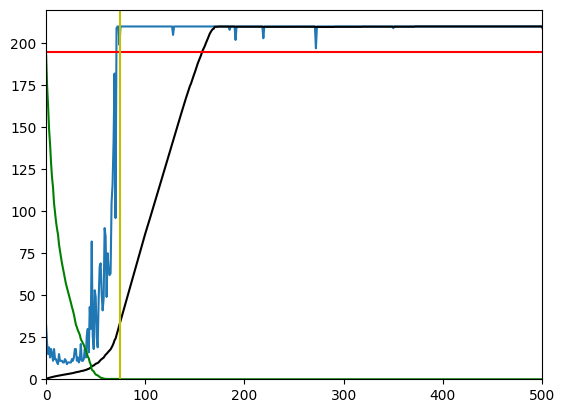

In [14]:
rolling_average = np.convolve(rewards, np.ones(100)/100)

plt.plot(rewards)
plt.plot(rolling_average, color='black')
plt.axhline(y=195, color='r', linestyle='-') #Solved Line
#Scale Epsilon (0.001 - 1.0) to match reward (0 - 200) range
eps_graph = [200*x for x in epsilons]
plt.plot(eps_graph, color='g', linestyle='-')
#Plot the line where TESTING begins
plt.axvline(x=TRAIN_END, color='y', linestyle='-')
plt.xlim( (0,EPISODES) )
plt.ylim( (0,220) )
plt.show()


envCartPole.close()

**Changes**  
*hyper parameters*: You can alter alpha, gamma, batch size, and episode length to see what differences the algorithm returns.  
*Training End*: You can also change the line where I only check the last 5 runs before switching to testing mode (if len(rewards) > 5 and np.average(rewards[-5:]) > 195:) as that doesn't prove it was solved. The reason I did this was because I wanted to limit the amount of runs I made.  